# Описание

## Задачи
_Испольуется три задачи:_
- DM -- двухальтернативный выбор
- Romo -- сравнение двух сигнало через задержку
- CtxDM -- DM с контекстом
Вход состоит из одного контекстного входа, одного стимула, 6 входов, кодирующих задачи. Выход как и раньше состоит из трех частей: контекстный выход, выходы принятия решения.

## Сеть
 Сеть состоит из lif AdEx нейронов

# Импорт всех необходимых библиотек

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from cgtasknet.instruments.instrument_accuracy_network import CorrectAnswerNetwork
from cgtasknet.tasks.reduce import (
    CtxDMTaskParameters,
    DMTaskParameters,
    DMTaskRandomModParameters,
    GoDlTaskParameters,
    GoDlTaskRandomModParameters,
    GoRtTaskParameters,
    GoRtTaskRandomModParameters,
    GoTaskParameters,
    GoTaskRandomModParameters,
    MultyReduceTasks,
    RomoTaskParameters,
    RomoTaskRandomModParameters,
)
from tqdm import tqdm

# Определяем устройство

In [2]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f"{device}")

cuda:0


# Функция построения входов и выходов

In [3]:
import os


def plot_results(inputs, target_outputs, outputs):
    if isinstance(inputs, torch.Tensor) and isinstance(target_outputs, torch.Tensor):
        inputs, t_outputs = (
            inputs.detach().cpu().numpy(),
            target_outputs.detach().cpu().numpy(),
        )
    for bath in range(min(batch_size, 20)):
        fig = plt.figure(figsize=(15, 3))
        ax1 = fig.add_subplot(141)
        plt.title("Inputs")
        plt.xlabel("$time, ms$")
        plt.ylabel("$Magnitude$")
        for i in range(3):
            plt.plot(inputs[:, bath, i].T, label=rf"$in_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax2 = fig.add_subplot(142)
        plt.title("Task code (context)")
        plt.xticks(np.arange(1, len(tasks) + 1), sorted(tasks), rotation=90)
        plt.yticks([])
        for i in range(3, inputs.shape[-1]):
            plt.plot([i - 2] * 2, [0, inputs[0, bath, i]])
        plt.tight_layout()

        ax3 = fig.add_subplot(143)
        plt.title("Target output")
        plt.xlabel("$time, ms$")
        for i in range(t_outputs.shape[-1]):
            plt.plot(t_outputs[:, bath, i], label=rf"$out_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax4 = fig.add_subplot(144)
        plt.title("Real output")
        plt.xlabel("$time, ms$")
        for i in range(outputs.shape[-1]):
            plt.plot(
                outputs.detach().cpu().numpy()[:, bath, i], label=rf"$out_{i + 1}$"
            )
        plt.legend()
        plt.tight_layout()
        if not os.path.exists("figures"):
            os.mkdir("figures")
        plt.savefig(f"figures{os.sep}network_outputs_{name}_batch_{bath}.pdf")
        plt.show()
        plt.close()

# Определяем датасет
Датасет будет состоять из трех типов задач:
- DM задача;
- Romo задача;
- CtxDM задача.
_Параметры для последней задачи аналогичны DM задаче_
***
## Параметры датасета:

In [4]:
batch_size = 32
number_of_epochs = 3000
number_of_tasks = 2

go_task_list_values = np.linspace(0, 1, 8)

romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.2,
        positive_shift_delay_time=1.5,
        trial_time=0.2,
        positive_shift_trial_time=0.4,
        answer_time=0.25,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.3, positive_shift_trial_time=1.5, answer_time=0.25)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        value=go_task_list_values,
        answer_time=0.25,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go_rt=GoRtTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        answer_time=1.5,
        value=go_task_list_values,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(
            trial_time=0.2,
            positive_shift_trial_time=0.4,
            answer_time=0.25,
            value=go_task_list_values,
        ),
        delay=0.2,
        positive_shift_delay_time=1.5,
    )
)

## Датасет

In [5]:
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}
Task = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
)

print("Task parameters:")
for key in task_dict:
    print(f"{key}:\n{task_dict[key]}\n")

print(f"inputs/outputs: {Task.feature_and_act_size[0]}/{Task.feature_and_act_size[1]}")

Task parameters:
RomoTask1:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

RomoTask2:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

DMTask1:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

DMTask2:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

CtxDMTask1:
CtxDMTaskParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3,

In [6]:
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)

# Инициализация сети и выгрузка на device

In [7]:
from cgtasknet.net import SNNlifadex
from norse.torch import LIFAdExParameters

feature_size, output_size = Task.feature_and_act_size
hidden_size = 256

neuron_parameters = LIFAdExParameters(
    v_th=torch.as_tensor(0.65),
    tau_ada_inv=torch.as_tensor(1 / 2.0),
    alpha=100,
    method="super",
    # rho_reset = torch.as_tensor(5)
)
model = SNNlifadex(
    feature_size,
    hidden_size,
    output_size,
    neuron_parameters=neuron_parameters,
    tau_filter_inv=40,
    save_states=True,
    return_spiking=True
    
).to(device)
for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        initial_parameters = torch.clone(param.detach().cpu())


inputs, _ = Task.dataset(1)
inputs *= 0
additionalCurrent = 0.1 * torch.randn((1, hidden_size)).to(device) + 1.4
inputs = torch.from_numpy(inputs[-1000:]).type(torch.float).to(device)
outputs, states = model(inputs, additional_current = additionalCurrent)
outputs = outputs.detach().cpu()
plt.plot(outputs[:, 0, 0])
plt.show()
plt.close()

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr == 0, '.')

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr, '.')

# Критерий и функция ошибки

In [8]:
learning_rate = 5e-3
reg_freq = 1e3 #1e3 for square #for 600 1e5
class RMSELoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()

    def forward(self, yhat, y):
        return torch.sqrt(self.mse(yhat, y))


class MaskedMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedMSELoss, self).__init__()

    def forward(self, input, target, mask):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
            mask
        )
        result = torch.sum(diff2) / torch.sum(mask)
        return result

class MaskedAndFrRegMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedAndFrRegMSELoss, self).__init__()
        
    def forward(self, input, target, mask, state):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
        mask)
        result = torch.sum(diff2) / torch.sum(mask)
        s = []
        for i in range(len(state)):
            s.append(state[i])
        s = torch.stack(s)
        fr_neurons_mean = torch.mean(torch.mean(s, axis=0), axis=0)
        coefs = ((fr_neurons_mean > .03)).detach()
        fr_neurons_mean *= coefs
        fr_neurons_mean = torch.mean(fr_neurons_mean)
        result += fr_neurons_mean  * reg_freq
        return result

criterion = MaskedAndFrRegMSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

## Генерация всех эпох
> Если память не позволяет, то необходимо генерировать каждую эпоху в основном цикле обучения

In [9]:
if False:
    list_inputs = []
    list_t_outputs = []
    for i in tqdm(range(number_of_epochs)):
        temp_input, temp_t_output = Task.dataset()
        temp_input.astype(dtype=np.float16)
        temp_t_output.astype(dtype=np.float16)
        temp_input[:, :, :] += np.random.normal(0, sigma, size=temp_input.shape)
        list_inputs.append(temp_input)
        list_t_outputs.append(temp_t_output)

# JIT numba generator (test)
TODO: Необходимо добавить в cgtasknet и вызывать оттуда

In [10]:
#from numba import njit, prange


#@njit(cache=True, parallel=True)
def every_bath_generator(
        start_sigma: float,
        stop_sigma: float,
        times: int = 1,
        batches: int = 1,
        actions: int = 1,
):
    data = np.zeros((times, batches, actions))
    for i in range(batches):
        data[:, i, :] = np.random.normal(
            0, np.random.uniform(start_sigma, stop_sigma), size=(times, actions)
        )
    return data

In [11]:
torch.cuda.empty_cache()


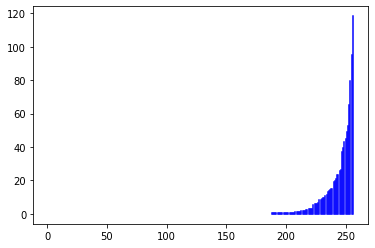

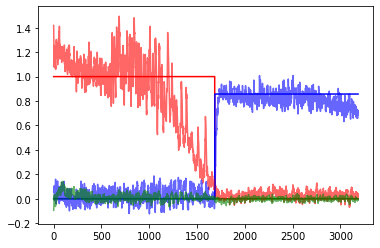

In [26]:
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=6
)
def check_mean_fr():
    init_state = LIFAdExState(
            torch.zeros(batch_size, hidden_size).to(device),
            torch.rand(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
        )
    inputs, target_outputs = Task_test.dataset(1)

    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    result = model(inputs, init_state,)
    #del inputs, init_state
    torch.cuda.empty_cache()
    states = result[-1]
    spikes = []
    for state in states:
        spikes.append(state.detach().cpu())

    last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
    s = torch.stack(spikes)[:last_fix, ...]
    freq_sequence_new = torch.sort(
        torch.mean(torch.mean(s, axis=0), axis=0), dim=0
    ).values
    for i in range(len(freq_sequence_new)):
        plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")
    plt.show()
    plt.close()
    index=0
    plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
    plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
    plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

    plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
            )
    plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
            )
    plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )
    plt.show()
    plt.close()
check_mean_fr()

# Основной цикл обучения

  0%|▏                                                                                                                                                              | 4/3000 [01:15<15:29:23, 18.61s/it]

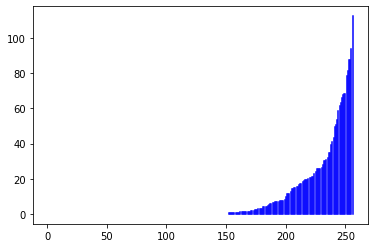

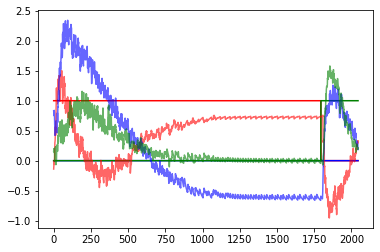

  0%|▍                                                                                                                                                              | 9/3000 [03:00<16:58:56, 20.44s/it]

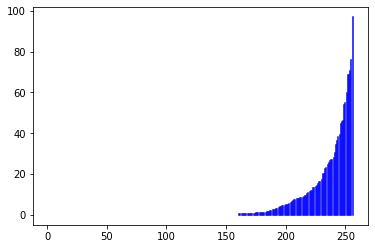

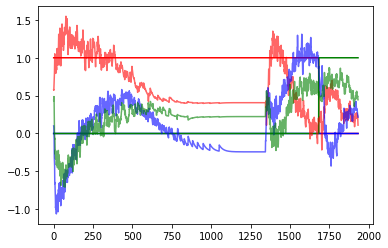

  0%|▋                                                                                                                                                             | 14/3000 [04:46<16:58:00, 20.46s/it]

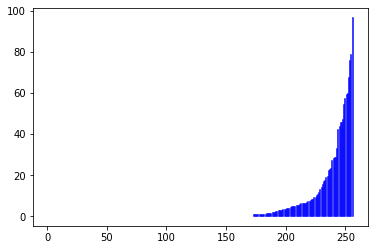

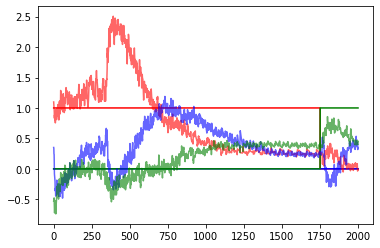

  1%|█                                                                                                                                                             | 19/3000 [06:29<16:46:30, 20.26s/it]

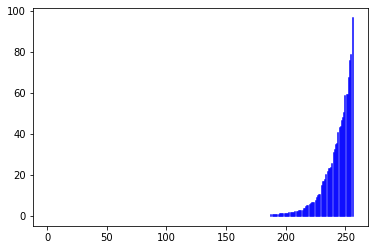

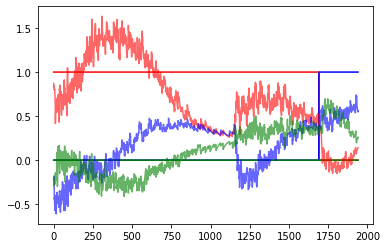

  1%|█▎                                                                                                                                                            | 24/3000 [08:13<16:35:27, 20.07s/it]

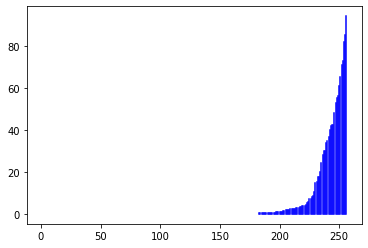

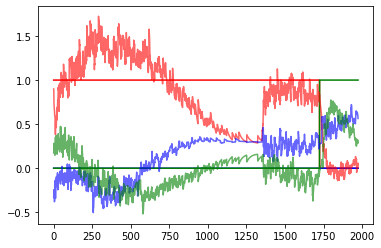

  1%|█▌                                                                                                                                                            | 29/3000 [09:54<16:29:52, 19.99s/it]

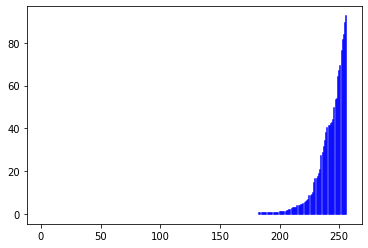

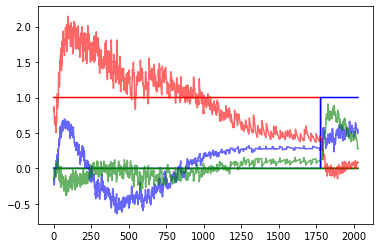

  1%|█▊                                                                                                                                                            | 34/3000 [11:36<16:30:18, 20.03s/it]

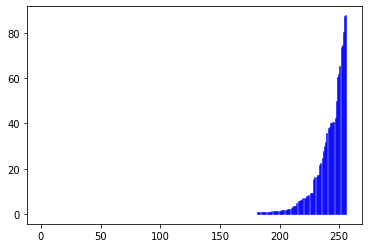

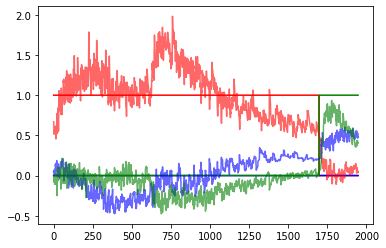

  1%|██                                                                                                                                                            | 39/3000 [13:22<16:56:14, 20.59s/it]

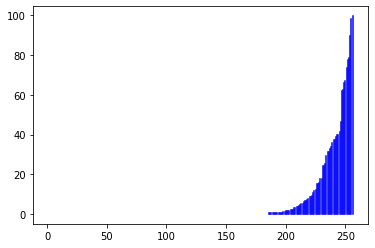

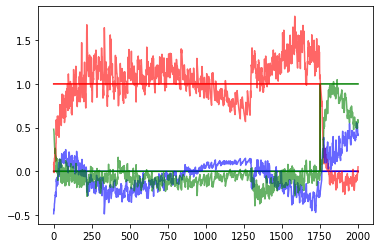

  1%|██▎                                                                                                                                                           | 44/3000 [14:58<15:45:20, 19.19s/it]

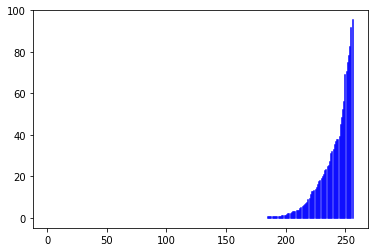

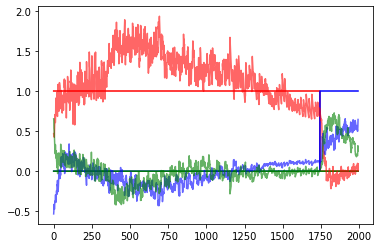

  2%|██▌                                                                                                                                                           | 49/3000 [16:43<16:37:53, 20.29s/it]

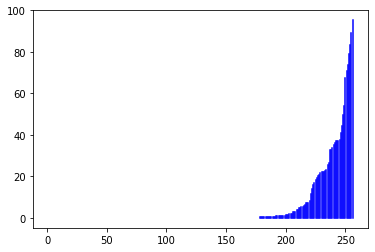

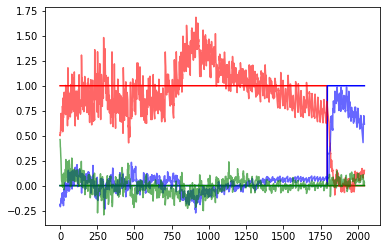

  2%|██▊                                                                                                                                                           | 54/3000 [19:15<19:28:53, 23.81s/it]

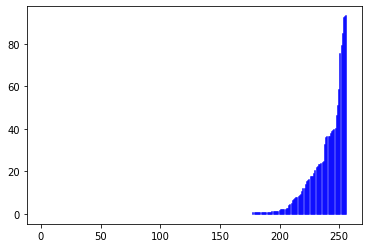

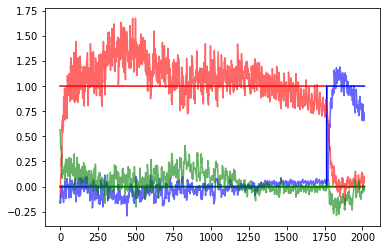

  2%|███                                                                                                                                                           | 59/3000 [20:57<16:52:37, 20.66s/it]

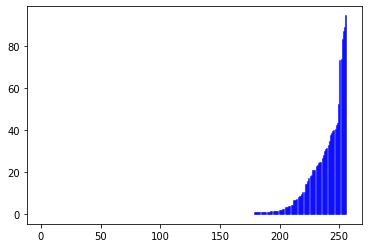

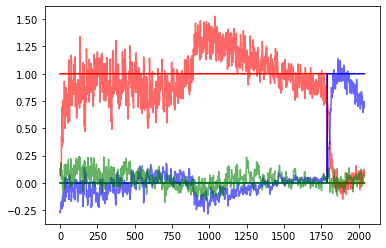

  2%|███▎                                                                                                                                                          | 64/3000 [22:36<16:01:07, 19.64s/it]

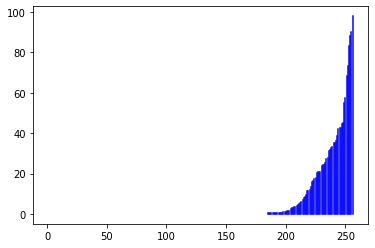

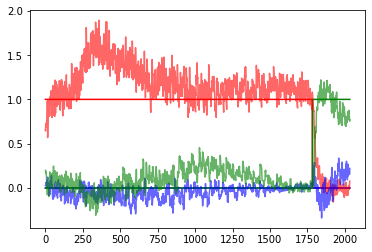

  2%|███▋                                                                                                                                                          | 69/3000 [24:15<15:55:03, 19.55s/it]

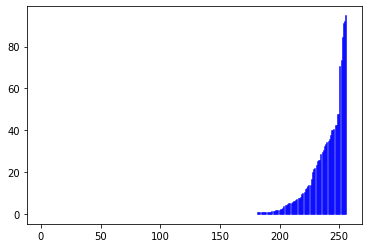

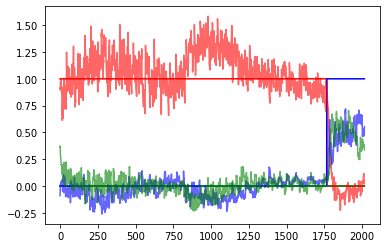

  2%|███▉                                                                                                                                                          | 74/3000 [25:51<15:38:34, 19.25s/it]

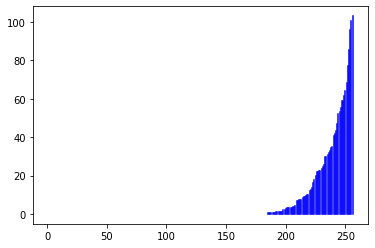

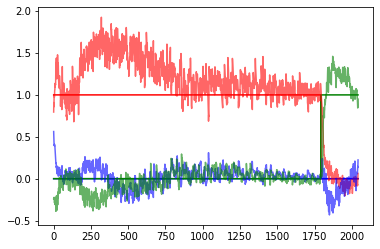

  3%|████▏                                                                                                                                                         | 79/3000 [27:37<16:34:20, 20.42s/it]

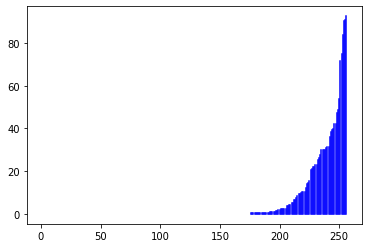

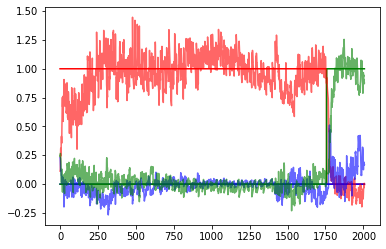

  3%|████▍                                                                                                                                                         | 84/3000 [29:21<16:29:00, 20.35s/it]

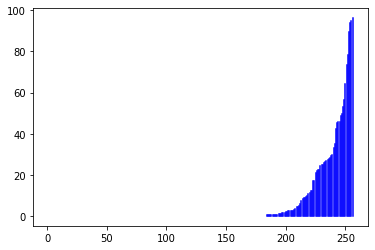

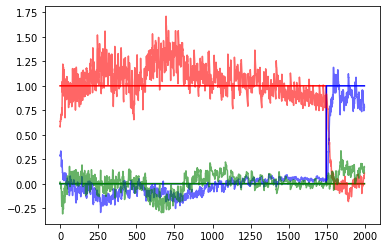

  3%|████▋                                                                                                                                                         | 89/3000 [31:03<16:14:22, 20.08s/it]

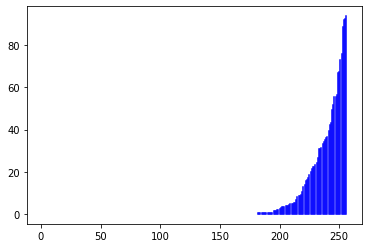

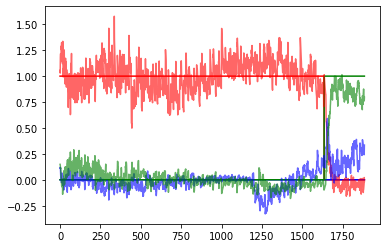

  3%|████▉                                                                                                                                                         | 94/3000 [32:45<16:13:09, 20.09s/it]

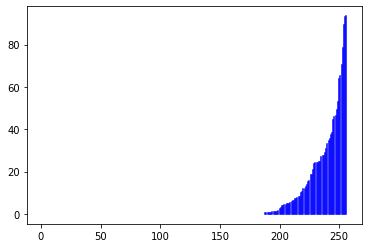

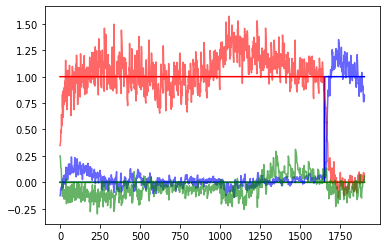

  3%|█████▏                                                                                                                                                        | 99/3000 [34:23<15:32:14, 19.28s/it]

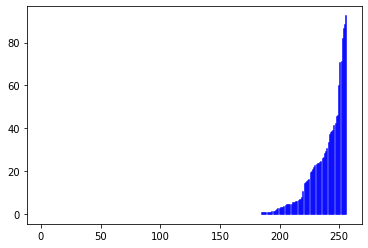

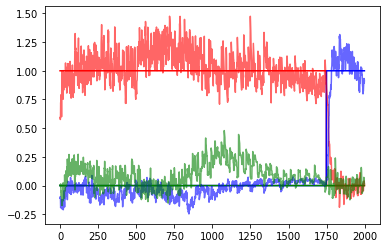

  3%|█████▍                                                                                                                                                       | 104/3000 [36:50<18:43:24, 23.28s/it]

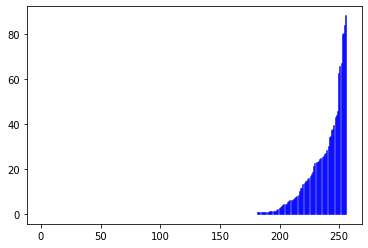

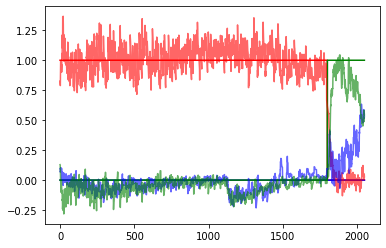

  4%|█████▋                                                                                                                                                       | 109/3000 [38:30<16:24:06, 20.42s/it]

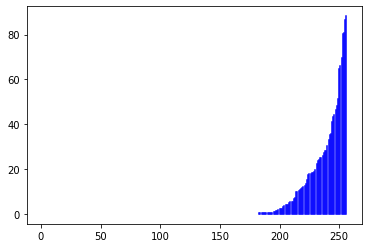

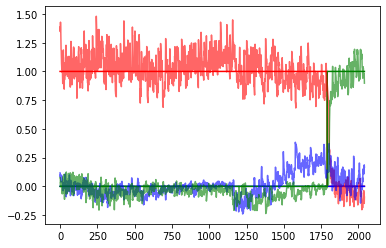

  4%|█████▉                                                                                                                                                       | 114/3000 [40:13<16:12:56, 20.23s/it]

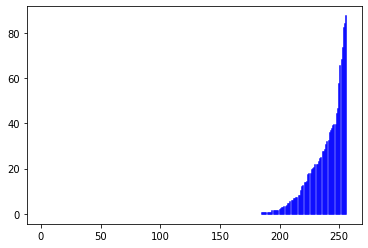

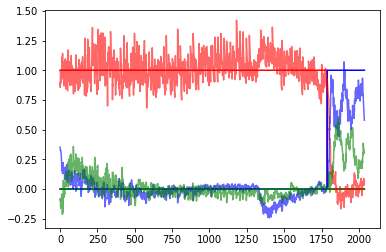

  4%|██████▏                                                                                                                                                      | 119/3000 [41:51<15:35:41, 19.49s/it]

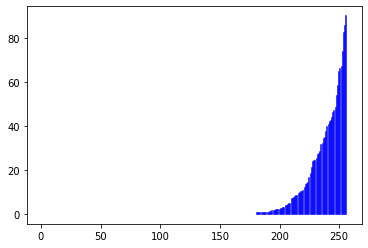

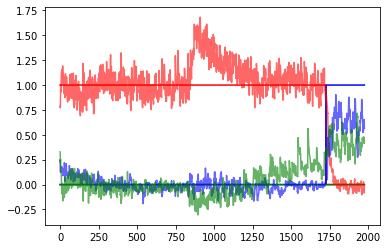

  4%|██████▍                                                                                                                                                      | 124/3000 [43:35<15:58:13, 19.99s/it]

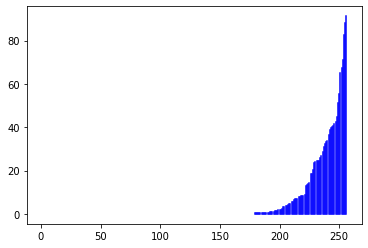

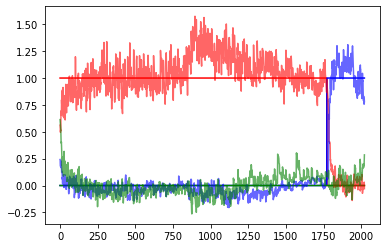

  4%|██████▊                                                                                                                                                      | 129/3000 [45:19<16:08:14, 20.24s/it]

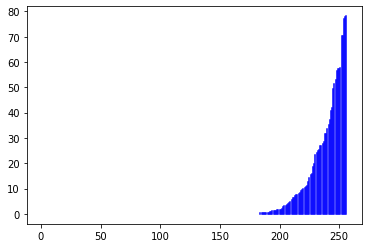

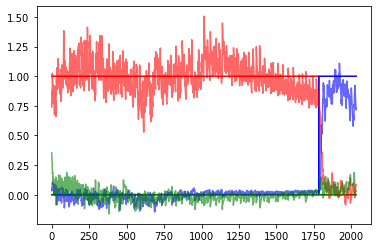

  4%|███████                                                                                                                                                      | 134/3000 [47:00<15:55:49, 20.01s/it]

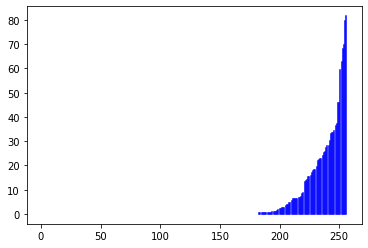

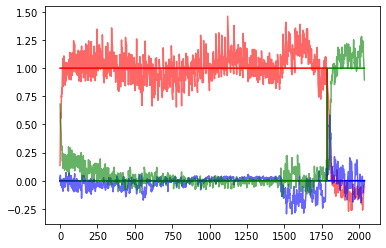

  5%|███████▎                                                                                                                                                     | 139/3000 [48:41<15:33:41, 19.58s/it]

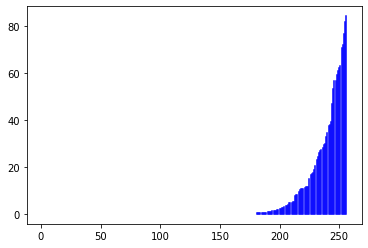

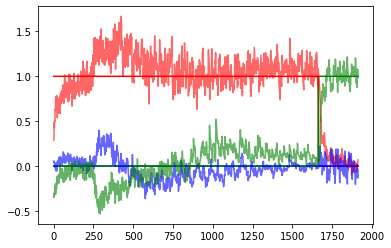

  5%|███████▌                                                                                                                                                     | 144/3000 [50:23<15:39:28, 19.74s/it]

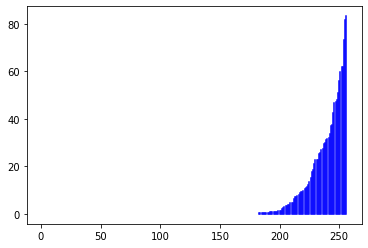

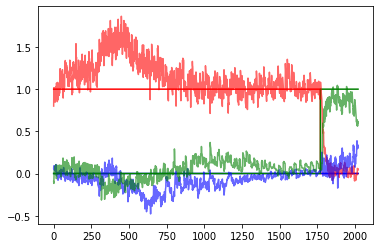

  5%|███████▊                                                                                                                                                     | 149/3000 [52:09<16:11:33, 20.45s/it]

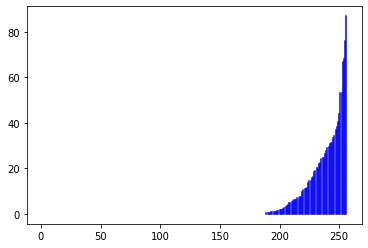

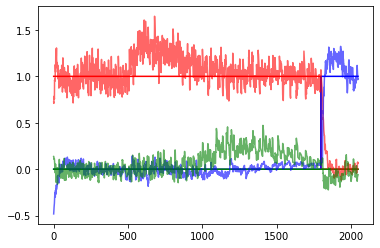

  5%|████████                                                                                                                                                     | 154/3000 [54:42<18:41:11, 23.64s/it]

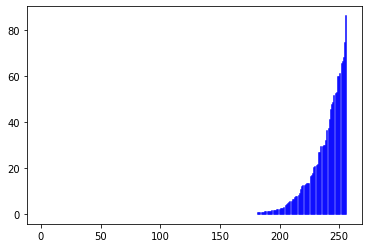

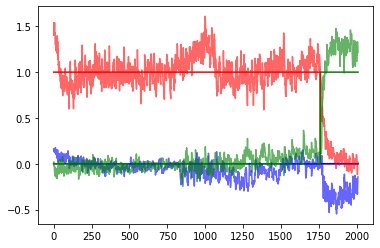

  5%|████████▎                                                                                                                                                    | 159/3000 [56:24<16:19:27, 20.69s/it]

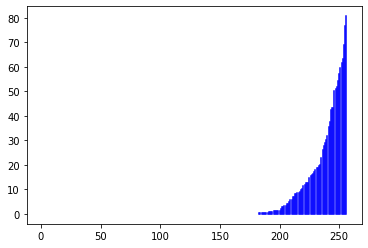

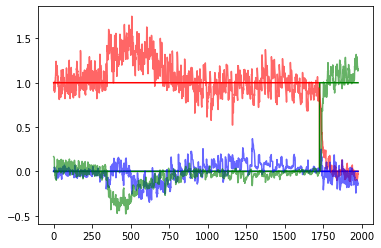

  5%|████████▌                                                                                                                                                    | 164/3000 [58:06<15:48:44, 20.07s/it]

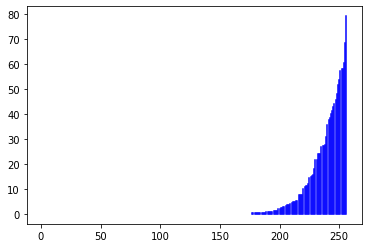

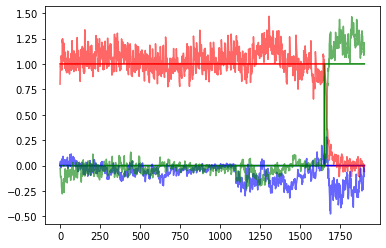

  6%|████████▊                                                                                                                                                    | 169/3000 [59:50<15:46:44, 20.07s/it]

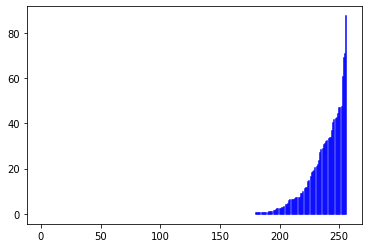

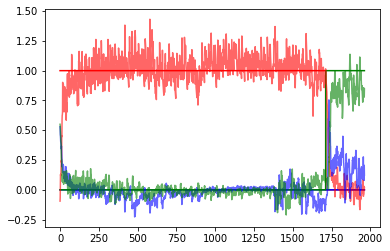

  6%|████████▉                                                                                                                                                  | 174/3000 [1:01:31<15:38:59, 19.94s/it]

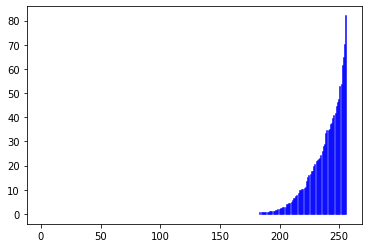

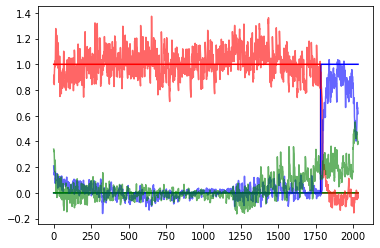

  6%|█████████▏                                                                                                                                                 | 179/3000 [1:03:11<15:34:38, 19.88s/it]

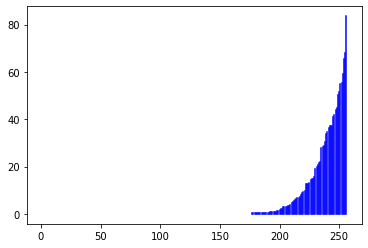

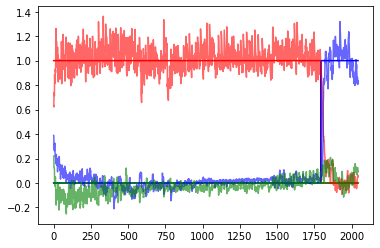

  6%|█████████▌                                                                                                                                                 | 184/3000 [1:04:54<15:37:21, 19.97s/it]

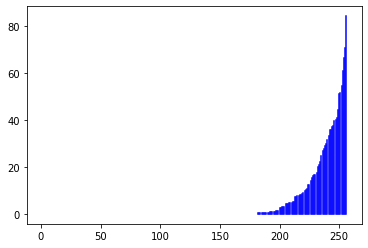

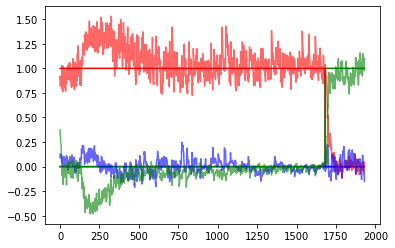

  6%|█████████▊                                                                                                                                                 | 189/3000 [1:06:37<15:29:17, 19.84s/it]

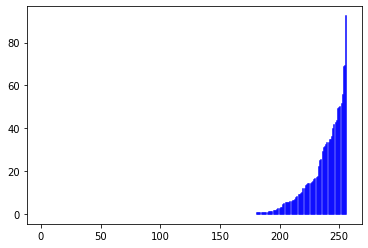

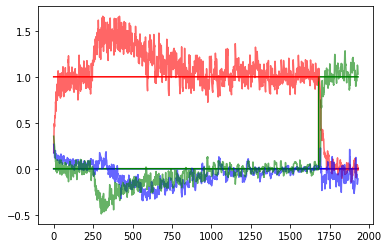

  6%|██████████                                                                                                                                                 | 194/3000 [1:08:16<15:12:45, 19.52s/it]

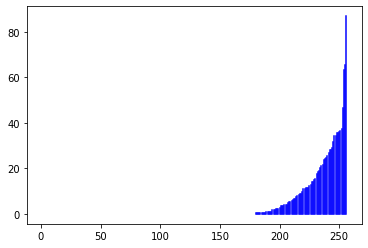

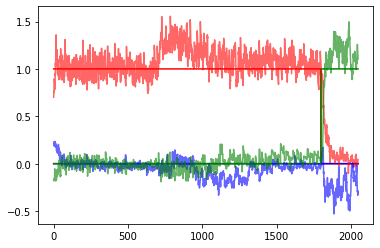

  7%|██████████▎                                                                                                                                                | 199/3000 [1:10:00<15:49:53, 20.35s/it]

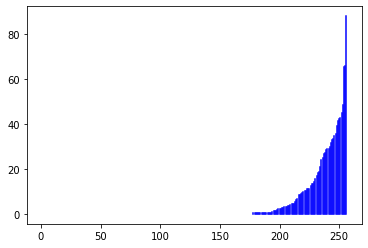

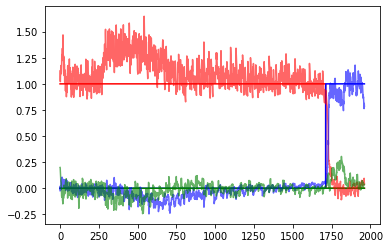

  7%|██████████▌                                                                                                                                                | 204/3000 [1:12:33<18:26:09, 23.74s/it]

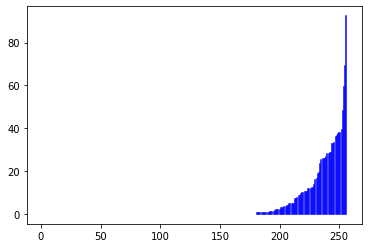

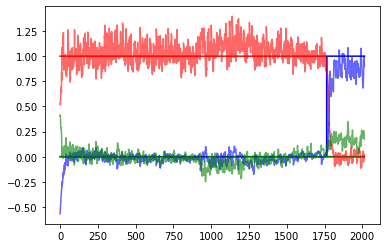

  7%|██████████▊                                                                                                                                                | 209/3000 [1:14:13<15:33:21, 20.07s/it]

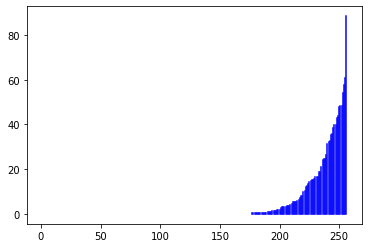

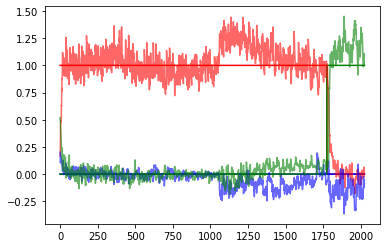

  7%|███████████                                                                                                                                                | 214/3000 [1:15:53<15:21:44, 19.85s/it]

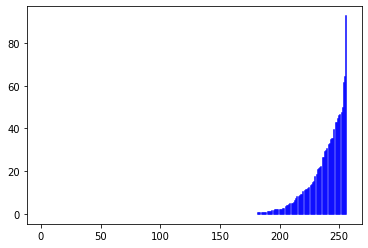

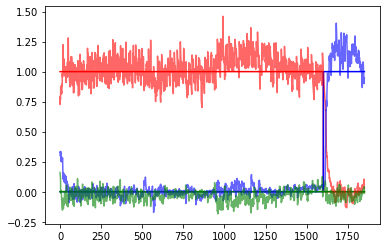

  7%|███████████▎                                                                                                                                               | 219/3000 [1:17:33<14:42:28, 19.04s/it]

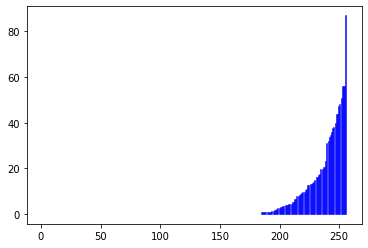

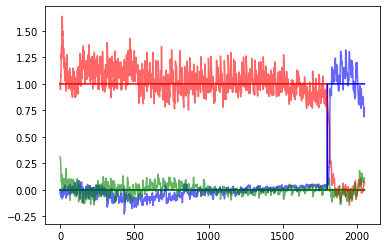

  7%|███████████▌                                                                                                                                               | 224/3000 [1:19:14<15:00:26, 19.46s/it]

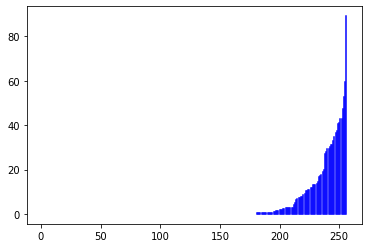

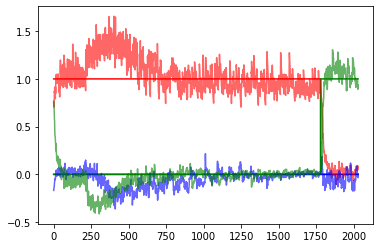

  8%|███████████▊                                                                                                                                               | 229/3000 [1:20:57<15:36:23, 20.28s/it]

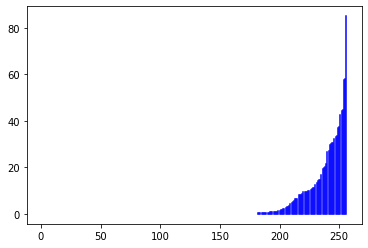

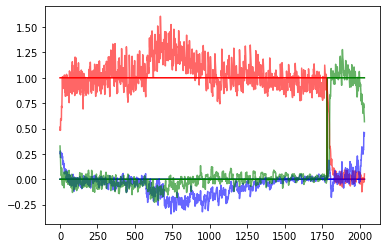

  8%|████████████                                                                                                                                               | 234/3000 [1:22:43<15:41:00, 20.41s/it]

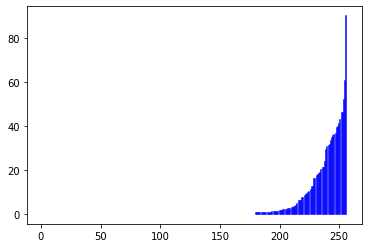

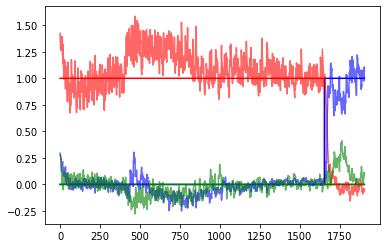

  8%|████████████▎                                                                                                                                              | 239/3000 [1:24:25<15:26:55, 20.14s/it]

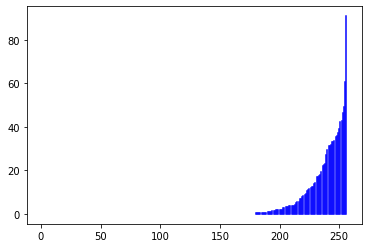

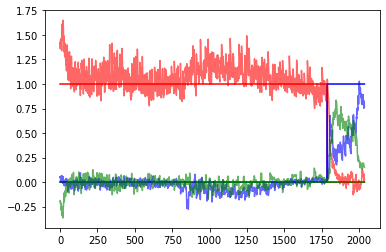

  8%|████████████▌                                                                                                                                              | 244/3000 [1:26:01<14:39:52, 19.16s/it]

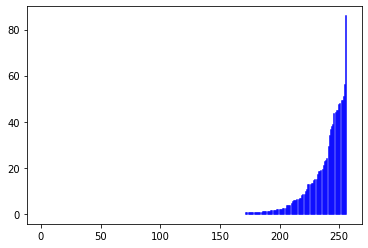

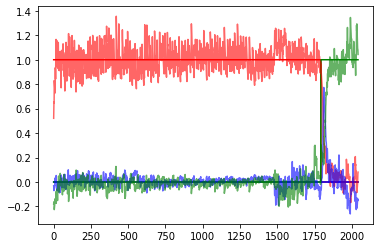

  8%|████████████▊                                                                                                                                              | 249/3000 [1:27:39<14:20:12, 18.76s/it]

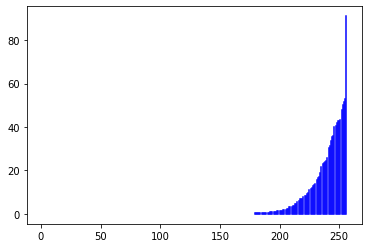

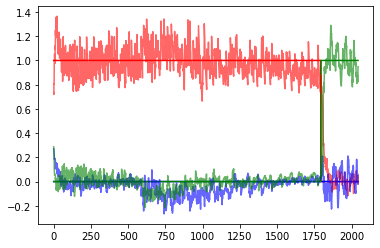

  8%|█████████████                                                                                                                                              | 254/3000 [1:30:12<18:01:12, 23.62s/it]

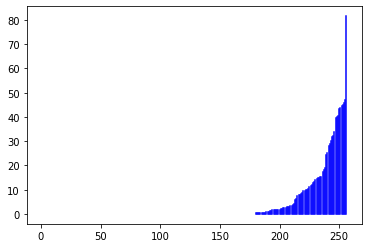

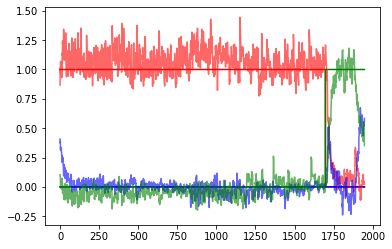

  9%|█████████████▍                                                                                                                                             | 259/3000 [1:31:52<15:21:46, 20.18s/it]

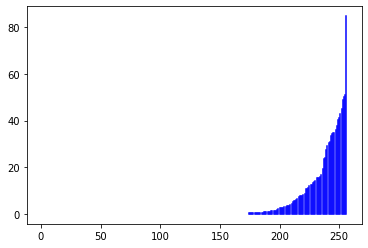

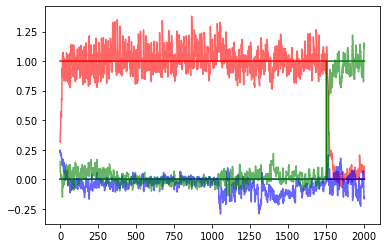

  9%|█████████████▋                                                                                                                                             | 264/3000 [1:33:36<15:40:48, 20.63s/it]

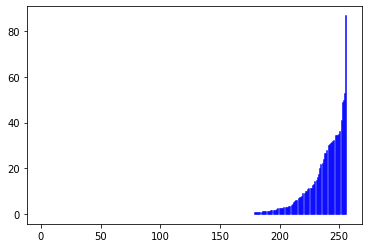

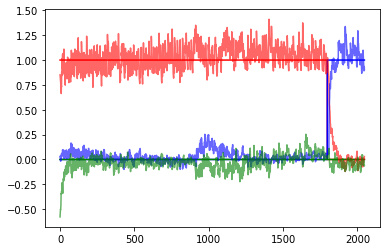

  9%|█████████████▉                                                                                                                                             | 269/3000 [1:35:17<14:57:43, 19.72s/it]

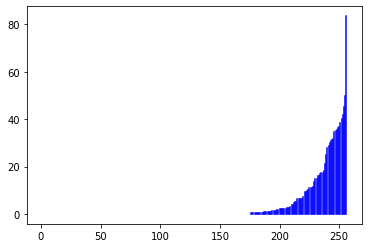

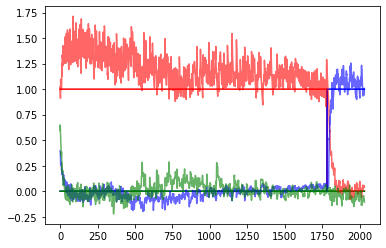

  9%|██████████████▏                                                                                                                                            | 274/3000 [1:37:00<15:00:11, 19.81s/it]

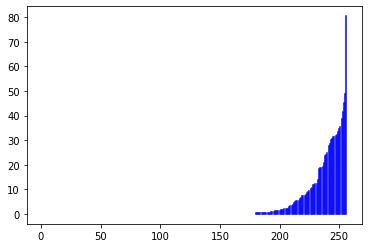

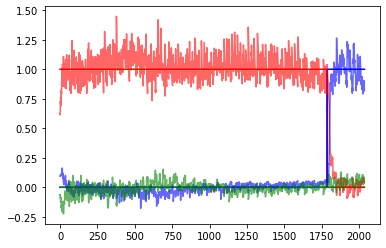

  9%|██████████████▍                                                                                                                                            | 279/3000 [1:38:41<15:07:16, 20.01s/it]

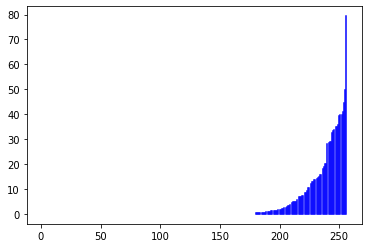

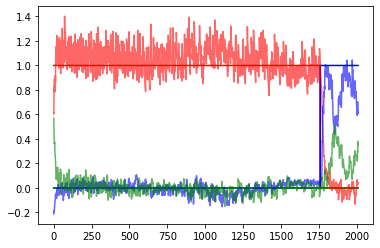

  9%|██████████████▋                                                                                                                                            | 284/3000 [1:40:25<15:11:59, 20.15s/it]

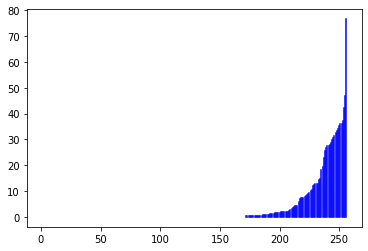

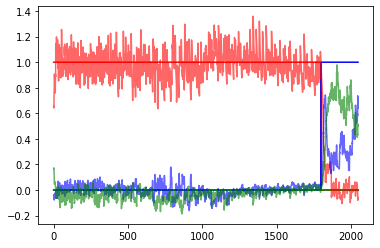

 10%|██████████████▉                                                                                                                                            | 289/3000 [1:42:11<15:39:52, 20.80s/it]

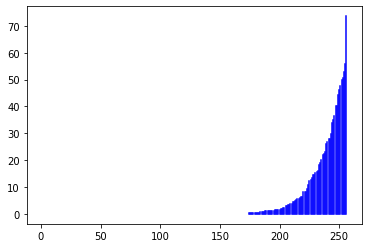

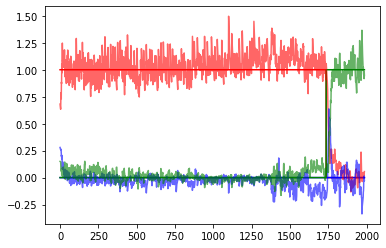

 10%|███████████████▏                                                                                                                                           | 294/3000 [1:43:53<14:59:27, 19.94s/it]

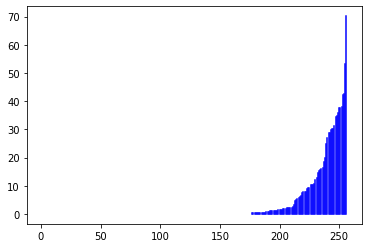

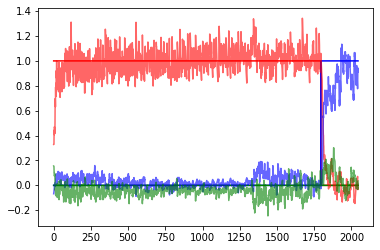

 10%|███████████████▍                                                                                                                                           | 299/3000 [1:45:31<14:51:07, 19.80s/it]

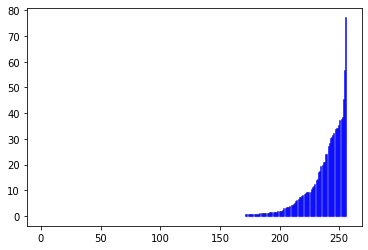

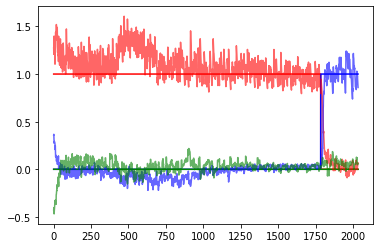

 10%|███████████████▋                                                                                                                                           | 304/3000 [1:47:59<17:18:27, 23.11s/it]

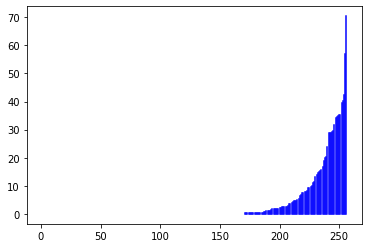

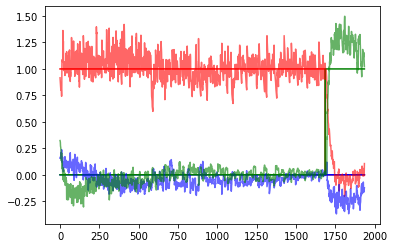

 10%|███████████████▉                                                                                                                                           | 309/3000 [1:49:36<14:49:26, 19.83s/it]

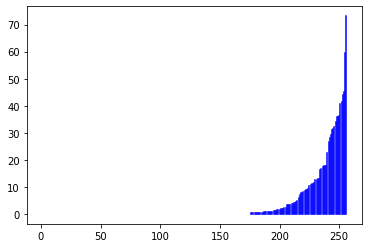

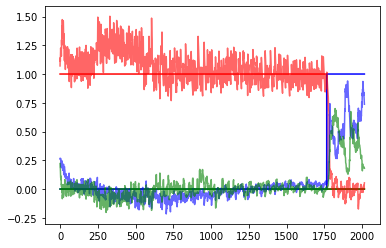

 10%|████████████████▏                                                                                                                                          | 314/3000 [1:51:20<14:52:23, 19.93s/it]

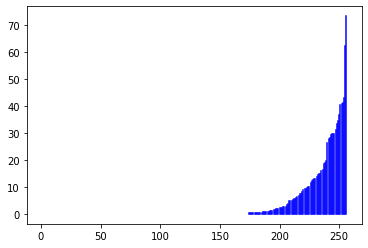

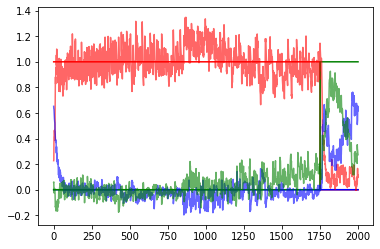

 11%|████████████████▍                                                                                                                                          | 319/3000 [1:53:04<15:09:57, 20.36s/it]

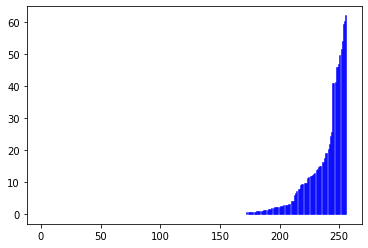

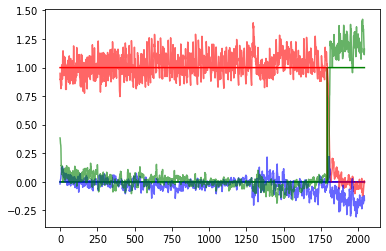

 11%|████████████████▋                                                                                                                                          | 324/3000 [1:54:46<15:03:26, 20.26s/it]

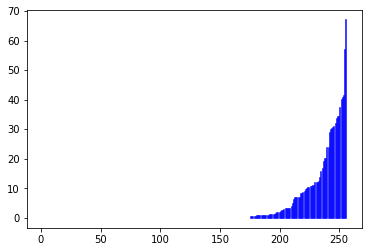

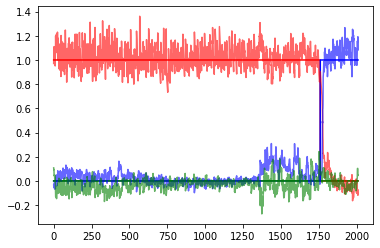

 11%|████████████████▉                                                                                                                                          | 329/3000 [1:56:31<15:06:15, 20.36s/it]

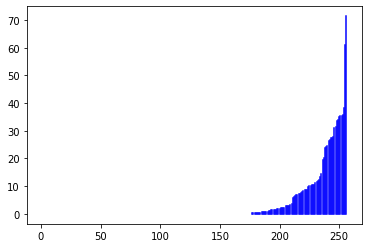

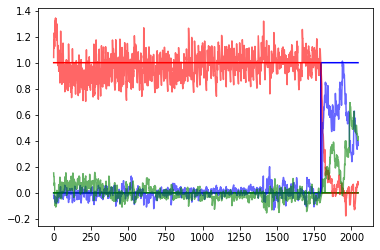

 11%|█████████████████▎                                                                                                                                         | 334/3000 [1:58:11<14:31:19, 19.61s/it]

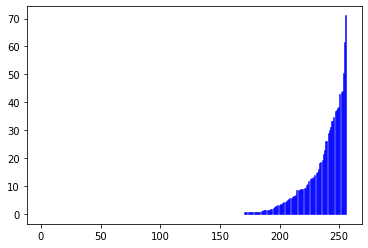

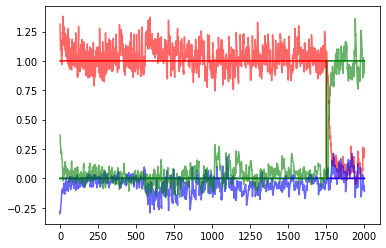

 11%|█████████████████▌                                                                                                                                         | 339/3000 [1:59:49<14:18:11, 19.35s/it]

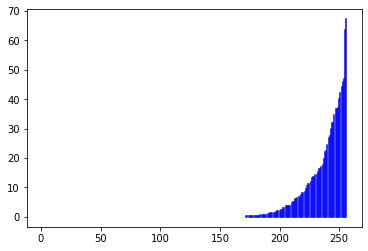

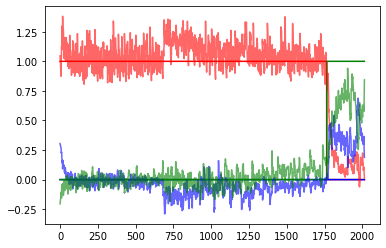

 11%|█████████████████▊                                                                                                                                         | 344/3000 [2:01:32<14:56:01, 20.24s/it]

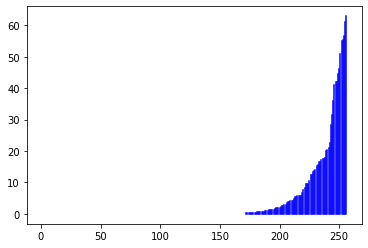

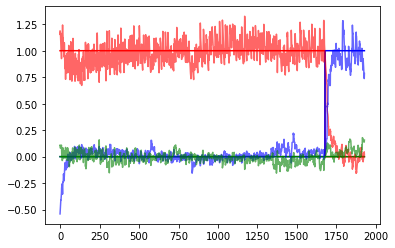

 12%|██████████████████                                                                                                                                         | 349/3000 [2:03:13<14:48:59, 20.12s/it]

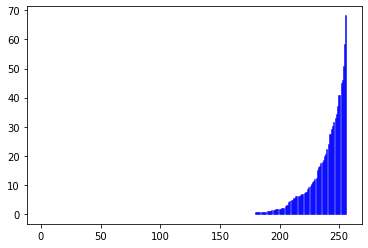

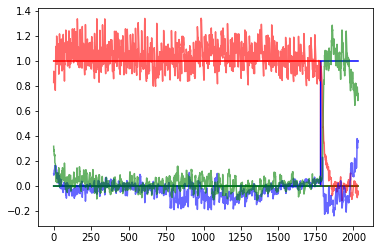

 12%|██████████████████▎                                                                                                                                        | 354/3000 [2:05:46<17:25:26, 23.71s/it]

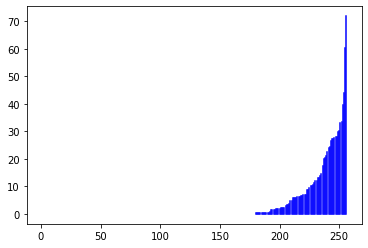

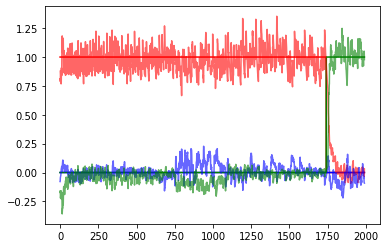

 12%|██████████████████▌                                                                                                                                        | 359/3000 [2:07:33<15:43:03, 21.42s/it]

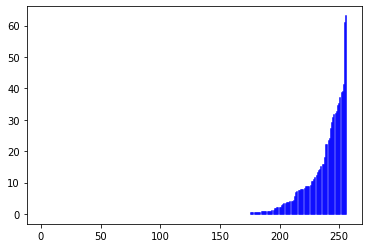

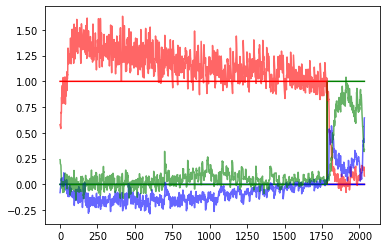

 12%|██████████████████▊                                                                                                                                        | 364/3000 [2:09:12<14:19:59, 19.58s/it]

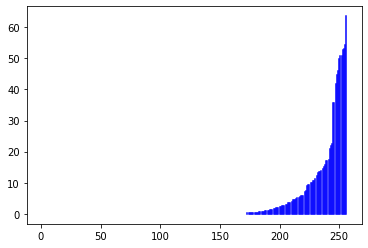

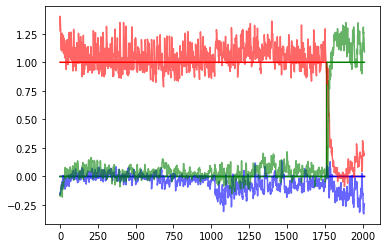

 12%|███████████████████                                                                                                                                        | 369/3000 [2:10:51<14:04:49, 19.27s/it]

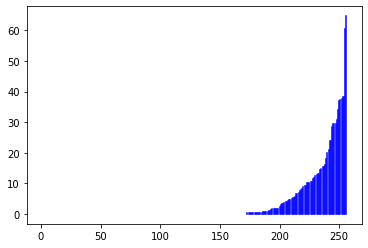

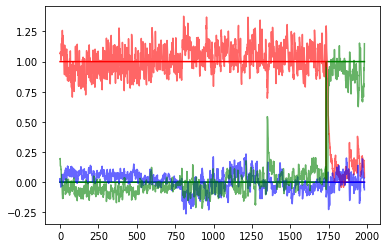

 12%|███████████████████▎                                                                                                                                       | 374/3000 [2:12:35<14:35:46, 20.01s/it]

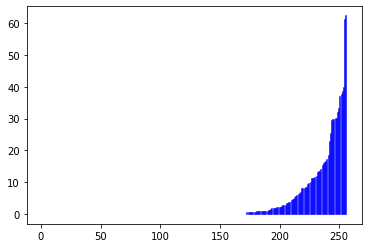

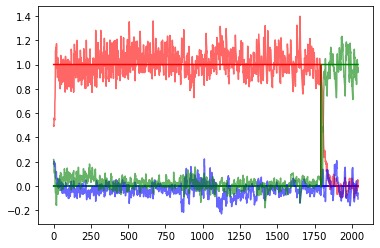

 13%|███████████████████▌                                                                                                                                       | 379/3000 [2:14:16<14:13:24, 19.54s/it]

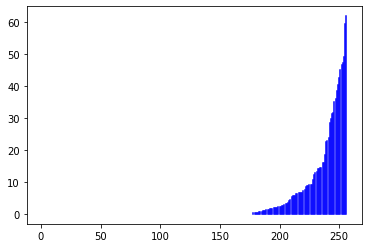

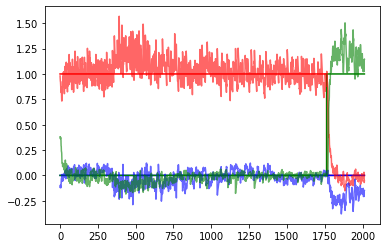

 13%|███████████████████▊                                                                                                                                       | 384/3000 [2:15:58<14:23:03, 19.80s/it]

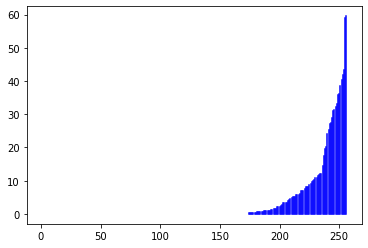

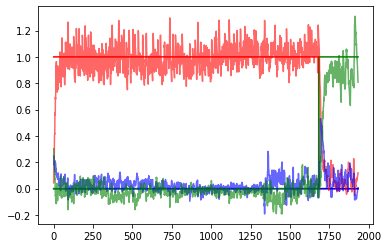

 13%|████████████████████                                                                                                                                       | 389/3000 [2:17:39<14:20:11, 19.77s/it]

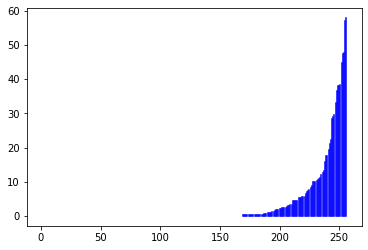

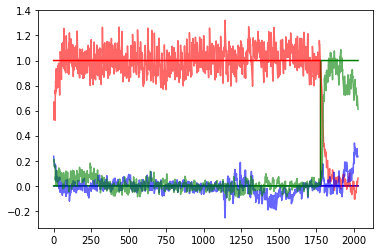

 13%|████████████████████▎                                                                                                                                      | 394/3000 [2:19:20<14:22:59, 19.87s/it]

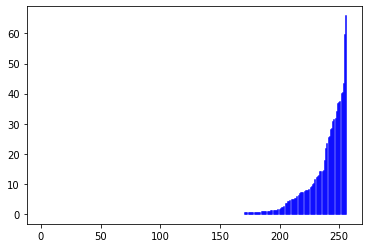

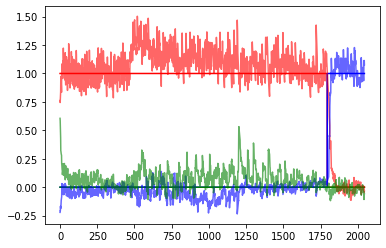

 13%|████████████████████▌                                                                                                                                      | 399/3000 [2:21:03<14:29:49, 20.07s/it]

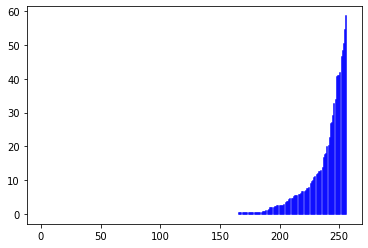

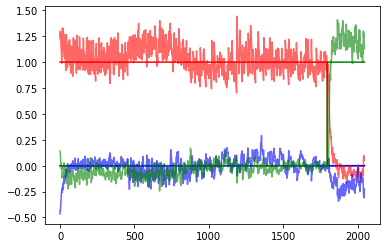

 13%|████████████████████▊                                                                                                                                      | 404/3000 [2:23:35<17:03:49, 23.66s/it]

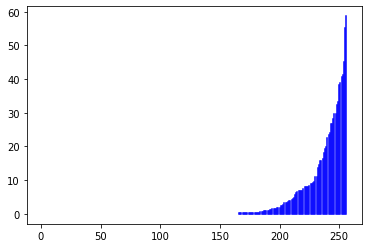

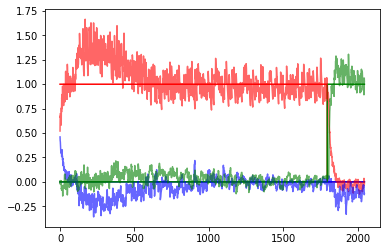

 14%|█████████████████████▏                                                                                                                                     | 409/3000 [2:25:16<14:53:02, 20.68s/it]

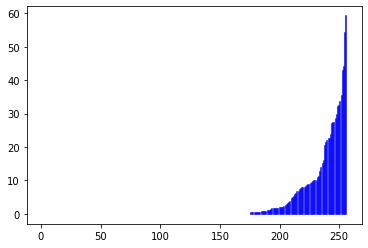

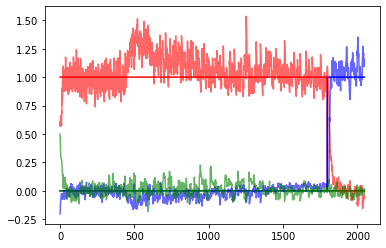

 14%|█████████████████████▍                                                                                                                                     | 414/3000 [2:26:53<13:29:39, 18.79s/it]

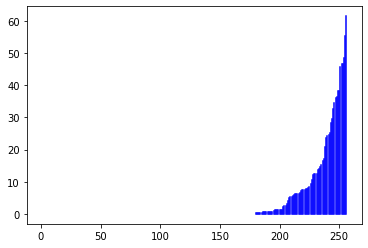

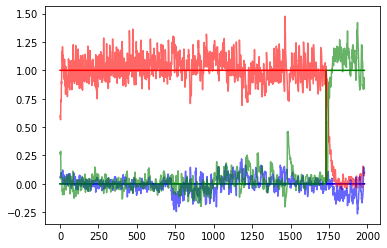

 14%|█████████████████████▋                                                                                                                                     | 419/3000 [2:28:35<14:18:14, 19.95s/it]

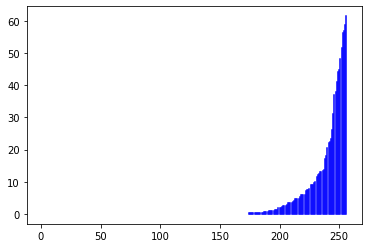

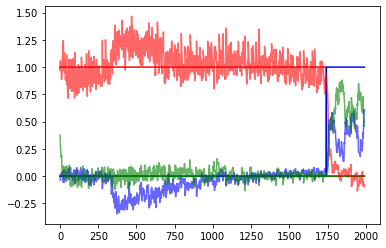

 14%|█████████████████████▉                                                                                                                                     | 424/3000 [2:30:13<13:53:08, 19.41s/it]

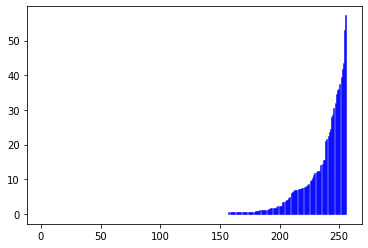

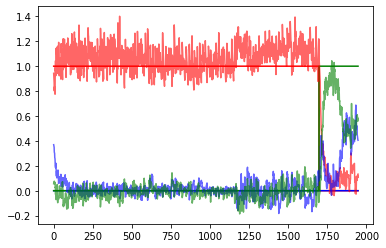

 14%|██████████████████████▏                                                                                                                                    | 429/3000 [2:31:52<13:49:35, 19.36s/it]

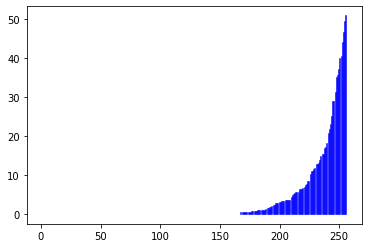

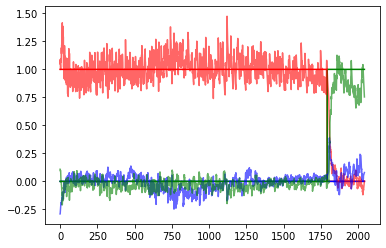

 14%|██████████████████████▍                                                                                                                                    | 434/3000 [2:33:32<14:06:31, 19.79s/it]

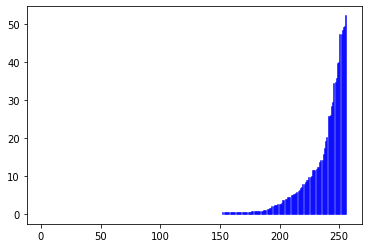

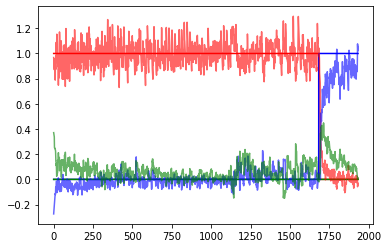

 15%|██████████████████████▋                                                                                                                                    | 439/3000 [2:35:11<14:01:39, 19.72s/it]

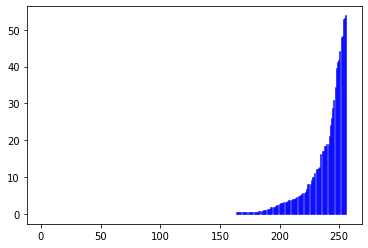

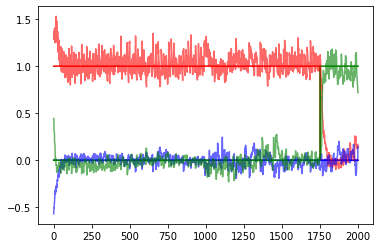

 15%|██████████████████████▉                                                                                                                                    | 444/3000 [2:36:51<13:50:03, 19.48s/it]

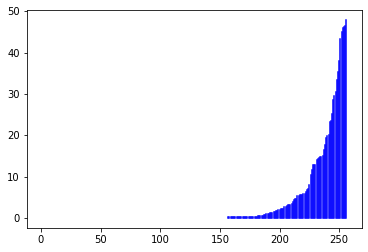

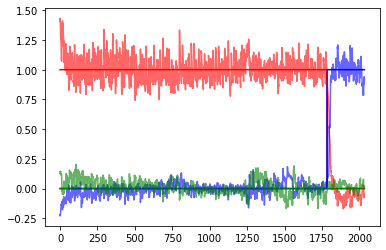

 15%|███████████████████████▏                                                                                                                                   | 449/3000 [2:38:31<13:52:17, 19.58s/it]

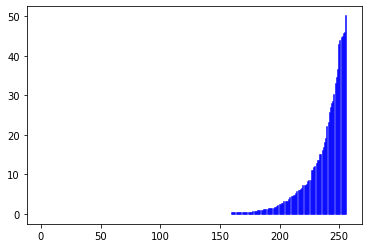

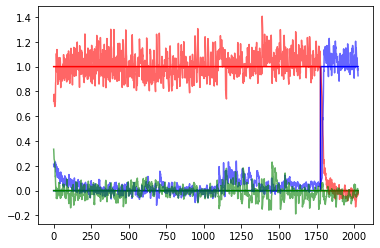

 15%|███████████████████████▍                                                                                                                                   | 454/3000 [2:41:01<16:25:44, 23.23s/it]

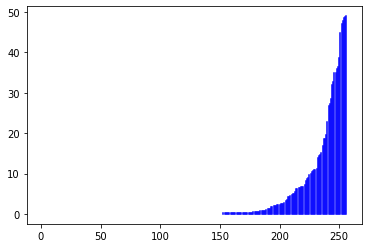

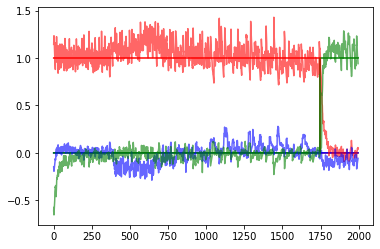

 15%|███████████████████████▋                                                                                                                                   | 459/3000 [2:42:42<14:16:57, 20.24s/it]

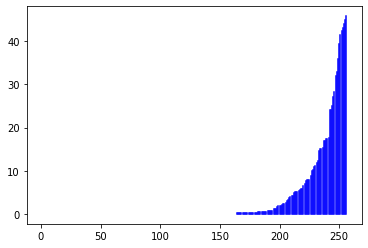

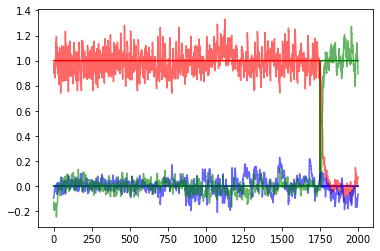

 15%|███████████████████████▉                                                                                                                                   | 464/3000 [2:44:25<14:15:52, 20.25s/it]

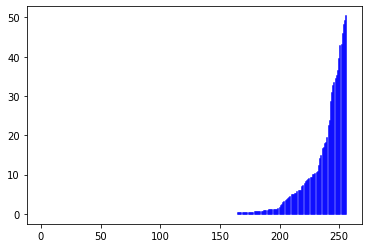

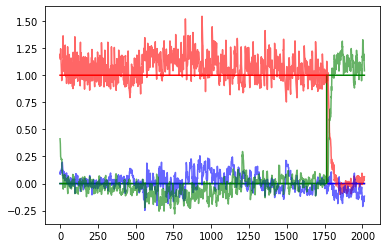

 16%|████████████████████████▏                                                                                                                                  | 469/3000 [2:46:03<13:24:46, 19.08s/it]

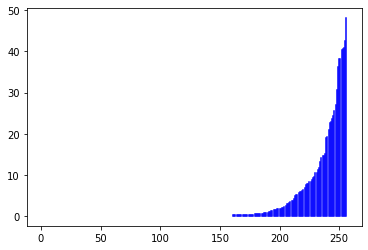

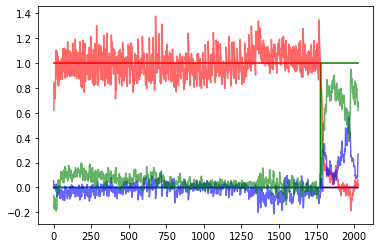

 16%|████████████████████████▍                                                                                                                                  | 474/3000 [2:47:46<13:58:59, 19.93s/it]

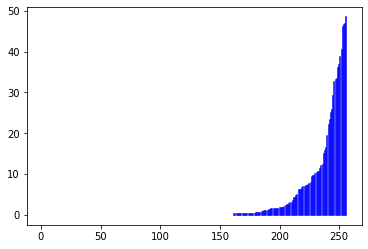

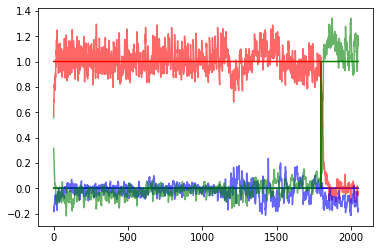

 16%|████████████████████████▋                                                                                                                                  | 479/3000 [2:49:31<14:27:11, 20.64s/it]

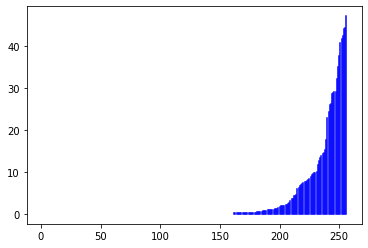

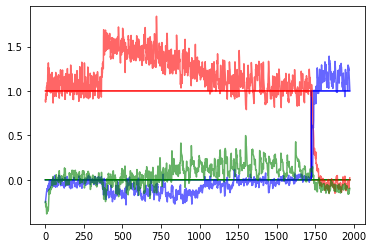

 16%|█████████████████████████                                                                                                                                  | 484/3000 [2:51:14<13:58:45, 20.00s/it]

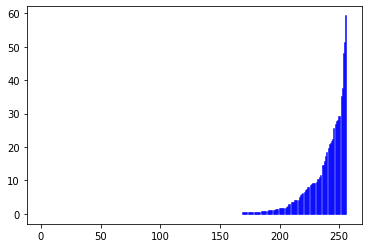

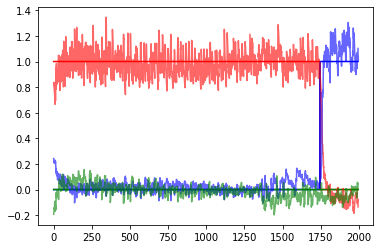

 16%|█████████████████████████▎                                                                                                                                 | 489/3000 [2:52:55<13:32:19, 19.41s/it]

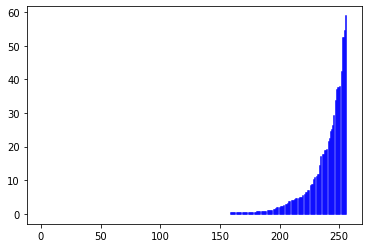

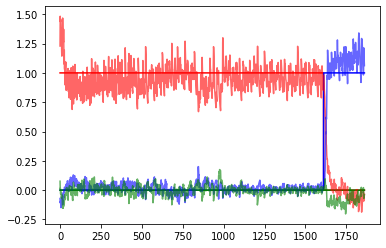

 16%|█████████████████████████▌                                                                                                                                 | 494/3000 [2:54:33<13:29:43, 19.39s/it]

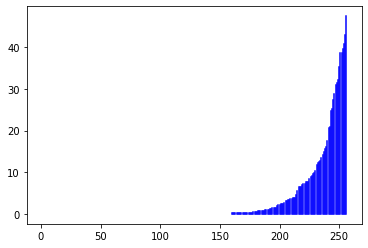

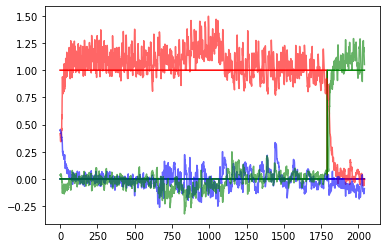

 17%|█████████████████████████▊                                                                                                                                 | 499/3000 [2:56:14<13:36:26, 19.59s/it]

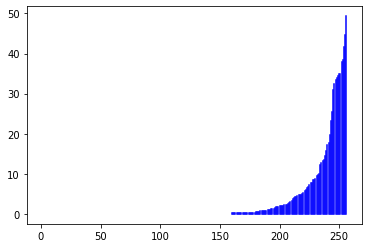

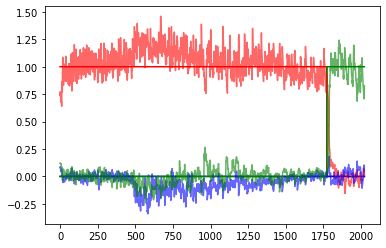

 17%|██████████████████████████                                                                                                                                 | 504/3000 [2:58:45<16:09:41, 23.31s/it]

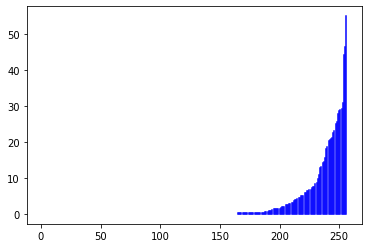

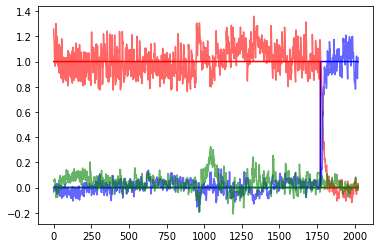

 17%|██████████████████████████▎                                                                                                                                | 509/3000 [3:00:23<13:56:22, 20.15s/it]

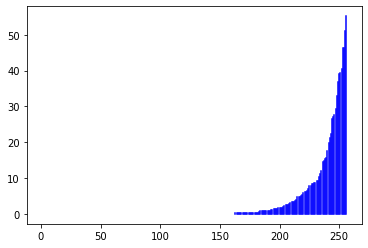

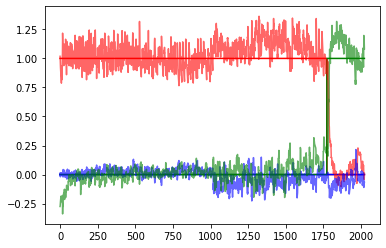

 17%|██████████████████████████▌                                                                                                                                | 514/3000 [3:02:01<13:09:16, 19.05s/it]

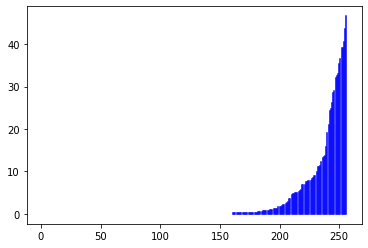

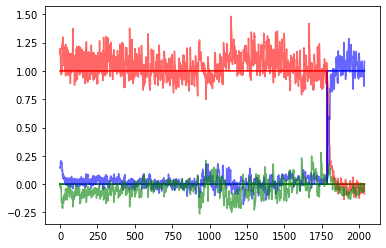

 17%|██████████████████████████▊                                                                                                                                | 519/3000 [3:03:45<13:47:19, 20.01s/it]

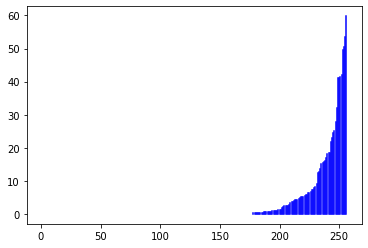

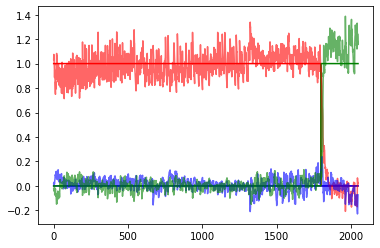

 17%|███████████████████████████                                                                                                                                | 524/3000 [3:05:27<13:53:30, 20.20s/it]

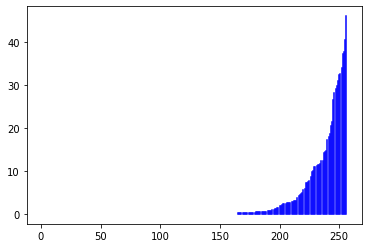

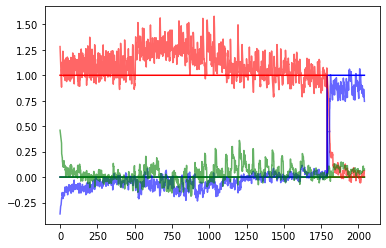

 18%|███████████████████████████▎                                                                                                                               | 529/3000 [3:07:10<13:42:59, 19.98s/it]

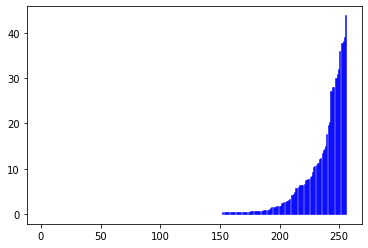

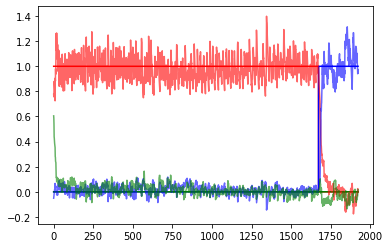

 18%|███████████████████████████▌                                                                                                                               | 534/3000 [3:08:51<13:33:57, 19.80s/it]

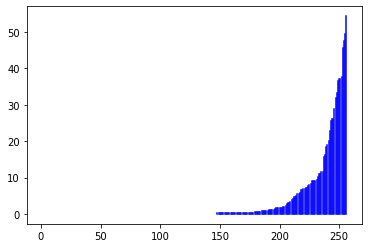

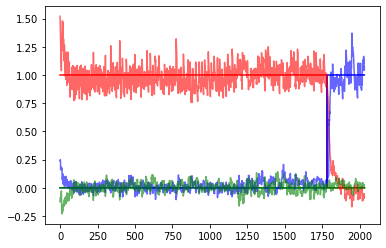

 18%|███████████████████████████▊                                                                                                                               | 539/3000 [3:10:31<13:24:41, 19.62s/it]

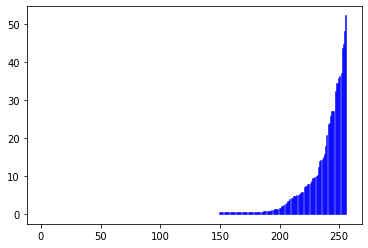

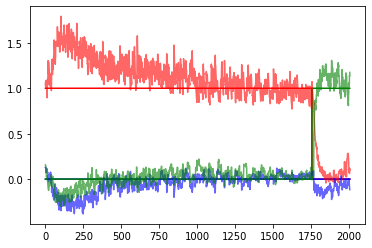

 18%|████████████████████████████                                                                                                                               | 544/3000 [3:12:10<13:24:35, 19.66s/it]

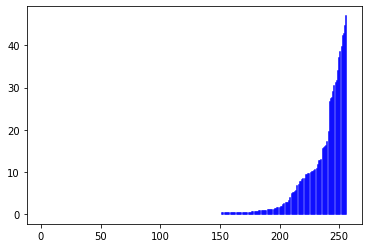

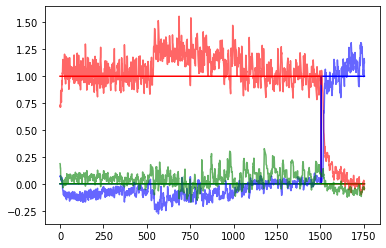

 18%|████████████████████████████▎                                                                                                                              | 549/3000 [3:13:53<13:29:27, 19.82s/it]

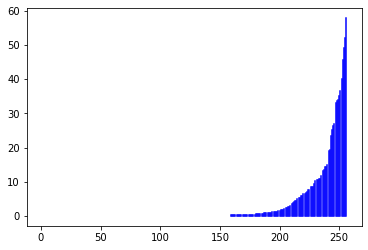

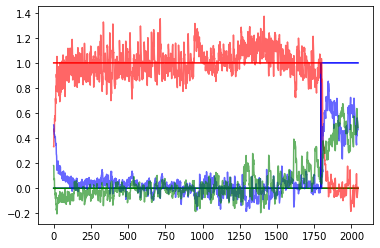

 18%|████████████████████████████▌                                                                                                                              | 554/3000 [3:16:23<15:45:21, 23.19s/it]

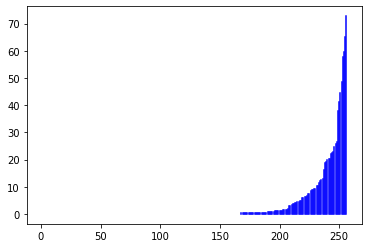

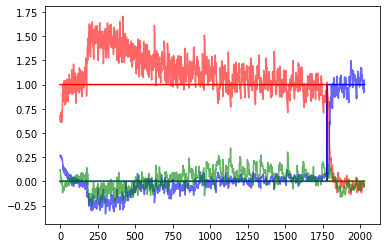

 19%|████████████████████████████▉                                                                                                                              | 559/3000 [3:18:04<13:38:33, 20.12s/it]

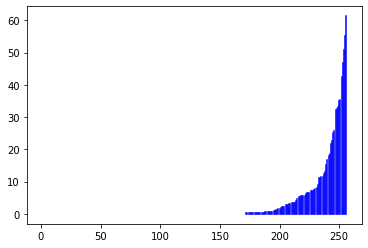

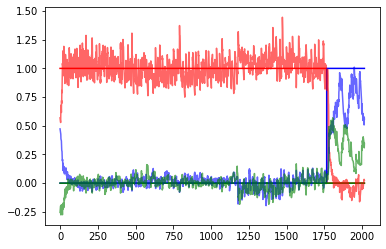

 19%|█████████████████████████████▏                                                                                                                             | 564/3000 [3:19:46<13:49:37, 20.43s/it]

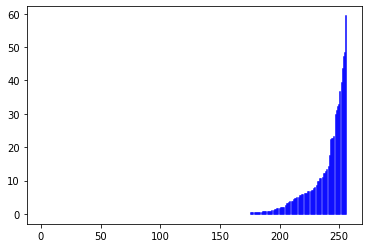

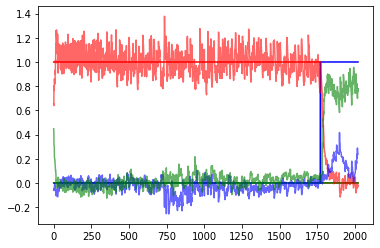

 19%|█████████████████████████████▍                                                                                                                             | 569/3000 [3:21:28<13:24:49, 19.86s/it]

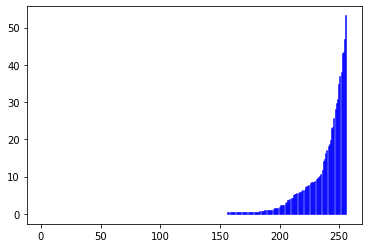

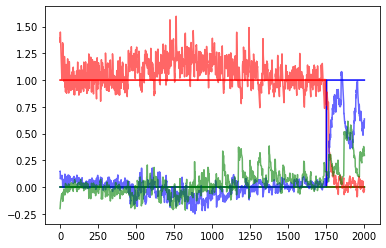

 19%|█████████████████████████████▋                                                                                                                             | 574/3000 [3:23:07<13:02:52, 19.36s/it]

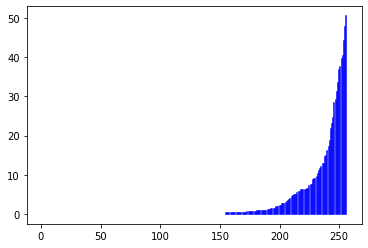

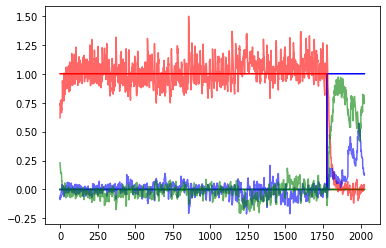

 19%|█████████████████████████████▉                                                                                                                             | 579/3000 [3:24:50<13:35:23, 20.21s/it]

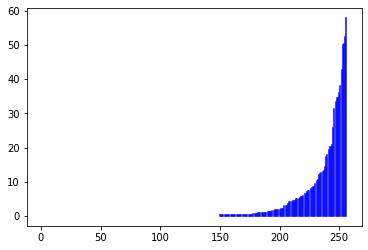

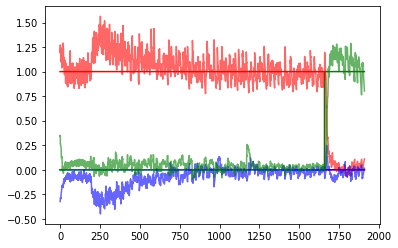

 19%|██████████████████████████████▏                                                                                                                            | 584/3000 [3:26:31<13:11:58, 19.67s/it]

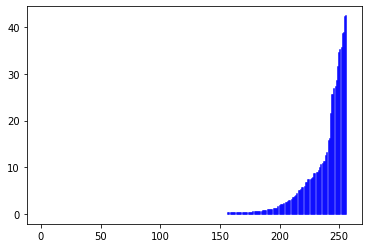

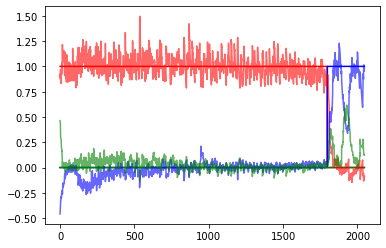

 20%|██████████████████████████████▍                                                                                                                            | 589/3000 [3:28:10<13:07:05, 19.59s/it]

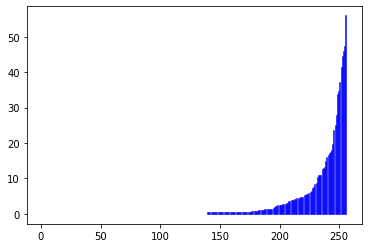

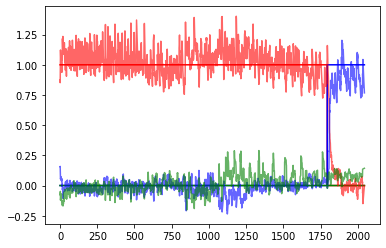

 20%|██████████████████████████████▋                                                                                                                            | 594/3000 [3:29:49<12:44:50, 19.07s/it]

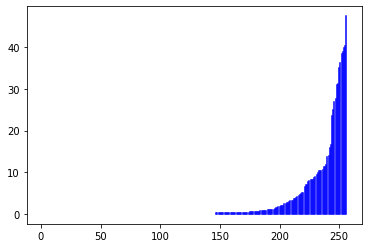

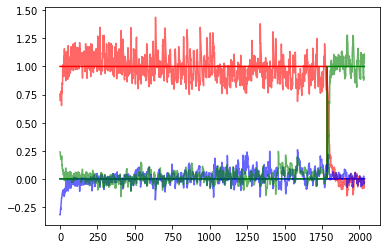

 20%|██████████████████████████████▉                                                                                                                            | 599/3000 [3:31:29<12:55:03, 19.37s/it]

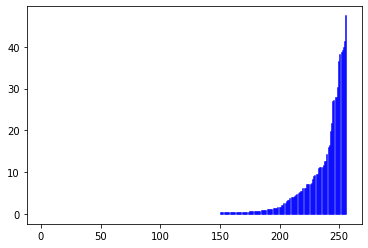

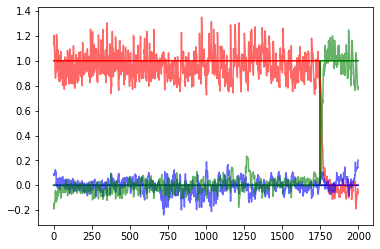

 20%|███████████████████████████████▏                                                                                                                           | 604/3000 [3:34:01<15:41:02, 23.57s/it]

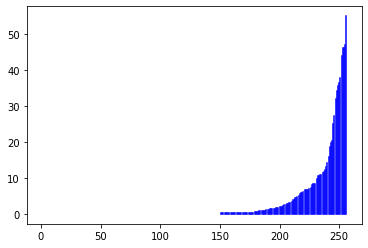

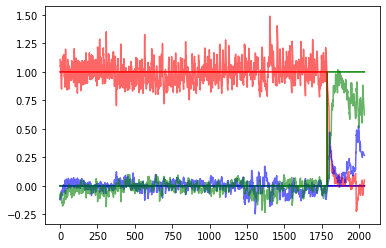

 20%|███████████████████████████████▍                                                                                                                           | 609/3000 [3:35:42<13:35:43, 20.47s/it]

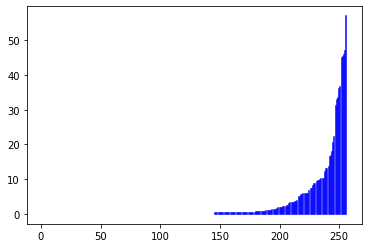

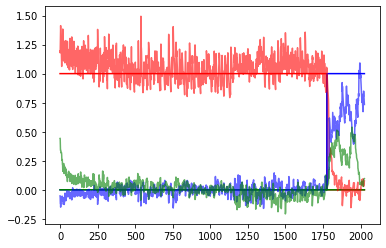

 20%|███████████████████████████████▋                                                                                                                           | 614/3000 [3:37:24<13:03:51, 19.71s/it]

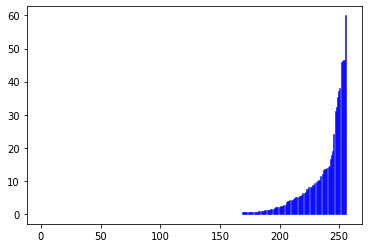

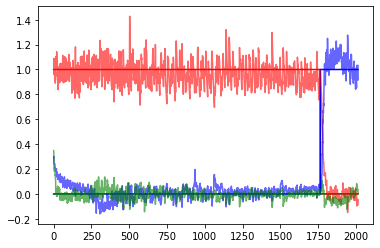

 21%|███████████████████████████████▉                                                                                                                           | 619/3000 [3:39:04<13:12:34, 19.97s/it]

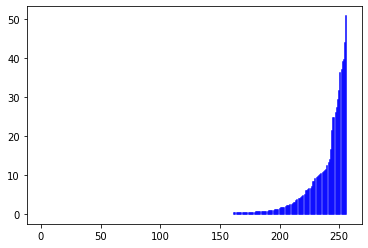

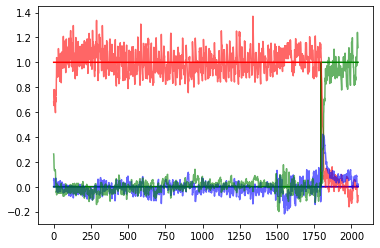

 21%|████████████████████████████████▏                                                                                                                          | 624/3000 [3:40:43<12:54:30, 19.56s/it]

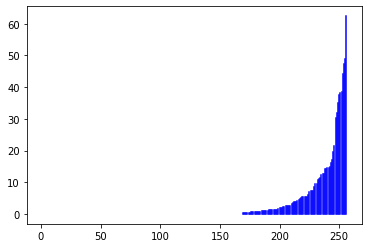

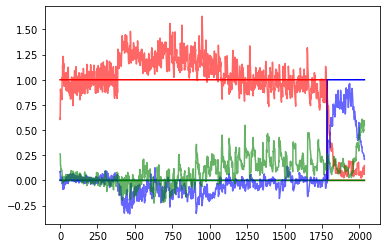

 21%|████████████████████████████████▍                                                                                                                          | 629/3000 [3:42:26<13:10:38, 20.01s/it]

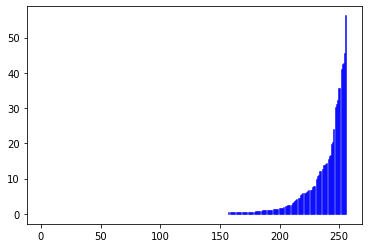

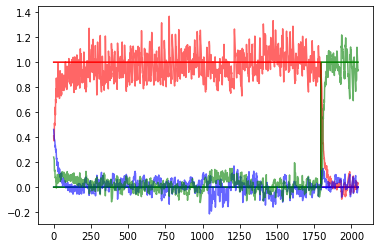

 21%|████████████████████████████████▊                                                                                                                          | 634/3000 [3:44:07<12:47:17, 19.46s/it]

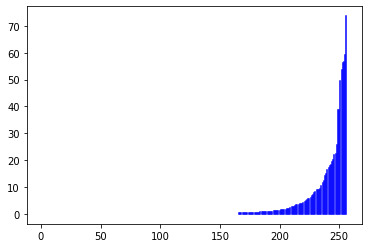

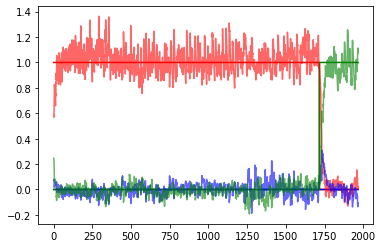

 21%|█████████████████████████████████                                                                                                                          | 639/3000 [3:45:44<12:07:31, 18.49s/it]

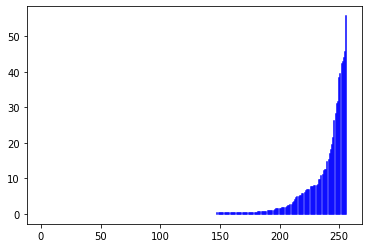

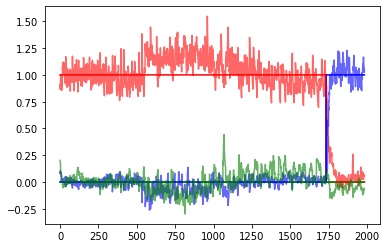

 21%|█████████████████████████████████▎                                                                                                                         | 644/3000 [3:47:24<12:30:28, 19.11s/it]

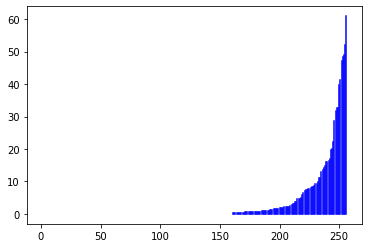

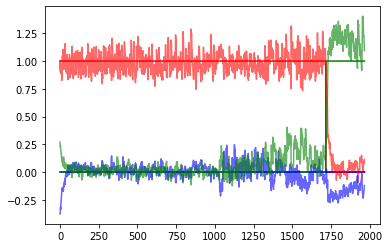

 22%|█████████████████████████████████▌                                                                                                                         | 649/3000 [3:49:06<13:01:55, 19.96s/it]

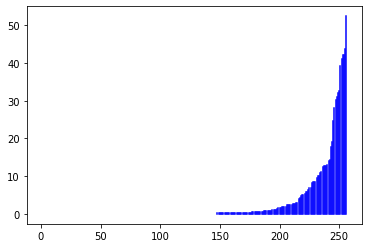

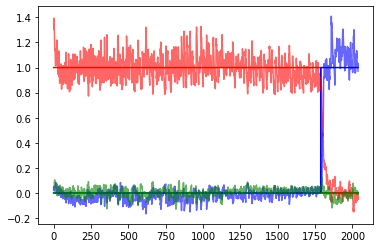

 22%|█████████████████████████████████▊                                                                                                                         | 654/3000 [3:51:38<15:33:33, 23.88s/it]

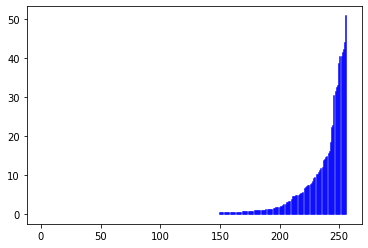

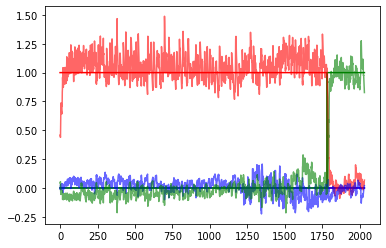

 22%|██████████████████████████████████                                                                                                                         | 659/3000 [3:53:24<13:45:59, 21.17s/it]

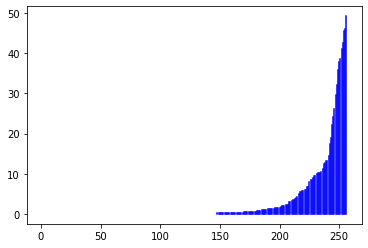

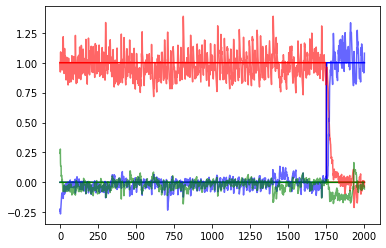

 22%|██████████████████████████████████▎                                                                                                                        | 664/3000 [3:55:05<13:03:17, 20.12s/it]

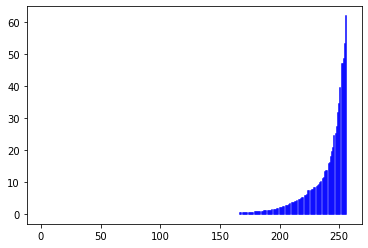

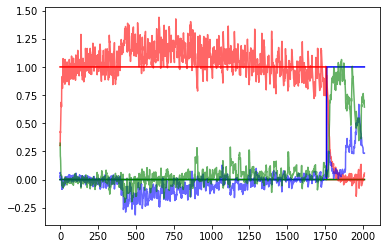

 22%|██████████████████████████████████▌                                                                                                                        | 669/3000 [3:56:43<12:13:23, 18.88s/it]

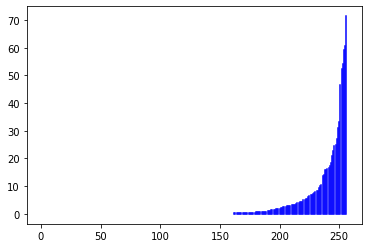

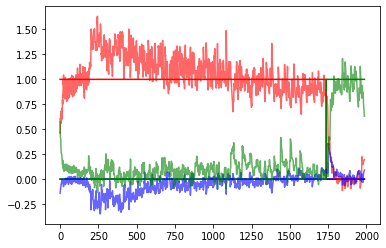

 22%|██████████████████████████████████▊                                                                                                                        | 674/3000 [3:58:21<12:12:02, 18.88s/it]

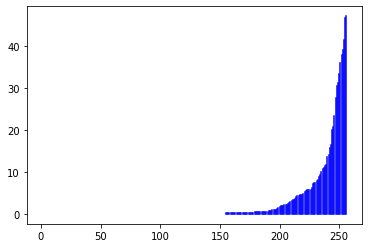

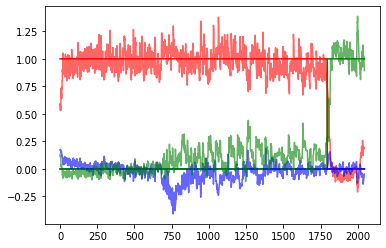

 23%|███████████████████████████████████                                                                                                                        | 679/3000 [4:00:02<12:43:23, 19.73s/it]

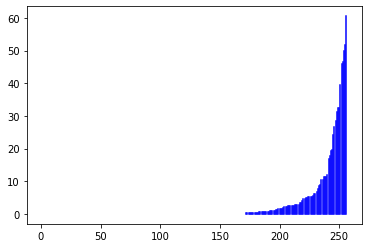

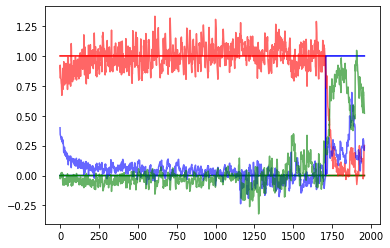

 23%|███████████████████████████████████▎                                                                                                                       | 684/3000 [4:01:39<12:37:56, 19.64s/it]

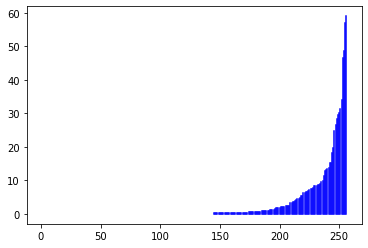

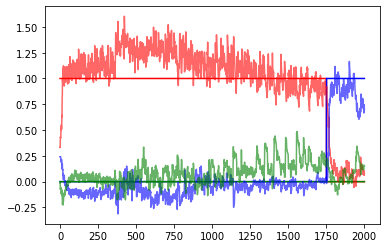

 23%|███████████████████████████████████▌                                                                                                                       | 689/3000 [4:03:20<12:37:34, 19.67s/it]

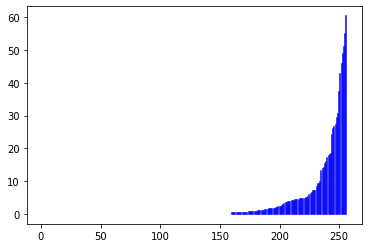

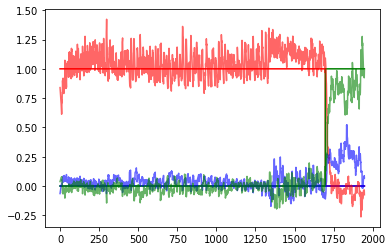

 23%|███████████████████████████████████▊                                                                                                                       | 694/3000 [4:05:03<12:41:18, 19.81s/it]

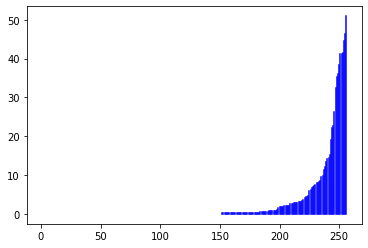

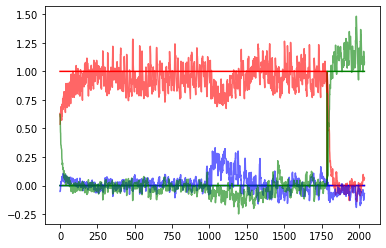

 23%|████████████████████████████████████                                                                                                                       | 699/3000 [4:06:43<12:27:27, 19.49s/it]

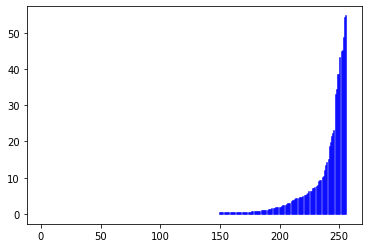

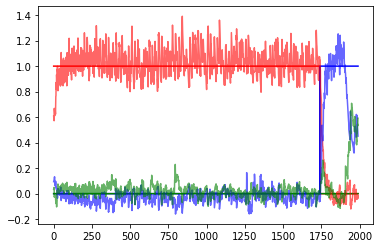

 23%|████████████████████████████████████▎                                                                                                                      | 704/3000 [4:09:16<14:58:37, 23.48s/it]

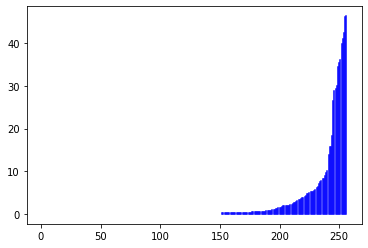

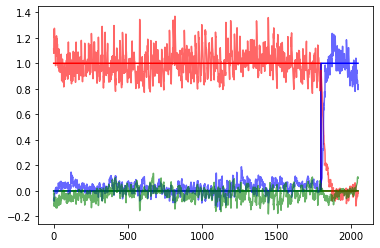

 24%|████████████████████████████████████▋                                                                                                                      | 709/3000 [4:10:53<12:35:24, 19.78s/it]

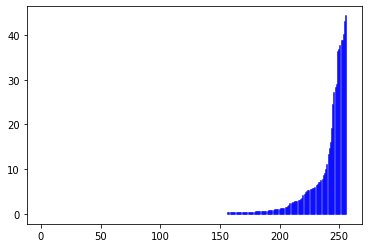

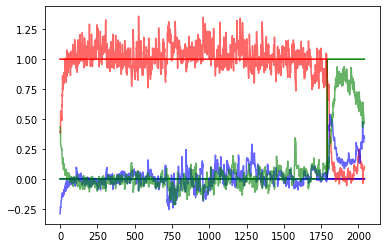

 24%|████████████████████████████████████▉                                                                                                                      | 714/3000 [4:12:34<12:41:49, 20.00s/it]

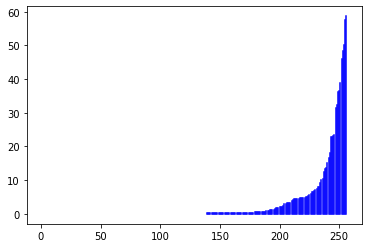

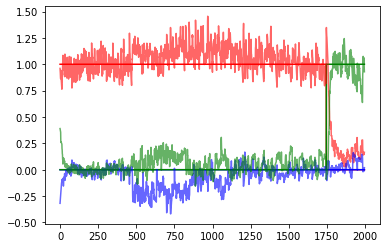

 24%|█████████████████████████████████████▏                                                                                                                     | 719/3000 [4:14:17<12:32:31, 19.79s/it]

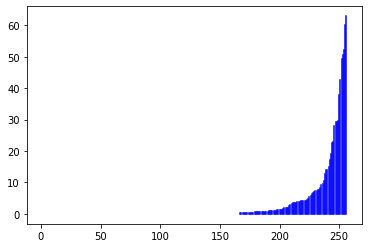

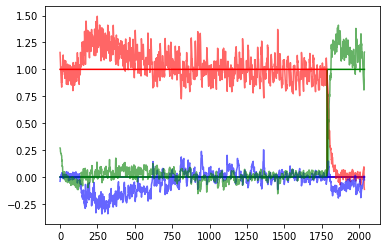

 24%|█████████████████████████████████████▍                                                                                                                     | 724/3000 [4:16:02<12:43:34, 20.13s/it]

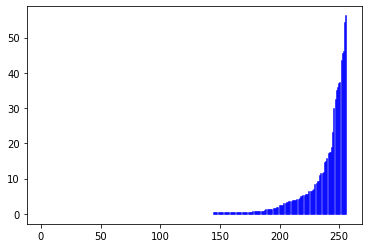

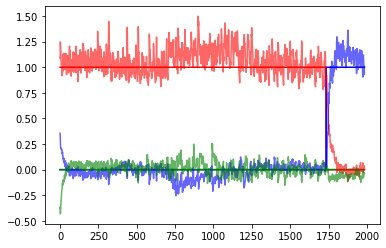

 24%|█████████████████████████████████████▋                                                                                                                     | 729/3000 [4:17:44<12:43:48, 20.18s/it]

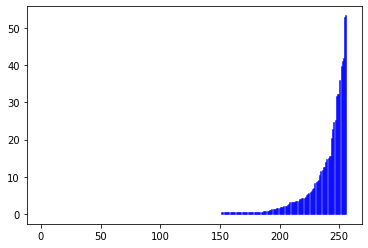

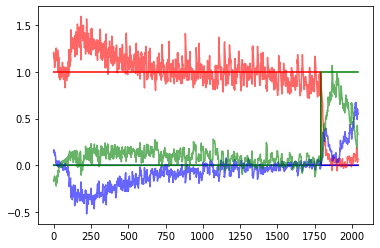

 24%|█████████████████████████████████████▉                                                                                                                     | 734/3000 [4:19:24<12:22:22, 19.66s/it]

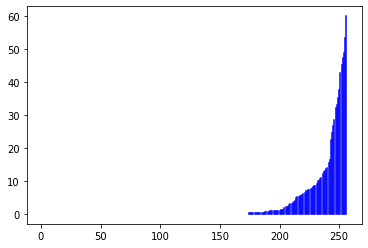

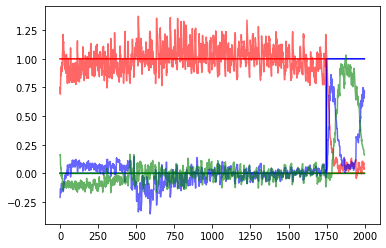

 25%|██████████████████████████████████████▏                                                                                                                    | 739/3000 [4:20:59<12:10:40, 19.39s/it]

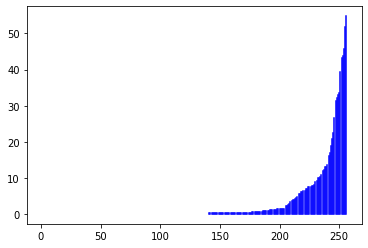

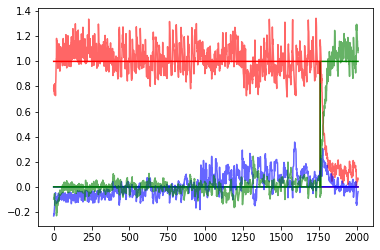

 25%|██████████████████████████████████████▍                                                                                                                    | 744/3000 [4:22:41<12:19:12, 19.66s/it]

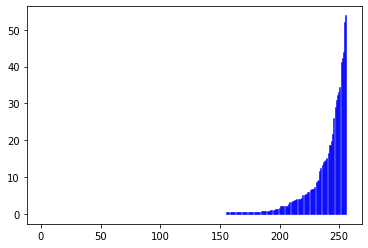

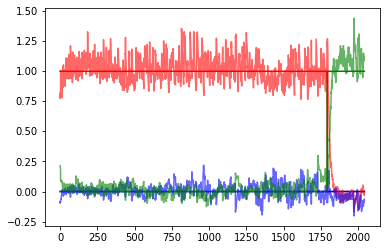

 25%|██████████████████████████████████████▋                                                                                                                    | 749/3000 [4:24:23<12:27:22, 19.92s/it]

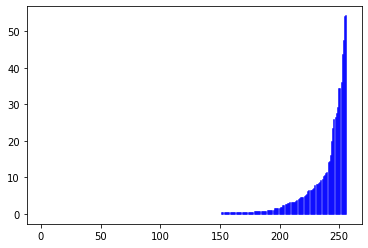

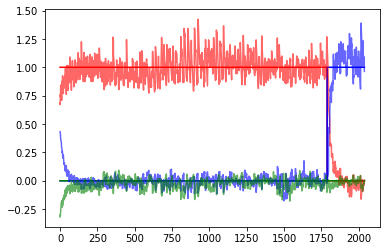

 25%|██████████████████████████████████████▉                                                                                                                    | 754/3000 [4:26:52<14:15:36, 22.86s/it]

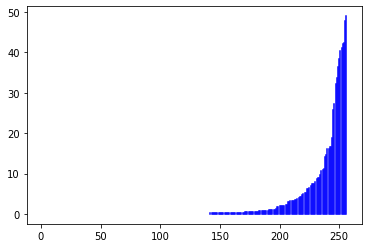

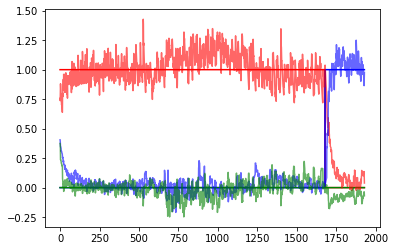

 25%|███████████████████████████████████████▏                                                                                                                   | 759/3000 [4:28:34<12:45:44, 20.50s/it]

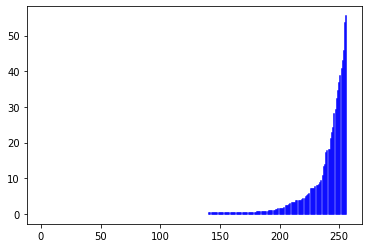

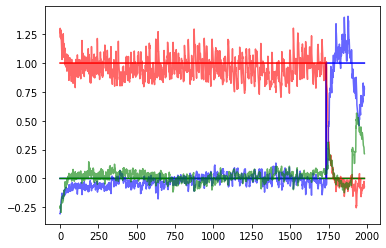

 25%|███████████████████████████████████████▍                                                                                                                   | 764/3000 [4:30:12<12:13:34, 19.68s/it]

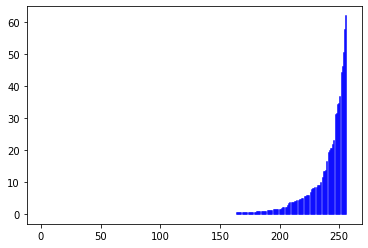

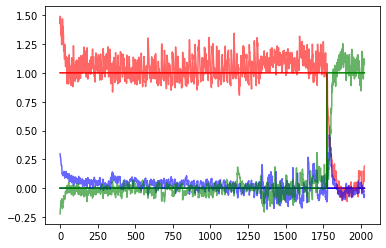

 26%|███████████████████████████████████████▋                                                                                                                   | 769/3000 [4:31:52<12:00:58, 19.39s/it]

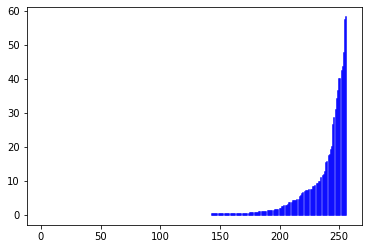

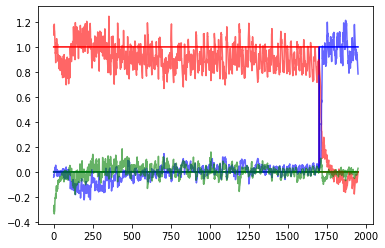

 26%|███████████████████████████████████████▉                                                                                                                   | 774/3000 [4:33:34<12:30:01, 20.22s/it]

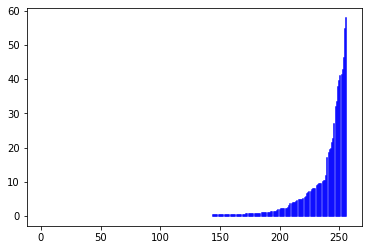

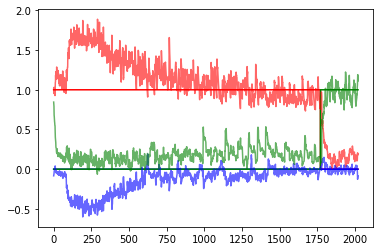

 26%|████████████████████████████████████████▏                                                                                                                  | 779/3000 [4:35:18<12:22:41, 20.06s/it]

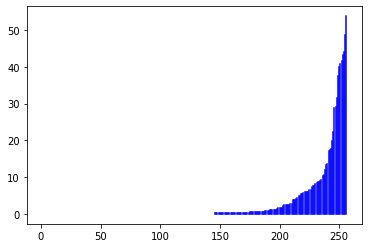

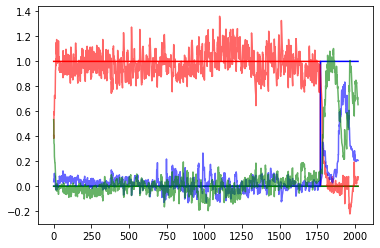

 26%|████████████████████████████████████████▌                                                                                                                  | 784/3000 [4:37:04<12:44:37, 20.70s/it]

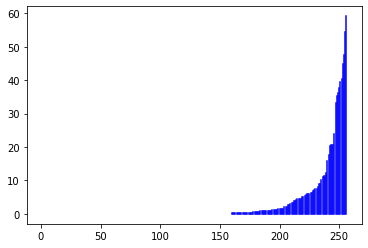

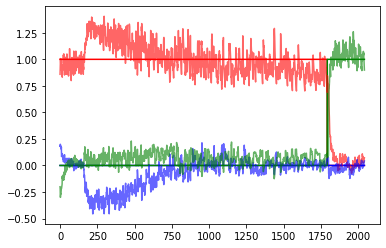

 26%|████████████████████████████████████████▊                                                                                                                  | 789/3000 [4:38:44<12:01:25, 19.58s/it]

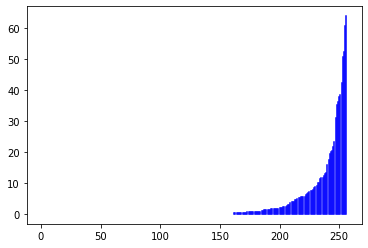

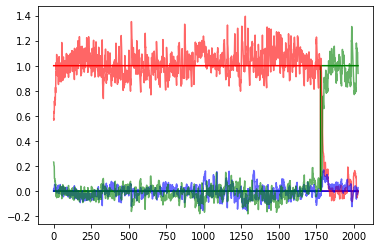

 26%|█████████████████████████████████████████                                                                                                                  | 794/3000 [4:40:27<12:11:49, 19.90s/it]

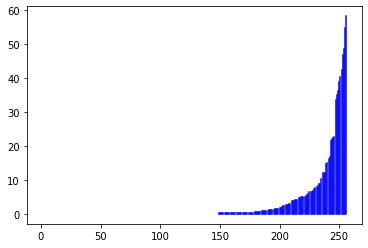

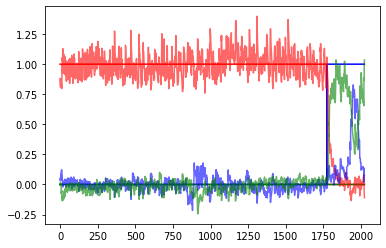

 27%|█████████████████████████████████████████▎                                                                                                                 | 799/3000 [4:42:02<11:39:59, 19.08s/it]

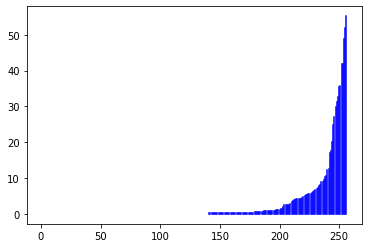

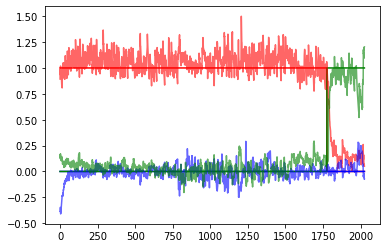

 27%|█████████████████████████████████████████▌                                                                                                                 | 804/3000 [4:44:35<14:13:39, 23.32s/it]

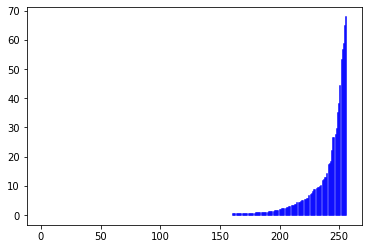

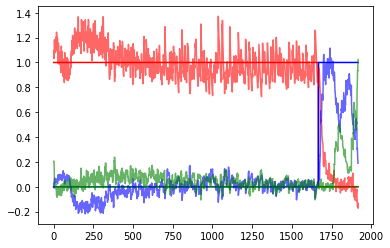

 27%|█████████████████████████████████████████▊                                                                                                                 | 809/3000 [4:46:14<12:08:23, 19.95s/it]

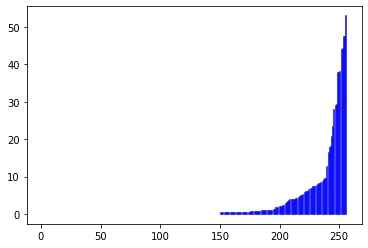

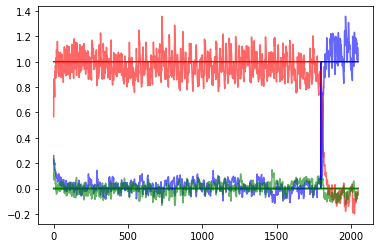

 27%|██████████████████████████████████████████                                                                                                                 | 814/3000 [4:47:57<12:23:44, 20.41s/it]

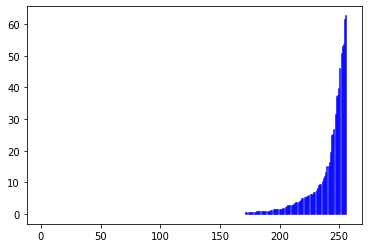

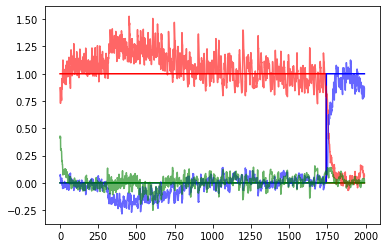

 27%|██████████████████████████████████████████▎                                                                                                                | 819/3000 [4:49:39<12:04:32, 19.93s/it]

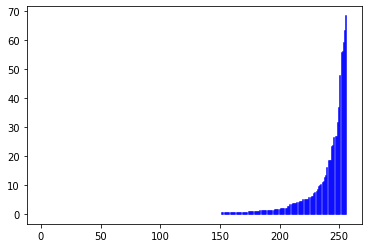

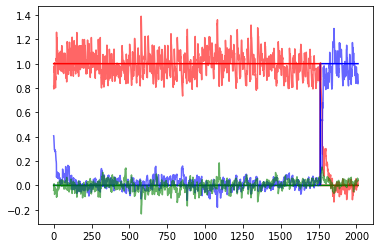

 27%|██████████████████████████████████████████▌                                                                                                                | 824/3000 [4:51:23<12:10:34, 20.14s/it]

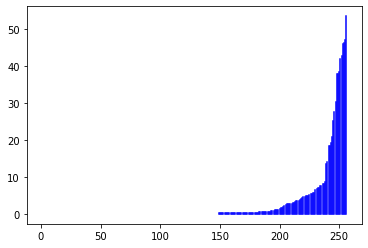

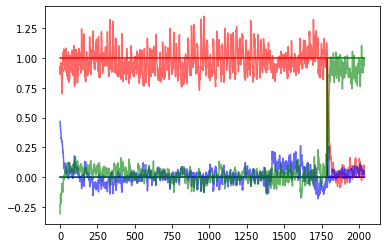

 28%|██████████████████████████████████████████▊                                                                                                                | 829/3000 [4:53:03<11:34:55, 19.21s/it]

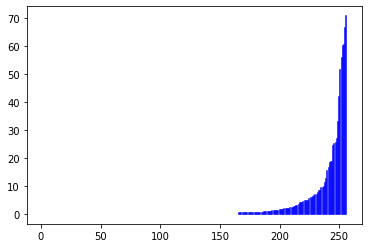

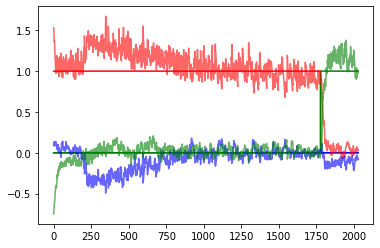

 28%|███████████████████████████████████████████                                                                                                                | 834/3000 [4:54:45<11:53:22, 19.76s/it]

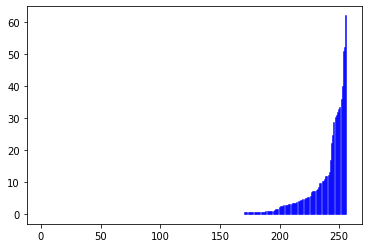

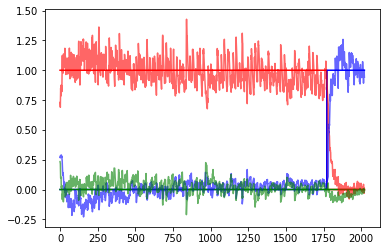

 28%|███████████████████████████████████████████▎                                                                                                               | 839/3000 [4:56:28<11:55:59, 19.88s/it]

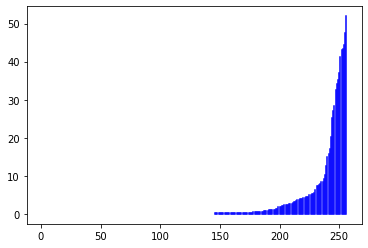

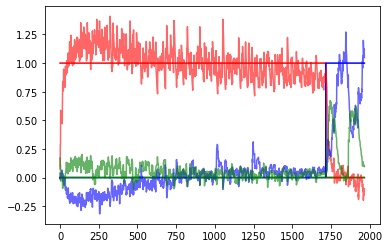

 28%|███████████████████████████████████████████▌                                                                                                               | 844/3000 [4:58:07<11:31:38, 19.25s/it]

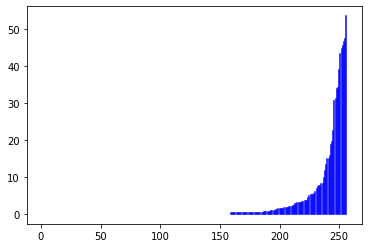

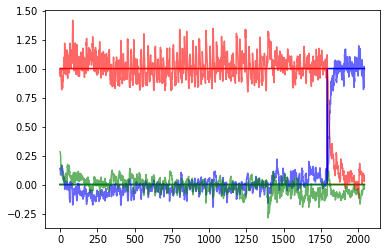

 28%|███████████████████████████████████████████▊                                                                                                               | 849/3000 [4:59:50<12:02:11, 20.14s/it]

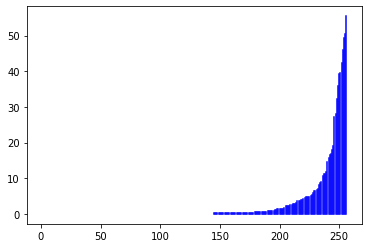

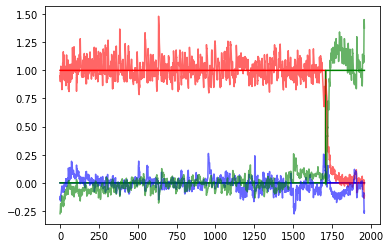

 28%|████████████████████████████████████████████                                                                                                               | 854/3000 [5:02:22<13:57:39, 23.42s/it]

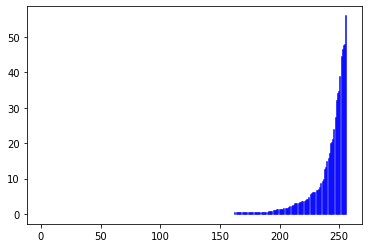

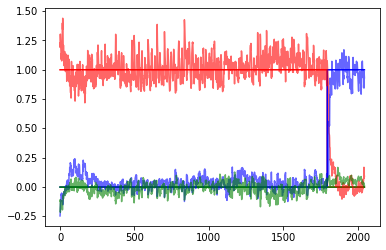

 29%|████████████████████████████████████████████▍                                                                                                              | 859/3000 [5:04:06<12:23:39, 20.84s/it]

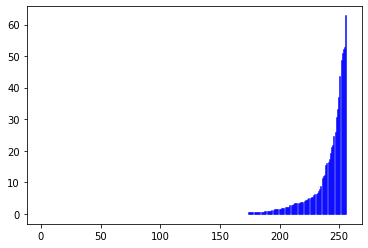

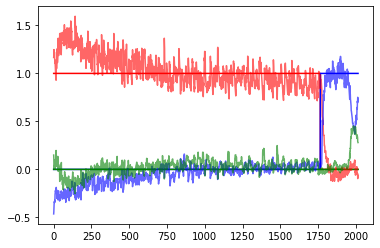

 29%|████████████████████████████████████████████▋                                                                                                              | 864/3000 [5:05:47<11:50:18, 19.95s/it]

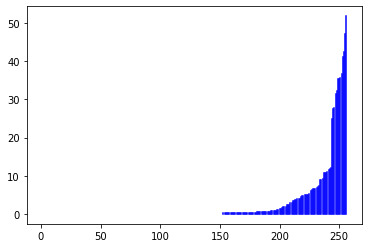

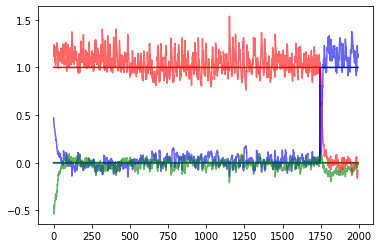

 29%|████████████████████████████████████████████▉                                                                                                              | 869/3000 [5:07:26<11:28:59, 19.40s/it]

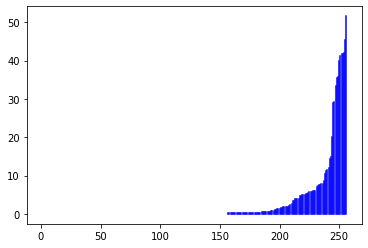

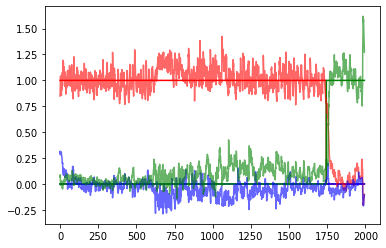

 29%|█████████████████████████████████████████████▏                                                                                                             | 874/3000 [5:09:10<12:05:36, 20.48s/it]

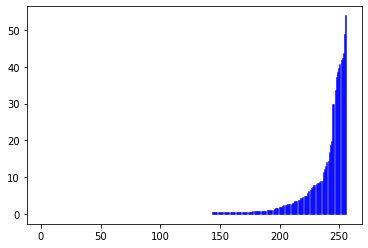

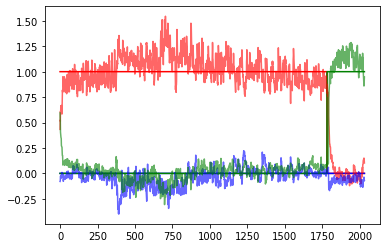

 29%|█████████████████████████████████████████████▍                                                                                                             | 879/3000 [5:10:49<11:22:32, 19.31s/it]

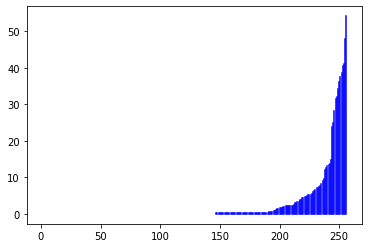

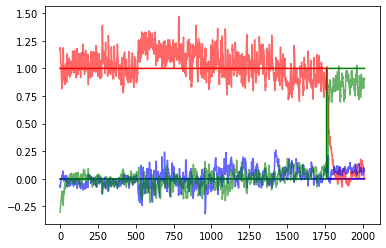

 29%|█████████████████████████████████████████████▋                                                                                                             | 884/3000 [5:12:30<11:43:33, 19.95s/it]

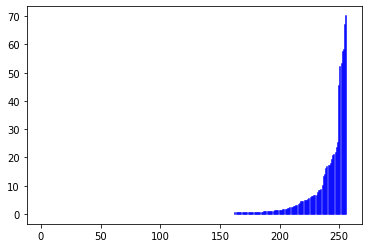

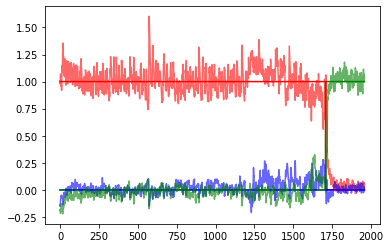

 30%|█████████████████████████████████████████████▉                                                                                                             | 889/3000 [5:14:12<11:38:17, 19.85s/it]

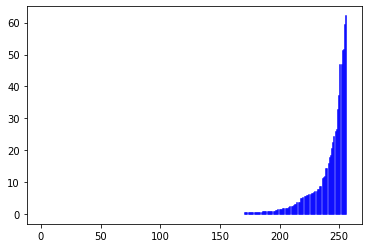

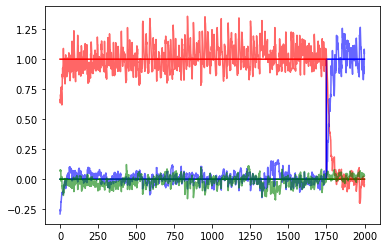

 30%|██████████████████████████████████████████████▏                                                                                                            | 894/3000 [5:15:54<11:41:56, 20.00s/it]

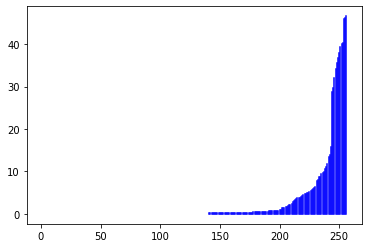

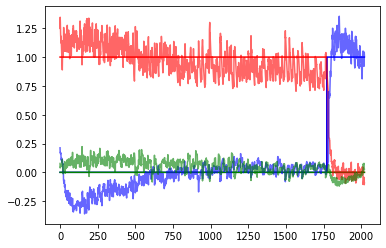

 30%|██████████████████████████████████████████████▍                                                                                                            | 899/3000 [5:17:36<11:25:50, 19.59s/it]

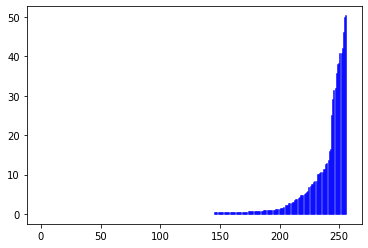

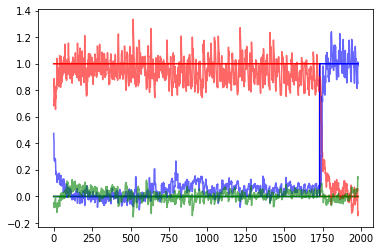

 30%|██████████████████████████████████████████████▋                                                                                                            | 904/3000 [5:20:02<13:20:01, 22.90s/it]

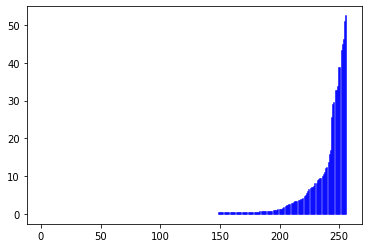

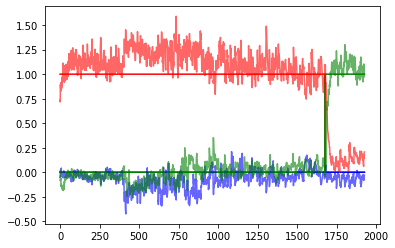

 30%|██████████████████████████████████████████████▉                                                                                                            | 909/3000 [5:21:44<11:45:01, 20.23s/it]

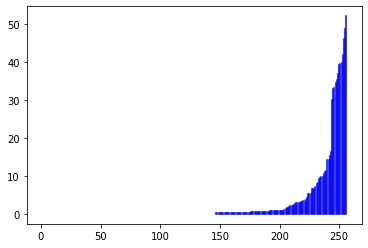

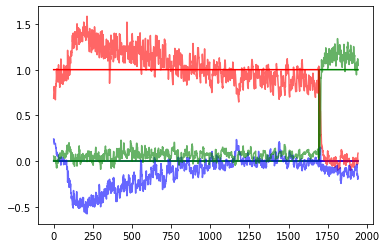

 30%|███████████████████████████████████████████████▏                                                                                                           | 914/3000 [5:23:27<11:37:44, 20.07s/it]

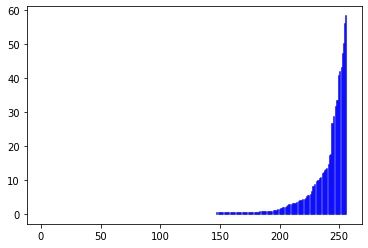

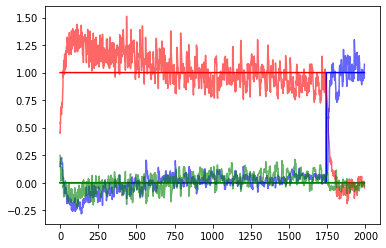

 31%|███████████████████████████████████████████████▍                                                                                                           | 919/3000 [5:25:04<11:01:58, 19.09s/it]

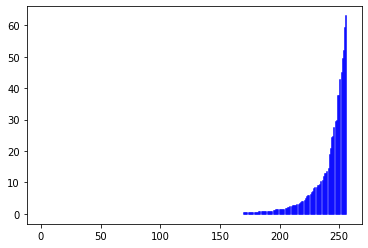

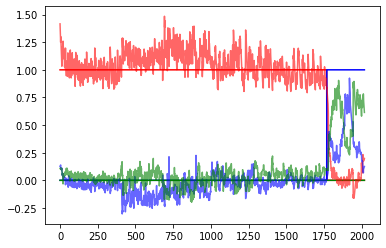

 31%|███████████████████████████████████████████████▋                                                                                                           | 924/3000 [5:26:48<11:33:42, 20.05s/it]

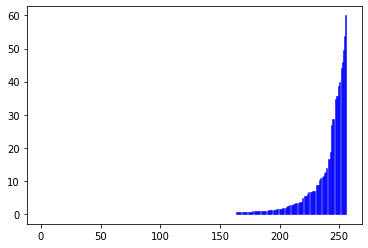

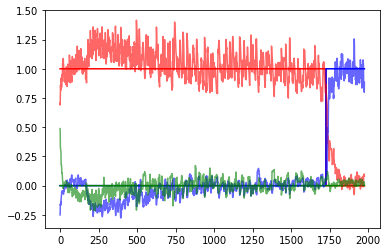

 31%|███████████████████████████████████████████████▉                                                                                                           | 929/3000 [5:28:28<11:24:25, 19.83s/it]

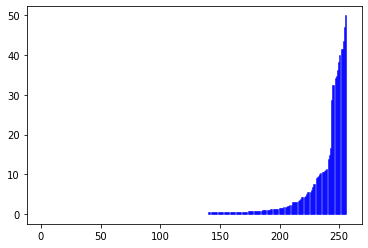

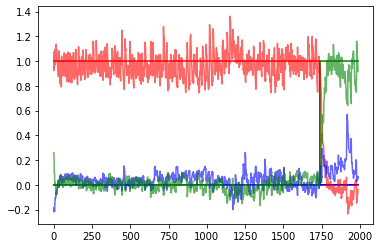

 31%|████████████████████████████████████████████████▎                                                                                                          | 934/3000 [5:30:06<11:04:27, 19.30s/it]

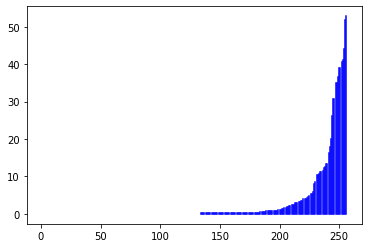

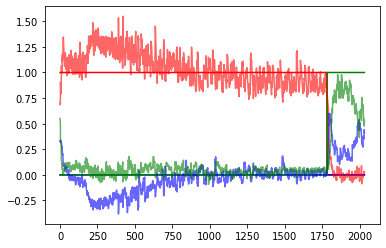

 31%|████████████████████████████████████████████████▌                                                                                                          | 939/3000 [5:31:49<11:30:01, 20.09s/it]

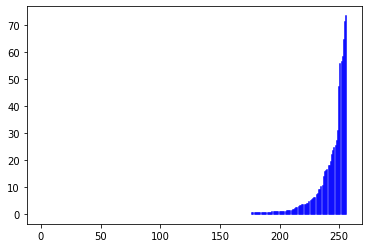

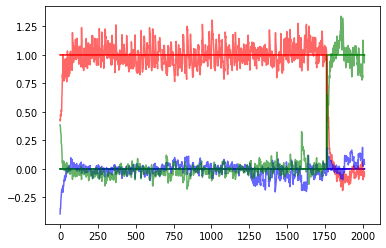

 31%|████████████████████████████████████████████████▊                                                                                                          | 944/3000 [5:33:34<11:38:44, 20.39s/it]

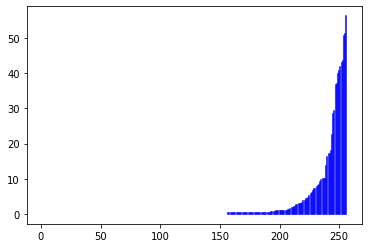

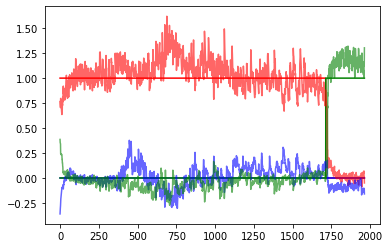

 32%|█████████████████████████████████████████████████                                                                                                          | 949/3000 [5:35:16<11:35:24, 20.34s/it]

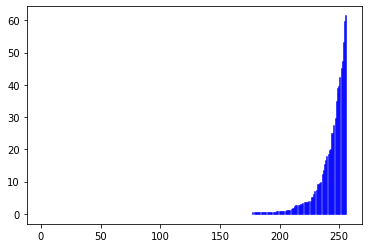

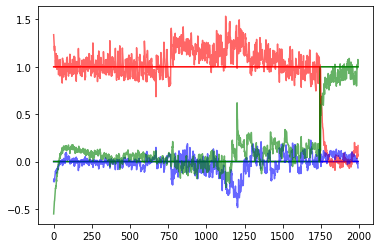

 32%|█████████████████████████████████████████████████▎                                                                                                         | 954/3000 [5:37:41<13:00:10, 22.88s/it]

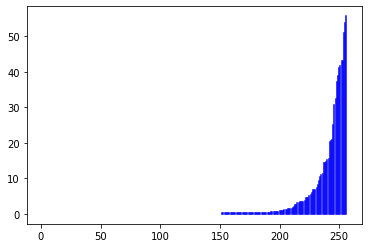

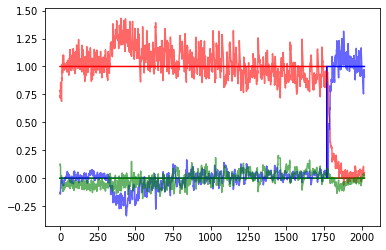

 32%|█████████████████████████████████████████████████▌                                                                                                         | 959/3000 [5:39:20<11:09:39, 19.69s/it]

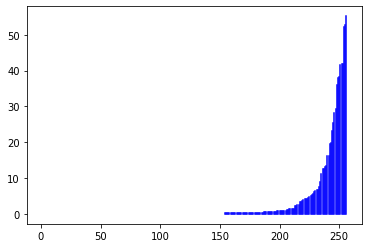

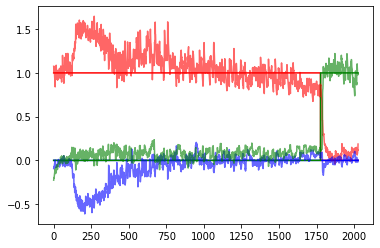

 32%|█████████████████████████████████████████████████▊                                                                                                         | 964/3000 [5:41:03<11:08:21, 19.70s/it]

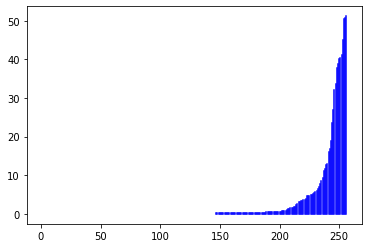

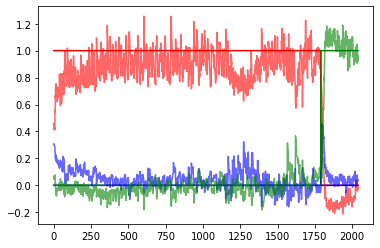

 32%|██████████████████████████████████████████████████                                                                                                         | 969/3000 [5:42:44<11:14:02, 19.91s/it]

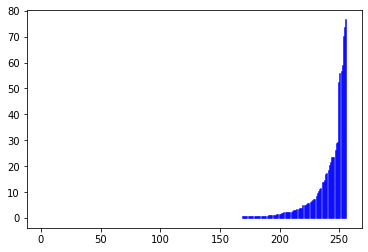

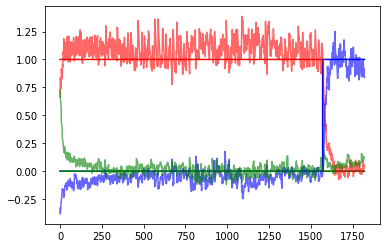

 32%|██████████████████████████████████████████████████▎                                                                                                        | 974/3000 [5:44:26<11:18:55, 20.11s/it]

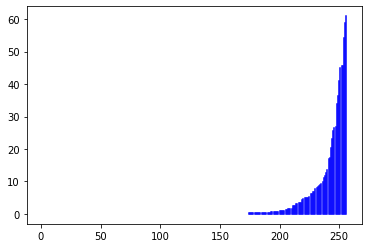

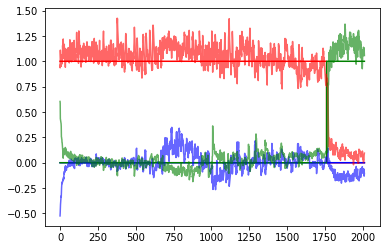

 33%|██████████████████████████████████████████████████▌                                                                                                        | 979/3000 [5:46:08<11:01:54, 19.65s/it]

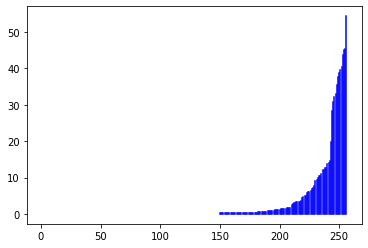

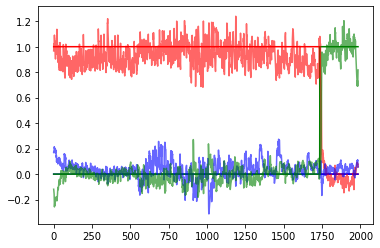

 33%|██████████████████████████████████████████████████▊                                                                                                        | 984/3000 [5:47:51<11:14:30, 20.07s/it]

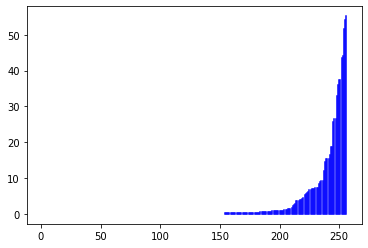

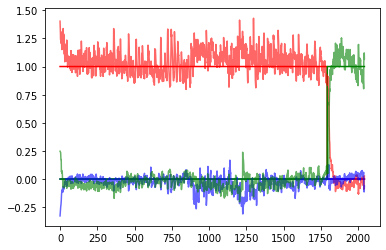

 33%|███████████████████████████████████████████████████                                                                                                        | 989/3000 [5:49:36<11:12:06, 20.05s/it]

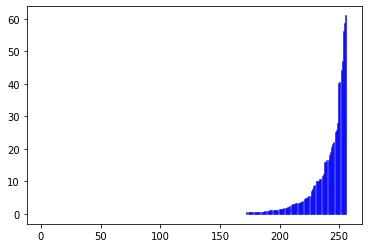

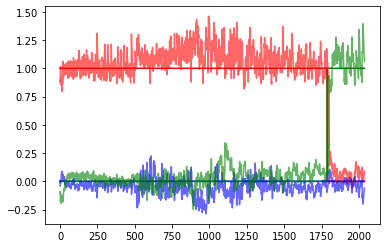

 33%|███████████████████████████████████████████████████▎                                                                                                       | 994/3000 [5:51:17<11:00:00, 19.74s/it]

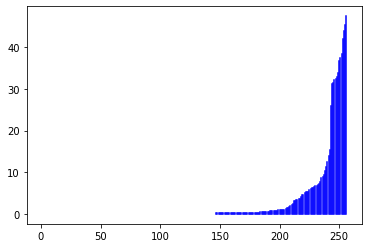

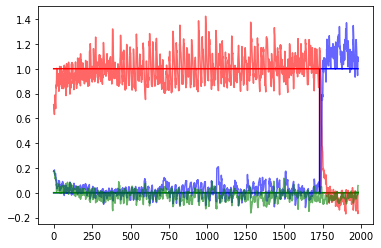

 33%|███████████████████████████████████████████████████▌                                                                                                       | 999/3000 [5:53:01<11:08:32, 20.05s/it]

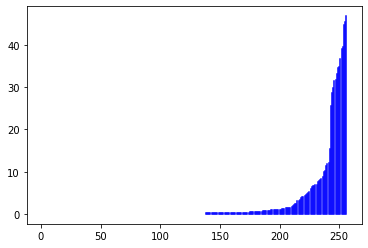

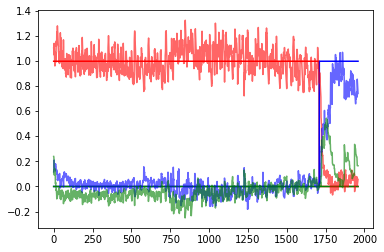

 33%|███████████████████████████████████████████████████▌                                                                                                      | 1004/3000 [5:55:34<13:02:17, 23.52s/it]

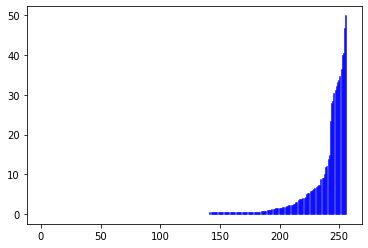

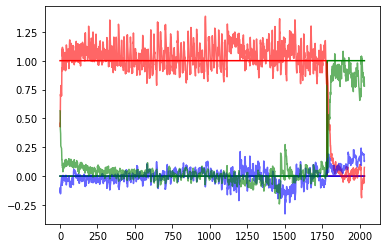

 34%|███████████████████████████████████████████████████▊                                                                                                      | 1009/3000 [5:57:15<11:14:14, 20.32s/it]

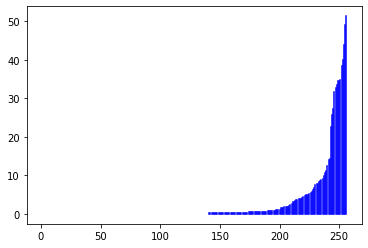

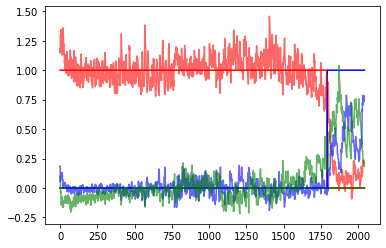

 34%|████████████████████████████████████████████████████                                                                                                      | 1014/3000 [5:58:54<10:30:05, 19.04s/it]

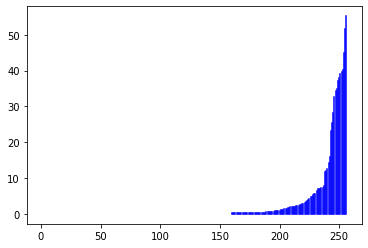

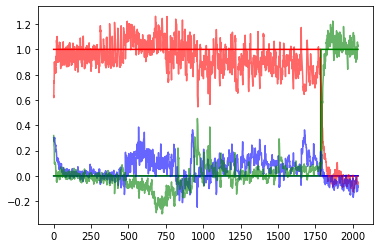

 34%|████████████████████████████████████████████████████▎                                                                                                     | 1019/3000 [6:00:31<10:34:13, 19.21s/it]

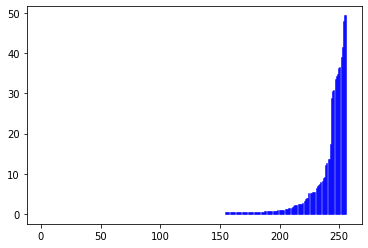

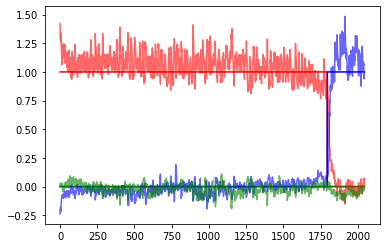

 34%|████████████████████████████████████████████████████▌                                                                                                     | 1024/3000 [6:02:14<10:49:08, 19.71s/it]

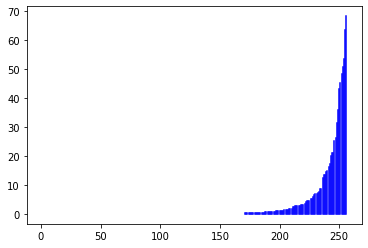

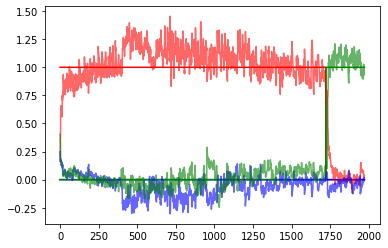

 34%|████████████████████████████████████████████████████▊                                                                                                     | 1029/3000 [6:03:59<11:17:13, 20.62s/it]

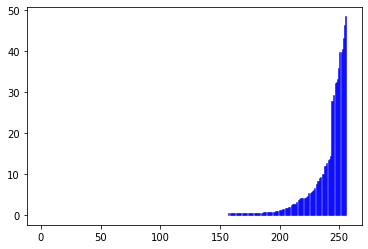

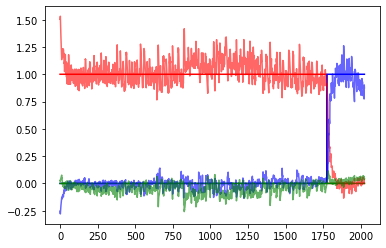

 34%|█████████████████████████████████████████████████████                                                                                                     | 1034/3000 [6:05:37<10:32:13, 19.30s/it]

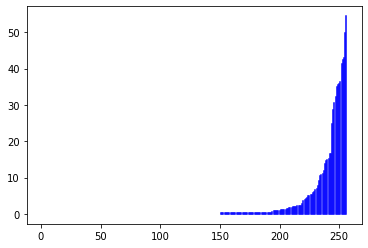

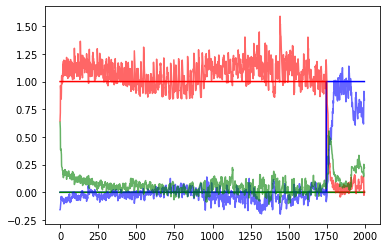

 35%|█████████████████████████████████████████████████████▎                                                                                                    | 1039/3000 [6:07:12<10:00:38, 18.38s/it]

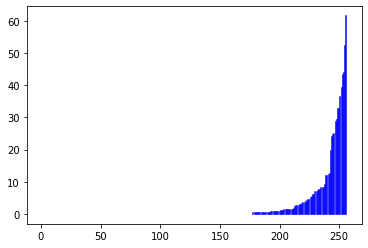

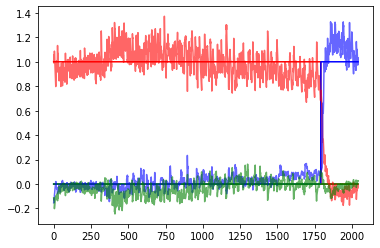

 35%|█████████████████████████████████████████████████████▌                                                                                                    | 1044/3000 [6:08:48<10:08:10, 18.66s/it]

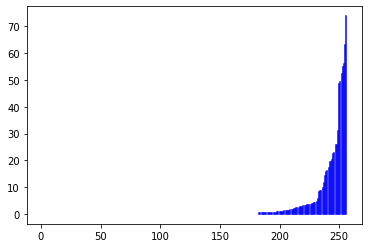

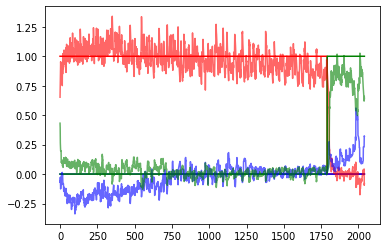

 35%|█████████████████████████████████████████████████████▊                                                                                                    | 1049/3000 [6:10:24<10:24:25, 19.20s/it]

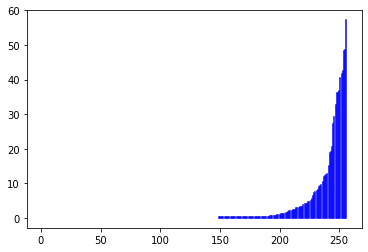

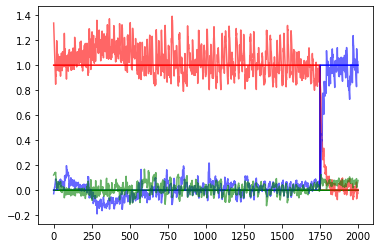

 35%|██████████████████████████████████████████████████████                                                                                                    | 1054/3000 [6:12:54<12:33:47, 23.24s/it]

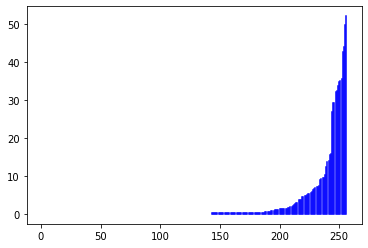

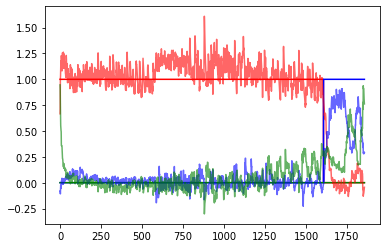

 35%|██████████████████████████████████████████████████████▎                                                                                                   | 1059/3000 [6:14:37<11:05:04, 20.56s/it]

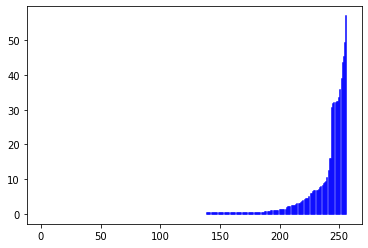

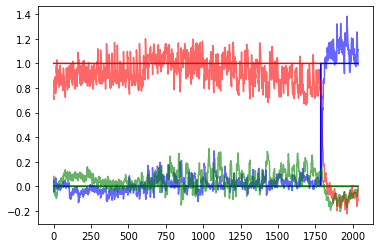

 35%|██████████████████████████████████████████████████████▌                                                                                                   | 1064/3000 [6:16:14<10:26:19, 19.41s/it]

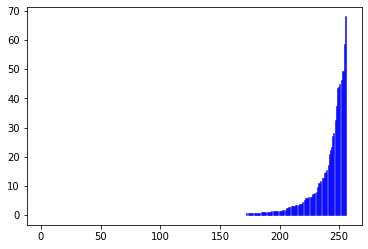

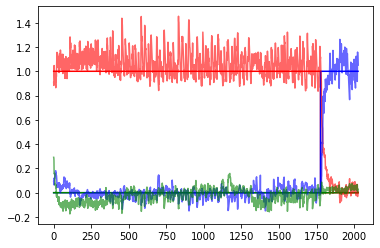

 36%|██████████████████████████████████████████████████████▉                                                                                                   | 1069/3000 [6:17:55<10:39:14, 19.86s/it]

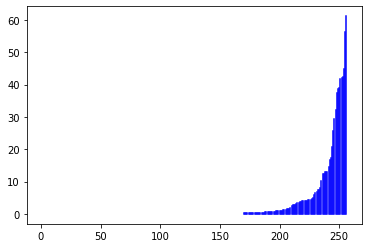

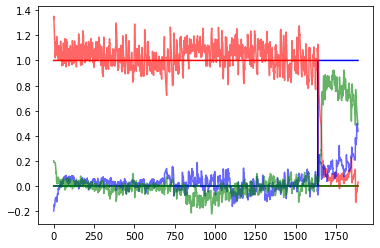

 36%|███████████████████████████████████████████████████████▏                                                                                                  | 1074/3000 [6:19:36<10:44:13, 20.07s/it]

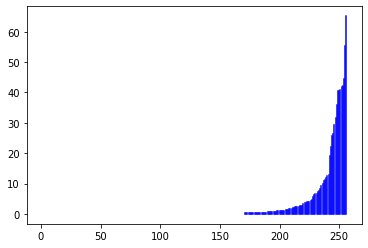

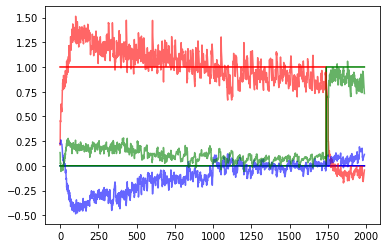

 36%|███████████████████████████████████████████████████████▍                                                                                                  | 1079/3000 [6:21:18<10:35:00, 19.83s/it]

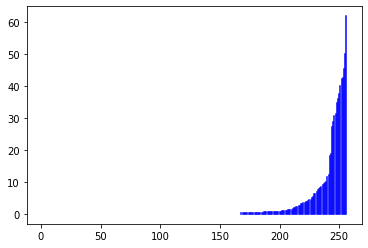

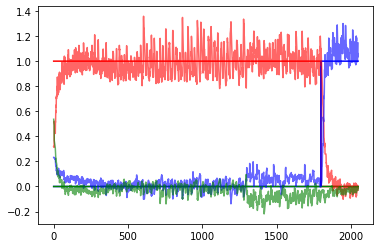

 36%|███████████████████████████████████████████████████████▋                                                                                                  | 1084/3000 [6:23:05<10:59:39, 20.66s/it]

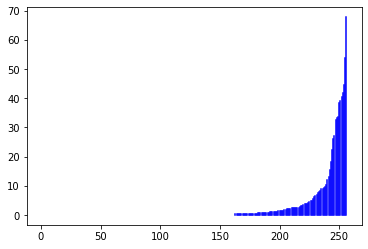

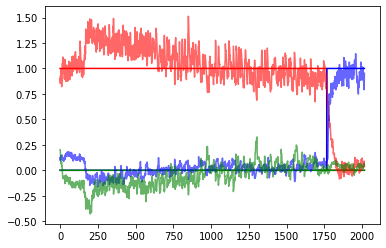

 36%|███████████████████████████████████████████████████████▉                                                                                                  | 1089/3000 [6:24:44<10:12:10, 19.22s/it]

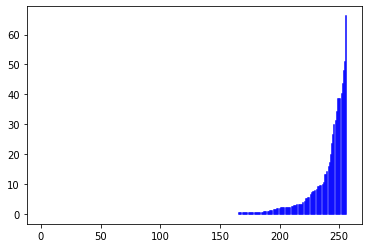

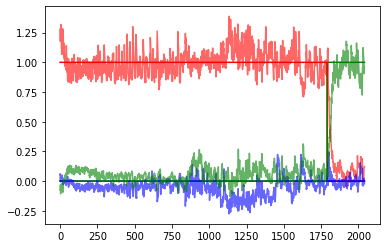

 36%|████████████████████████████████████████████████████████▏                                                                                                 | 1094/3000 [6:26:22<10:11:43, 19.26s/it]

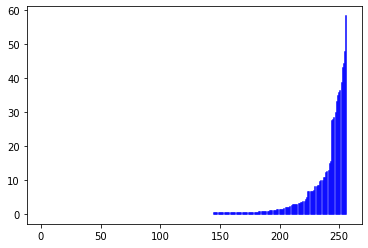

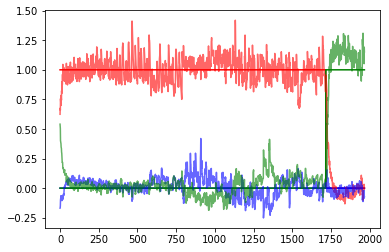

 37%|████████████████████████████████████████████████████████▍                                                                                                 | 1099/3000 [6:28:04<10:29:27, 19.87s/it]

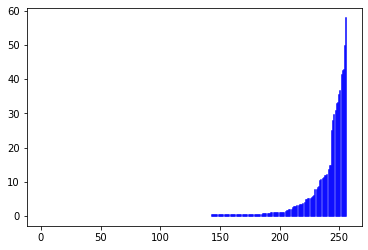

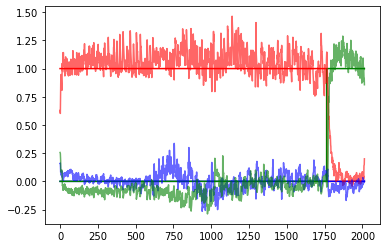

 37%|████████████████████████████████████████████████████████▋                                                                                                 | 1104/3000 [6:30:32<12:22:56, 23.51s/it]

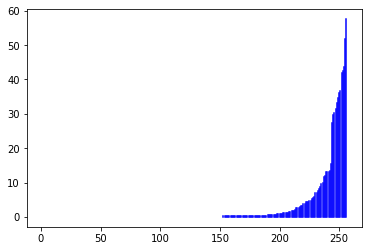

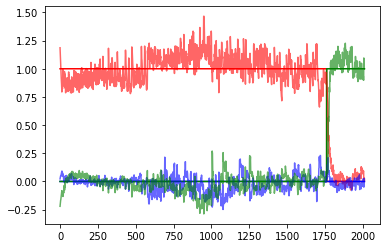

 37%|████████████████████████████████████████████████████████▉                                                                                                 | 1109/3000 [6:32:14<10:46:50, 20.52s/it]

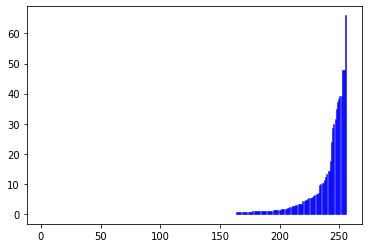

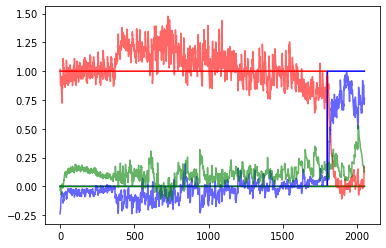

 37%|█████████████████████████████████████████████████████████▏                                                                                                | 1114/3000 [6:33:54<10:14:32, 19.55s/it]

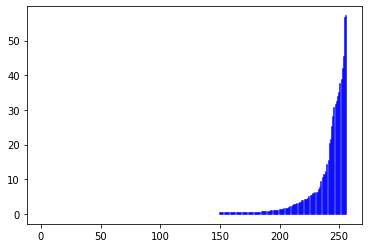

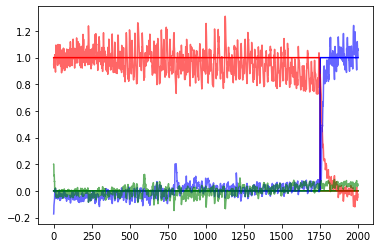

 37%|█████████████████████████████████████████████████████████▍                                                                                                | 1119/3000 [6:35:35<10:04:28, 19.28s/it]

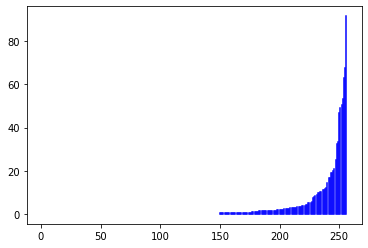

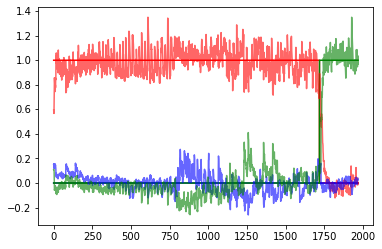

 37%|█████████████████████████████████████████████████████████▋                                                                                                | 1124/3000 [6:37:18<10:34:35, 20.30s/it]

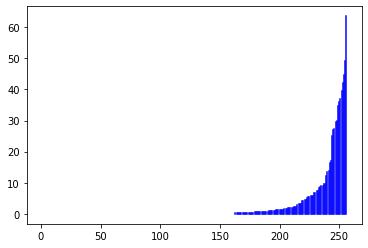

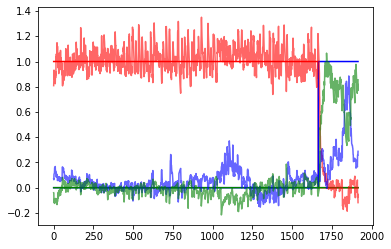

 38%|█████████████████████████████████████████████████████████▉                                                                                                | 1129/3000 [6:39:00<10:32:32, 20.28s/it]

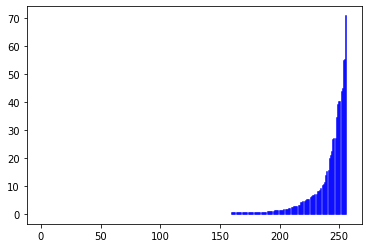

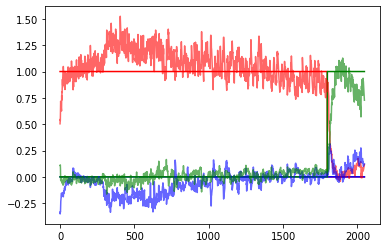

 38%|██████████████████████████████████████████████████████████▏                                                                                               | 1134/3000 [6:40:45<10:29:23, 20.24s/it]

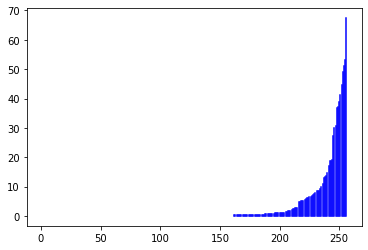

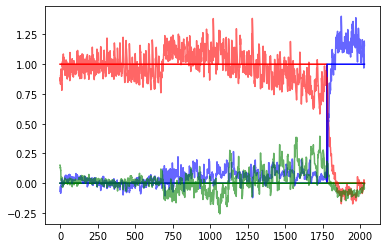

 38%|██████████████████████████████████████████████████████████▍                                                                                               | 1139/3000 [6:42:23<10:04:29, 19.49s/it]

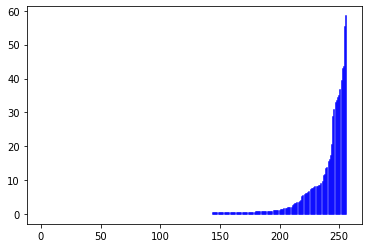

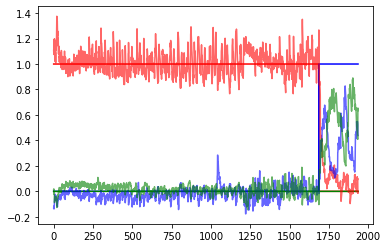

 38%|██████████████████████████████████████████████████████████▋                                                                                               | 1144/3000 [6:44:04<10:16:40, 19.94s/it]

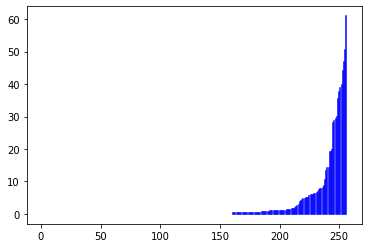

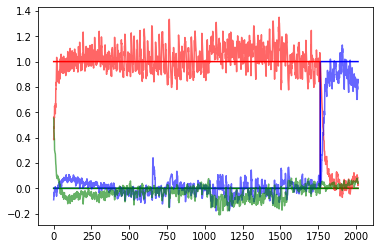

 38%|██████████████████████████████████████████████████████████▉                                                                                               | 1149/3000 [6:45:46<10:10:42, 19.80s/it]

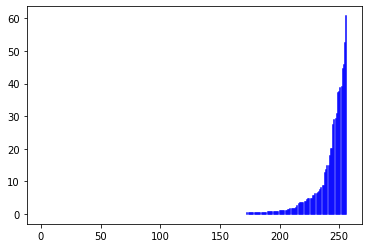

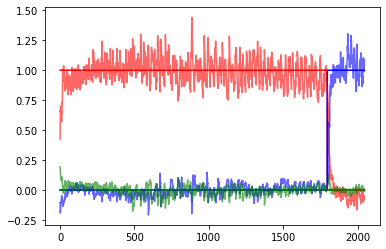

 38%|███████████████████████████████████████████████████████████▏                                                                                              | 1154/3000 [6:48:16<11:50:23, 23.09s/it]

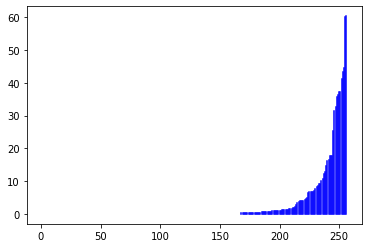

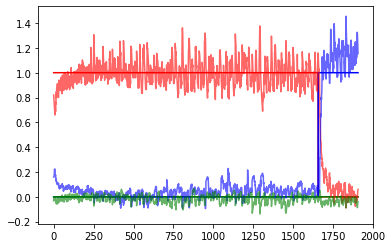

 39%|███████████████████████████████████████████████████████████▍                                                                                              | 1159/3000 [6:49:53<10:06:13, 19.76s/it]

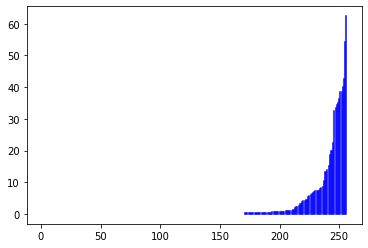

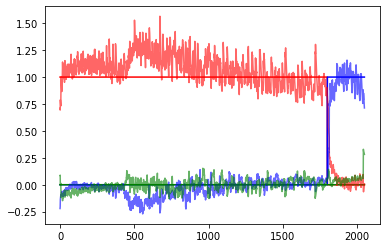

 39%|████████████████████████████████████████████████████████████▏                                                                                              | 1164/3000 [6:51:31<9:52:41, 19.37s/it]

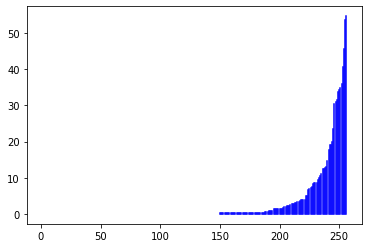

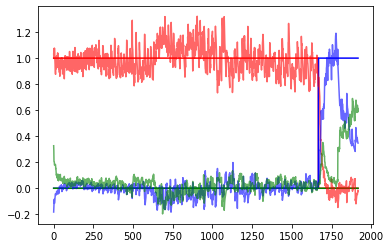

 39%|████████████████████████████████████████████████████████████                                                                                              | 1169/3000 [6:53:12<10:06:15, 19.87s/it]

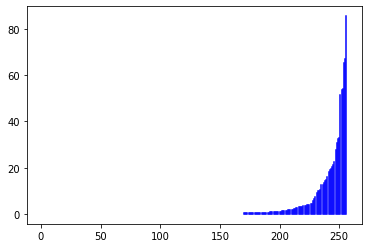

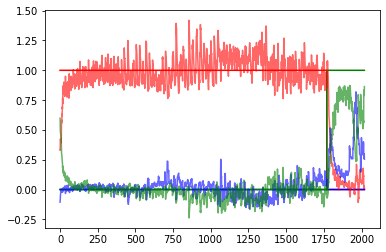

 39%|████████████████████████████████████████████████████████████▎                                                                                             | 1174/3000 [6:54:53<10:02:50, 19.81s/it]

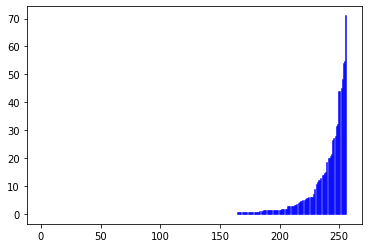

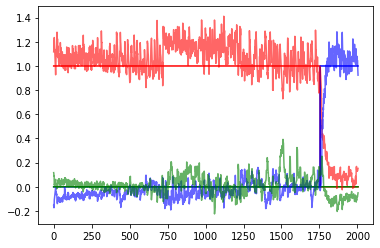

 39%|████████████████████████████████████████████████████████████▉                                                                                              | 1179/3000 [6:56:32<9:47:25, 19.35s/it]

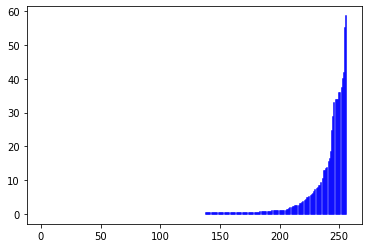

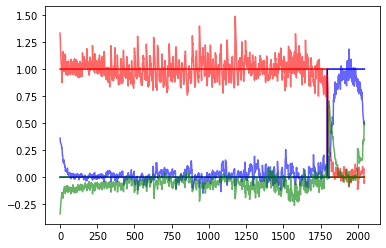

 39%|████████████████████████████████████████████████████████████▊                                                                                             | 1184/3000 [6:58:14<10:11:31, 20.20s/it]

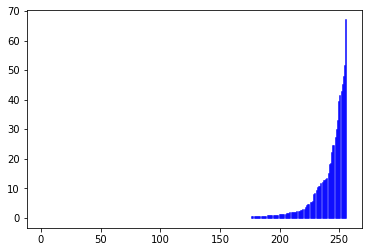

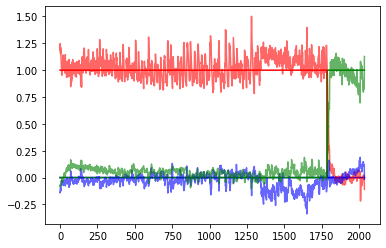

 40%|█████████████████████████████████████████████████████████████                                                                                             | 1189/3000 [6:59:56<10:01:56, 19.94s/it]

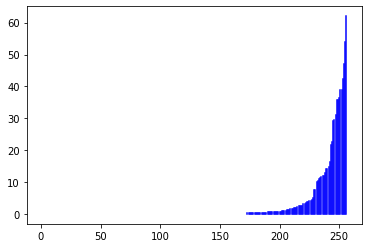

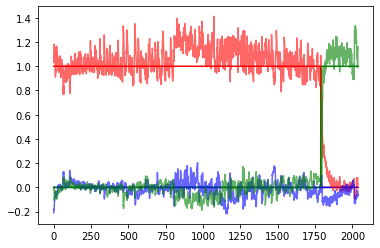

 40%|█████████████████████████████████████████████████████████████▎                                                                                            | 1194/3000 [7:01:39<10:02:55, 20.03s/it]

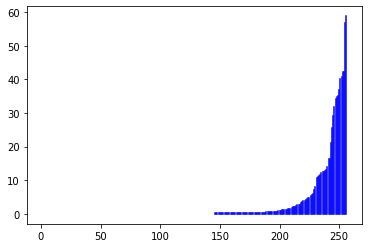

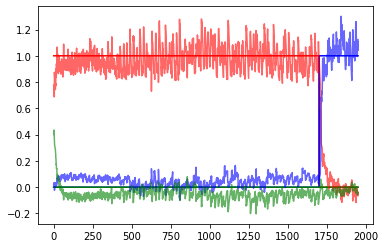

 40%|█████████████████████████████████████████████████████████████▌                                                                                            | 1199/3000 [7:03:22<10:12:20, 20.40s/it]

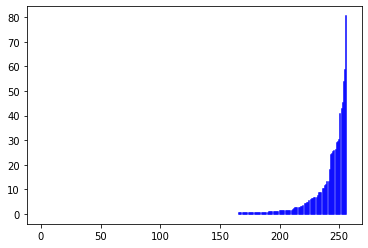

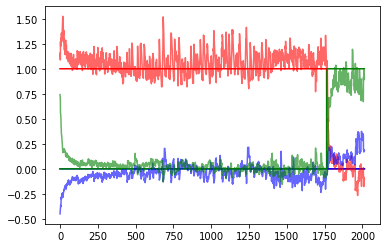

 40%|█████████████████████████████████████████████████████████████▊                                                                                            | 1204/3000 [7:05:53<11:30:09, 23.06s/it]

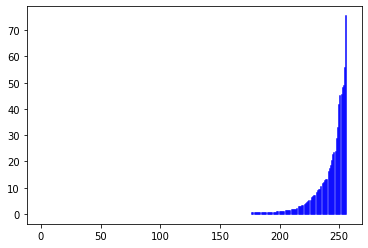

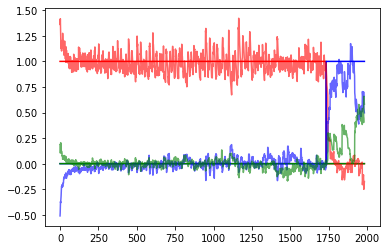

 40%|██████████████████████████████████████████████████████████████                                                                                            | 1209/3000 [7:07:36<10:21:12, 20.81s/it]

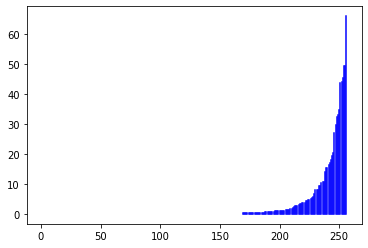

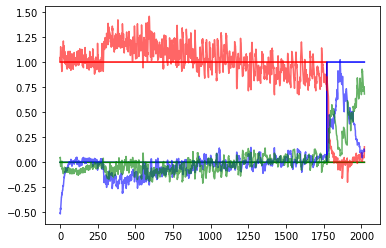

 40%|██████████████████████████████████████████████████████████████▋                                                                                            | 1214/3000 [7:09:13<9:35:28, 19.33s/it]

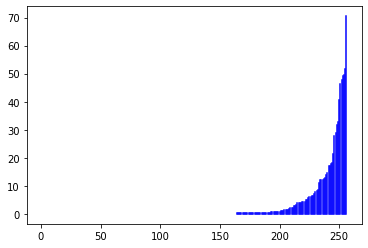

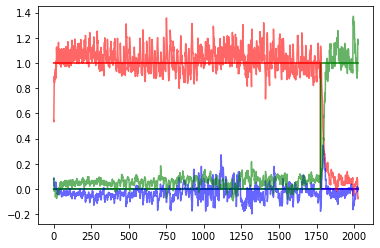

 41%|██████████████████████████████████████████████████████████████▉                                                                                            | 1219/3000 [7:10:55<9:40:36, 19.56s/it]

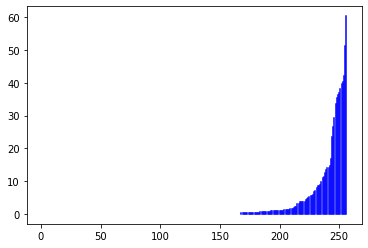

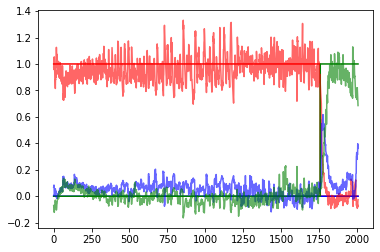

 41%|███████████████████████████████████████████████████████████████▏                                                                                           | 1224/3000 [7:12:35<9:37:01, 19.49s/it]

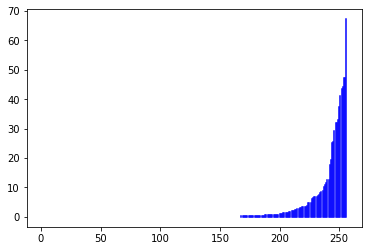

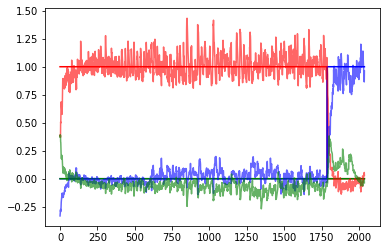

 41%|███████████████████████████████████████████████████████████████                                                                                           | 1229/3000 [7:14:21<10:07:49, 20.59s/it]

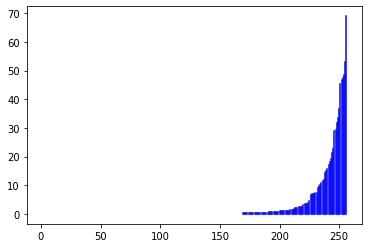

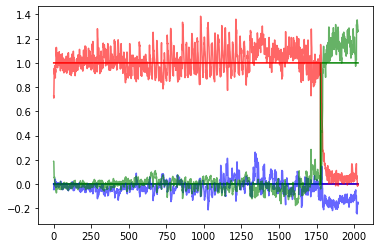

 41%|███████████████████████████████████████████████████████████████▎                                                                                          | 1234/3000 [7:16:07<10:04:17, 20.53s/it]

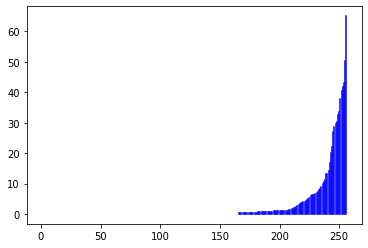

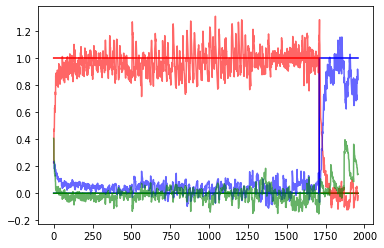

 41%|████████████████████████████████████████████████████████████████                                                                                           | 1239/3000 [7:17:45<9:21:28, 19.13s/it]

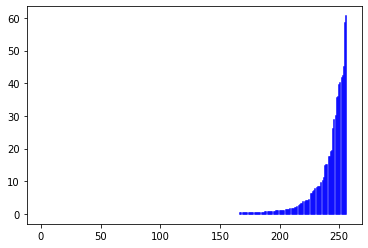

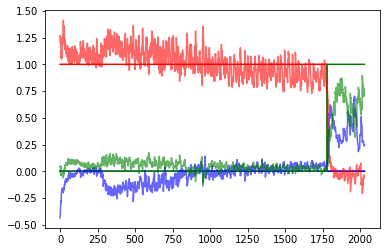

 41%|████████████████████████████████████████████████████████████████▎                                                                                          | 1244/3000 [7:19:29<9:53:11, 20.27s/it]

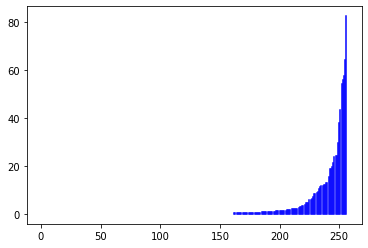

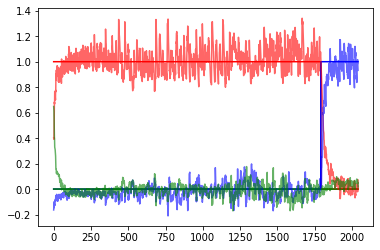

 42%|████████████████████████████████████████████████████████████████▌                                                                                          | 1249/3000 [7:21:10<9:33:30, 19.65s/it]

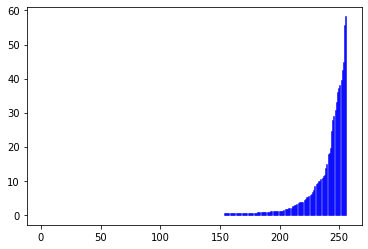

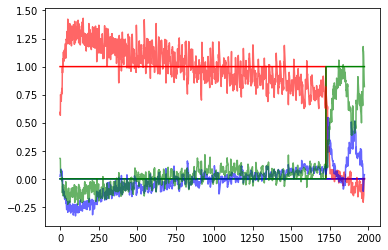

 42%|████████████████████████████████████████████████████████████████▎                                                                                         | 1254/3000 [7:23:37<11:09:16, 23.00s/it]

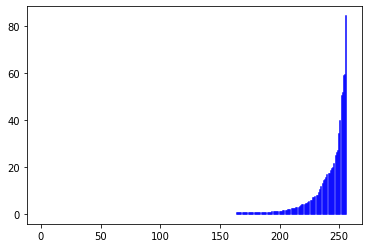

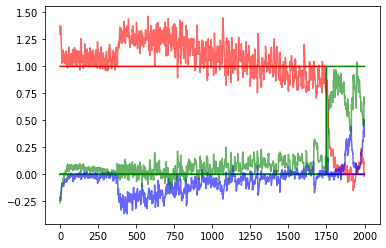

 42%|█████████████████████████████████████████████████████████████████                                                                                          | 1259/3000 [7:25:19<9:45:54, 20.19s/it]

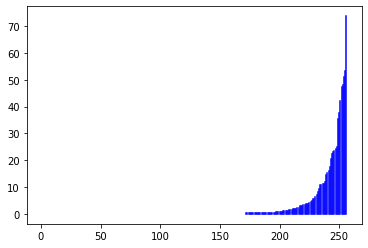

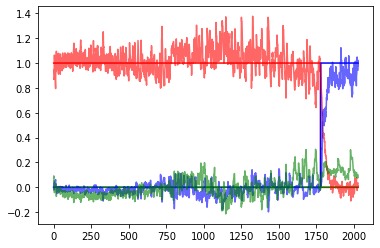

 42%|████████████████████████████████████████████████████████████████▉                                                                                         | 1264/3000 [7:27:05<10:01:09, 20.78s/it]

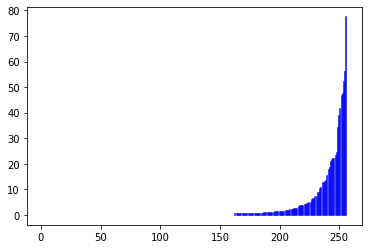

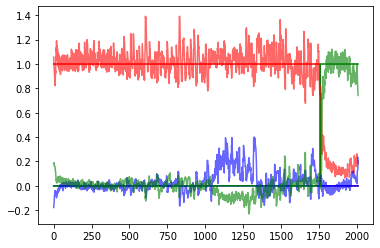

 42%|█████████████████████████████████████████████████████████████████▌                                                                                         | 1269/3000 [7:28:48<9:48:22, 20.39s/it]

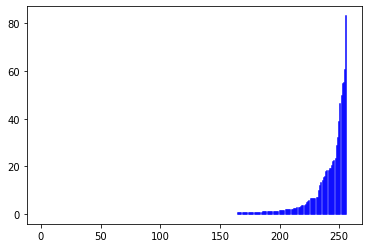

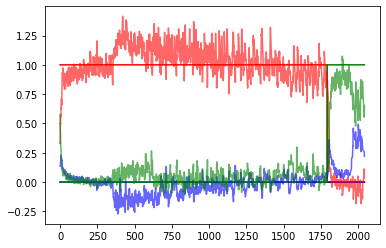

 42%|█████████████████████████████████████████████████████████████████▊                                                                                         | 1274/3000 [7:30:29<9:25:11, 19.65s/it]

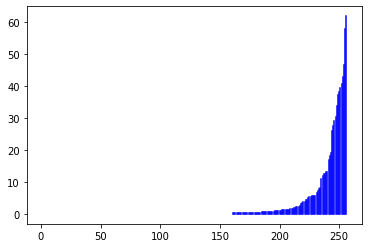

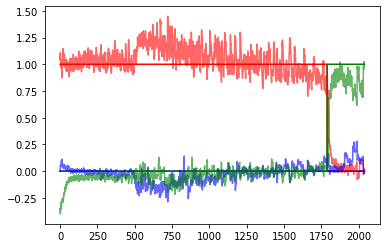

 43%|██████████████████████████████████████████████████████████████████                                                                                         | 1279/3000 [7:32:11<9:28:18, 19.81s/it]

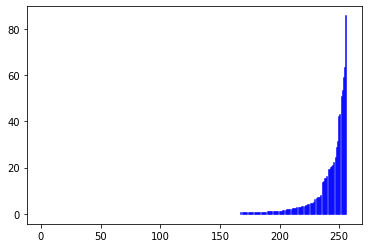

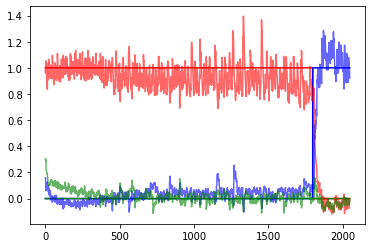

 43%|██████████████████████████████████████████████████████████████████▎                                                                                        | 1284/3000 [7:33:53<9:32:17, 20.01s/it]

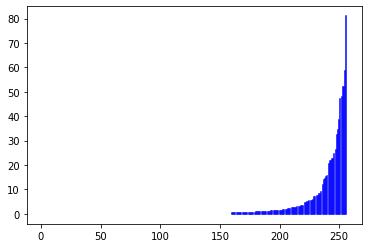

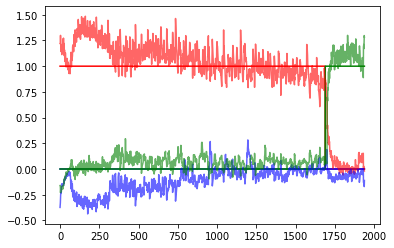

 43%|██████████████████████████████████████████████████████████████████▌                                                                                        | 1289/3000 [7:35:39<9:47:06, 20.59s/it]

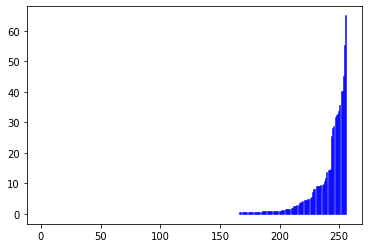

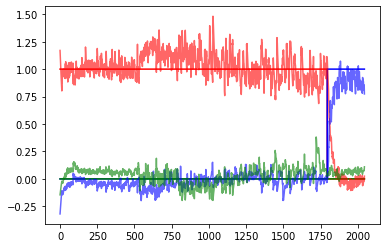

 43%|██████████████████████████████████████████████████████████████████▊                                                                                        | 1294/3000 [7:37:20<9:11:32, 19.40s/it]

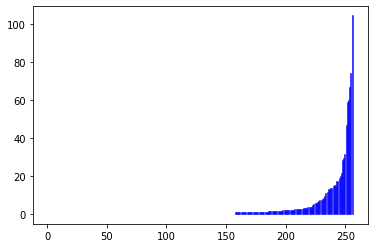

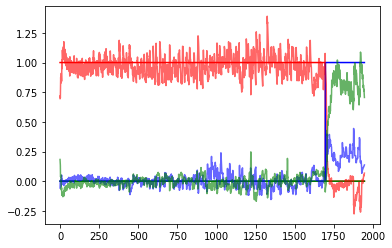

 43%|███████████████████████████████████████████████████████████████████                                                                                        | 1299/3000 [7:38:58<8:55:19, 18.88s/it]

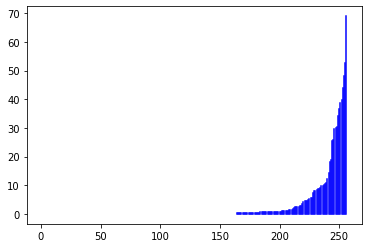

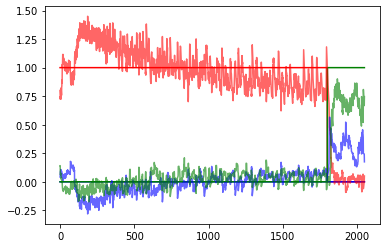

 43%|██████████████████████████████████████████████████████████████████▉                                                                                       | 1304/3000 [7:41:26<10:46:33, 22.87s/it]

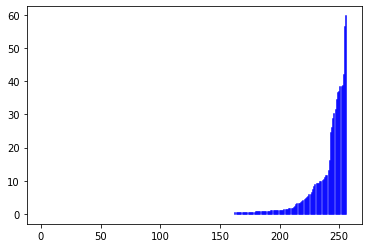

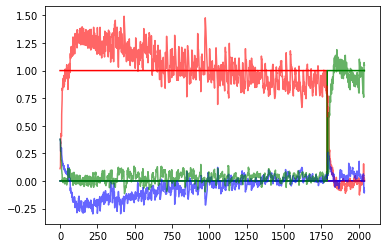

 44%|███████████████████████████████████████████████████████████████████▋                                                                                       | 1309/3000 [7:43:06<9:29:56, 20.22s/it]

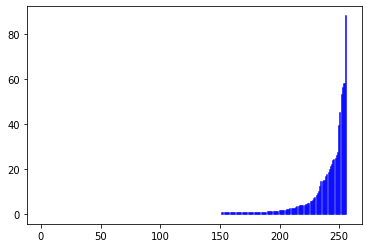

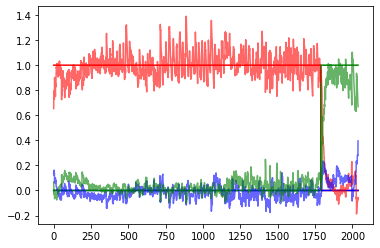

 44%|███████████████████████████████████████████████████████████████████▉                                                                                       | 1314/3000 [7:44:48<9:20:39, 19.95s/it]

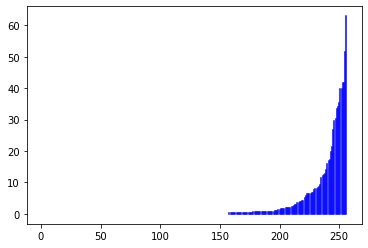

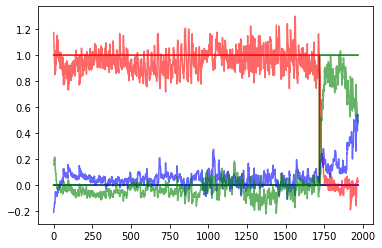

 44%|████████████████████████████████████████████████████████████████████▏                                                                                      | 1319/3000 [7:46:29<9:19:37, 19.97s/it]

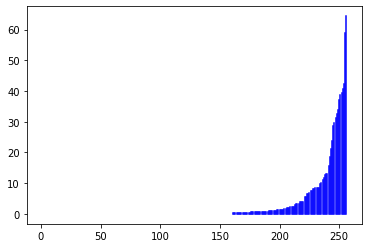

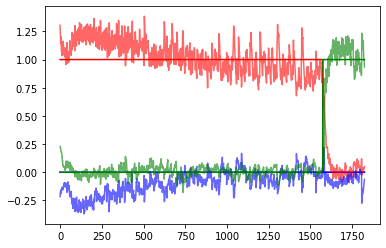

 44%|████████████████████████████████████████████████████████████████████▍                                                                                      | 1324/3000 [7:48:12<9:27:43, 20.32s/it]

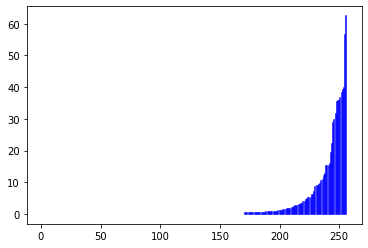

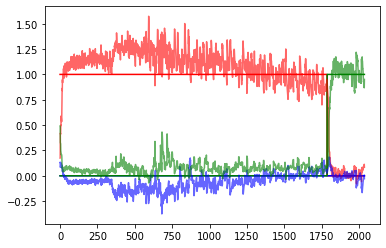

 44%|████████████████████████████████████████████████████████████████████▋                                                                                      | 1329/3000 [7:49:55<9:19:34, 20.09s/it]

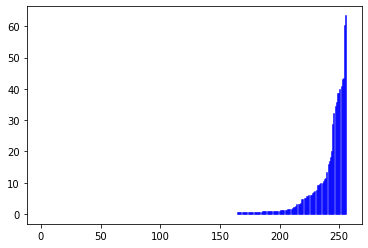

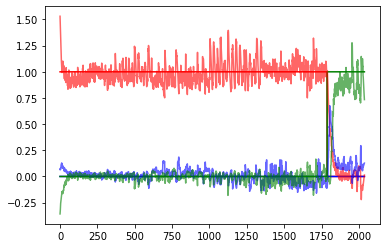

 44%|████████████████████████████████████████████████████████████████████▉                                                                                      | 1334/3000 [7:51:35<9:08:58, 19.77s/it]

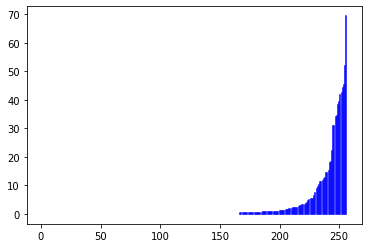

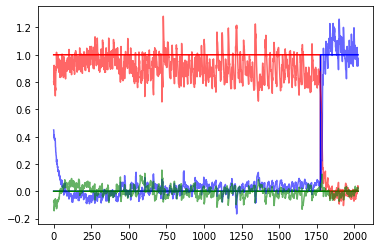

 45%|█████████████████████████████████████████████████████████████████████▏                                                                                     | 1339/3000 [7:53:16<9:03:38, 19.64s/it]

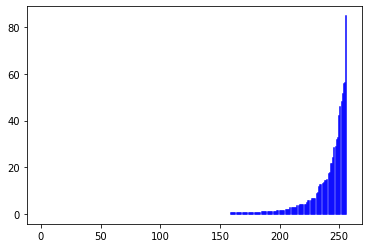

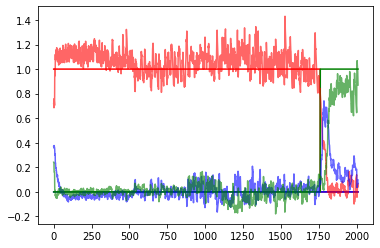

 45%|█████████████████████████████████████████████████████████████████████▍                                                                                     | 1344/3000 [7:54:56<9:00:06, 19.57s/it]

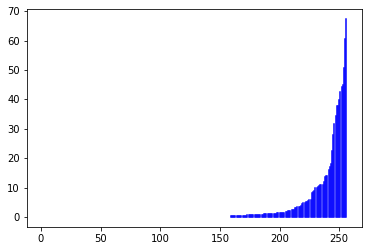

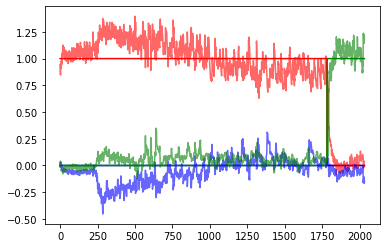

 45%|█████████████████████████████████████████████████████████████████████▋                                                                                     | 1349/3000 [7:56:33<8:46:34, 19.14s/it]

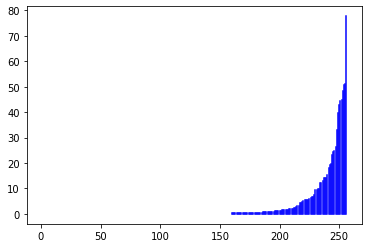

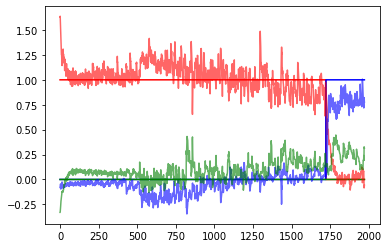

 45%|█████████████████████████████████████████████████████████████████████▌                                                                                    | 1354/3000 [7:59:05<10:43:25, 23.45s/it]

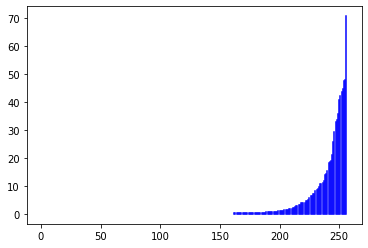

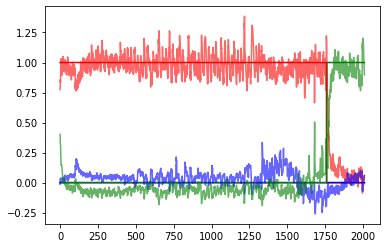

 45%|██████████████████████████████████████████████████████████████████████▏                                                                                    | 1359/3000 [8:00:46<9:19:08, 20.44s/it]

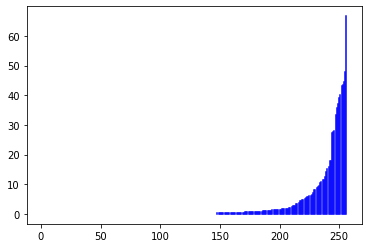

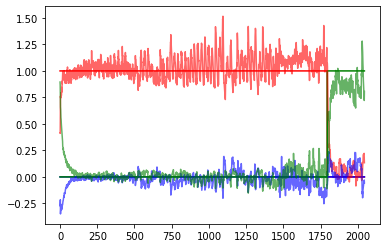

 45%|██████████████████████████████████████████████████████████████████████▍                                                                                    | 1364/3000 [8:02:26<9:06:06, 20.03s/it]

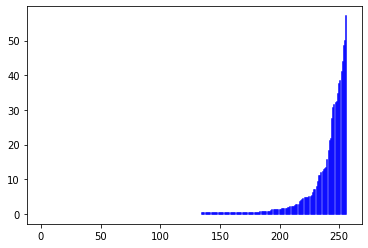

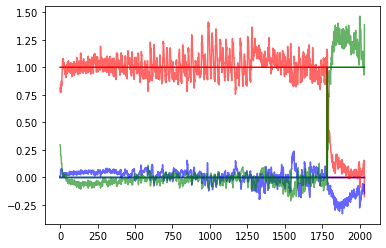

 46%|██████████████████████████████████████████████████████████████████████▋                                                                                    | 1369/3000 [8:04:07<8:47:44, 19.41s/it]

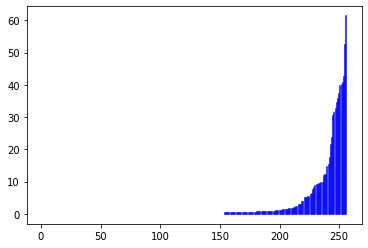

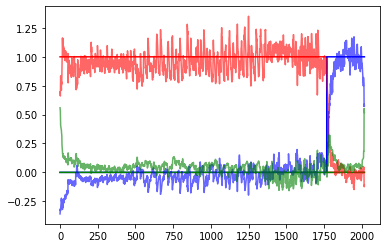

 46%|██████████████████████████████████████████████████████████████████████▉                                                                                    | 1374/3000 [8:05:49<8:49:27, 19.54s/it]

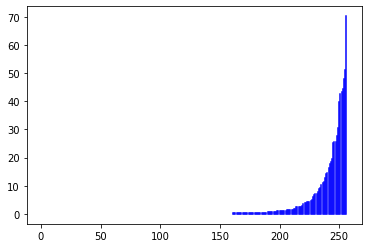

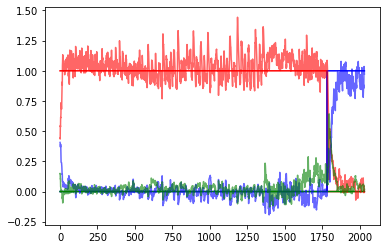

 46%|███████████████████████████████████████████████████████████████████████▏                                                                                   | 1379/3000 [8:07:30<8:52:37, 19.71s/it]

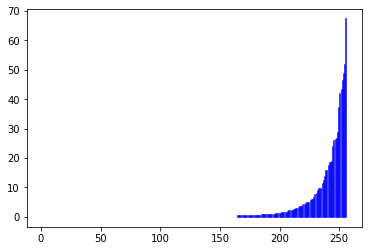

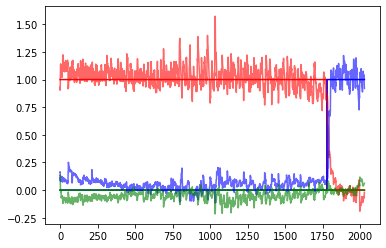

 46%|███████████████████████████████████████████████████████████████████████▌                                                                                   | 1384/3000 [8:09:13<8:52:22, 19.77s/it]

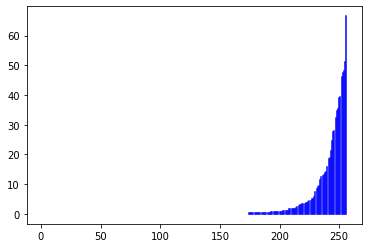

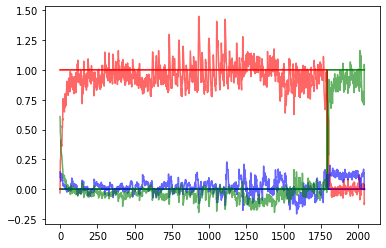

 46%|███████████████████████████████████████████████████████████████████████▊                                                                                   | 1389/3000 [8:10:58<9:03:48, 20.25s/it]

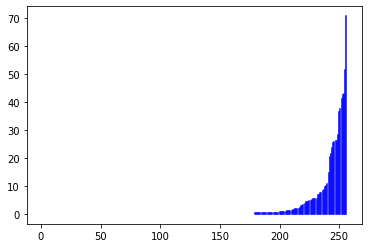

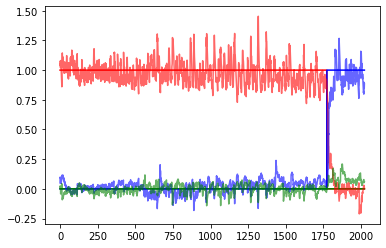

 46%|████████████████████████████████████████████████████████████████████████                                                                                   | 1394/3000 [8:12:40<9:04:49, 20.35s/it]

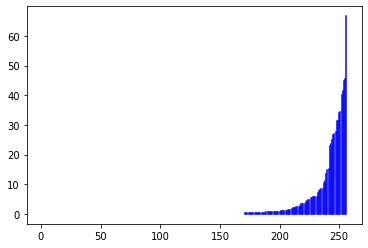

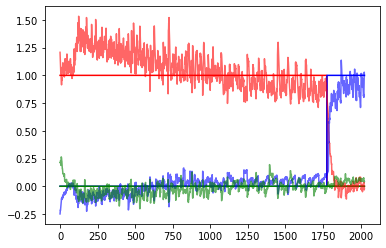

 47%|████████████████████████████████████████████████████████████████████████▎                                                                                  | 1399/3000 [8:14:25<9:07:46, 20.53s/it]

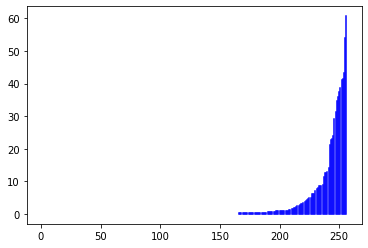

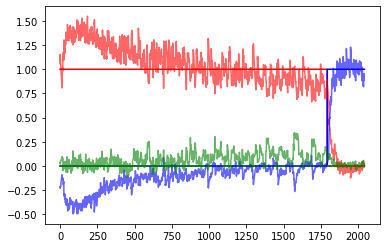

 47%|████████████████████████████████████████████████████████████████████████                                                                                  | 1404/3000 [8:16:53<10:10:36, 22.96s/it]

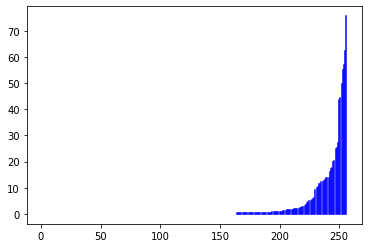

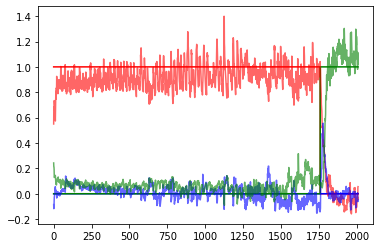

 47%|████████████████████████████████████████████████████████████████████████▊                                                                                  | 1409/3000 [8:18:31<8:42:21, 19.70s/it]

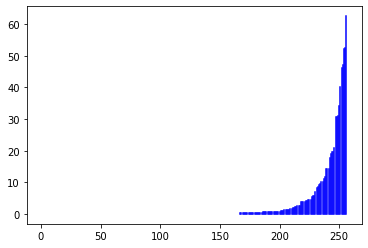

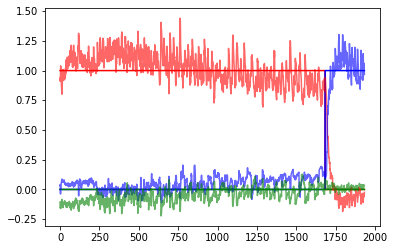

 47%|█████████████████████████████████████████████████████████████████████████                                                                                  | 1414/3000 [8:20:09<8:25:25, 19.12s/it]

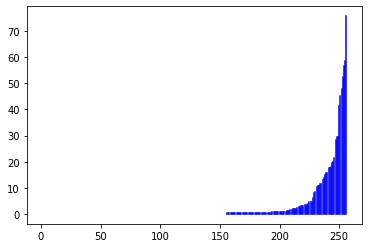

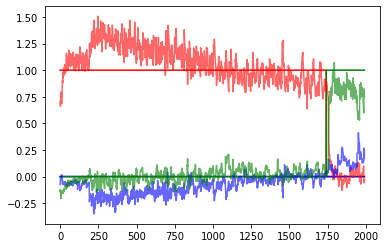

 47%|█████████████████████████████████████████████████████████████████████████▎                                                                                 | 1419/3000 [8:21:47<8:29:25, 19.33s/it]

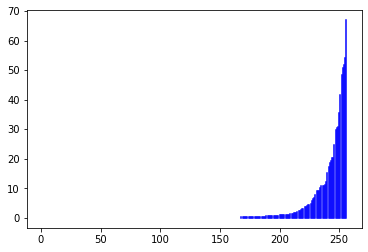

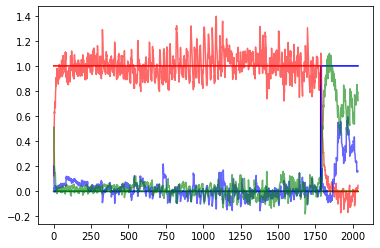

 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                 | 1424/3000 [8:23:27<8:31:15, 19.46s/it]

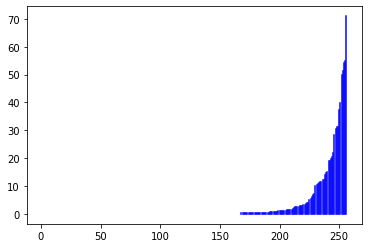

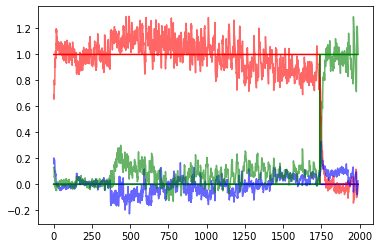

 48%|█████████████████████████████████████████████████████████████████████████▊                                                                                 | 1429/3000 [8:25:10<8:45:09, 20.06s/it]

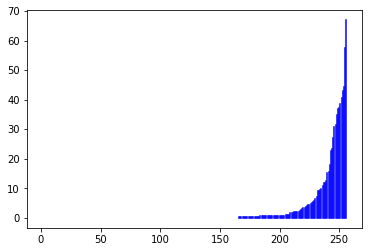

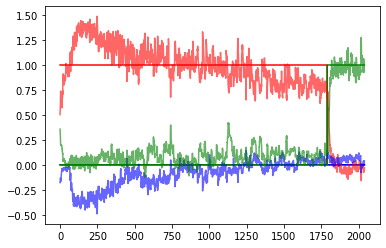

 48%|██████████████████████████████████████████████████████████████████████████                                                                                 | 1434/3000 [8:26:45<8:06:42, 18.65s/it]

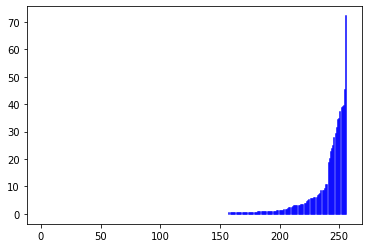

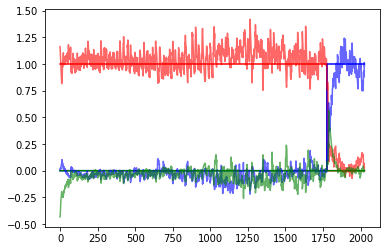

 48%|██████████████████████████████████████████████████████████████████████████▎                                                                                | 1439/3000 [8:28:22<8:20:15, 19.23s/it]

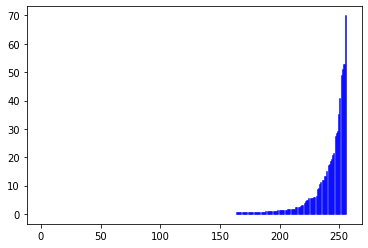

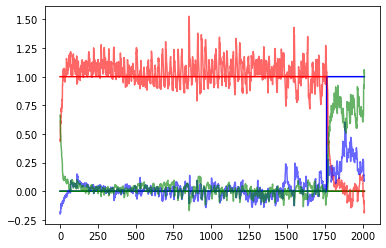

 48%|██████████████████████████████████████████████████████████████████████████▌                                                                                | 1444/3000 [8:30:00<8:10:51, 18.93s/it]

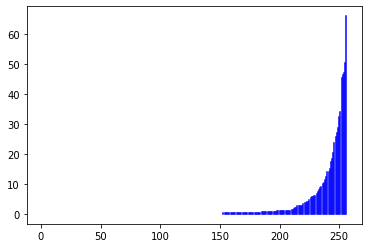

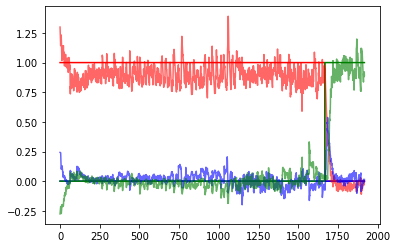

 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                | 1449/3000 [8:31:43<8:36:27, 19.98s/it]

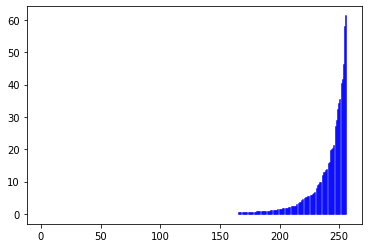

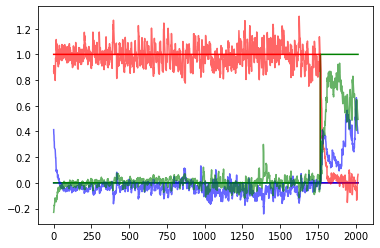

 48%|███████████████████████████████████████████████████████████████████████████                                                                                | 1454/3000 [8:34:12<9:48:35, 22.84s/it]

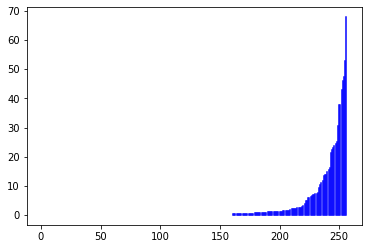

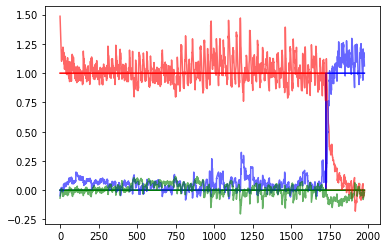

 49%|███████████████████████████████████████████████████████████████████████████▍                                                                               | 1459/3000 [8:35:50<8:38:40, 20.19s/it]

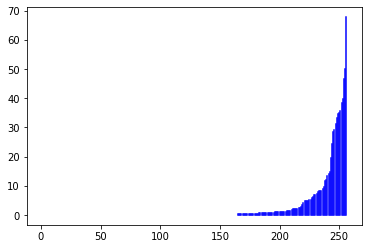

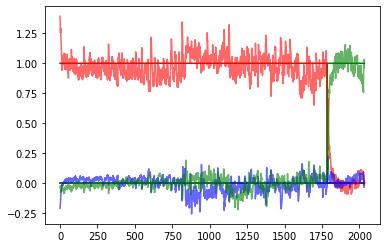

 49%|███████████████████████████████████████████████████████████████████████████▋                                                                               | 1464/3000 [8:37:36<8:46:10, 20.55s/it]

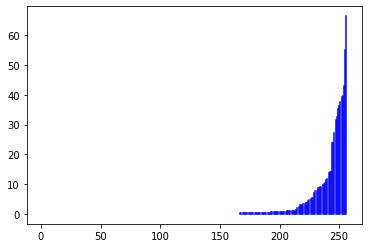

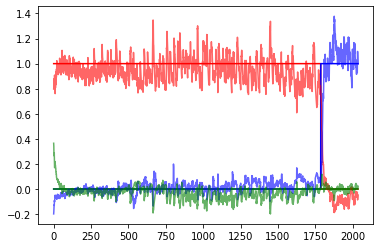

 49%|███████████████████████████████████████████████████████████████████████████▉                                                                               | 1469/3000 [8:39:20<8:37:47, 20.29s/it]

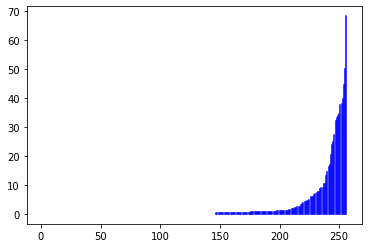

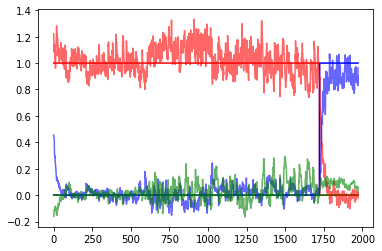

 49%|████████████████████████████████████████████████████████████████████████████▏                                                                              | 1474/3000 [8:41:01<8:19:04, 19.62s/it]

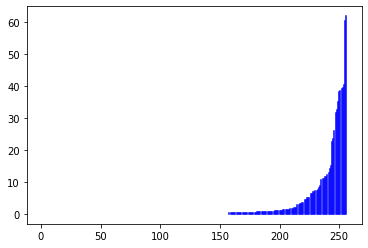

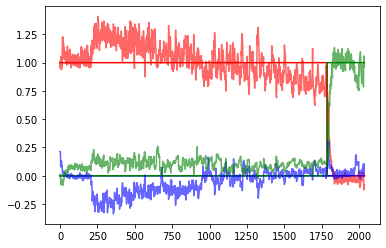

 49%|████████████████████████████████████████████████████████████████████████████▍                                                                              | 1479/3000 [8:42:43<8:24:25, 19.90s/it]

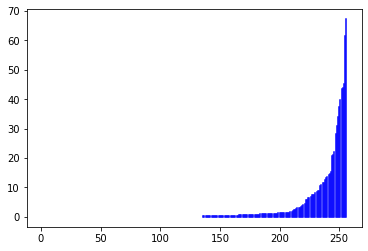

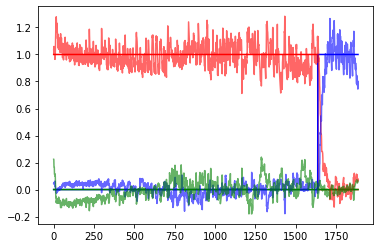

 49%|████████████████████████████████████████████████████████████████████████████▋                                                                              | 1484/3000 [8:44:23<8:08:00, 19.31s/it]

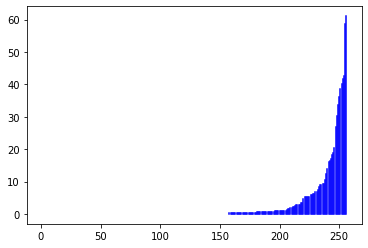

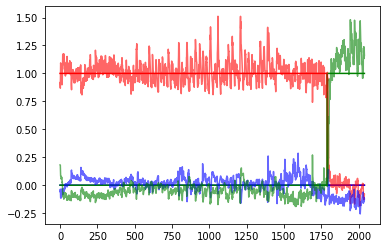

 50%|████████████████████████████████████████████████████████████████████████████▉                                                                              | 1489/3000 [8:46:08<8:31:13, 20.30s/it]

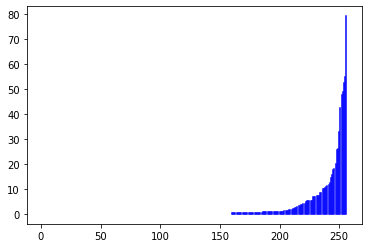

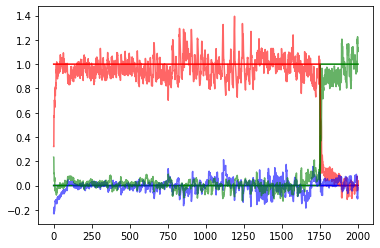

 50%|█████████████████████████████████████████████████████████████████████████████▏                                                                             | 1494/3000 [8:47:54<8:39:23, 20.69s/it]

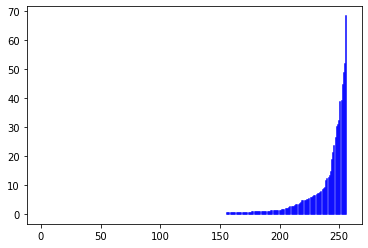

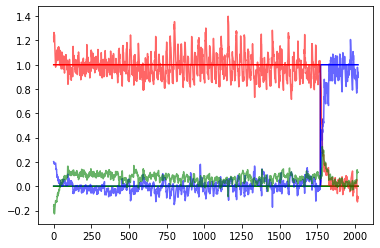

 50%|█████████████████████████████████████████████████████████████████████████████▍                                                                             | 1499/3000 [8:49:38<8:32:50, 20.50s/it]

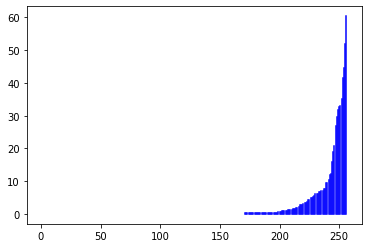

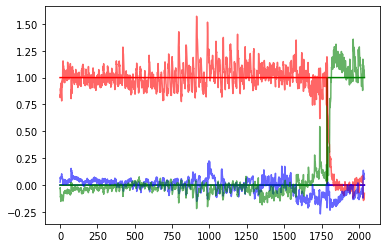

 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                             | 1504/3000 [8:52:08<9:50:32, 23.68s/it]

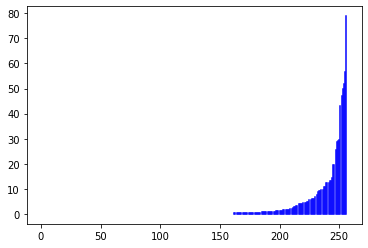

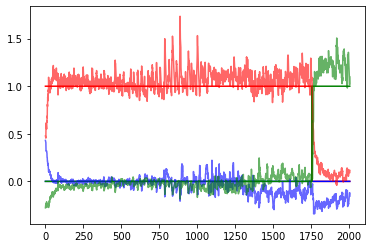

 50%|█████████████████████████████████████████████████████████████████████████████▉                                                                             | 1509/3000 [8:53:48<8:13:37, 19.86s/it]

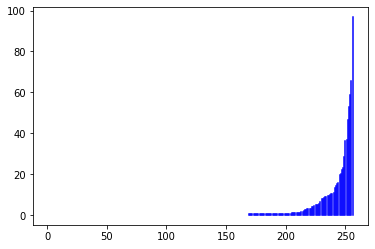

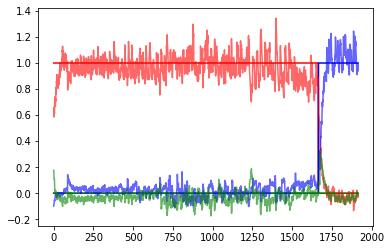

 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                            | 1514/3000 [8:55:25<7:58:19, 19.31s/it]

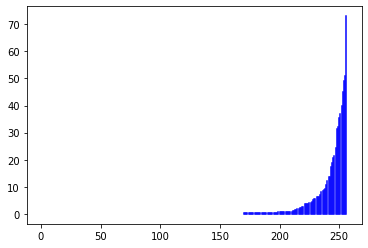

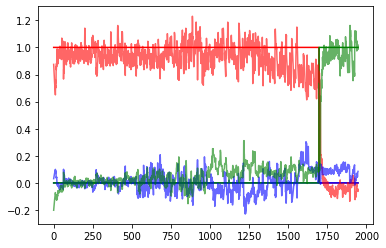

 51%|██████████████████████████████████████████████████████████████████████████████▍                                                                            | 1519/3000 [8:57:07<8:11:42, 19.92s/it]

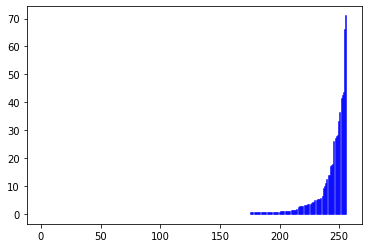

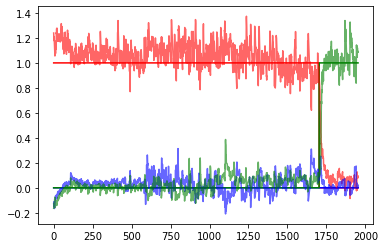

 51%|██████████████████████████████████████████████████████████████████████████████▋                                                                            | 1524/3000 [8:58:53<8:32:06, 20.82s/it]

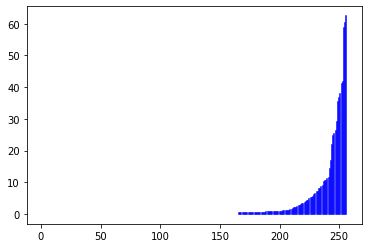

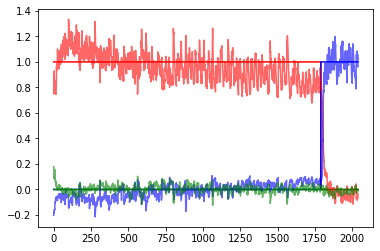

 51%|██████████████████████████████████████████████████████████████████████████████▉                                                                            | 1529/3000 [9:00:37<8:23:39, 20.54s/it]

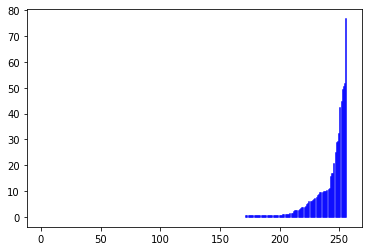

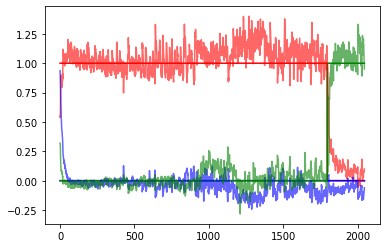

 51%|███████████████████████████████████████████████████████████████████████████████▎                                                                           | 1534/3000 [9:02:18<7:56:58, 19.52s/it]

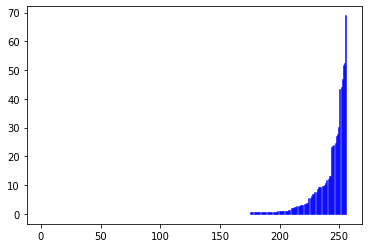

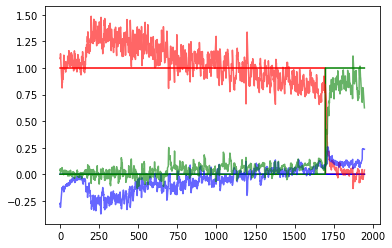

 51%|███████████████████████████████████████████████████████████████████████████████▌                                                                           | 1539/3000 [9:03:59<7:58:16, 19.64s/it]

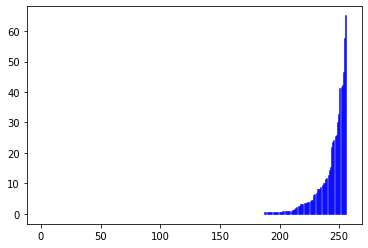

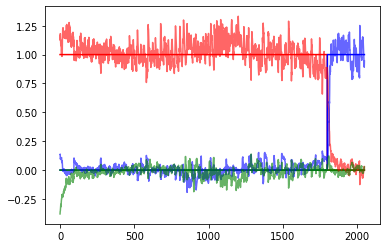

 51%|███████████████████████████████████████████████████████████████████████████████▊                                                                           | 1544/3000 [9:05:40<8:00:45, 19.81s/it]

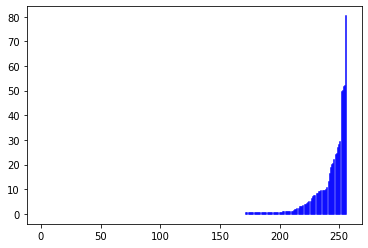

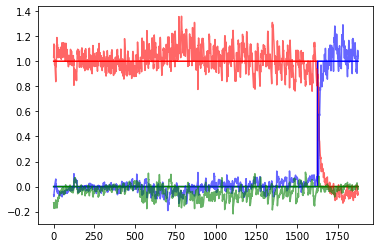

 52%|████████████████████████████████████████████████████████████████████████████████                                                                           | 1549/3000 [9:07:23<7:59:16, 19.82s/it]

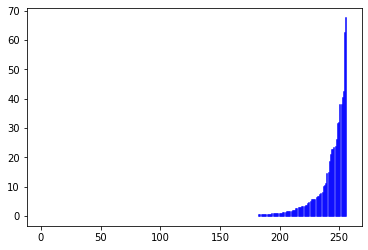

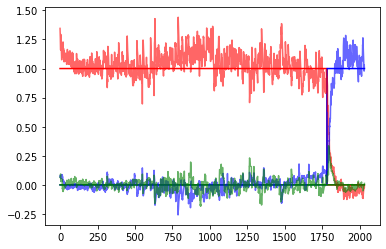

 52%|████████████████████████████████████████████████████████████████████████████████▎                                                                          | 1554/3000 [9:09:53<9:14:49, 23.02s/it]

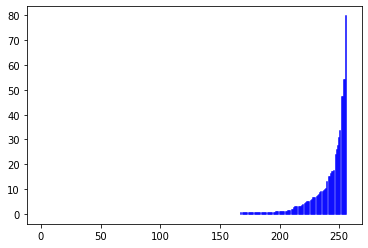

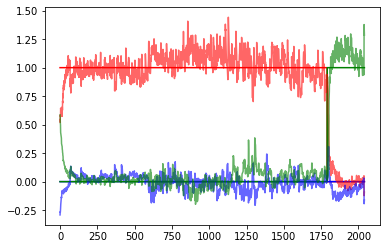

 52%|████████████████████████████████████████████████████████████████████████████████▌                                                                          | 1559/3000 [9:11:38<8:29:18, 21.21s/it]

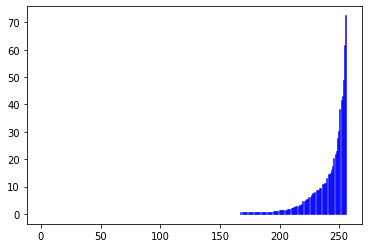

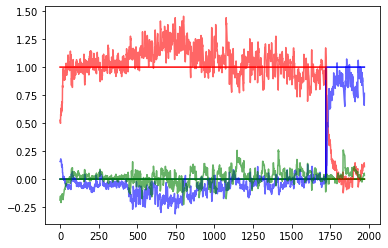

 52%|████████████████████████████████████████████████████████████████████████████████▊                                                                          | 1564/3000 [9:13:16<7:52:12, 19.73s/it]

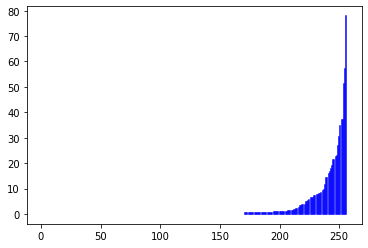

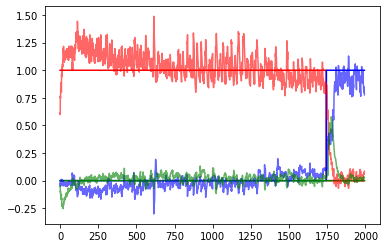

 52%|█████████████████████████████████████████████████████████████████████████████████                                                                          | 1569/3000 [9:14:57<7:57:19, 20.01s/it]

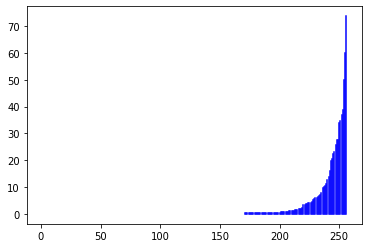

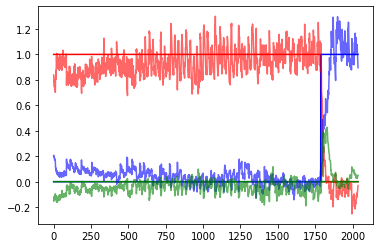

 52%|█████████████████████████████████████████████████████████████████████████████████▎                                                                         | 1574/3000 [9:16:41<8:03:53, 20.36s/it]

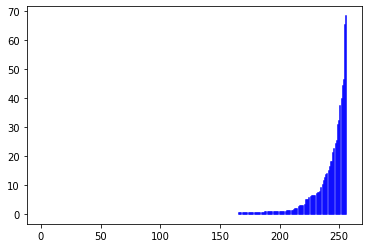

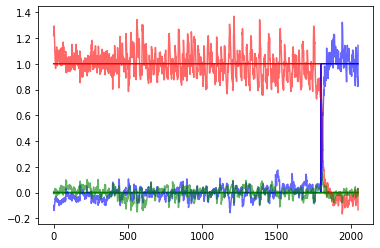

 53%|█████████████████████████████████████████████████████████████████████████████████▌                                                                         | 1579/3000 [9:18:22<7:54:16, 20.03s/it]

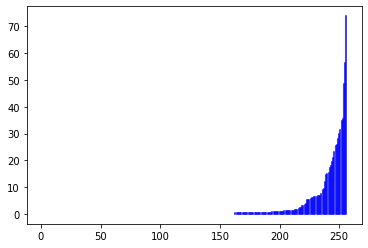

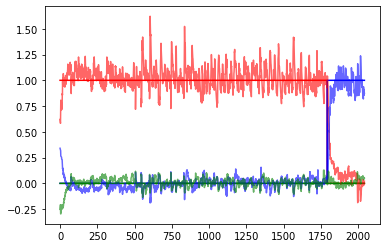

 53%|█████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1584/3000 [9:20:07<8:02:43, 20.45s/it]

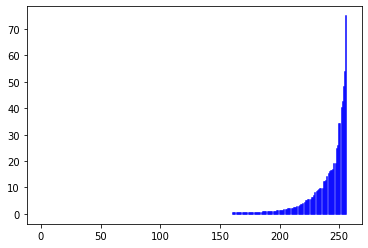

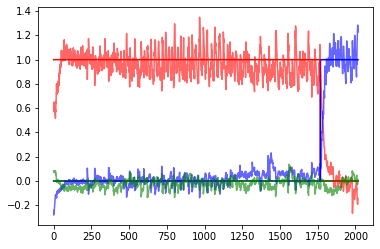

 53%|██████████████████████████████████████████████████████████████████████████████████                                                                         | 1589/3000 [9:21:46<7:41:59, 19.65s/it]

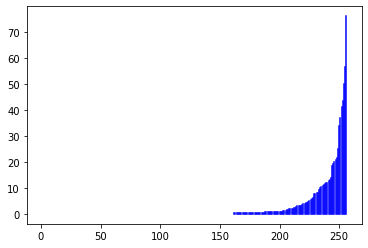

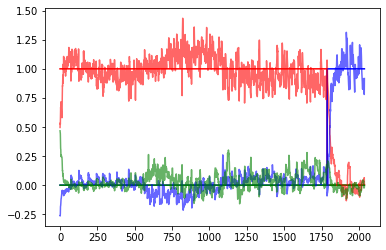

 53%|██████████████████████████████████████████████████████████████████████████████████▎                                                                        | 1594/3000 [9:23:30<7:58:00, 20.40s/it]

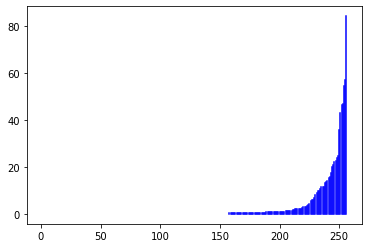

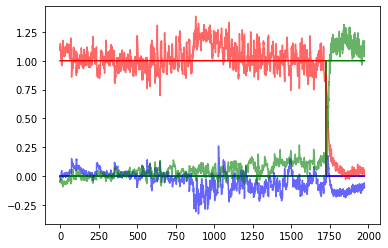

 53%|██████████████████████████████████████████████████████████████████████████████████▌                                                                        | 1599/3000 [9:25:13<7:46:45, 19.99s/it]

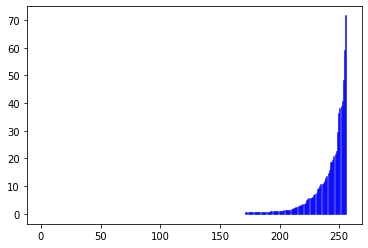

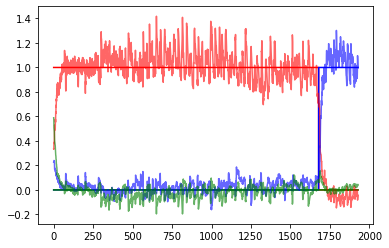

 53%|██████████████████████████████████████████████████████████████████████████████████▊                                                                        | 1604/3000 [9:27:36<8:53:16, 22.92s/it]

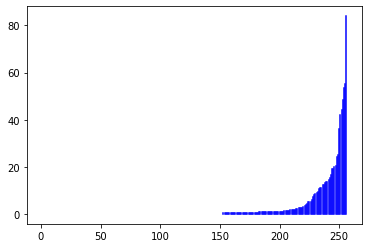

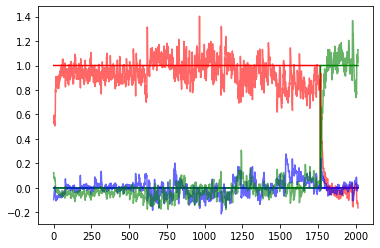

 54%|███████████████████████████████████████████████████████████████████████████████████▏                                                                       | 1609/3000 [9:29:17<7:50:43, 20.30s/it]

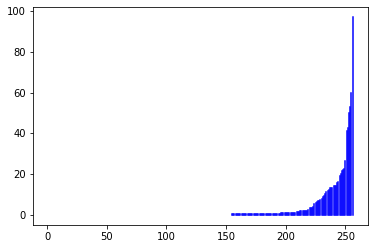

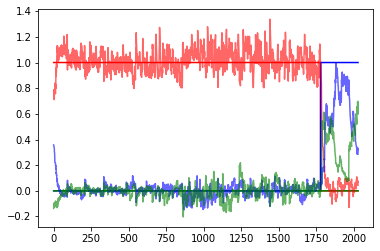

 54%|███████████████████████████████████████████████████████████████████████████████████▍                                                                       | 1614/3000 [9:30:57<7:40:09, 19.92s/it]

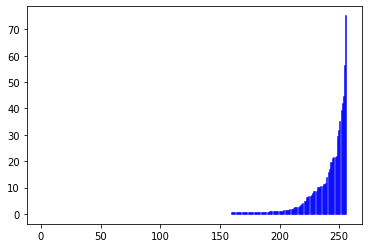

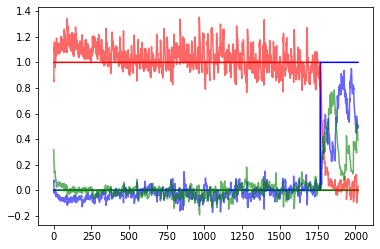

 54%|███████████████████████████████████████████████████████████████████████████████████▋                                                                       | 1619/3000 [9:32:35<7:20:57, 19.16s/it]

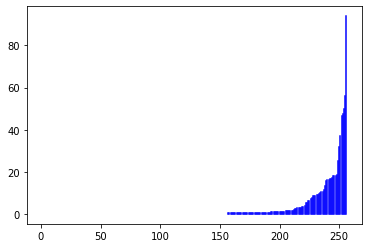

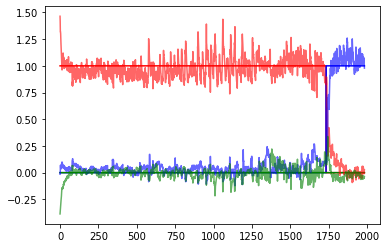

 54%|███████████████████████████████████████████████████████████████████████████████████▉                                                                       | 1624/3000 [9:34:14<7:23:19, 19.33s/it]

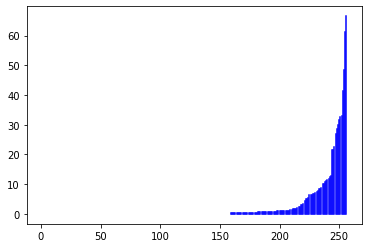

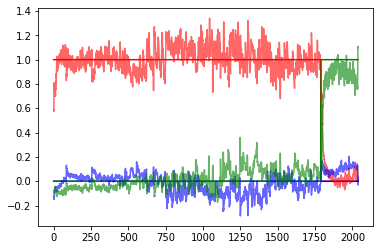

 54%|████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 1629/3000 [9:35:55<7:30:50, 19.73s/it]

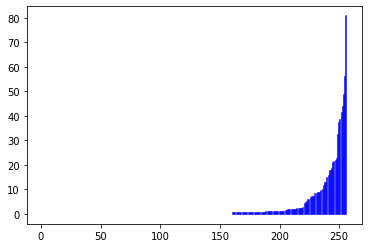

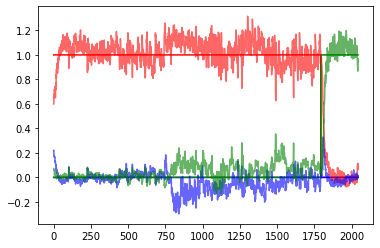

 54%|████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1634/3000 [9:37:37<7:36:40, 20.06s/it]

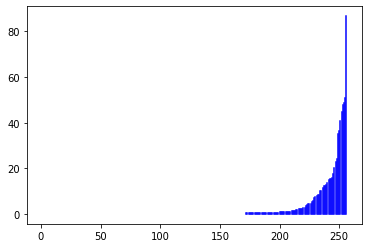

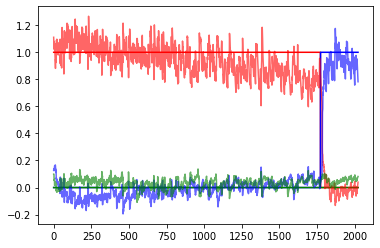

 55%|████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 1639/3000 [9:39:18<7:21:51, 19.48s/it]

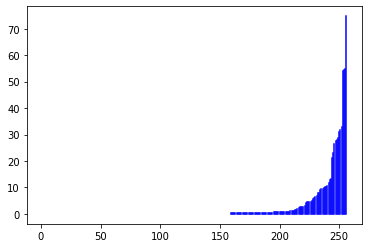

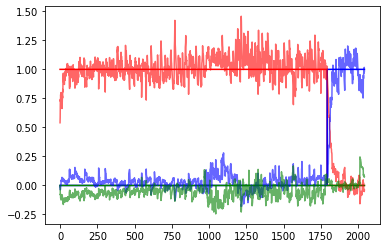

 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 1644/3000 [9:41:03<7:41:32, 20.42s/it]

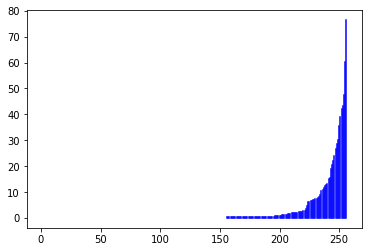

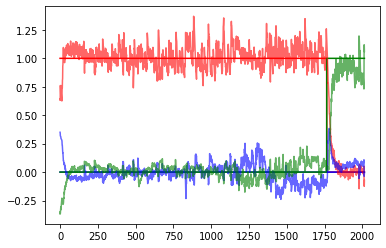

 55%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1649/3000 [9:42:43<7:27:38, 19.88s/it]

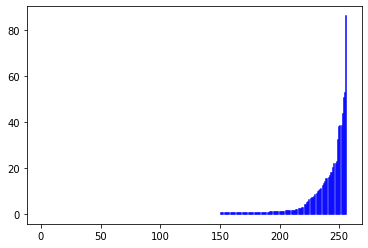

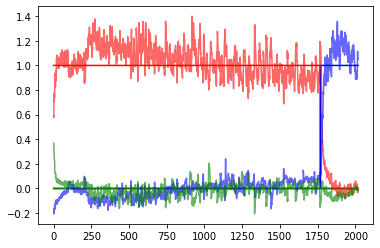

 55%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 1654/3000 [9:45:10<8:36:56, 23.04s/it]

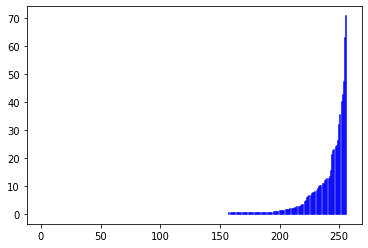

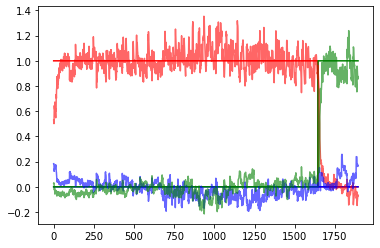

 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 1659/3000 [9:46:53<7:44:44, 20.79s/it]

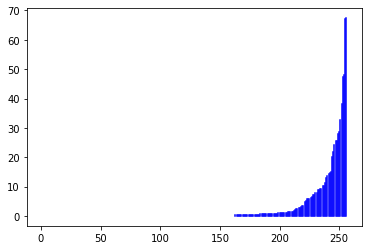

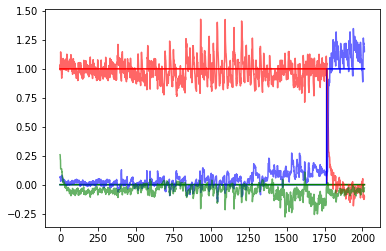

 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 1664/3000 [9:48:35<7:25:05, 19.99s/it]

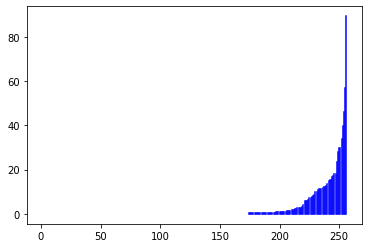

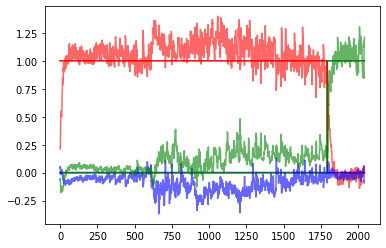

 56%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 1669/3000 [9:50:20<7:32:39, 20.40s/it]

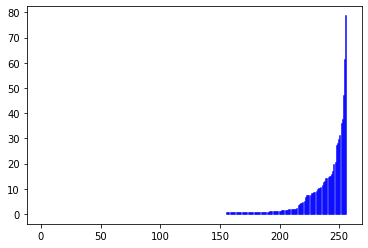

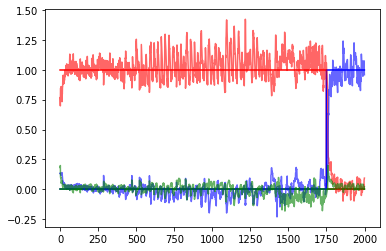

 56%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 1674/3000 [9:51:53<6:46:59, 18.42s/it]

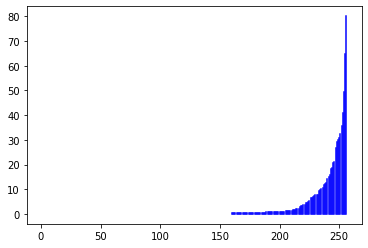

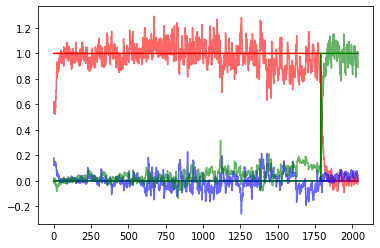

 56%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 1679/3000 [9:53:35<7:06:36, 19.38s/it]

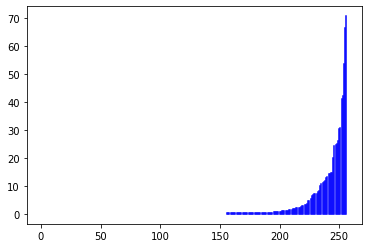

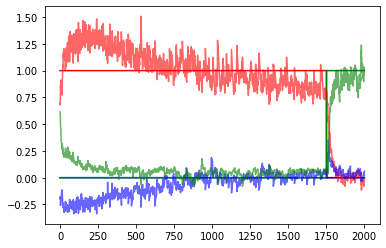

 56%|███████████████████████████████████████████████████████████████████████████████████████                                                                    | 1684/3000 [9:55:17<7:09:02, 19.56s/it]

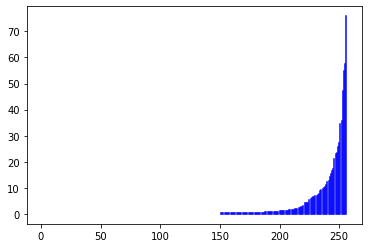

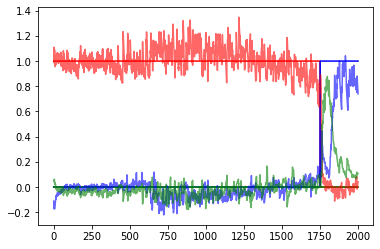

 56%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 1689/3000 [9:56:56<7:02:54, 19.36s/it]

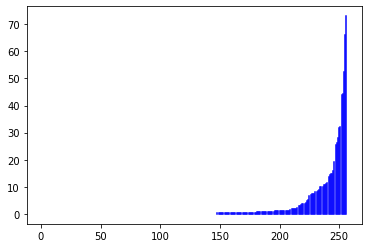

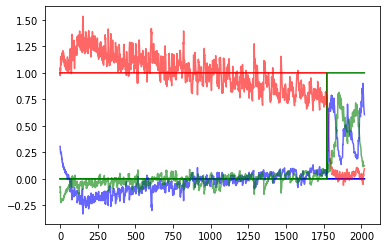

 56%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 1694/3000 [9:58:38<7:12:02, 19.85s/it]

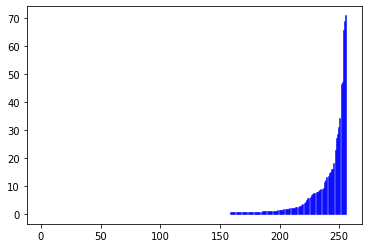

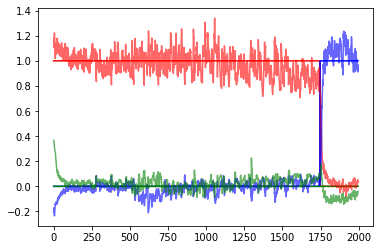

 57%|███████████████████████████████████████████████████████████████████████████████████████▏                                                                  | 1699/3000 [10:00:24<7:25:35, 20.55s/it]

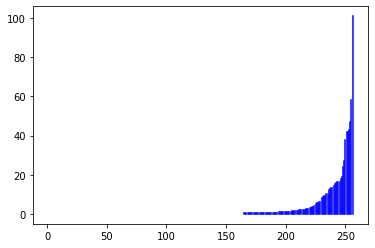

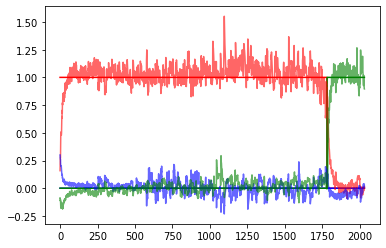

 57%|███████████████████████████████████████████████████████████████████████████████████████▍                                                                  | 1704/3000 [10:02:59<8:35:27, 23.86s/it]

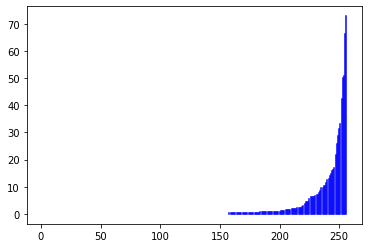

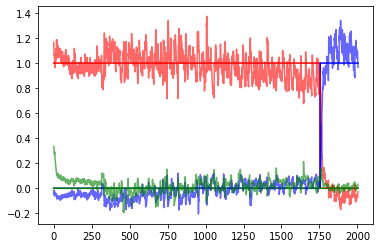

 57%|███████████████████████████████████████████████████████████████████████████████████████▋                                                                  | 1709/3000 [10:04:38<7:13:47, 20.16s/it]

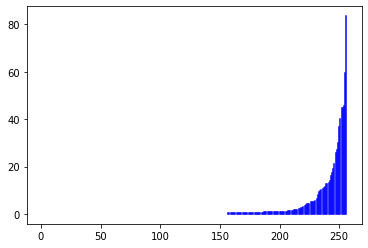

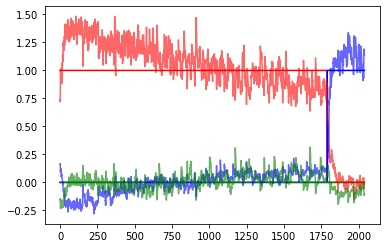

 57%|███████████████████████████████████████████████████████████████████████████████████████▉                                                                  | 1714/3000 [10:06:23<7:12:42, 20.19s/it]

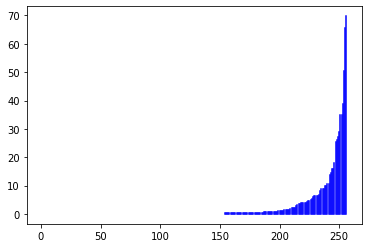

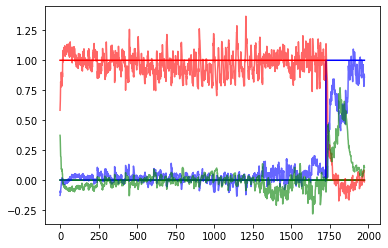

 57%|████████████████████████████████████████████████████████████████████████████████████████▏                                                                 | 1719/3000 [10:08:00<6:57:51, 19.57s/it]

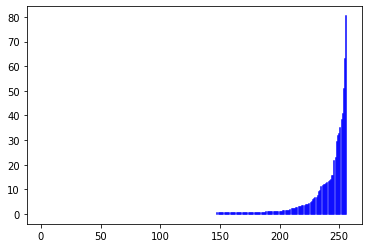

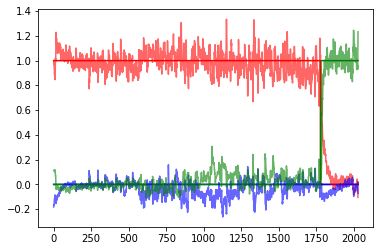

 57%|████████████████████████████████████████████████████████████████████████████████████████▍                                                                 | 1724/3000 [10:09:43<6:59:32, 19.73s/it]

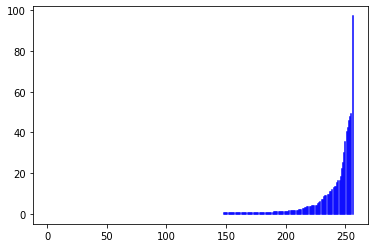

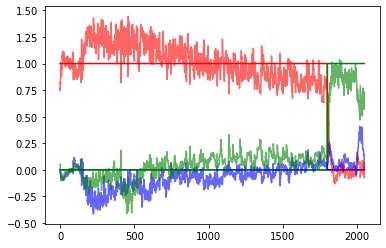

 58%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1729/3000 [10:11:28<7:05:06, 20.07s/it]

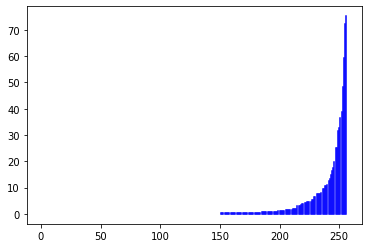

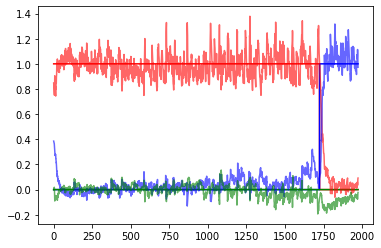

 58%|█████████████████████████████████████████████████████████████████████████████████████████                                                                 | 1734/3000 [10:13:10<6:59:32, 19.88s/it]

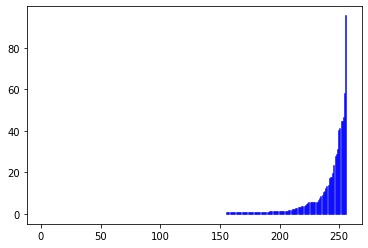

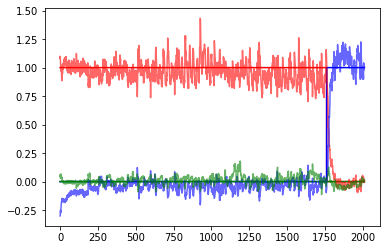

 58%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1739/3000 [10:14:53<6:59:02, 19.94s/it]

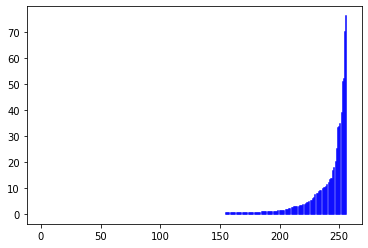

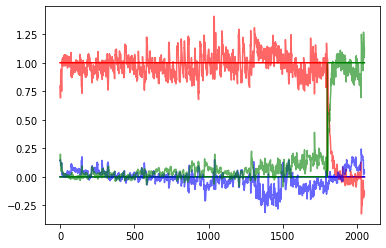

 58%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 1744/3000 [10:16:36<7:00:04, 20.07s/it]

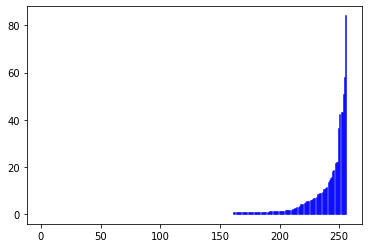

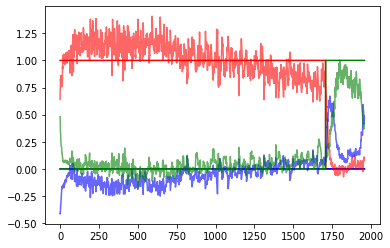

 58%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                | 1749/3000 [10:18:19<6:48:05, 19.57s/it]

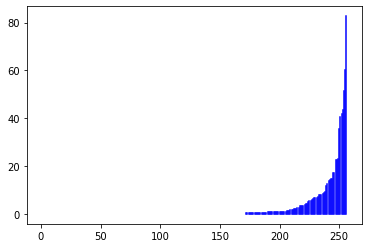

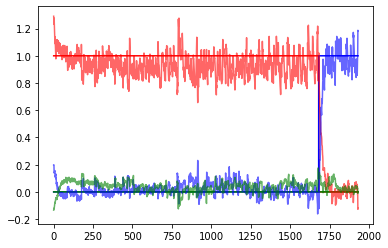

 58%|██████████████████████████████████████████████████████████████████████████████████████████                                                                | 1754/3000 [10:20:46<7:50:21, 22.65s/it]

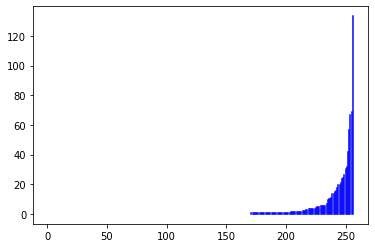

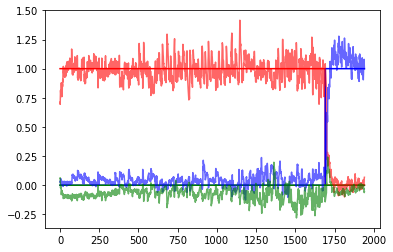

 59%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                               | 1759/3000 [10:22:26<7:02:27, 20.42s/it]

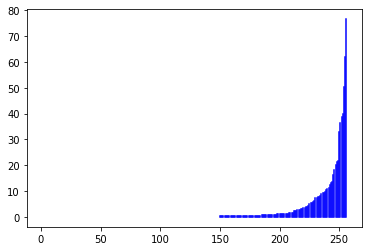

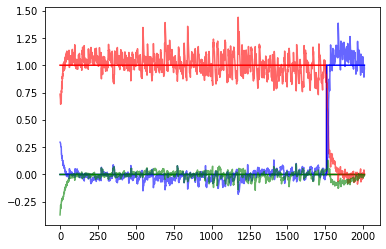

 59%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                               | 1764/3000 [10:24:09<6:56:37, 20.22s/it]

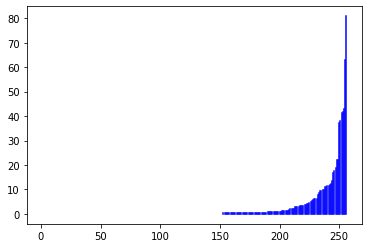

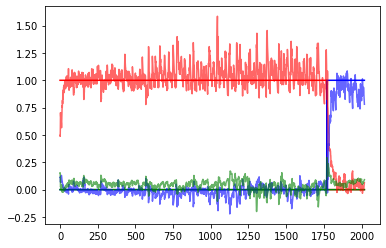

 59%|██████████████████████████████████████████████████████████████████████████████████████████▊                                                               | 1769/3000 [10:25:52<6:56:02, 20.28s/it]

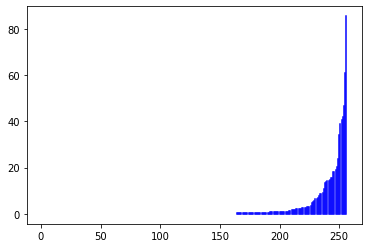

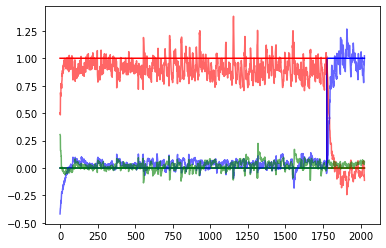

 59%|███████████████████████████████████████████████████████████████████████████████████████████                                                               | 1774/3000 [10:27:31<6:32:43, 19.22s/it]

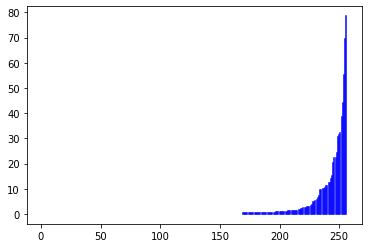

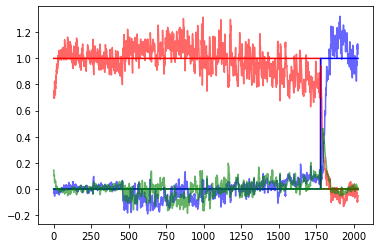

 59%|███████████████████████████████████████████████████████████████████████████████████████████▎                                                              | 1779/3000 [10:29:14<6:45:58, 19.95s/it]

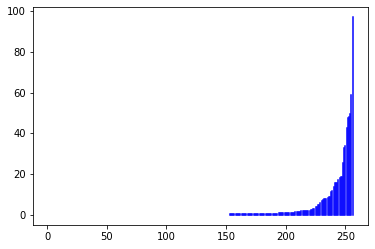

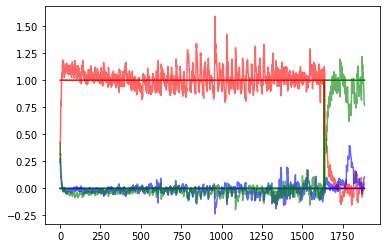

 59%|███████████████████████████████████████████████████████████████████████████████████████████▌                                                              | 1784/3000 [10:30:53<6:34:38, 19.47s/it]

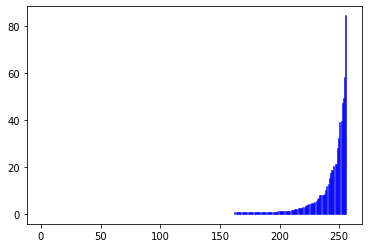

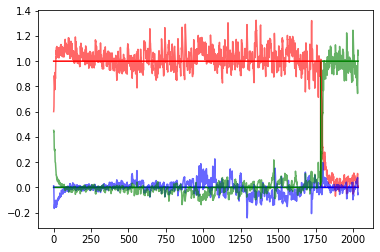

 60%|███████████████████████████████████████████████████████████████████████████████████████████▊                                                              | 1789/3000 [10:32:36<6:41:38, 19.90s/it]

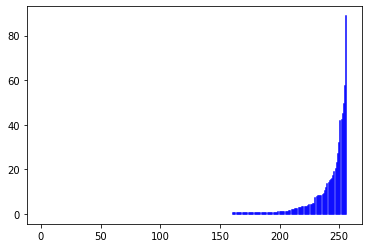

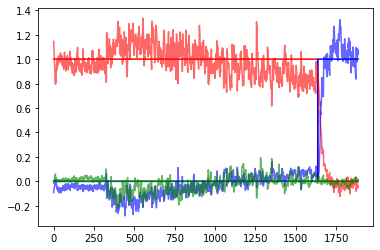

 60%|████████████████████████████████████████████████████████████████████████████████████████████                                                              | 1794/3000 [10:34:17<6:37:38, 19.78s/it]

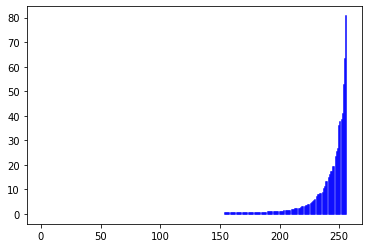

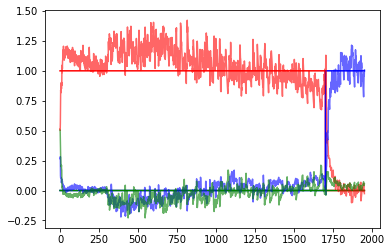

 60%|████████████████████████████████████████████████████████████████████████████████████████████▎                                                             | 1799/3000 [10:35:58<6:32:50, 19.63s/it]

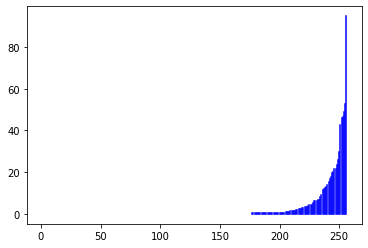

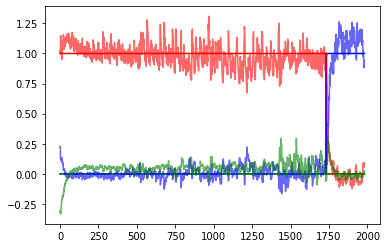

 60%|████████████████████████████████████████████████████████████████████████████████████████████▌                                                             | 1804/3000 [10:38:28<7:37:02, 22.93s/it]

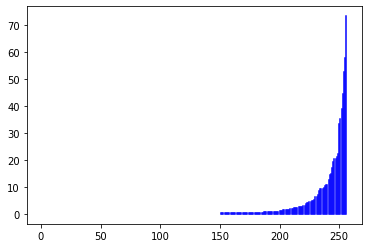

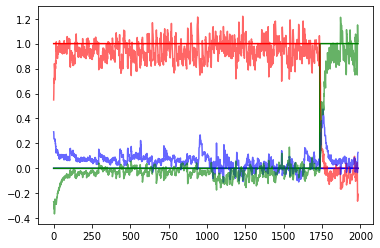

 60%|████████████████████████████████████████████████████████████████████████████████████████████▊                                                             | 1809/3000 [10:40:08<6:37:42, 20.04s/it]

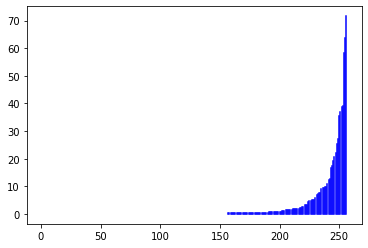

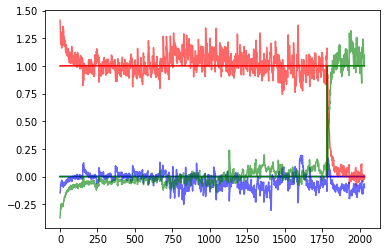

 60%|█████████████████████████████████████████████████████████████████████████████████████████████                                                             | 1814/3000 [10:41:49<6:28:46, 19.67s/it]

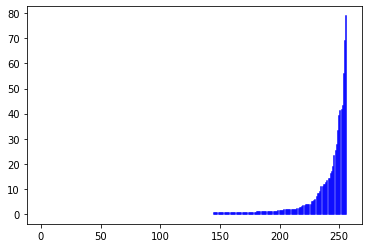

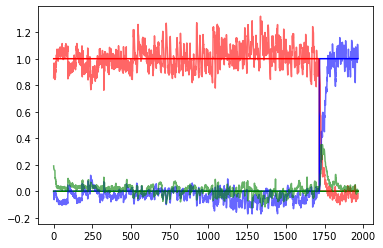

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1819/3000 [10:43:32<6:30:32, 19.84s/it]

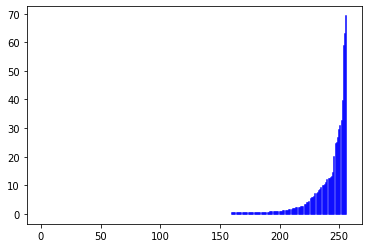

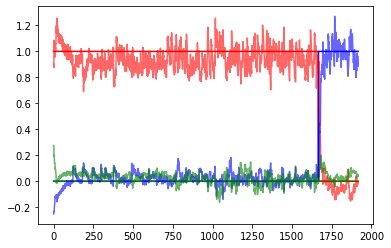

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                            | 1824/3000 [10:45:13<6:28:27, 19.82s/it]

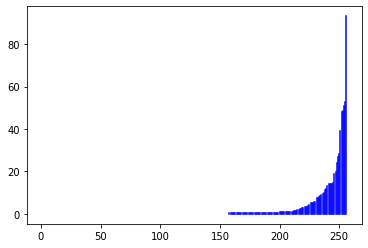

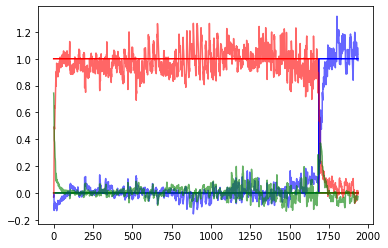

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                            | 1829/3000 [10:46:51<6:21:43, 19.56s/it]

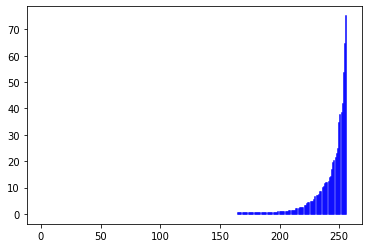

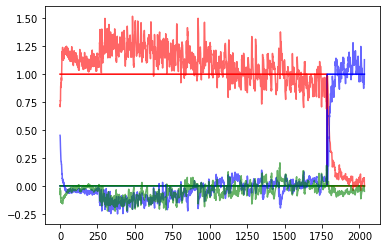

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                           | 1834/3000 [10:48:28<6:12:32, 19.17s/it]

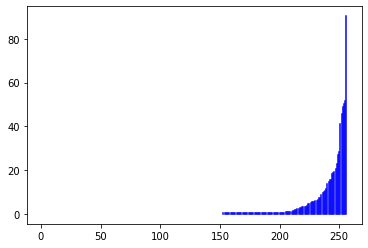

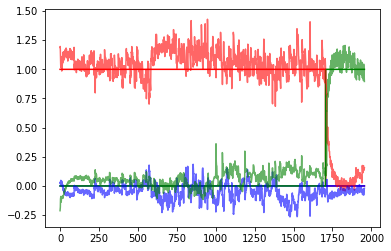

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                           | 1839/3000 [10:50:08<6:19:33, 19.62s/it]

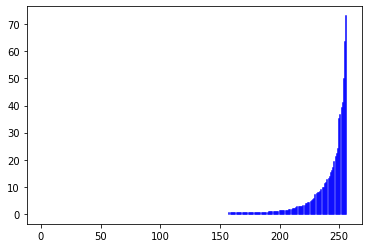

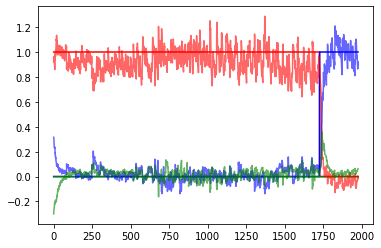

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▋                                                           | 1844/3000 [10:51:52<6:32:14, 20.36s/it]

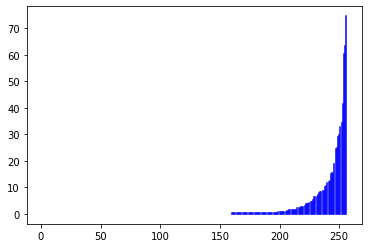

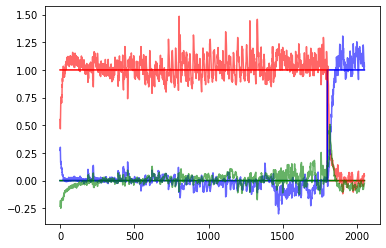

 62%|██████████████████████████████████████████████████████████████████████████████████████████████▉                                                           | 1849/3000 [10:53:36<6:27:53, 20.22s/it]

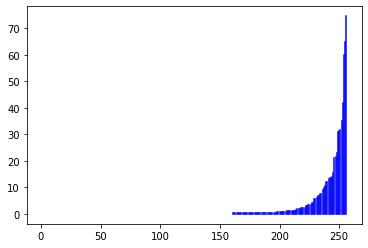

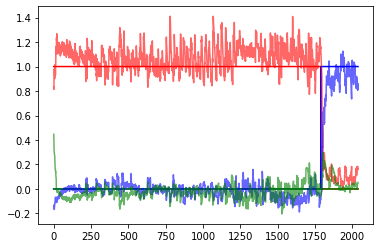

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▏                                                          | 1854/3000 [10:56:06<7:33:23, 23.74s/it]

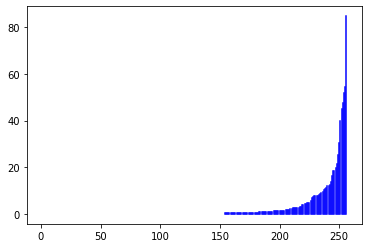

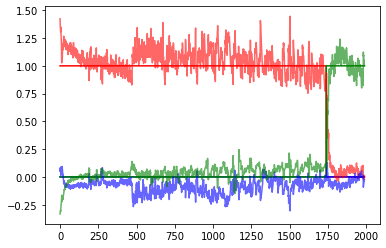

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▍                                                          | 1859/3000 [10:57:50<6:39:45, 21.02s/it]

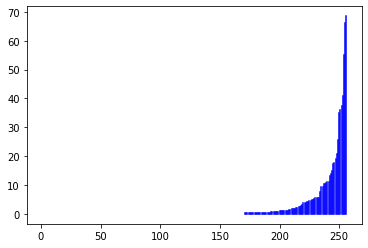

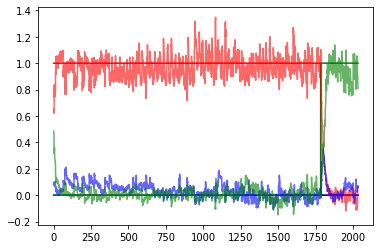

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▋                                                          | 1864/3000 [10:59:31<6:17:47, 19.95s/it]

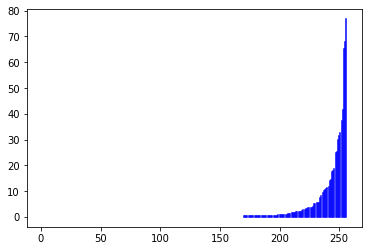

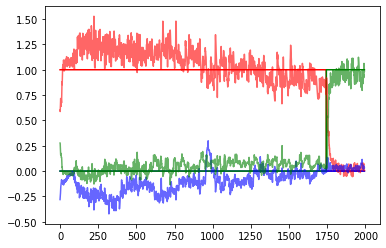

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▉                                                          | 1869/3000 [11:01:16<6:21:56, 20.26s/it]

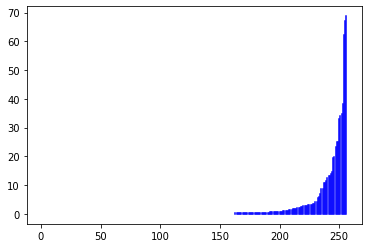

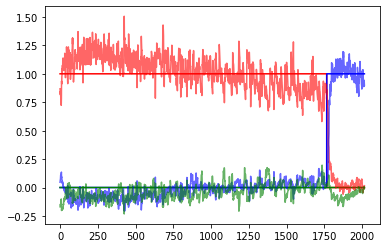

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▏                                                         | 1874/3000 [11:02:59<6:15:46, 20.02s/it]

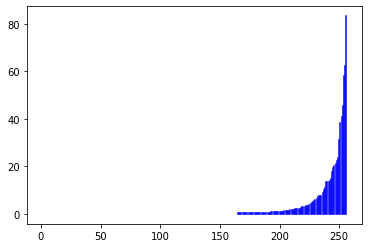

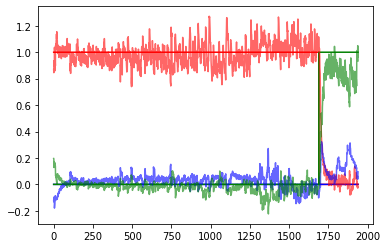

 63%|████████████████████████████████████████████████████████████████████████████████████████████████▍                                                         | 1879/3000 [11:04:41<6:10:56, 19.85s/it]

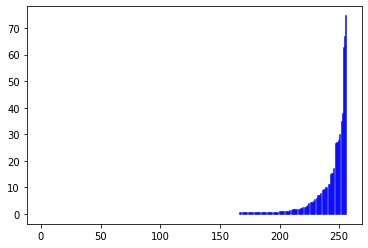

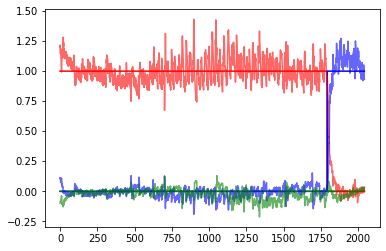

 63%|████████████████████████████████████████████████████████████████████████████████████████████████▋                                                         | 1884/3000 [11:06:26<6:20:02, 20.43s/it]

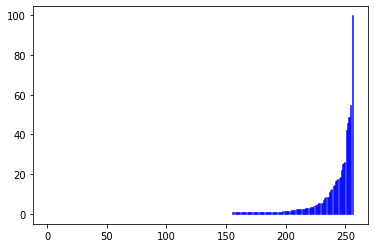

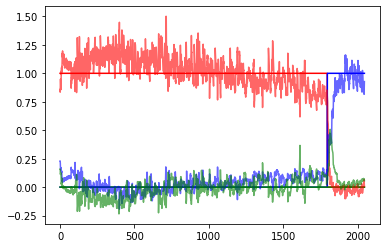

 63%|████████████████████████████████████████████████████████████████████████████████████████████████▉                                                         | 1889/3000 [11:08:08<6:10:27, 20.01s/it]

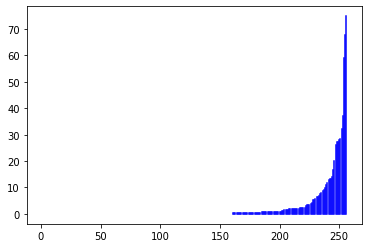

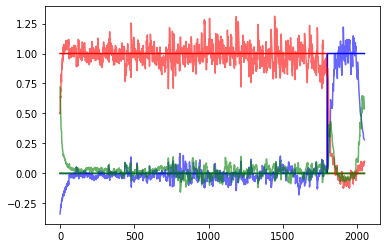

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                                                        | 1894/3000 [11:09:49<6:05:56, 19.85s/it]

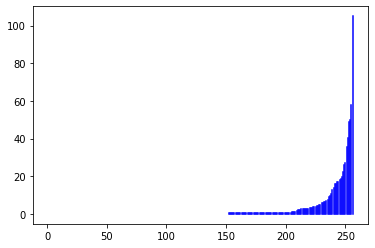

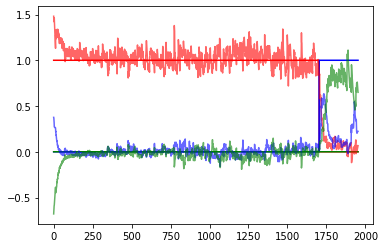

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                                                        | 1899/3000 [11:11:32<6:02:10, 19.74s/it]

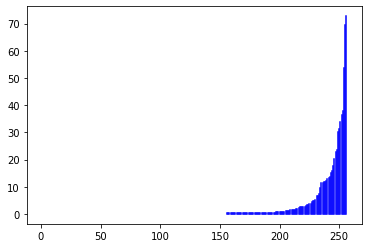

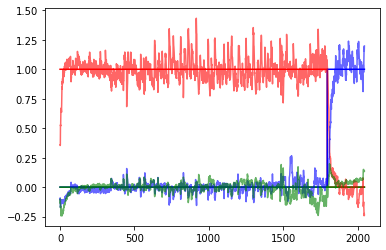

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1904/3000 [11:14:04<7:15:18, 23.83s/it]

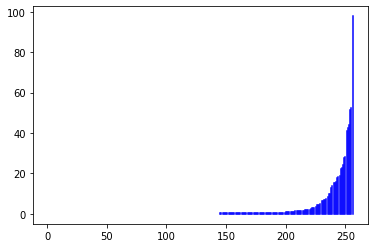

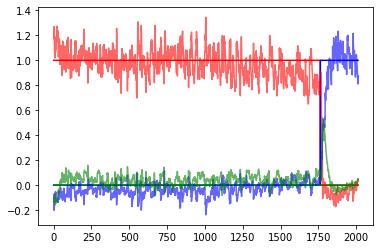

 64%|█████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1909/3000 [11:15:42<6:04:43, 20.06s/it]

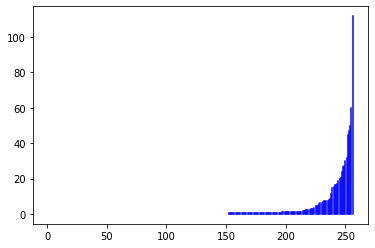

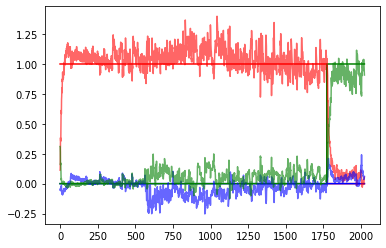

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                       | 1914/3000 [11:17:24<5:56:58, 19.72s/it]

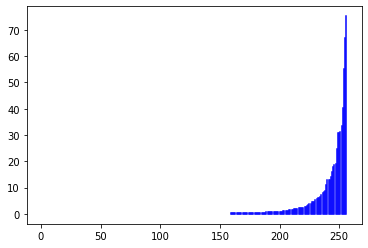

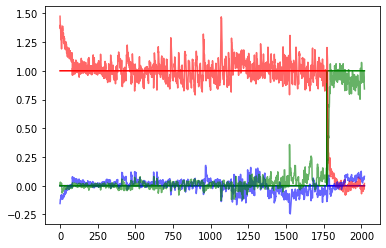

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                                                       | 1919/3000 [11:19:07<5:58:18, 19.89s/it]

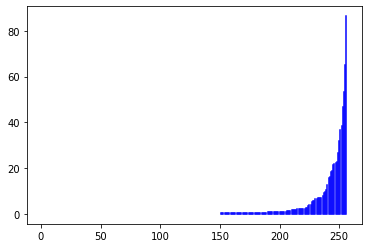

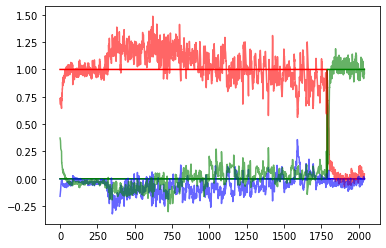

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▊                                                       | 1924/3000 [11:20:47<5:47:24, 19.37s/it]

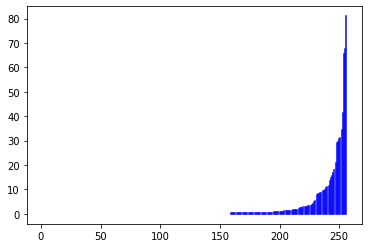

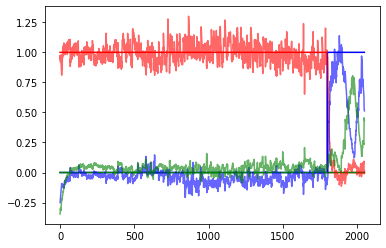

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████                                                       | 1929/3000 [11:22:26<5:40:53, 19.10s/it]

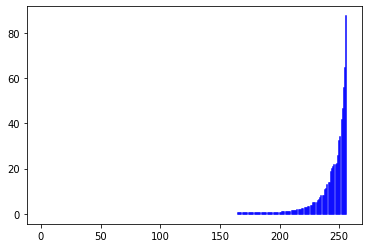

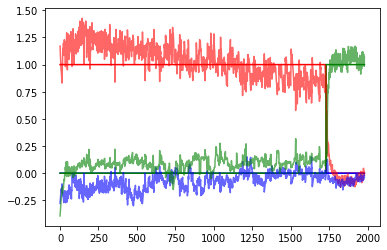

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                                                      | 1934/3000 [11:24:07<5:44:32, 19.39s/it]

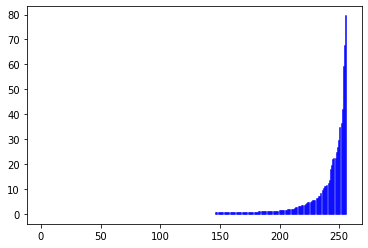

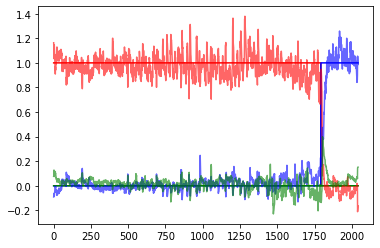

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████▌                                                      | 1939/3000 [11:25:48<5:52:01, 19.91s/it]

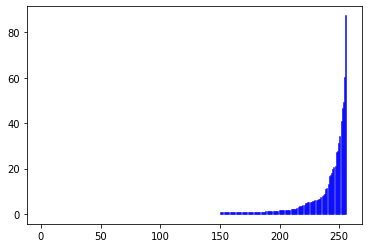

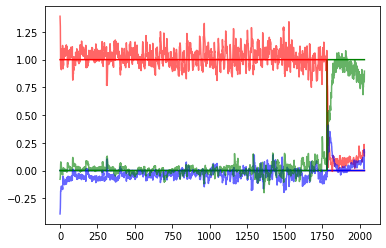

 65%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                                                      | 1944/3000 [11:27:33<5:57:31, 20.31s/it]

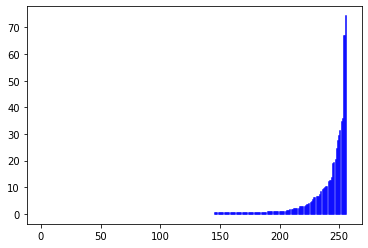

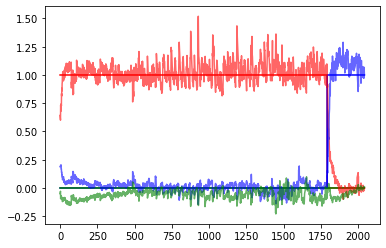

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████                                                      | 1949/3000 [11:29:13<5:38:17, 19.31s/it]

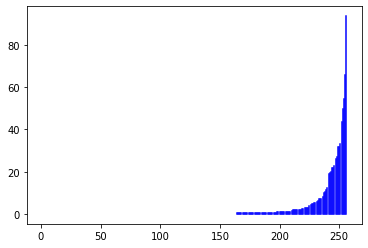

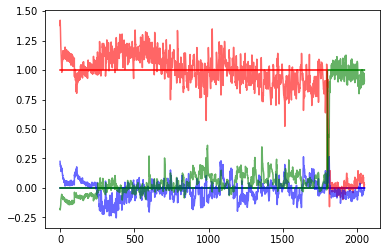

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                     | 1954/3000 [11:31:44<6:40:13, 22.96s/it]

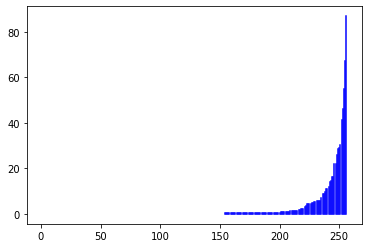

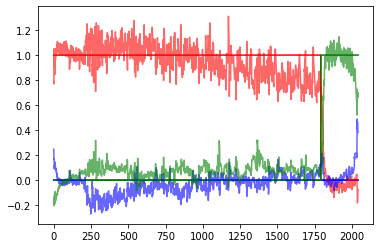

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                     | 1959/3000 [11:33:26<5:58:34, 20.67s/it]

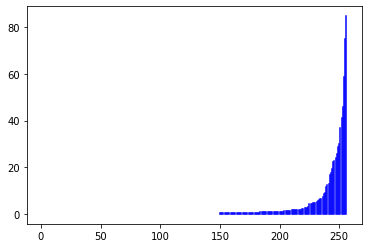

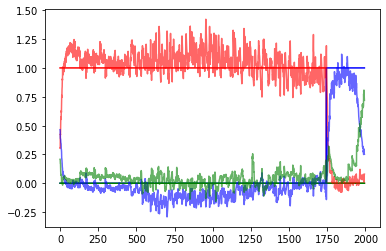

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                     | 1964/3000 [11:35:08<5:50:06, 20.28s/it]

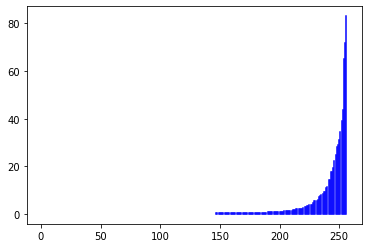

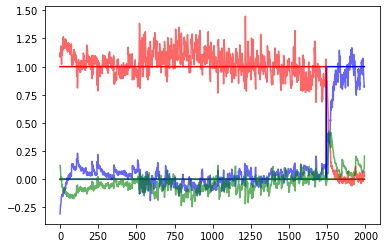

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████                                                     | 1969/3000 [11:36:51<5:42:30, 19.93s/it]

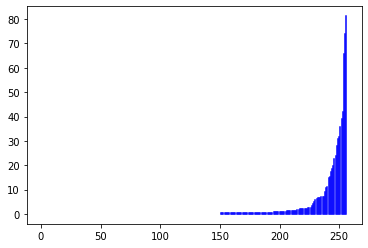

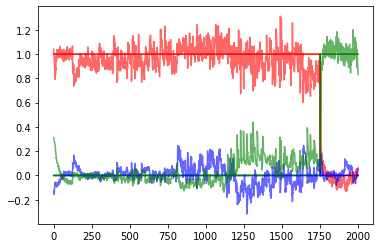

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                    | 1974/3000 [11:38:31<5:34:36, 19.57s/it]

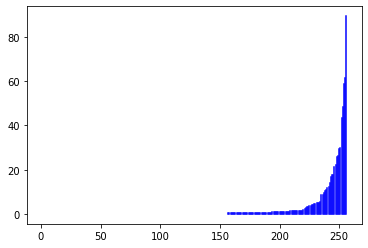

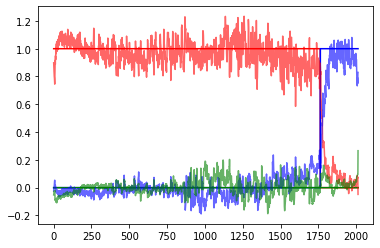

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 1979/3000 [11:40:08<5:22:58, 18.98s/it]

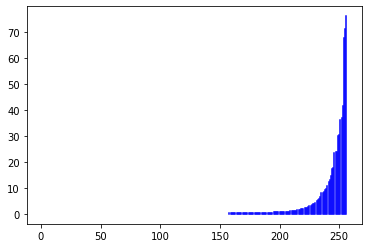

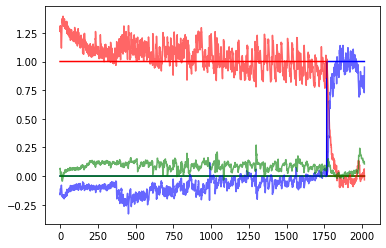

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 1984/3000 [11:41:49<5:33:17, 19.68s/it]

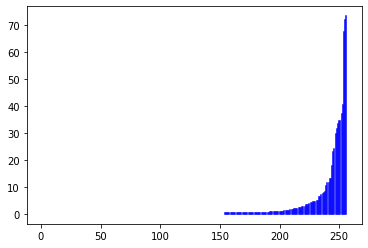

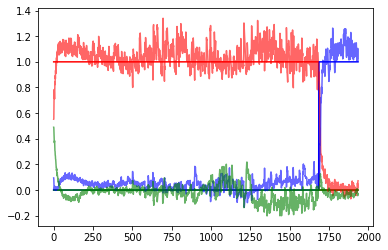

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 1989/3000 [11:43:29<5:29:58, 19.58s/it]

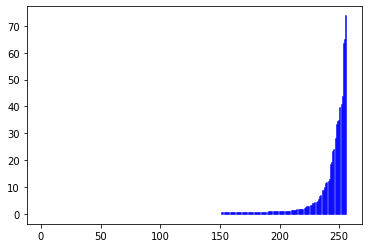

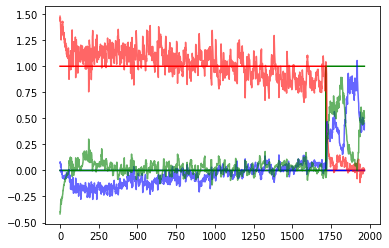

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 1994/3000 [11:45:14<5:40:35, 20.31s/it]

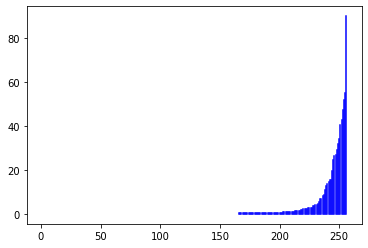

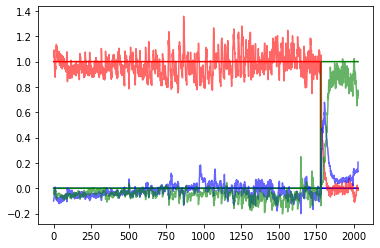

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 1999/3000 [11:46:57<5:39:03, 20.32s/it]

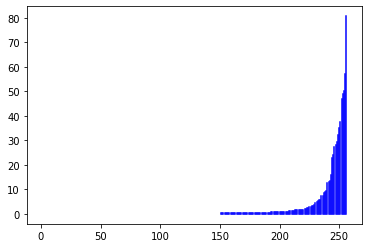

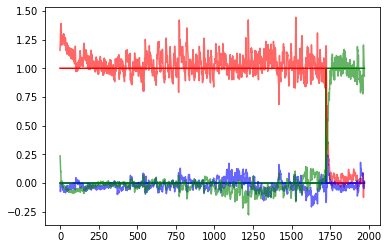

 67%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2004/3000 [11:49:22<6:19:39, 22.87s/it]

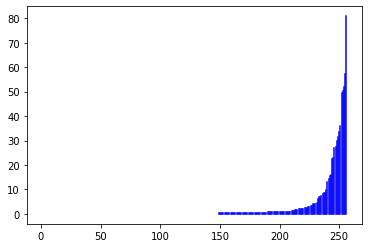

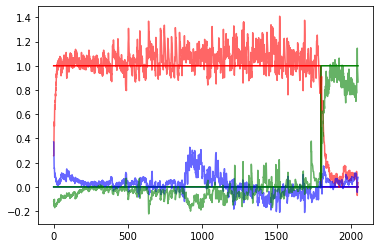

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                  | 2009/3000 [11:51:02<5:32:28, 20.13s/it]

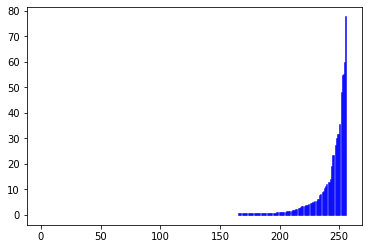

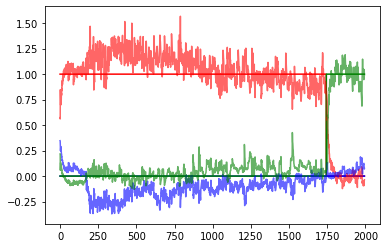

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                  | 2014/3000 [11:52:41<5:19:14, 19.43s/it]

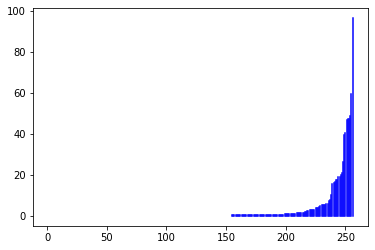

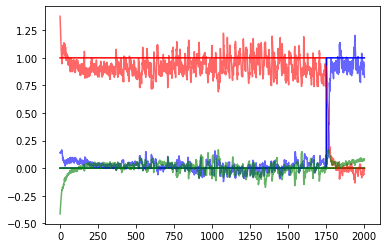

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                  | 2019/3000 [11:54:24<5:32:58, 20.37s/it]

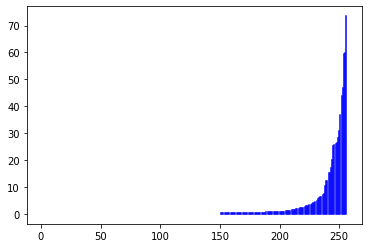

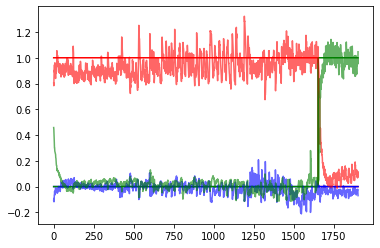

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                  | 2024/3000 [11:56:06<5:26:40, 20.08s/it]

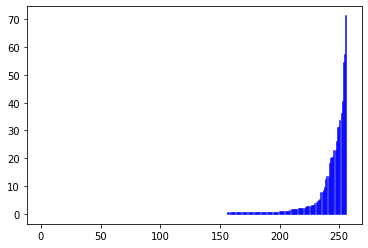

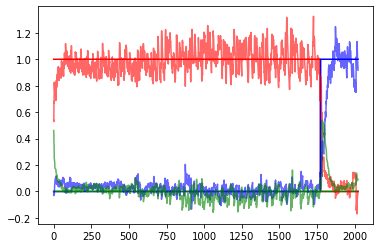

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                 | 2029/3000 [11:57:48<5:17:48, 19.64s/it]

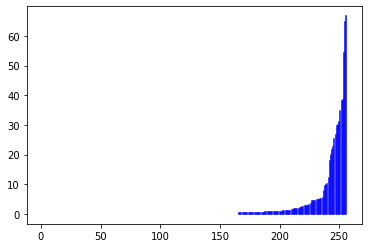

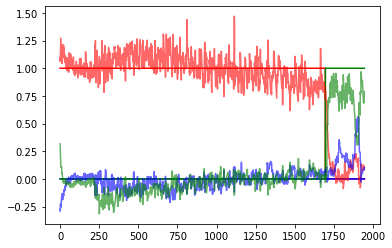

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                 | 2034/3000 [11:59:28<5:15:31, 19.60s/it]

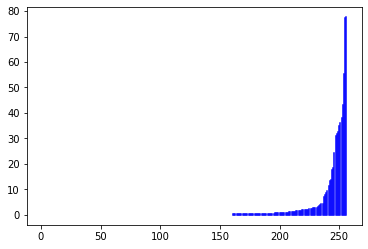

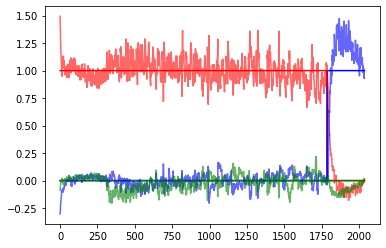

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                 | 2039/3000 [12:01:09<5:18:13, 19.87s/it]

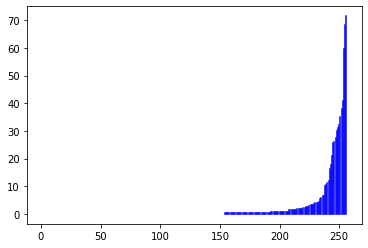

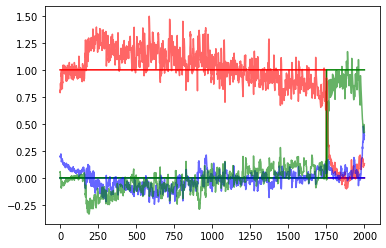

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                 | 2044/3000 [12:02:50<5:14:05, 19.71s/it]

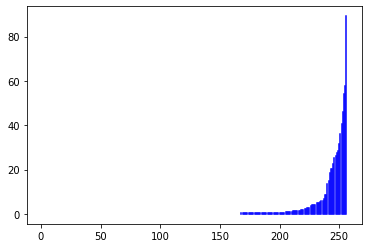

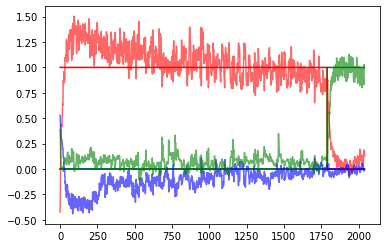

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                | 2049/3000 [12:04:30<5:01:00, 18.99s/it]

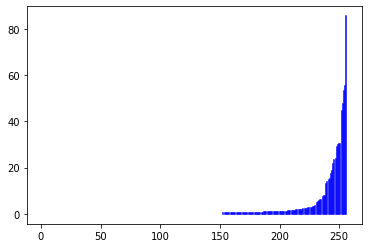

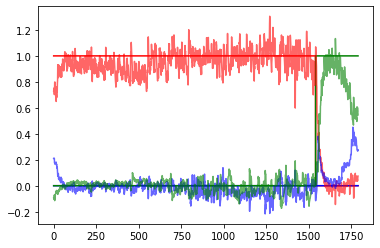

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2054/3000 [12:06:59<6:08:02, 23.34s/it]

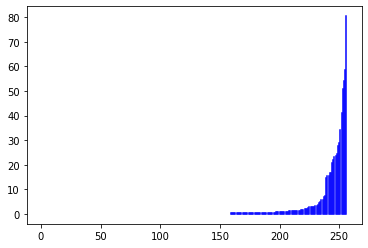

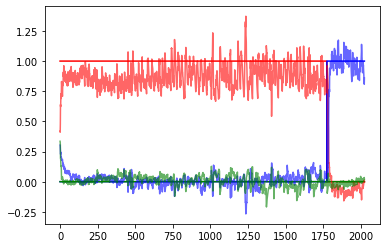

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2059/3000 [12:08:35<5:12:53, 19.95s/it]

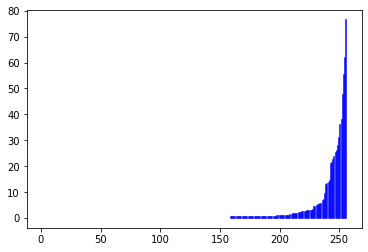

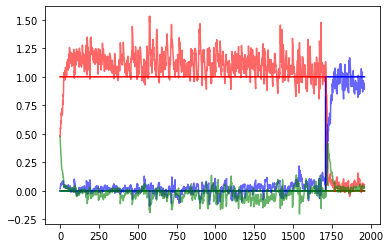

 69%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 2064/3000 [12:10:18<5:16:20, 20.28s/it]

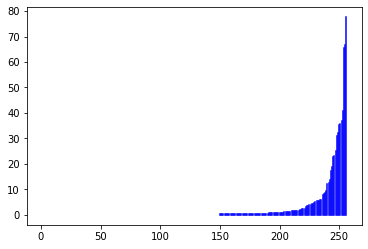

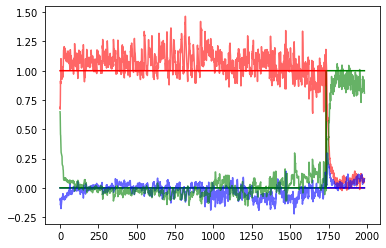

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2069/3000 [12:12:06<5:26:38, 21.05s/it]

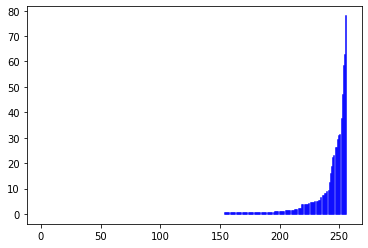

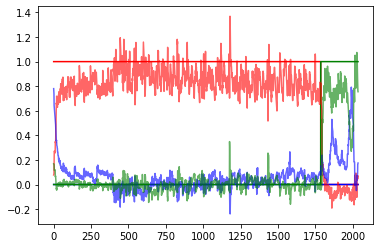

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2074/3000 [12:13:44<5:01:19, 19.52s/it]

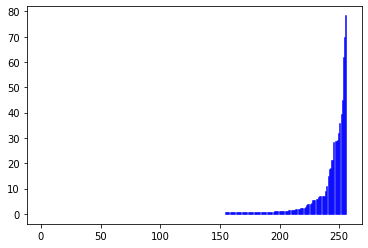

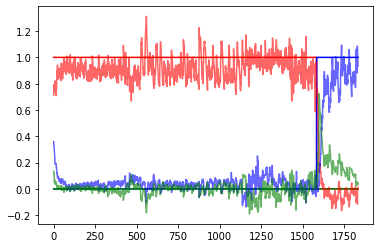

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2079/3000 [12:15:29<5:16:44, 20.63s/it]

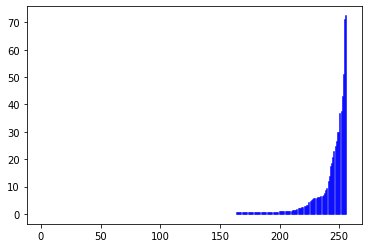

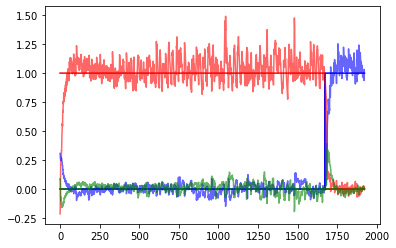

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2084/3000 [12:17:14<5:18:28, 20.86s/it]

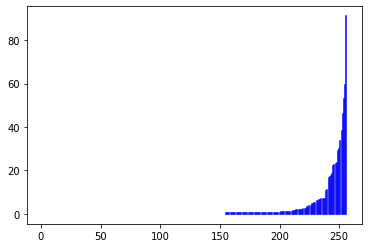

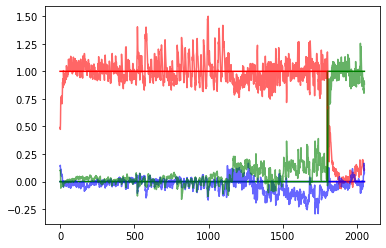

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2089/3000 [12:18:57<5:04:59, 20.09s/it]

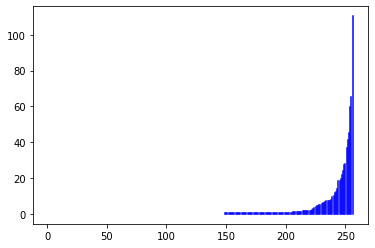

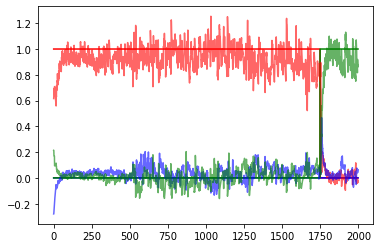

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2094/3000 [12:20:37<4:51:07, 19.28s/it]

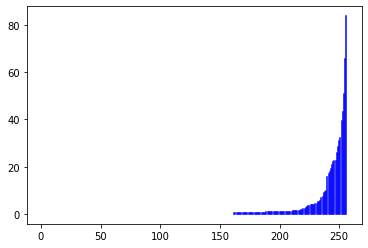

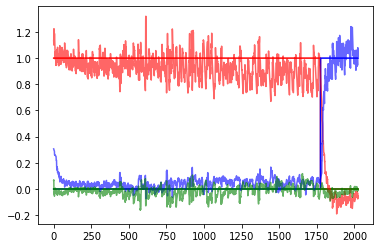

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2099/3000 [12:22:19<4:55:38, 19.69s/it]

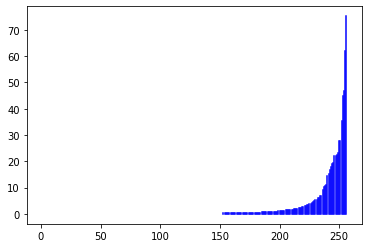

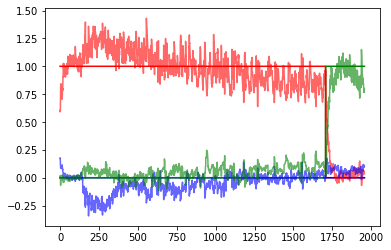

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████                                              | 2104/3000 [12:24:48<5:40:03, 22.77s/it]

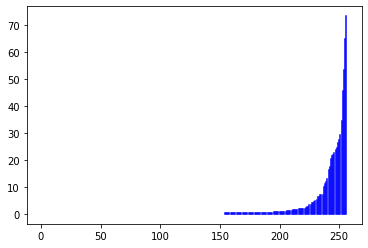

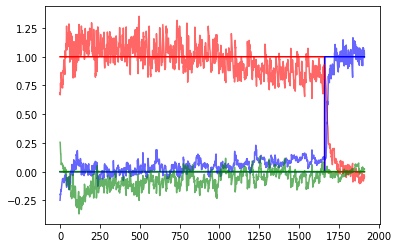

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                             | 2109/3000 [12:26:28<4:58:11, 20.08s/it]

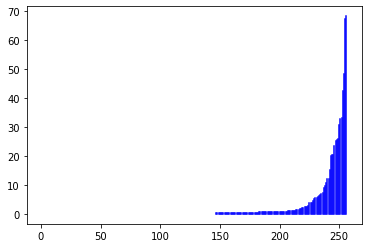

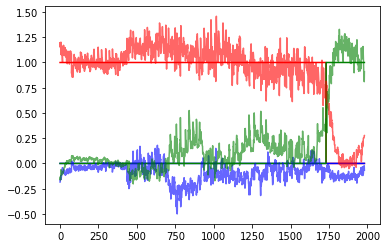

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                             | 2114/3000 [12:28:11<4:54:48, 19.96s/it]

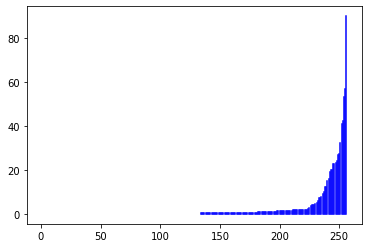

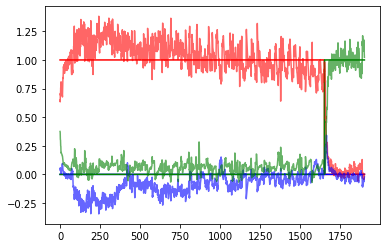

 71%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                             | 2119/3000 [12:29:54<4:54:26, 20.05s/it]

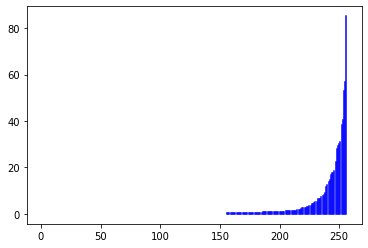

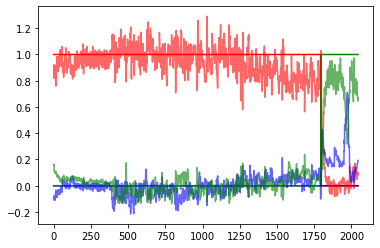

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████                                             | 2124/3000 [12:31:40<5:01:06, 20.62s/it]

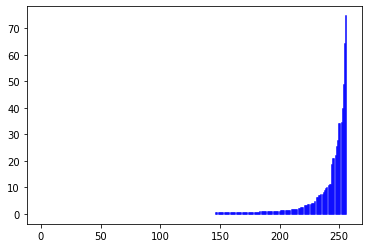

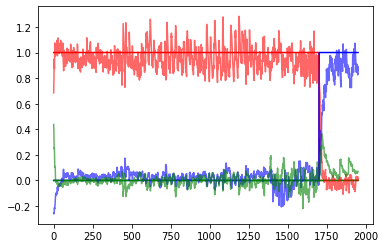

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2129/3000 [12:33:22<4:55:28, 20.35s/it]

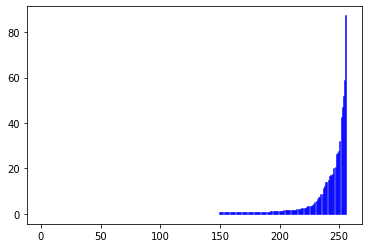

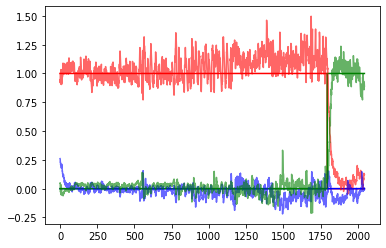

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2134/3000 [12:35:08<4:57:44, 20.63s/it]

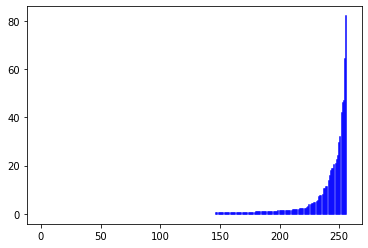

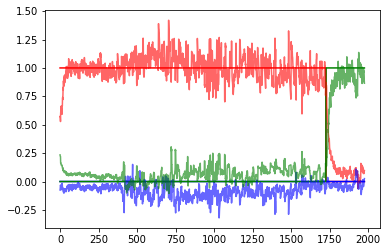

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2139/3000 [12:36:52<4:50:11, 20.22s/it]

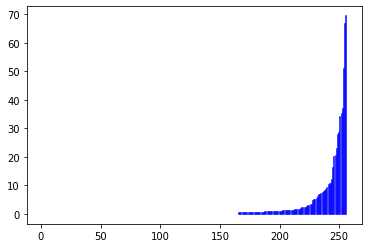

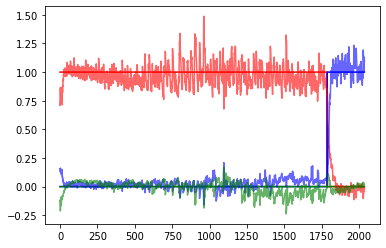

 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2144/3000 [12:38:33<4:48:23, 20.21s/it]

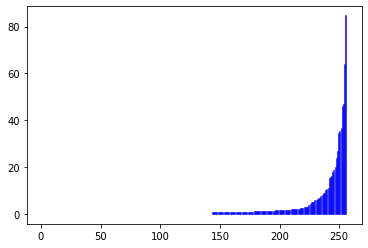

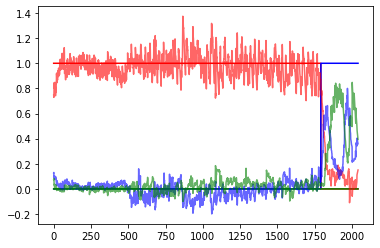

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2149/3000 [12:40:13<4:35:56, 19.46s/it]

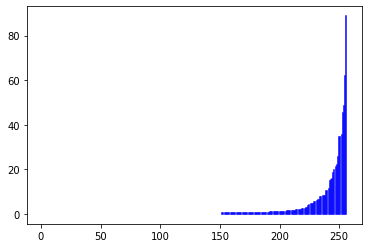

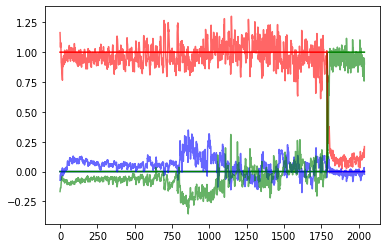

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2154/3000 [12:42:41<5:25:14, 23.07s/it]

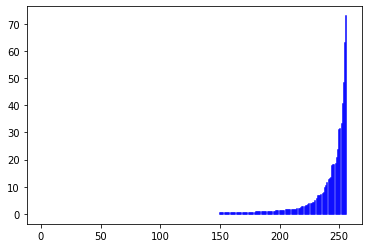

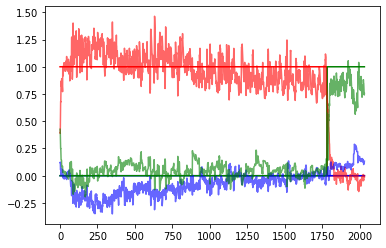

 72%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2159/3000 [12:44:23<4:46:16, 20.42s/it]

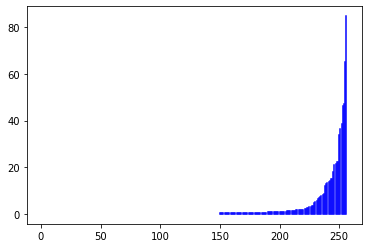

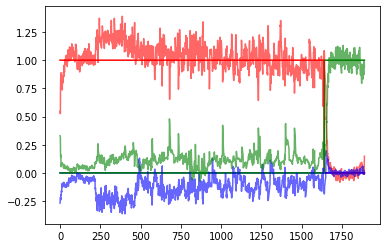

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2164/3000 [12:46:08<4:46:29, 20.56s/it]

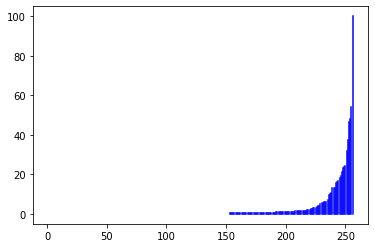

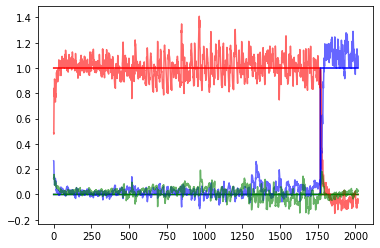

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2169/3000 [12:47:54<4:45:30, 20.61s/it]

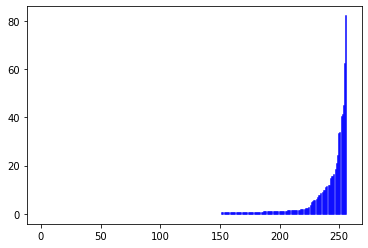

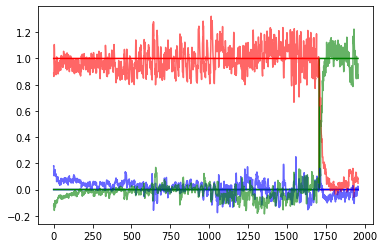

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2174/3000 [12:49:37<4:40:20, 20.36s/it]

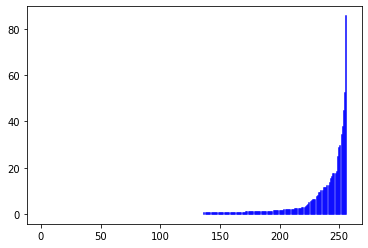

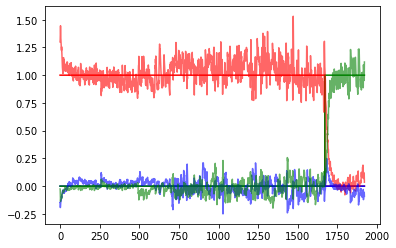

 73%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2179/3000 [12:51:19<4:34:04, 20.03s/it]

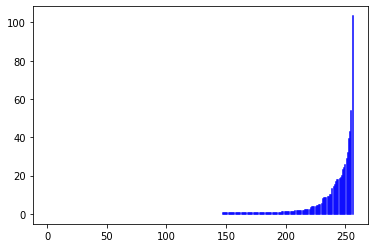

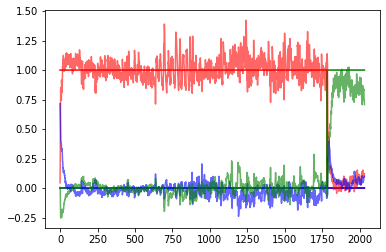

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2184/3000 [12:53:04<4:40:25, 20.62s/it]

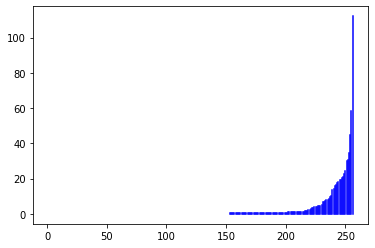

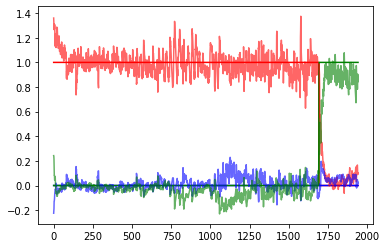

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2189/3000 [12:54:48<4:39:12, 20.66s/it]

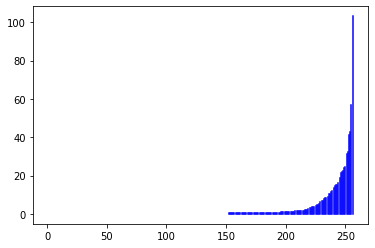

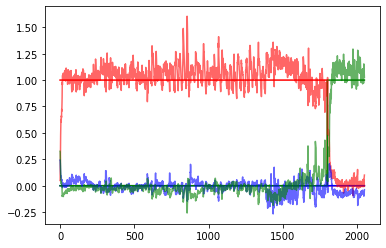

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                         | 2194/3000 [12:56:33<4:34:14, 20.42s/it]

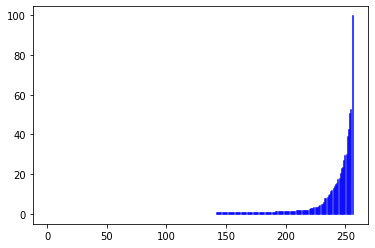

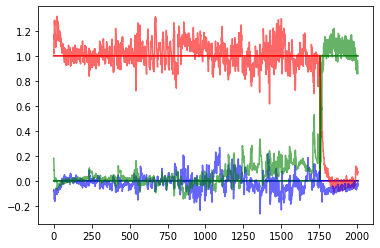

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                         | 2199/3000 [12:58:13<4:26:12, 19.94s/it]

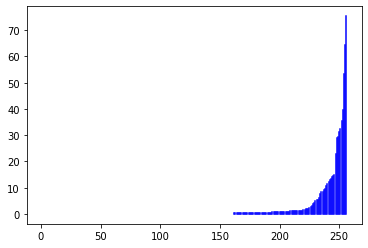

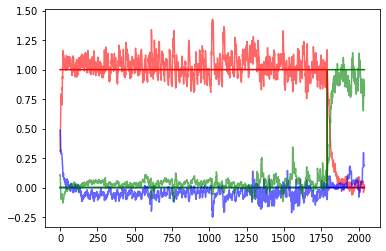

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2204/3000 [13:00:43<5:07:08, 23.15s/it]

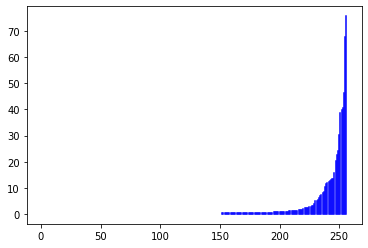

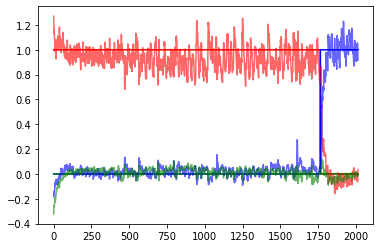

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2209/3000 [13:02:24<4:30:01, 20.48s/it]

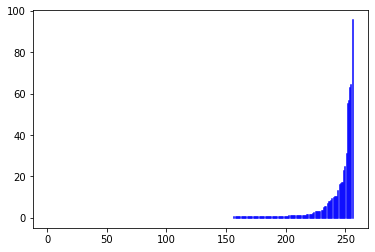

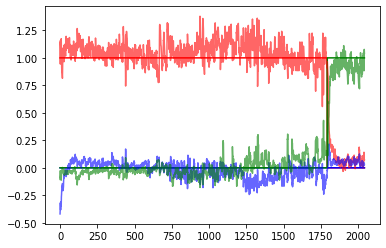

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2214/3000 [13:04:08<4:29:32, 20.58s/it]

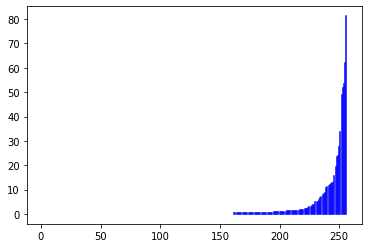

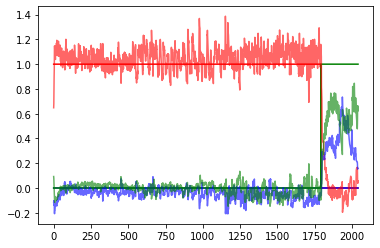

 74%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2219/3000 [13:05:52<4:27:15, 20.53s/it]

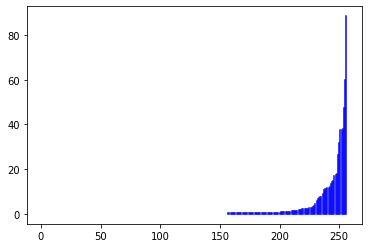

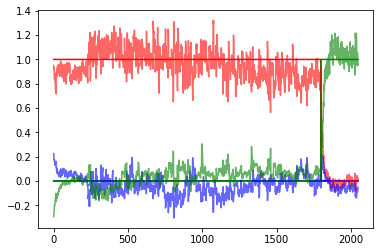

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2224/3000 [13:07:35<4:19:26, 20.06s/it]

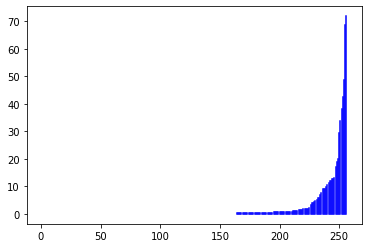

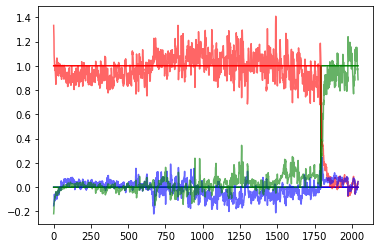

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2229/3000 [13:09:15<4:08:01, 19.30s/it]

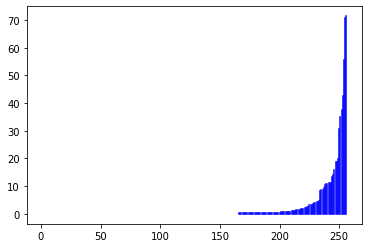

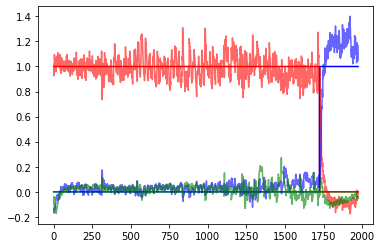

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2234/3000 [13:11:01<4:21:45, 20.50s/it]

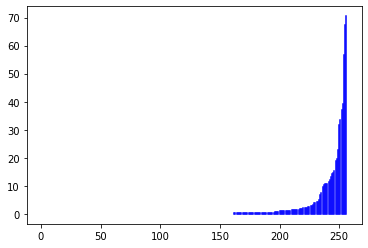

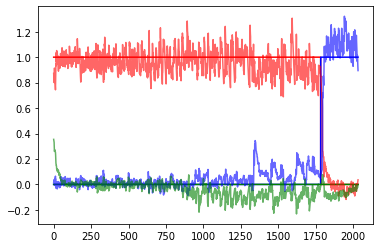

 75%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2239/3000 [13:12:45<4:15:37, 20.15s/it]

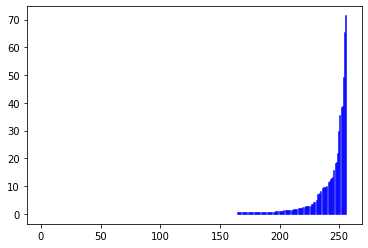

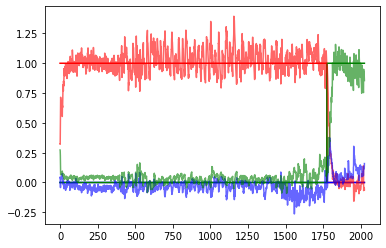

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2244/3000 [13:14:26<4:07:23, 19.63s/it]

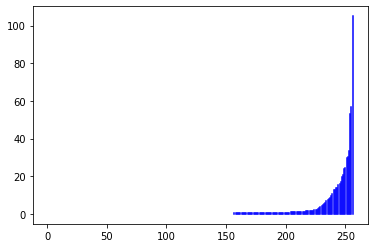

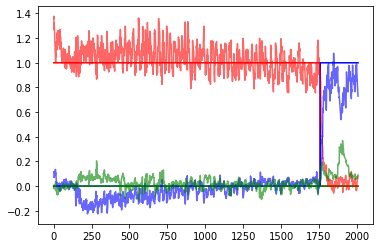

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2249/3000 [13:16:04<4:00:31, 19.22s/it]

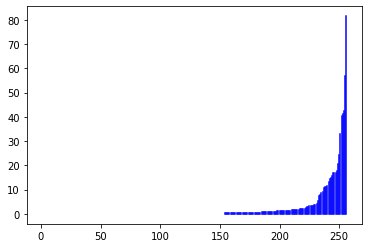

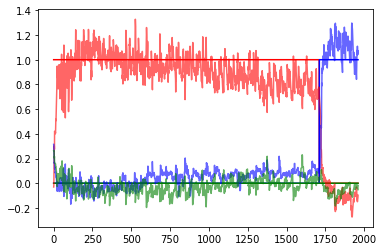

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2254/3000 [13:18:28<4:42:50, 22.75s/it]

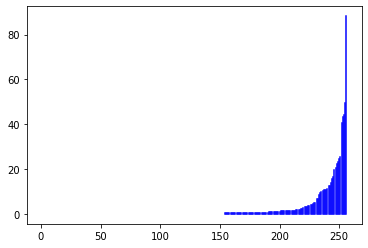

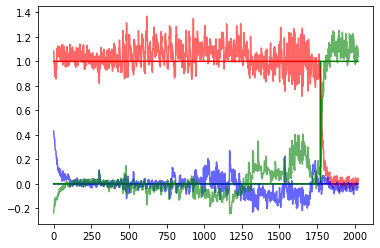

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2259/3000 [13:20:09<4:07:22, 20.03s/it]

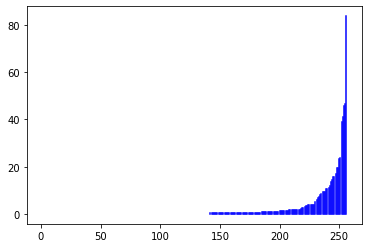

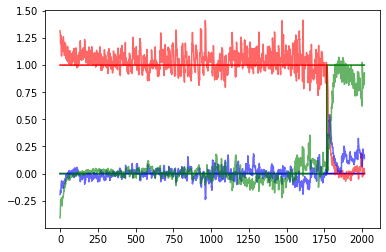

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2264/3000 [13:21:48<3:59:02, 19.49s/it]

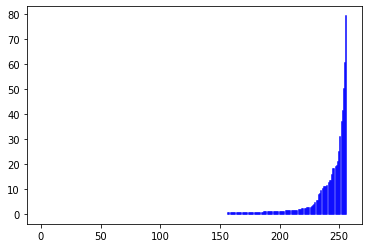

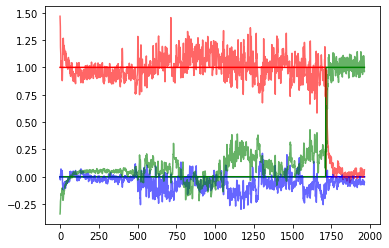

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2269/3000 [13:23:26<3:50:18, 18.90s/it]

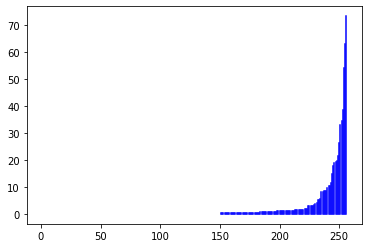

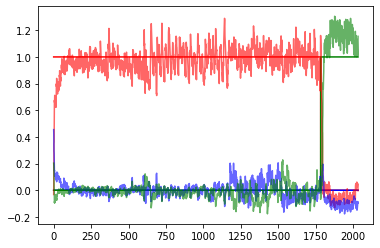

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2274/3000 [13:25:10<4:05:19, 20.28s/it]

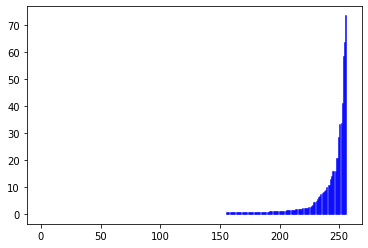

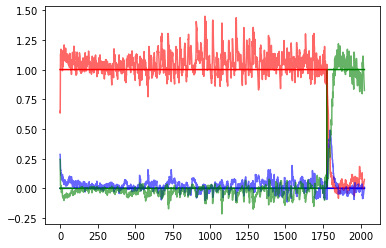

 76%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                     | 2279/3000 [13:26:54<4:00:28, 20.01s/it]

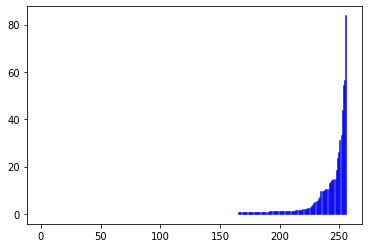

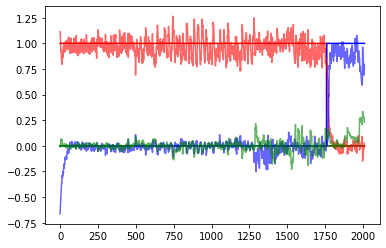

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                    | 2284/3000 [13:28:35<3:55:45, 19.76s/it]

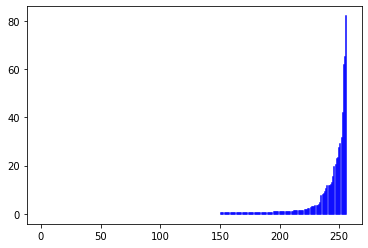

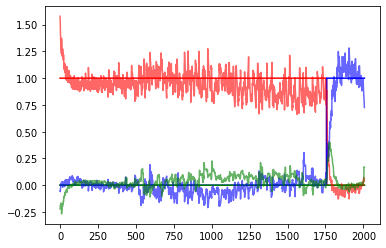

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2289/3000 [13:30:13<3:44:09, 18.92s/it]

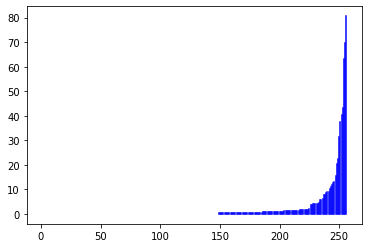

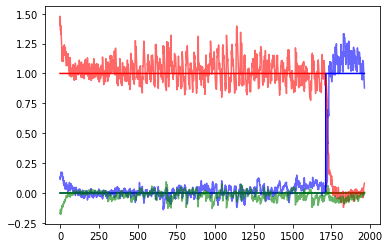

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2294/3000 [13:31:51<3:43:18, 18.98s/it]

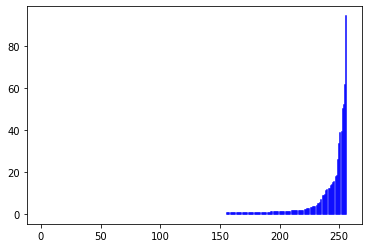

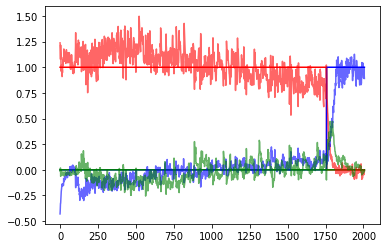

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2299/3000 [13:33:31<3:47:52, 19.50s/it]

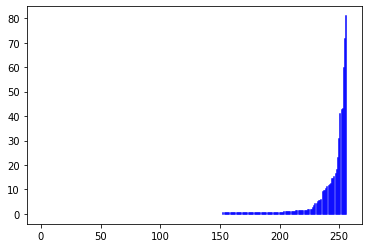

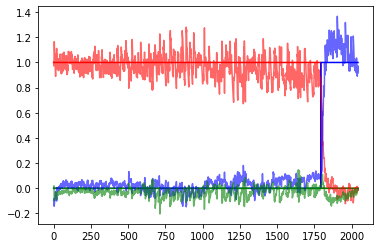

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2304/3000 [13:36:02<4:29:12, 23.21s/it]

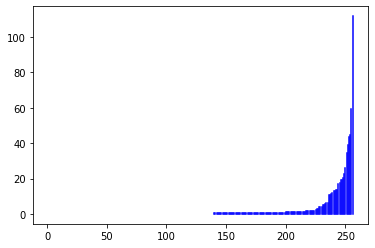

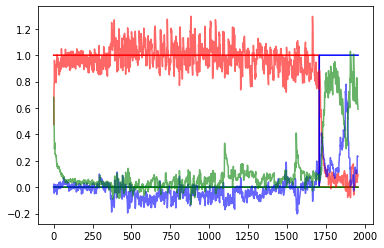

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2309/3000 [13:37:40<3:49:40, 19.94s/it]

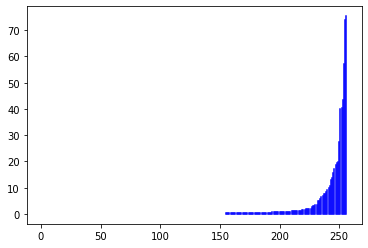

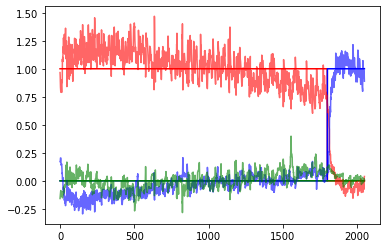

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2314/3000 [13:39:18<3:35:45, 18.87s/it]

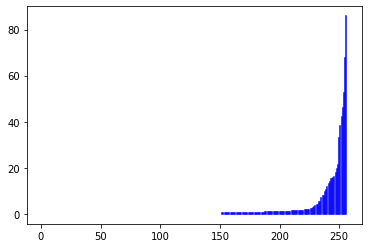

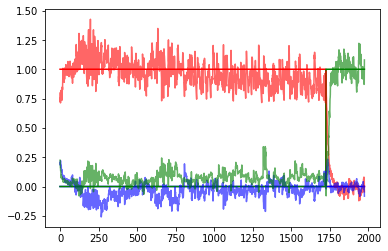

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2319/3000 [13:40:58<3:40:09, 19.40s/it]

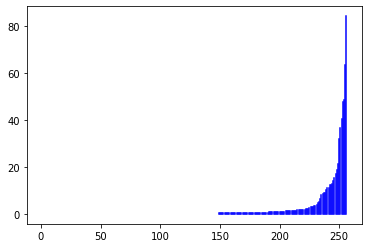

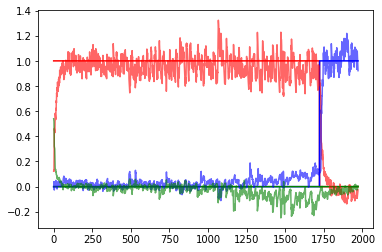

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2324/3000 [13:42:37<3:38:04, 19.36s/it]

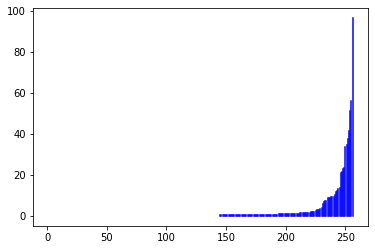

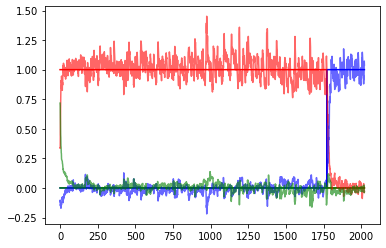

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2329/3000 [13:44:20<3:43:24, 19.98s/it]

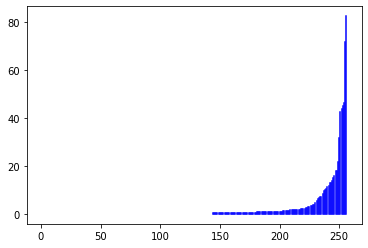

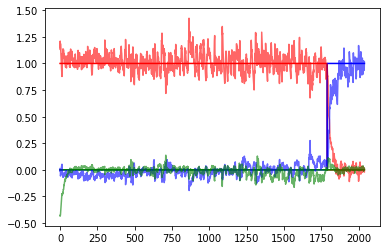

 78%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2334/3000 [13:46:04<3:46:15, 20.38s/it]

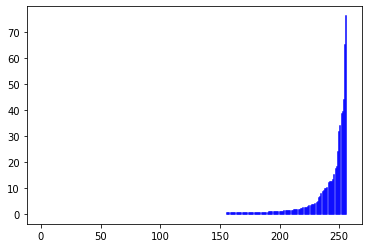

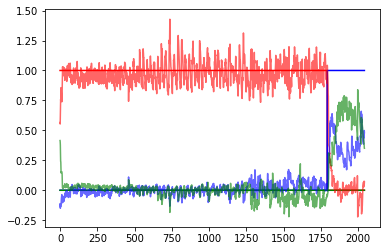

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2339/3000 [13:47:50<3:47:22, 20.64s/it]

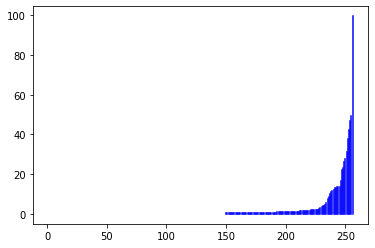

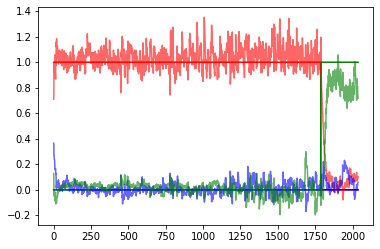

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2344/3000 [13:49:34<3:44:45, 20.56s/it]

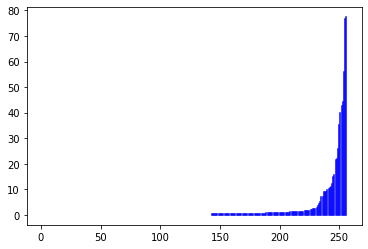

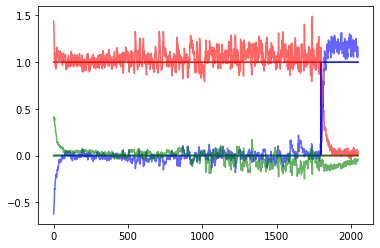

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2349/3000 [13:51:17<3:38:00, 20.09s/it]

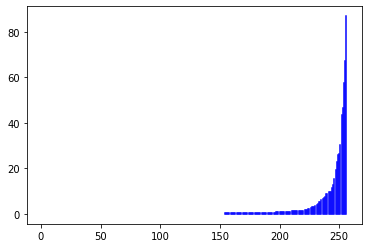

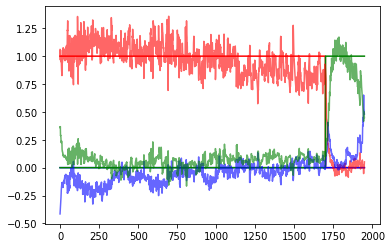

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                 | 2354/3000 [13:53:47<4:09:09, 23.14s/it]

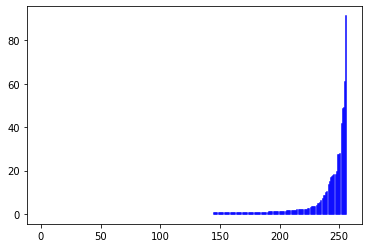

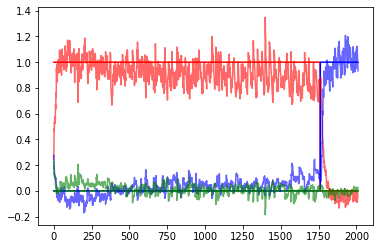

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                 | 2359/3000 [13:55:31<3:42:39, 20.84s/it]

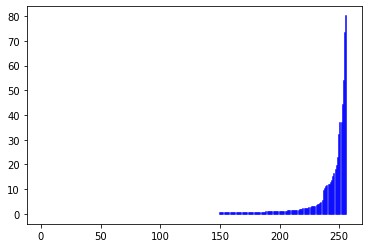

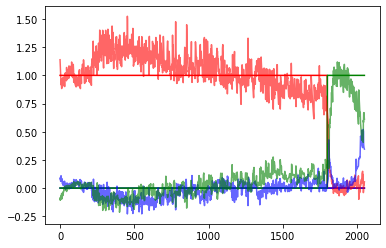

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                | 2364/3000 [13:57:13<3:32:16, 20.03s/it]

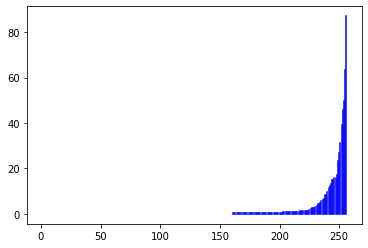

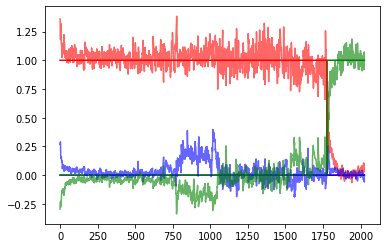

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                | 2369/3000 [13:58:53<3:25:06, 19.50s/it]

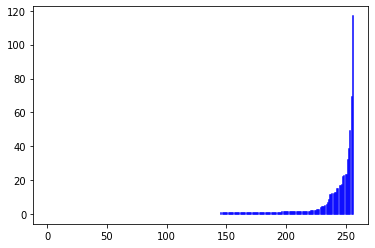

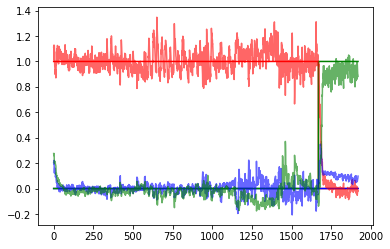

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                | 2374/3000 [14:00:34<3:24:42, 19.62s/it]

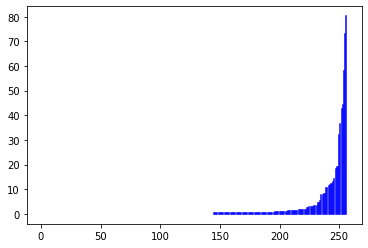

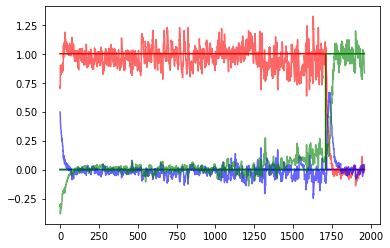

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                | 2379/3000 [14:02:10<3:13:56, 18.74s/it]

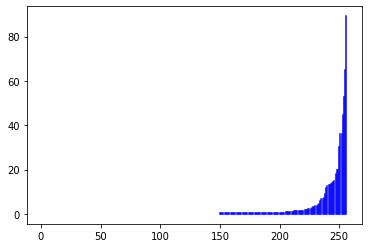

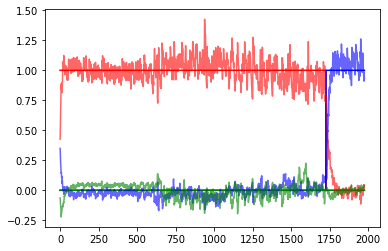

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2384/3000 [14:03:49<3:18:58, 19.38s/it]

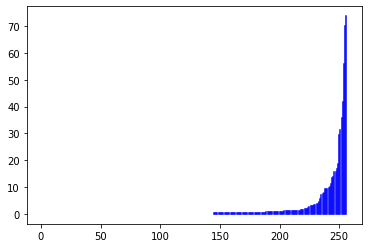

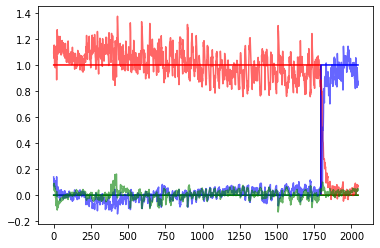

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2389/3000 [14:05:35<3:25:44, 20.20s/it]

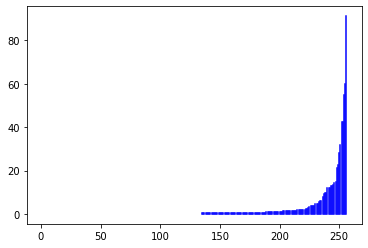

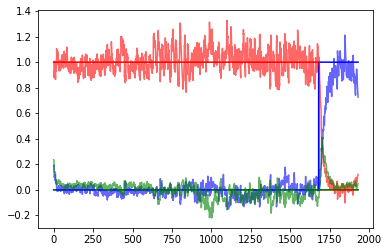

 80%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2394/3000 [14:07:16<3:16:08, 19.42s/it]

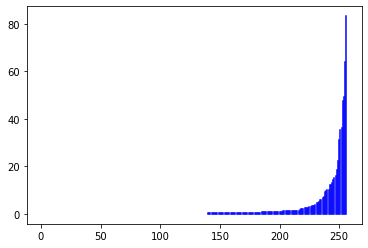

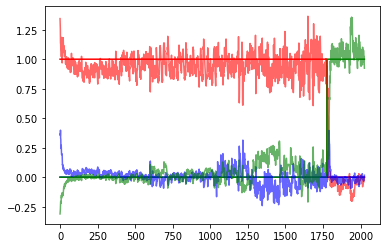

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2399/3000 [14:08:57<3:18:54, 19.86s/it]

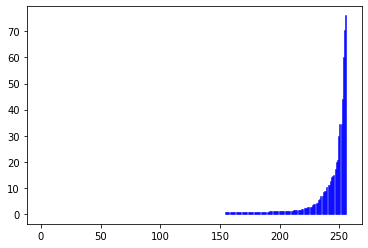

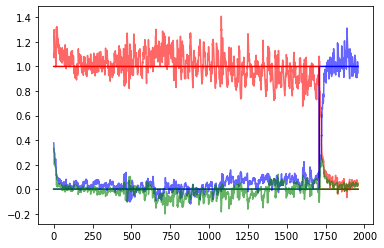

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2404/3000 [14:11:27<3:49:53, 23.14s/it]

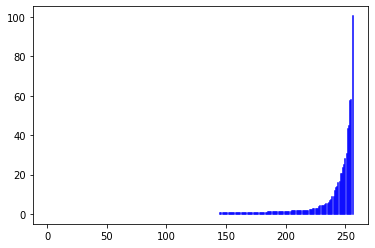

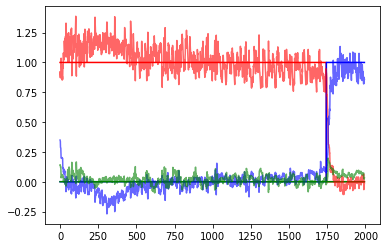

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2409/3000 [14:13:09<3:23:43, 20.68s/it]

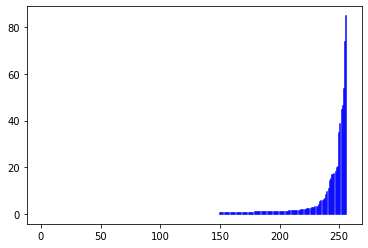

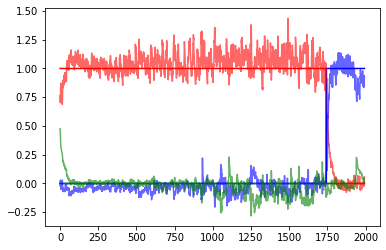

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2414/3000 [14:14:54<3:21:13, 20.60s/it]

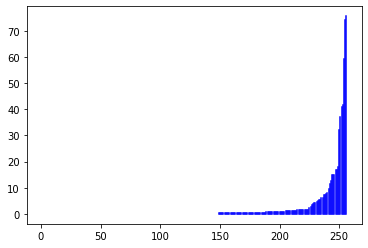

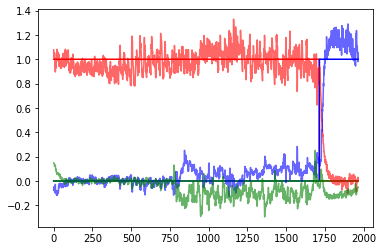

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2419/3000 [14:16:33<3:07:45, 19.39s/it]

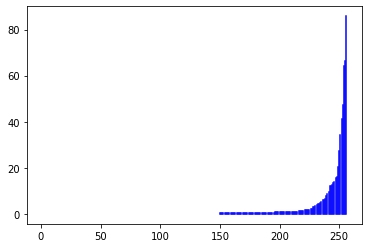

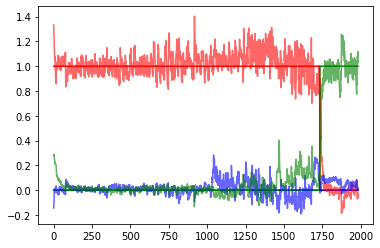

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2424/3000 [14:18:15<3:08:42, 19.66s/it]

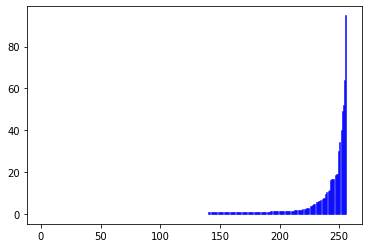

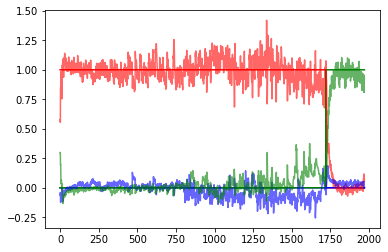

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                             | 2429/3000 [14:19:56<3:07:16, 19.68s/it]

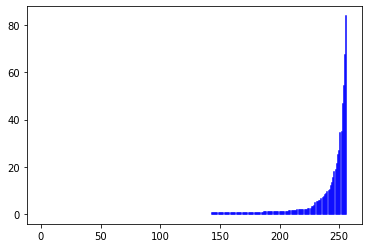

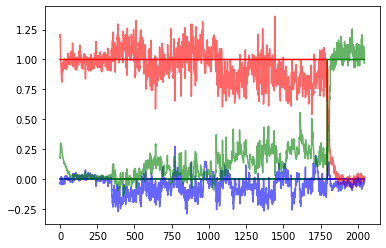

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                             | 2434/3000 [14:21:36<3:04:14, 19.53s/it]

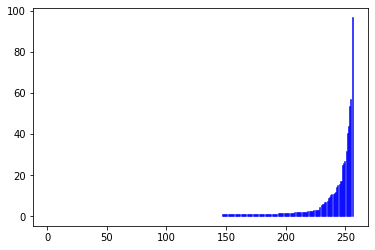

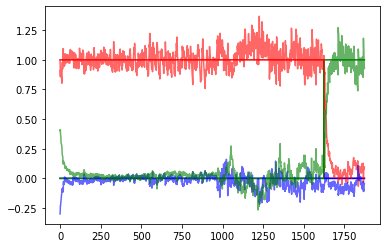

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 2439/3000 [14:23:17<3:03:13, 19.60s/it]

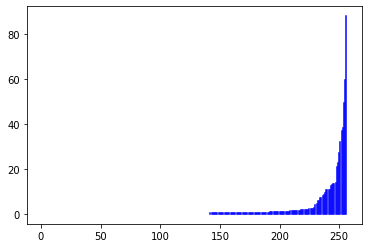

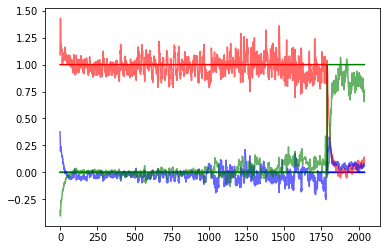

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 2444/3000 [14:24:59<3:06:21, 20.11s/it]

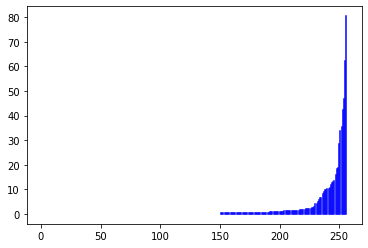

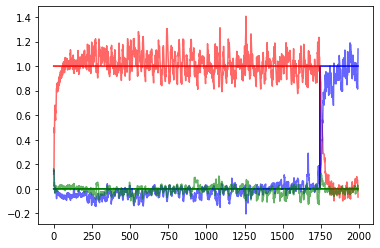

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                            | 2449/3000 [14:26:39<3:00:49, 19.69s/it]

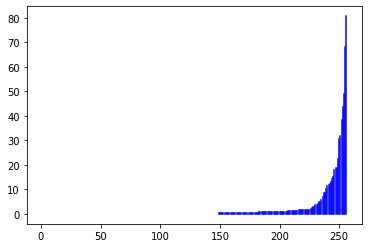

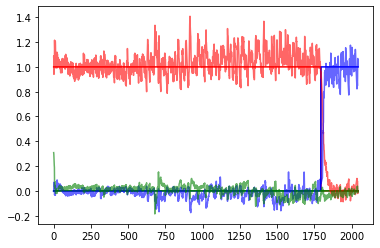

 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                            | 2454/3000 [14:29:06<3:28:34, 22.92s/it]

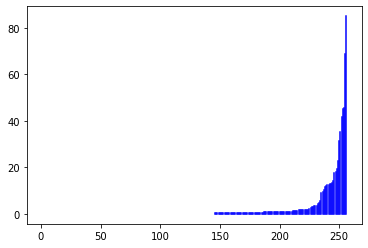

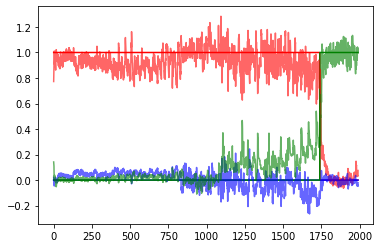

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 2459/3000 [14:30:51<3:09:42, 21.04s/it]

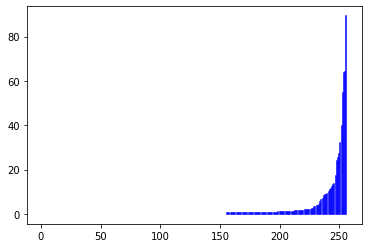

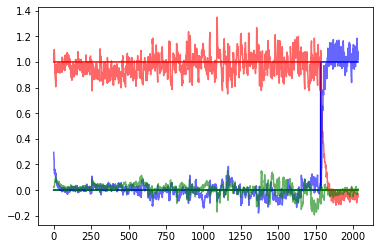

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 2464/3000 [14:32:32<2:57:32, 19.87s/it]

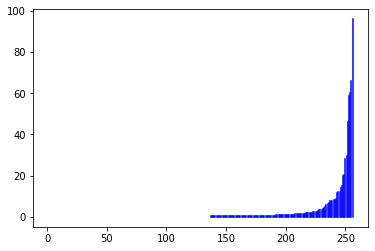

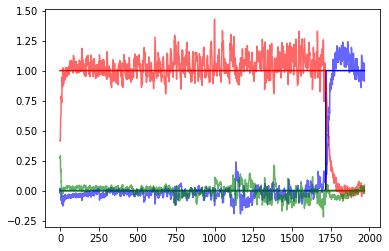

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 2469/3000 [14:34:14<2:52:39, 19.51s/it]

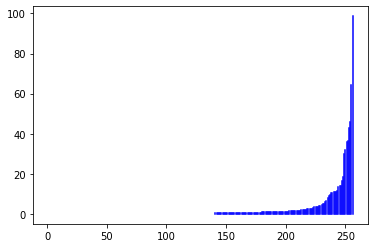

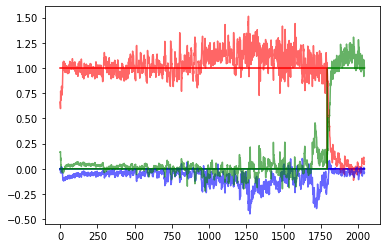

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                           | 2474/3000 [14:35:55<2:51:44, 19.59s/it]

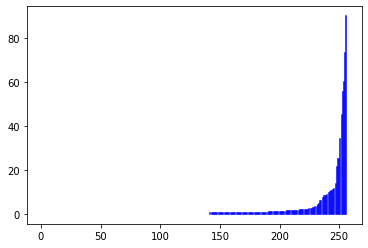

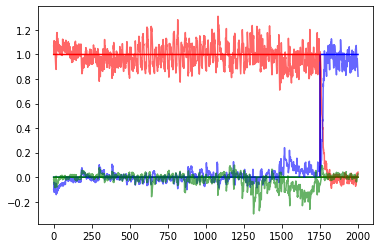

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2479/3000 [14:37:34<2:48:46, 19.44s/it]

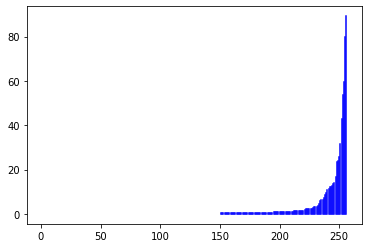

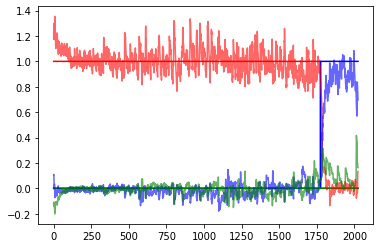

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2484/3000 [14:39:18<2:54:07, 20.25s/it]

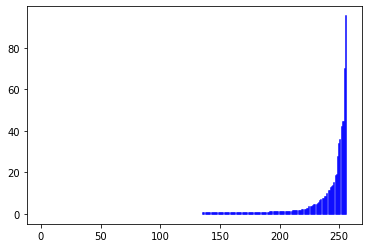

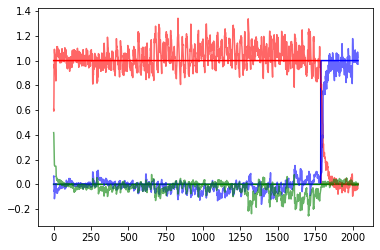

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2489/3000 [14:41:00<2:51:03, 20.09s/it]

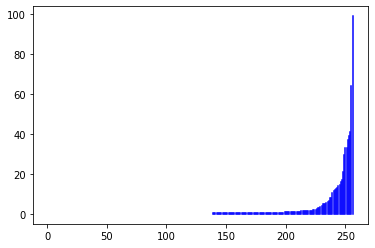

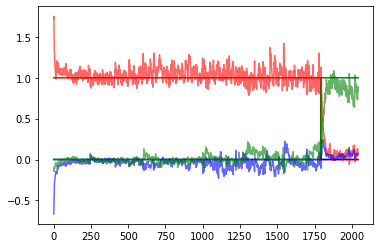

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2494/3000 [14:42:42<2:46:51, 19.79s/it]

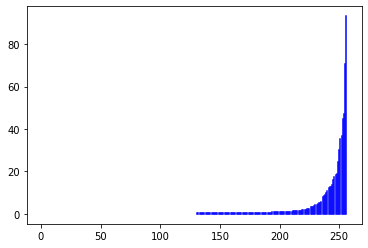

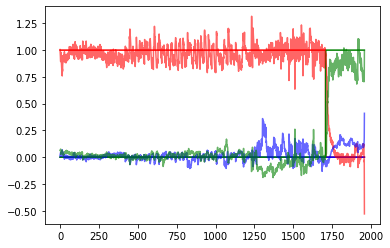

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2499/3000 [14:44:28<2:49:54, 20.35s/it]

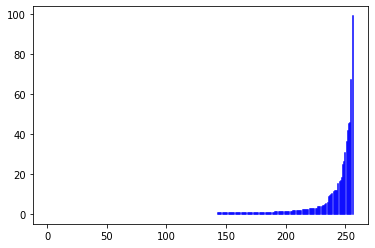

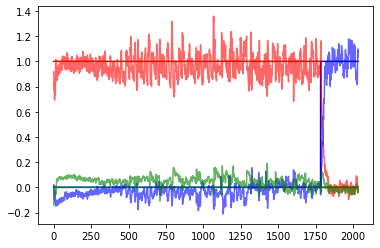

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 2504/3000 [14:46:57<3:12:13, 23.25s/it]

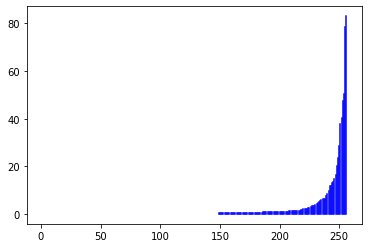

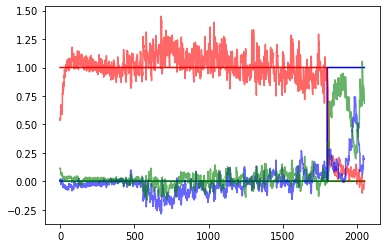

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 2509/3000 [14:48:37<2:45:22, 20.21s/it]

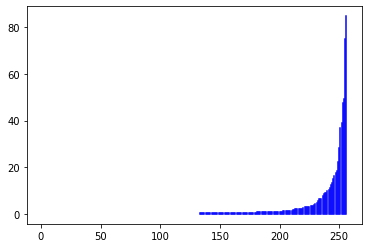

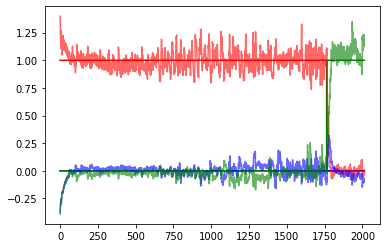

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                         | 2514/3000 [14:50:17<2:39:25, 19.68s/it]

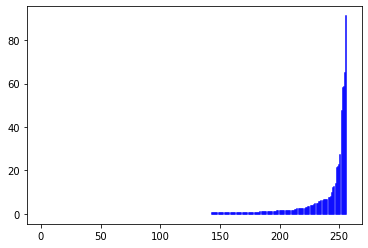

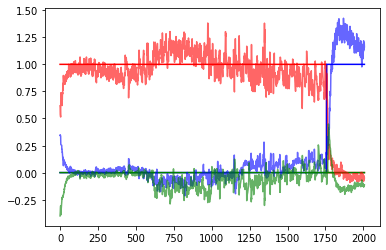

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 2519/3000 [14:51:59<2:38:41, 19.80s/it]

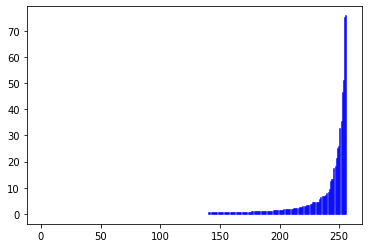

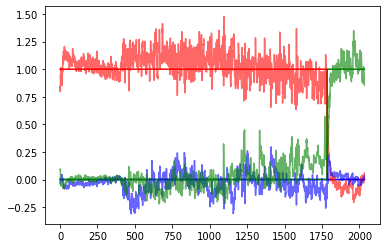

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 2524/3000 [14:53:45<2:42:18, 20.46s/it]

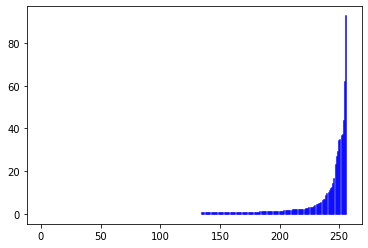

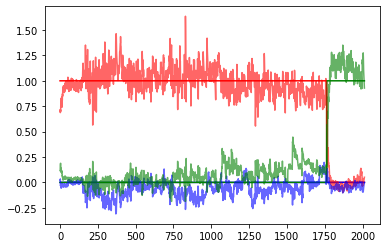

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                        | 2529/3000 [14:55:26<2:38:29, 20.19s/it]

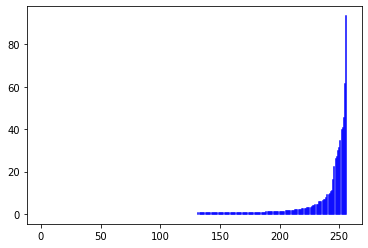

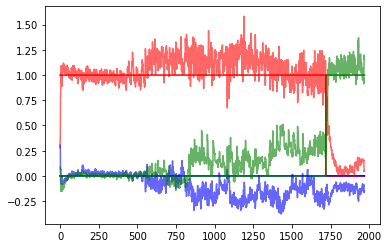

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                        | 2534/3000 [14:57:11<2:39:06, 20.49s/it]

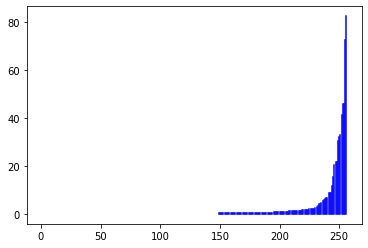

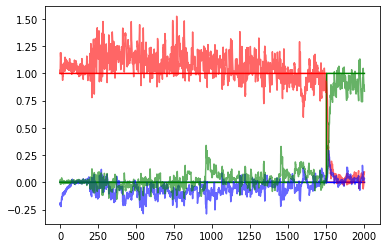

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                       | 2539/3000 [14:58:52<2:32:26, 19.84s/it]

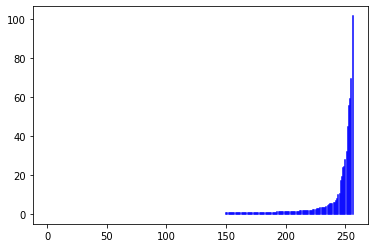

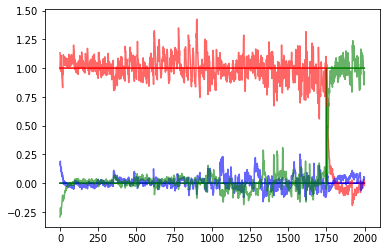

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 2544/3000 [15:00:37<2:34:03, 20.27s/it]

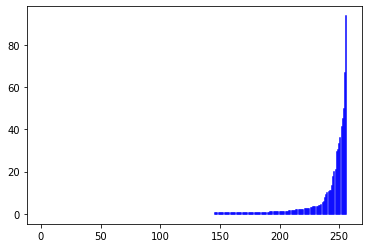

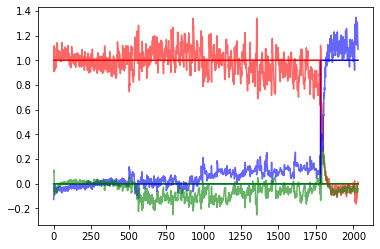

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 2549/3000 [15:02:22<2:35:45, 20.72s/it]

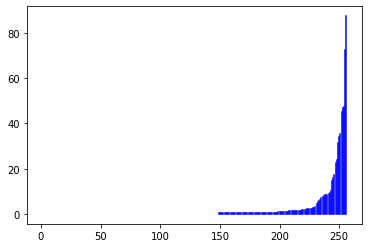

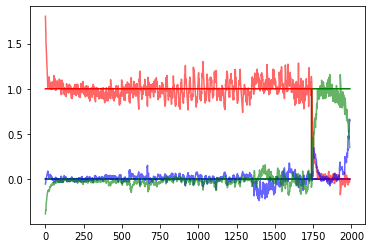

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                       | 2554/3000 [15:04:48<2:48:51, 22.72s/it]

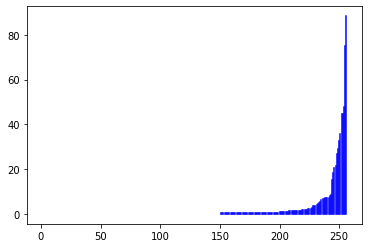

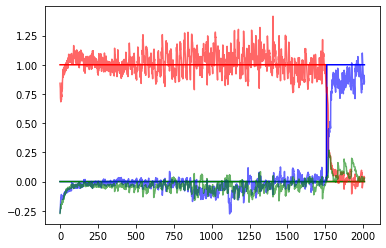

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                      | 2559/3000 [15:06:30<2:28:28, 20.20s/it]

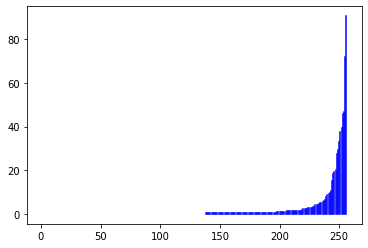

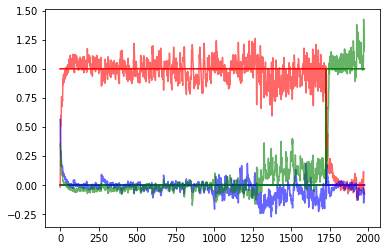

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                      | 2564/3000 [15:08:14<2:26:56, 20.22s/it]

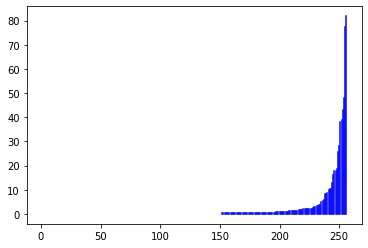

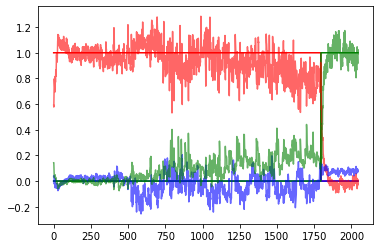

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2569/3000 [15:09:55<2:23:13, 19.94s/it]

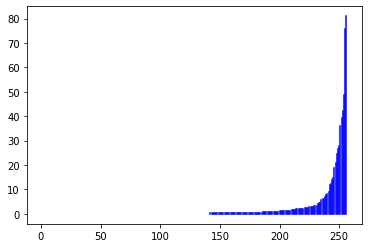

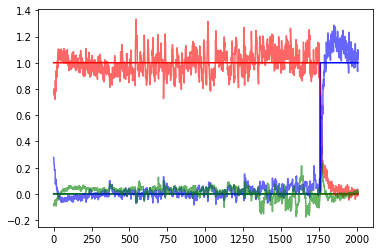

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2574/3000 [15:11:40<2:24:05, 20.29s/it]

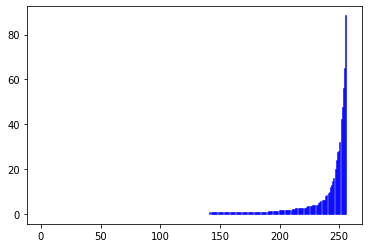

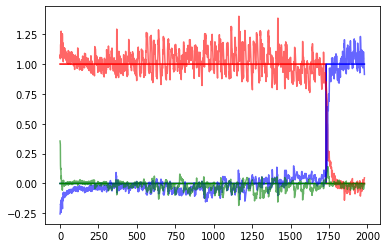

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                     | 2579/3000 [15:13:19<2:15:22, 19.29s/it]

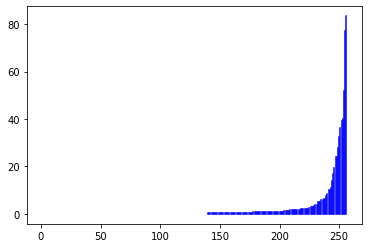

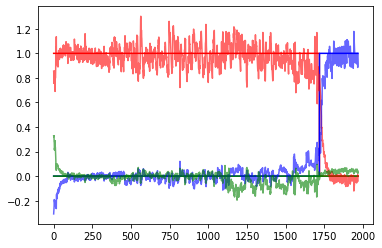

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 2584/3000 [15:15:00<2:17:57, 19.90s/it]

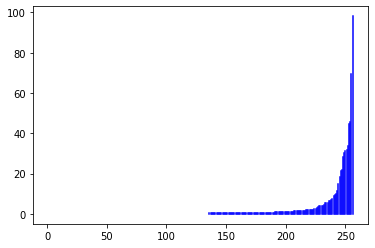

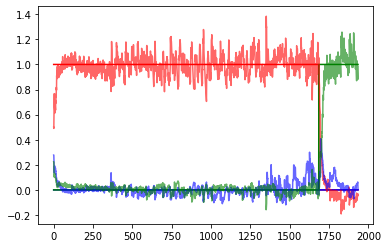

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 2589/3000 [15:16:44<2:17:19, 20.05s/it]

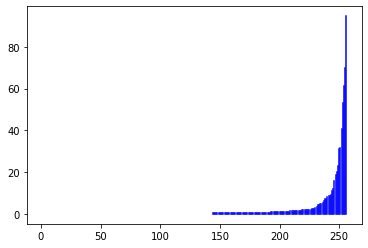

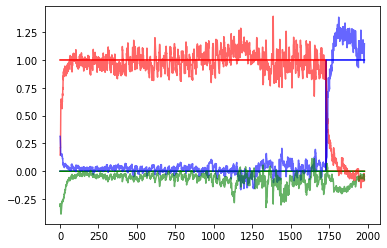

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                    | 2594/3000 [15:18:31<2:21:11, 20.86s/it]

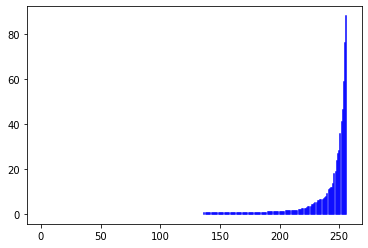

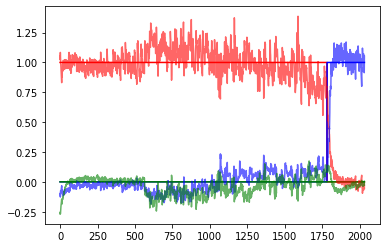

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 2599/3000 [15:20:16<2:17:46, 20.61s/it]

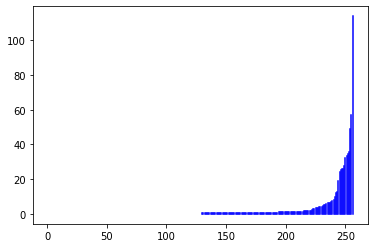

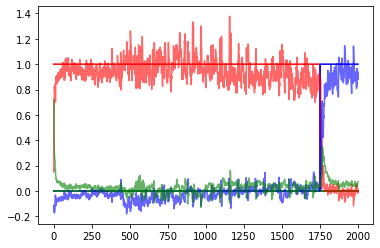

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                    | 2604/3000 [15:22:47<2:32:47, 23.15s/it]

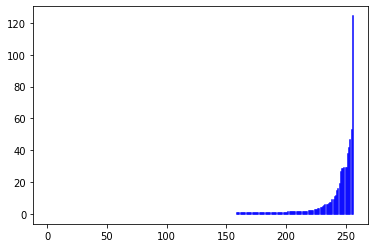

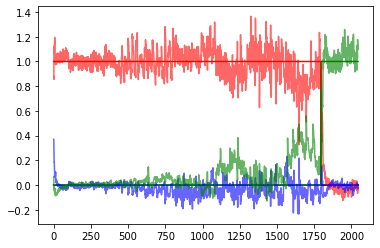

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 2609/3000 [15:24:27<2:08:27, 19.71s/it]

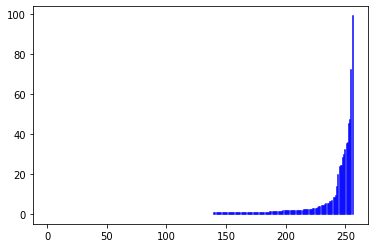

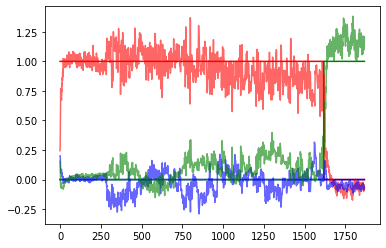

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 2614/3000 [15:26:05<2:01:04, 18.82s/it]

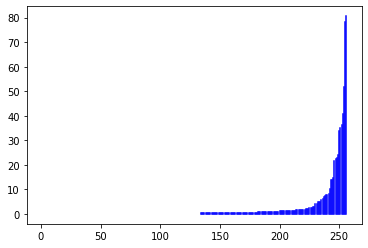

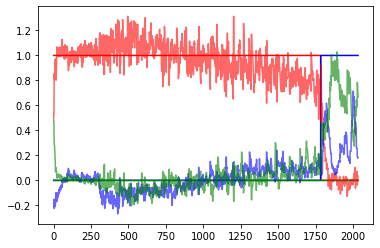

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 2619/3000 [15:27:47<2:04:02, 19.54s/it]

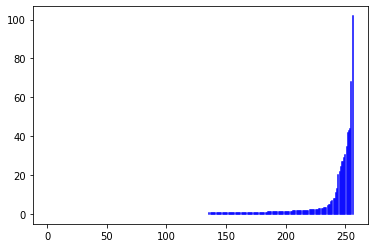

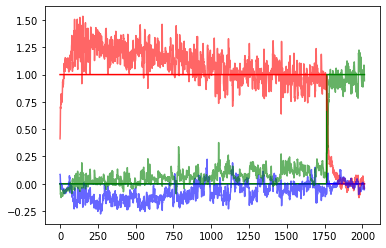

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 2624/3000 [15:29:29<2:05:48, 20.08s/it]

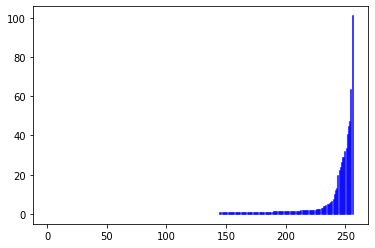

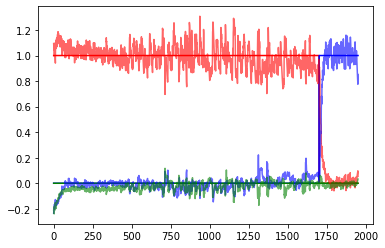

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                   | 2629/3000 [15:31:04<1:57:00, 18.92s/it]

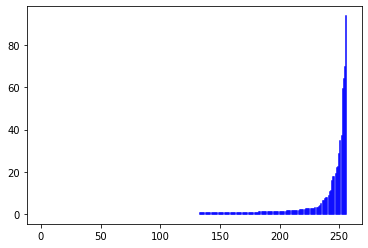

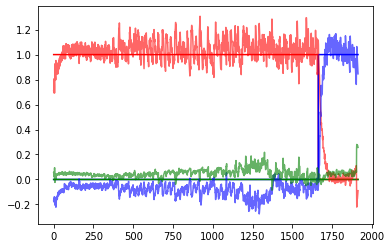

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 2634/3000 [15:32:42<1:54:50, 18.83s/it]

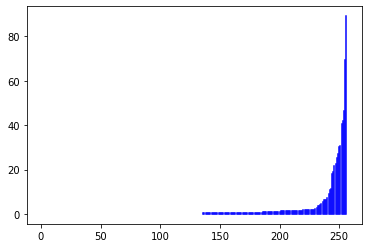

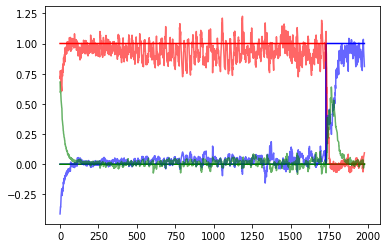

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 2639/3000 [15:34:25<2:00:39, 20.05s/it]

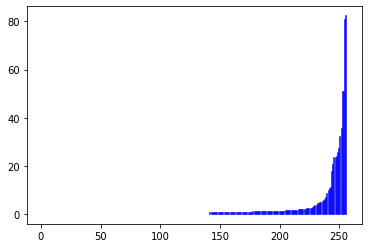

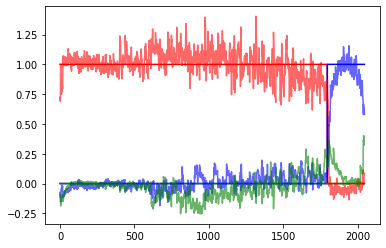

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 2644/3000 [15:36:07<1:57:44, 19.84s/it]

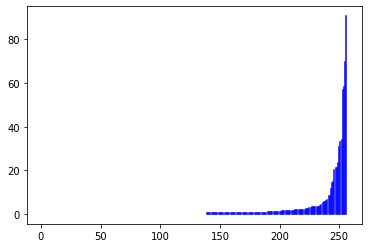

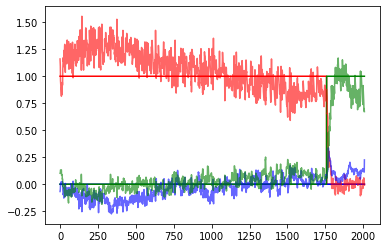

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 2649/3000 [15:37:48<1:54:31, 19.58s/it]

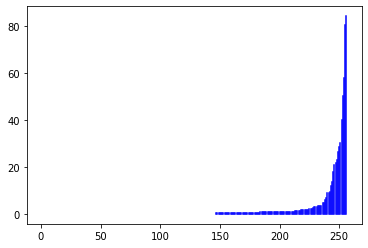

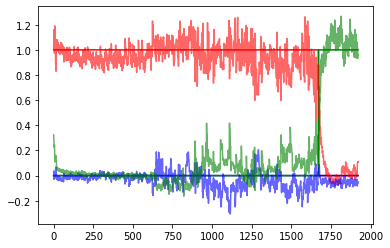

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 2654/3000 [15:40:20<2:15:54, 23.57s/it]

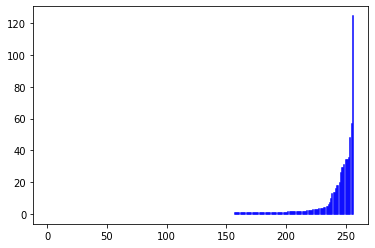

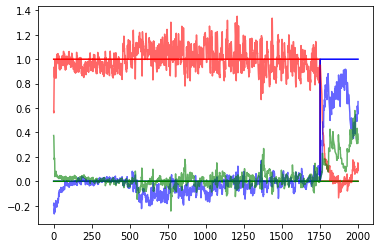

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2659/3000 [15:42:01<1:56:28, 20.49s/it]

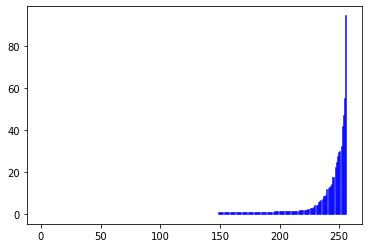

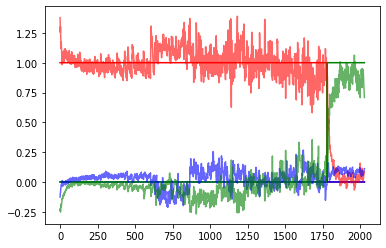

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 2664/3000 [15:43:41<1:48:35, 19.39s/it]

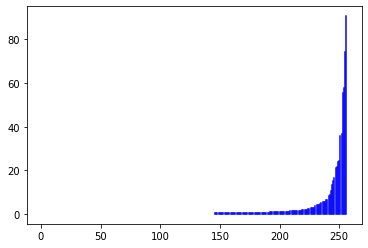

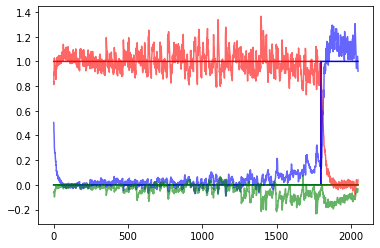

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                 | 2669/3000 [15:45:23<1:47:19, 19.46s/it]

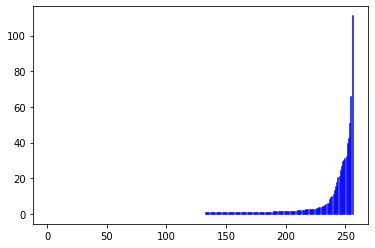

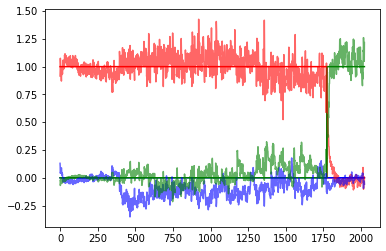

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 2674/3000 [15:47:04<1:47:14, 19.74s/it]

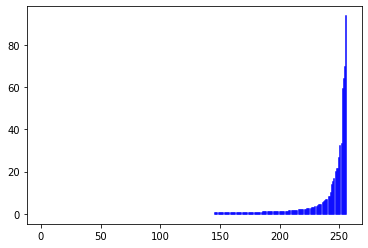

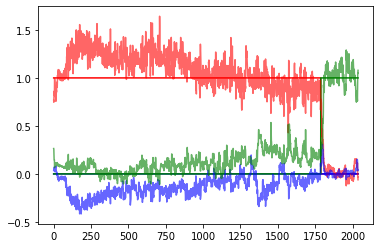

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 2679/3000 [15:48:49<1:48:51, 20.35s/it]

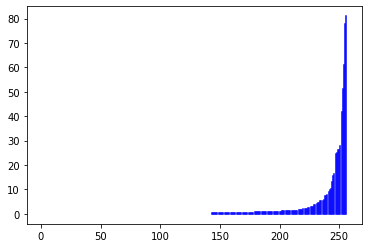

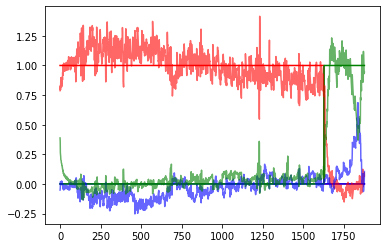

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 2684/3000 [15:50:30<1:45:12, 19.98s/it]

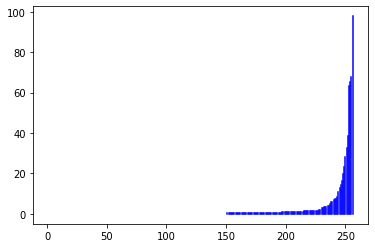

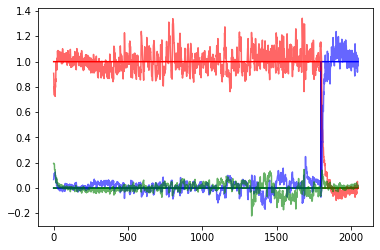

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                | 2689/3000 [15:52:13<1:44:23, 20.14s/it]

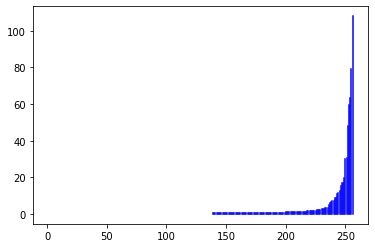

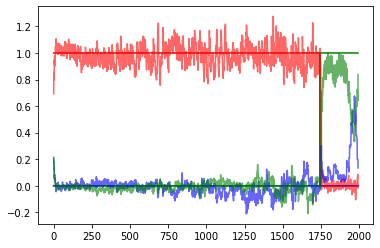

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎               | 2694/3000 [15:53:57<1:43:42, 20.33s/it]

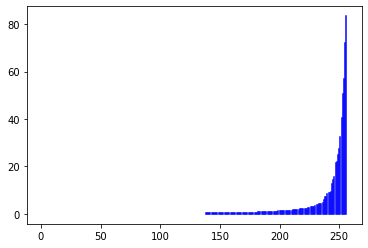

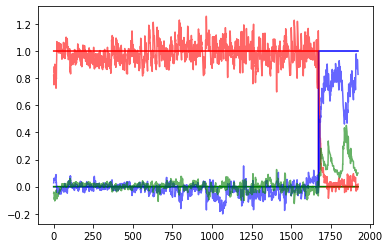

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 2699/3000 [15:55:35<1:37:59, 19.53s/it]

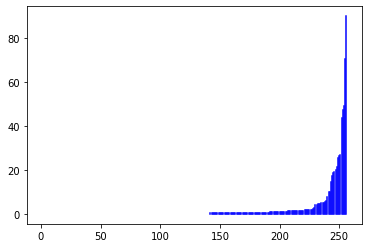

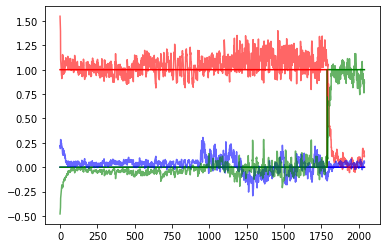

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2704/3000 [15:58:07<1:57:22, 23.79s/it]

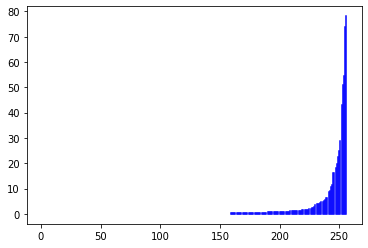

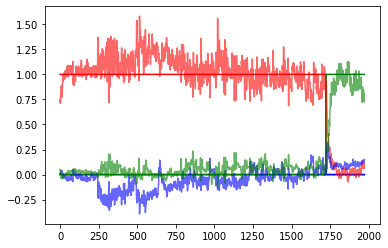

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2709/3000 [15:59:51<1:41:19, 20.89s/it]

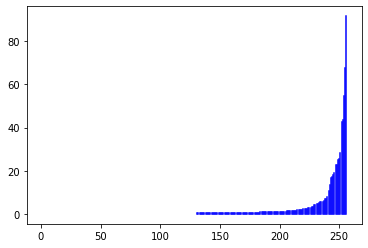

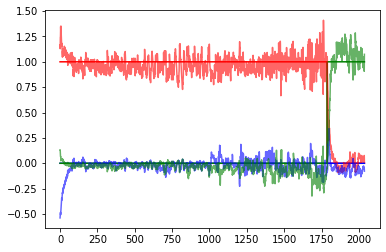

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2714/3000 [16:01:35<1:37:15, 20.40s/it]

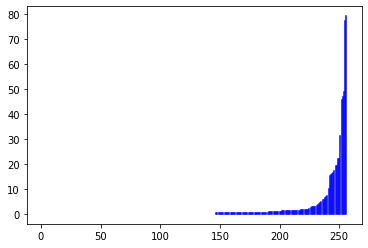

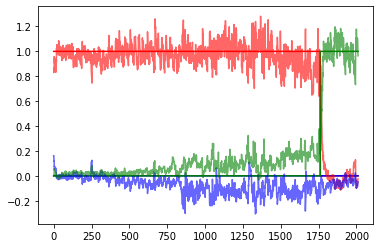

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2719/3000 [16:03:19<1:36:17, 20.56s/it]

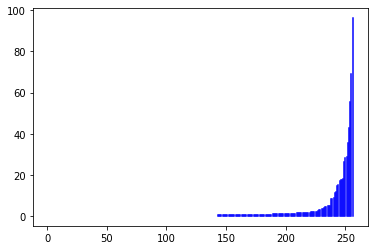

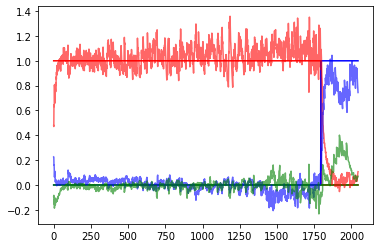

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2724/3000 [16:05:05<1:34:42, 20.59s/it]

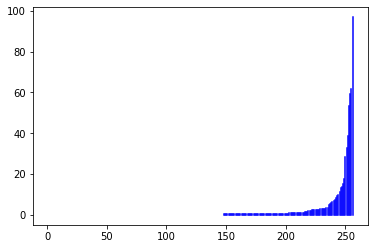

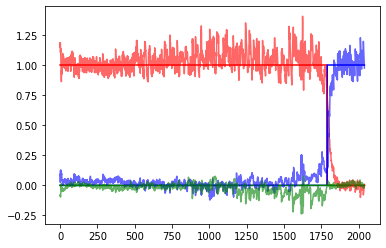

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2729/3000 [16:06:45<1:28:13, 19.53s/it]

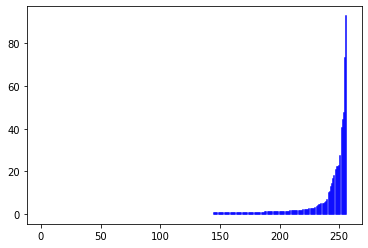

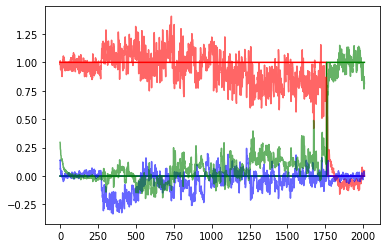

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2734/3000 [16:08:28<1:29:44, 20.24s/it]

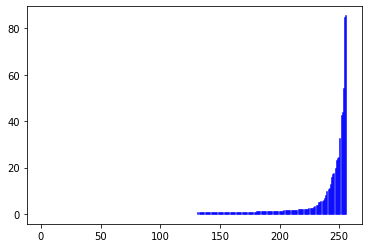

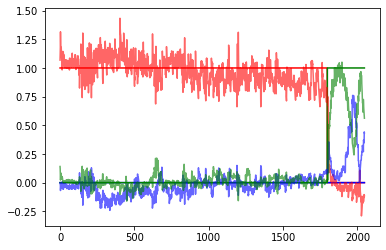

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2739/3000 [16:10:10<1:25:38, 19.69s/it]

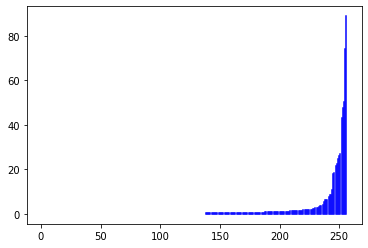

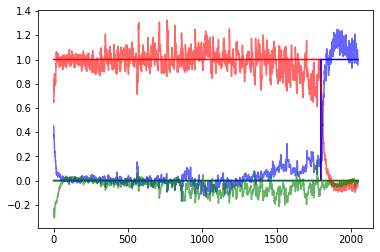

 91%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2744/3000 [16:11:56<1:27:24, 20.49s/it]

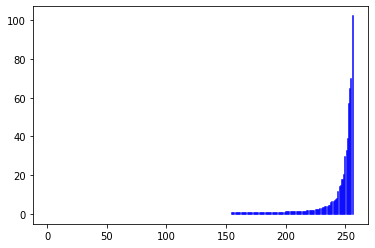

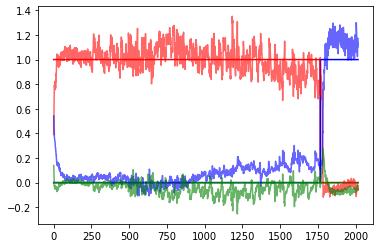

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 2749/3000 [16:13:39<1:23:12, 19.89s/it]

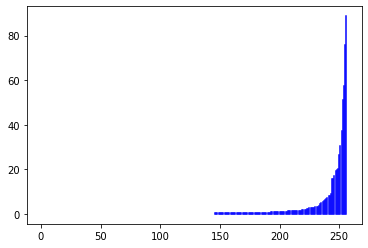

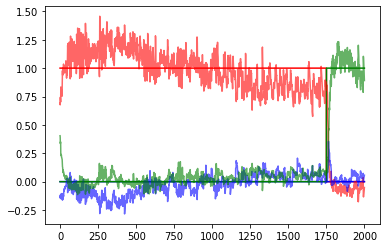

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 2754/3000 [16:16:10<1:35:41, 23.34s/it]

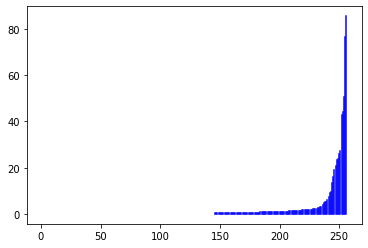

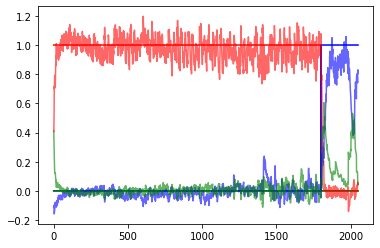

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2759/3000 [16:17:48<1:20:16, 19.99s/it]

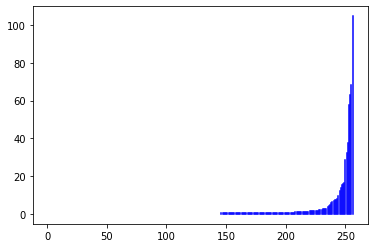

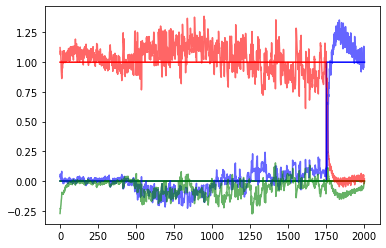

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2764/3000 [16:19:29<1:18:16, 19.90s/it]

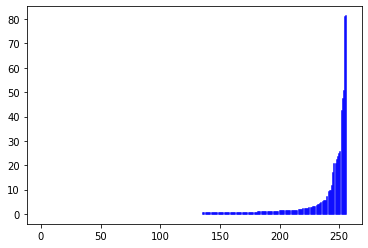

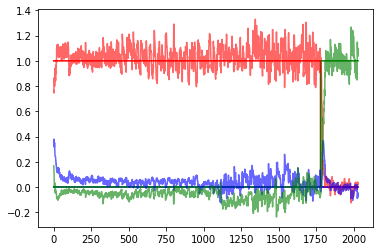

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2769/3000 [16:21:08<1:13:49, 19.17s/it]

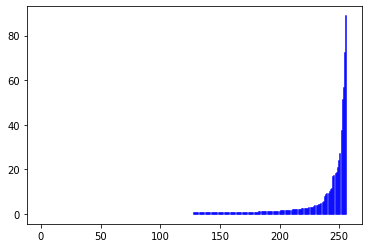

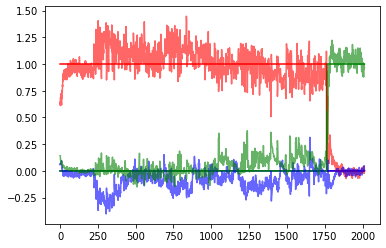

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2774/3000 [16:22:49<1:13:51, 19.61s/it]

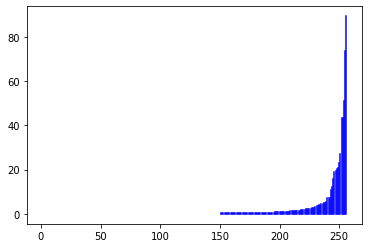

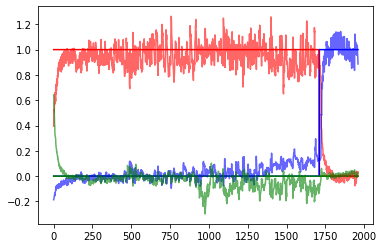

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2779/3000 [16:24:33<1:13:55, 20.07s/it]

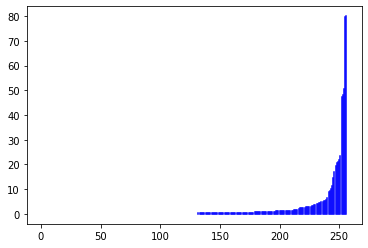

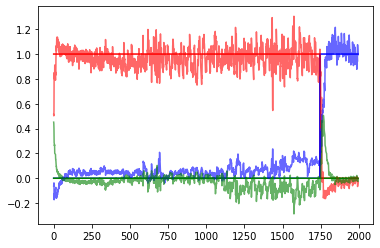

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2784/3000 [16:26:18<1:14:01, 20.56s/it]

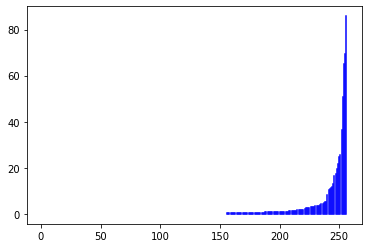

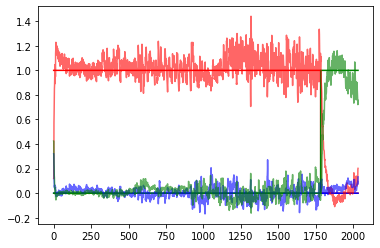

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2789/3000 [16:27:56<1:07:59, 19.34s/it]

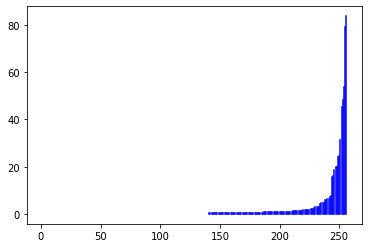

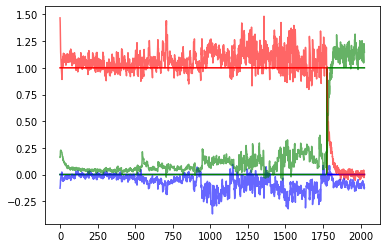

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2794/3000 [16:29:43<1:11:34, 20.85s/it]

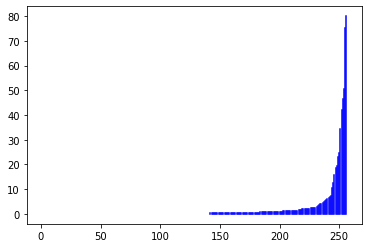

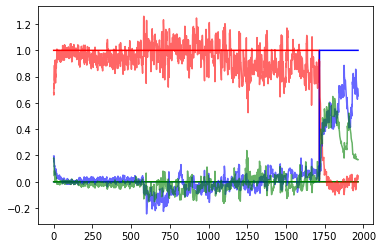

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2799/3000 [16:31:29<1:09:39, 20.79s/it]

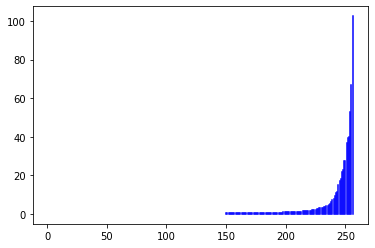

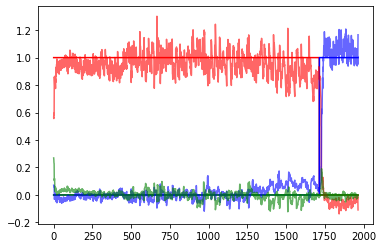

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 2804/3000 [16:33:58<1:15:55, 23.24s/it]

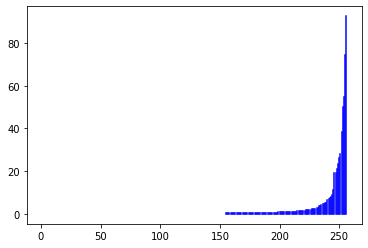

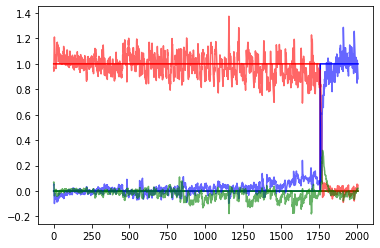

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 2809/3000 [16:35:42<1:06:04, 20.76s/it]

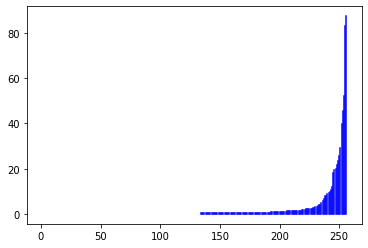

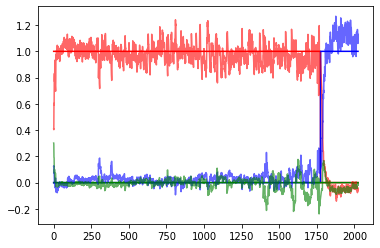

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 2814/3000 [16:37:22<1:00:04, 19.38s/it]

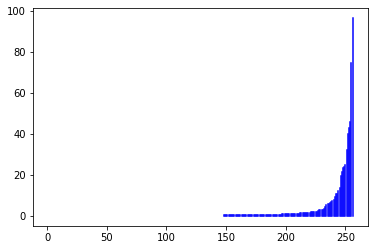

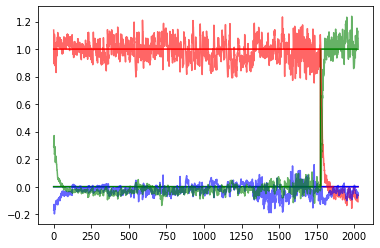

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 2819/3000 [16:39:08<1:01:28, 20.38s/it]

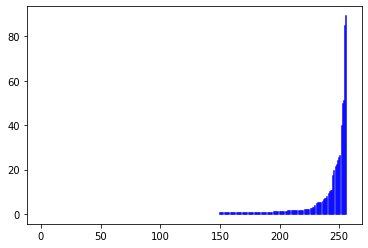

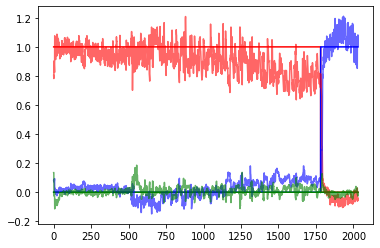

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 2824/3000 [16:40:52<1:00:20, 20.57s/it]

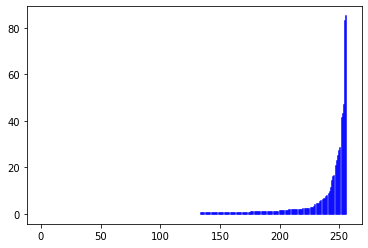

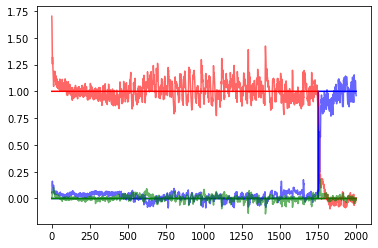

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 2829/3000 [16:42:37<58:24, 20.50s/it]

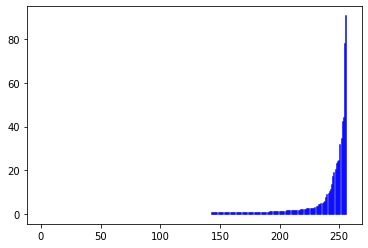

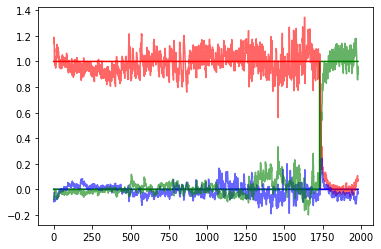

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 2834/3000 [16:44:19<55:20, 20.00s/it]

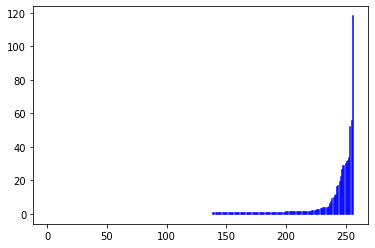

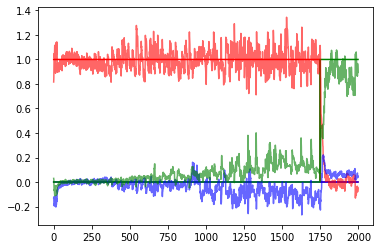

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 2839/3000 [16:46:00<52:05, 19.41s/it]

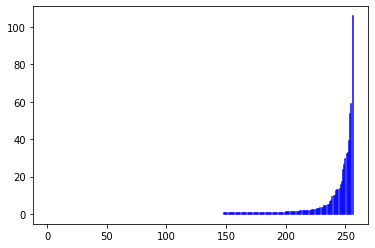

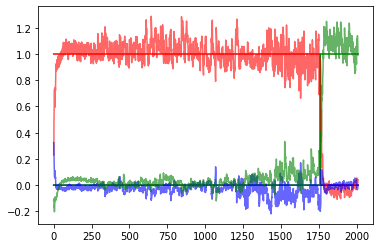

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 2844/3000 [16:47:40<50:45, 19.52s/it]

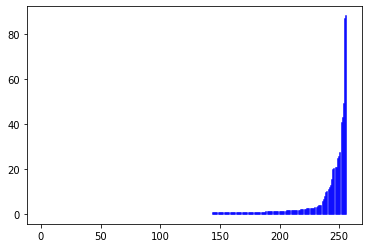

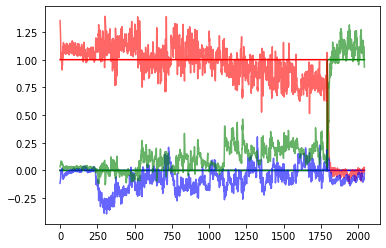

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 2849/3000 [16:49:23<50:12, 19.95s/it]

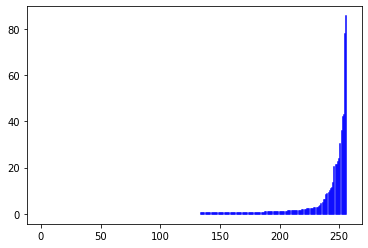

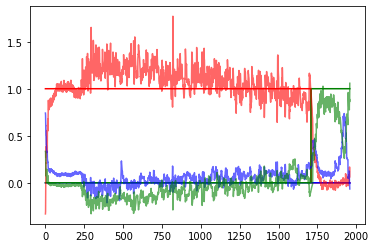

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 2854/3000 [16:51:51<55:44, 22.91s/it]

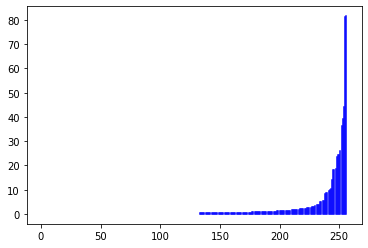

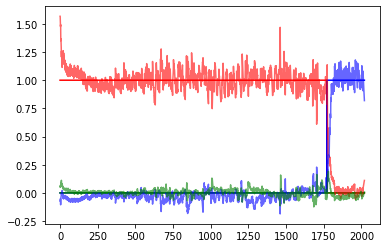

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 2859/3000 [16:53:35<48:25, 20.61s/it]

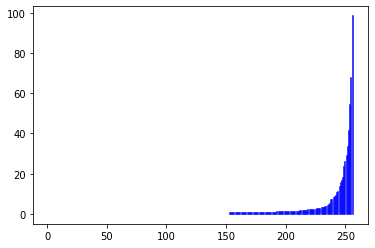

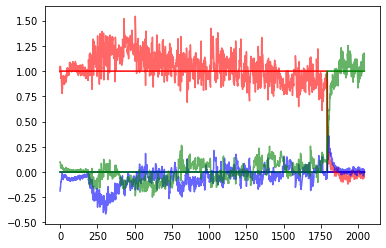

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 2864/3000 [16:55:22<47:15, 20.85s/it]

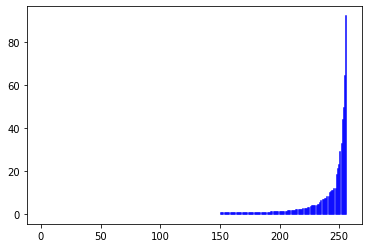

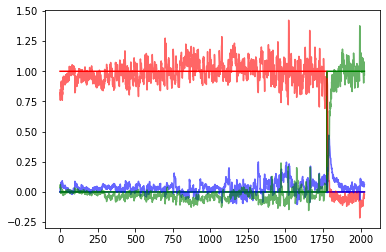

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 2869/3000 [16:57:06<43:36, 19.97s/it]

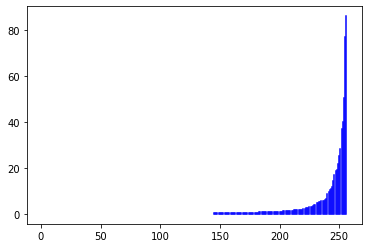

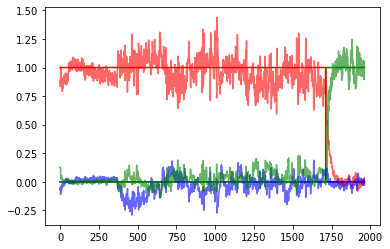

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 2874/3000 [16:58:48<42:20, 20.16s/it]

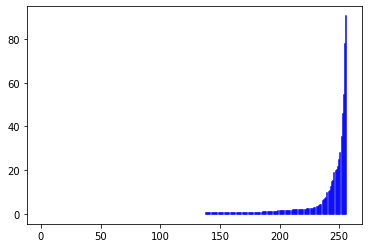

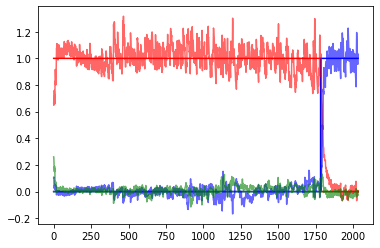

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 2879/3000 [17:00:33<40:57, 20.31s/it]

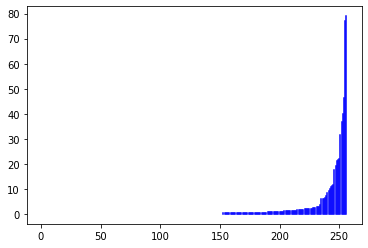

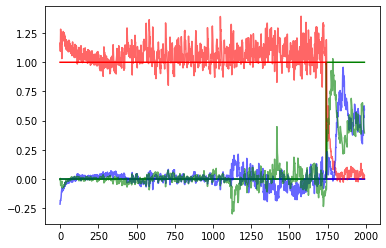

 96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 2884/3000 [17:02:13<37:16, 19.28s/it]

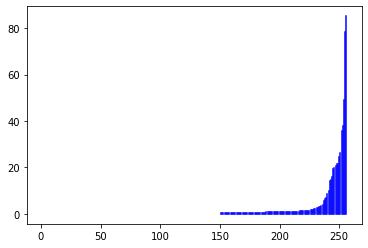

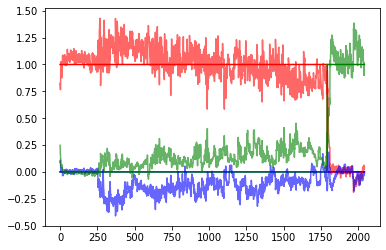

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 2889/3000 [17:03:57<37:34, 20.31s/it]

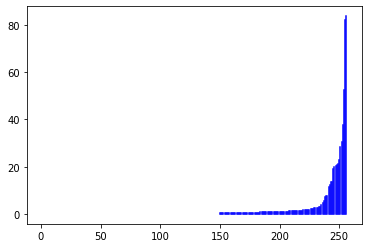

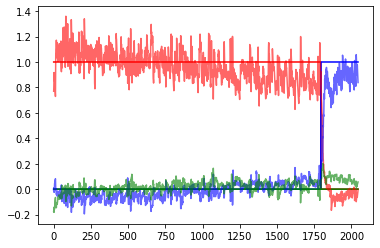

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 2894/3000 [17:05:42<36:10, 20.48s/it]

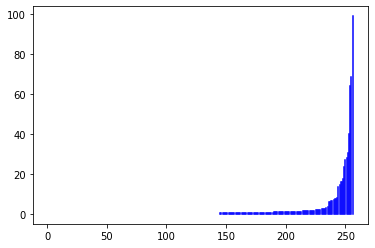

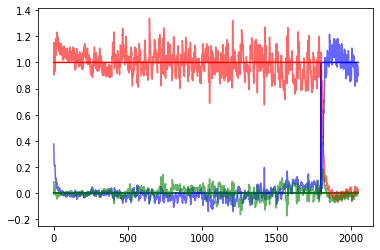

 97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 2899/3000 [17:07:26<34:05, 20.25s/it]

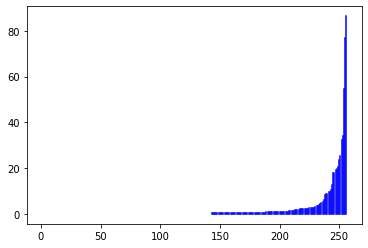

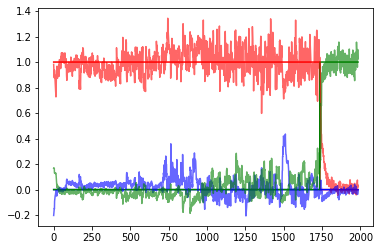

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████     | 2904/3000 [17:09:57<38:28, 24.05s/it]

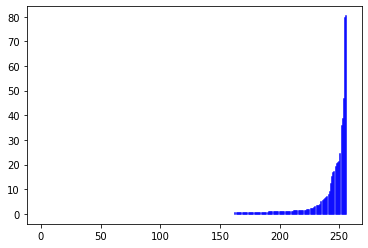

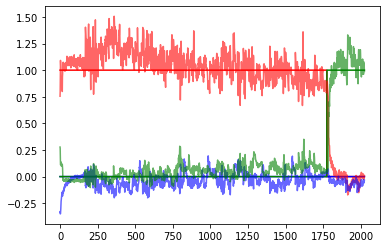

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 2909/3000 [17:11:42<32:00, 21.10s/it]

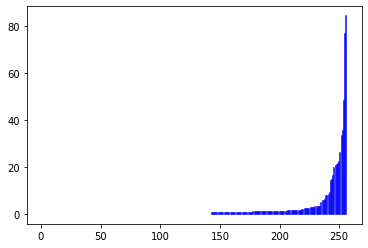

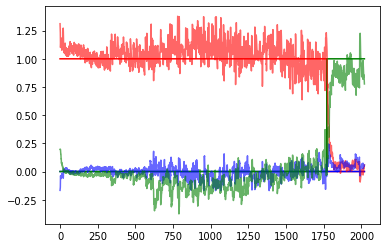

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 2914/3000 [17:13:22<28:43, 20.04s/it]

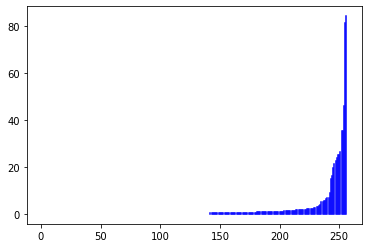

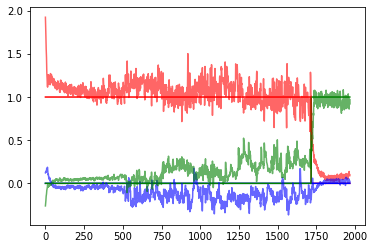

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 2919/3000 [17:15:04<26:43, 19.79s/it]

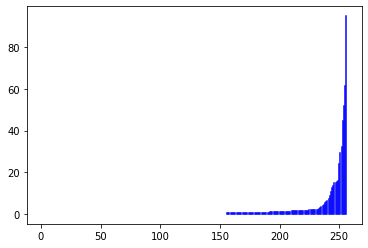

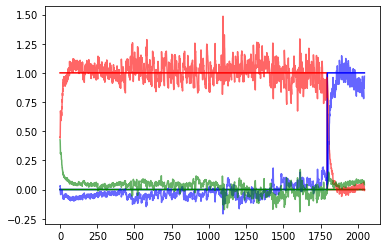

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 2924/3000 [17:16:49<25:36, 20.21s/it]

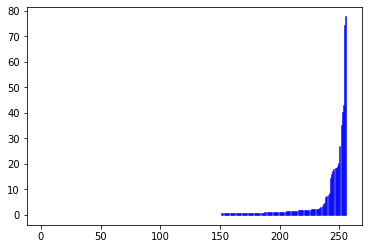

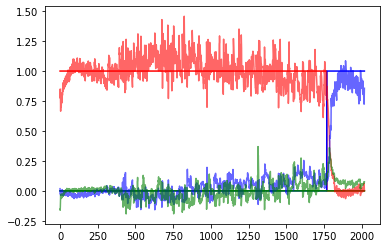

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 2929/3000 [17:18:31<23:28, 19.83s/it]

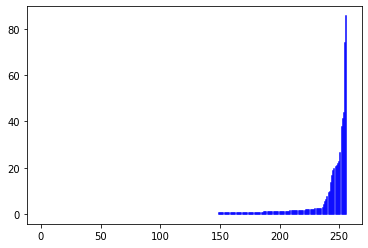

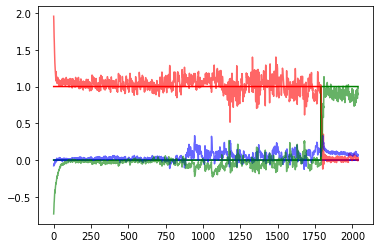

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 2934/3000 [17:20:15<22:08, 20.12s/it]

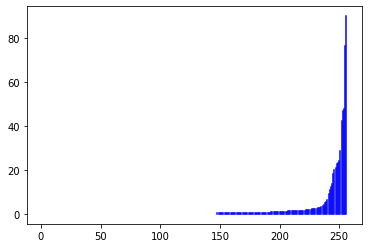

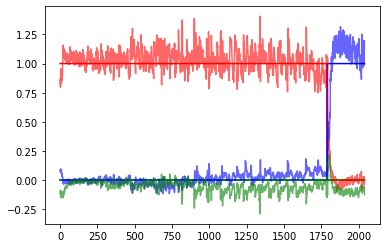

 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 2939/3000 [17:21:55<20:01, 19.70s/it]

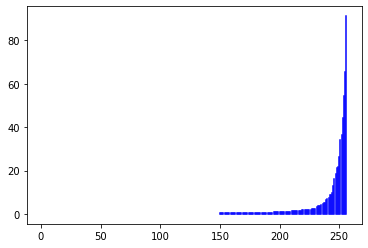

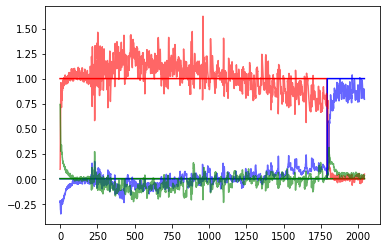

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 2944/3000 [17:23:35<18:24, 19.72s/it]

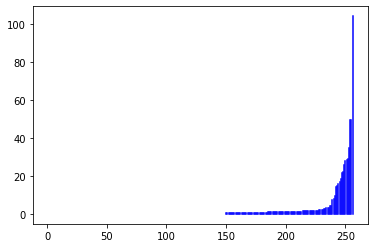

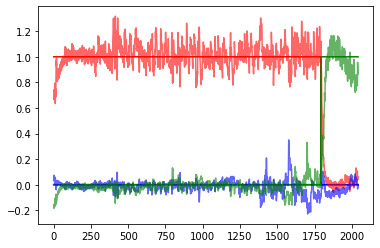

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 2949/3000 [17:25:15<16:40, 19.62s/it]

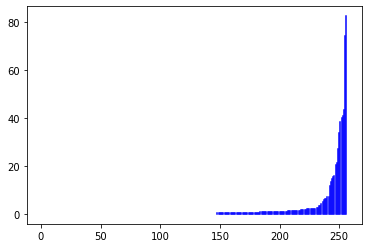

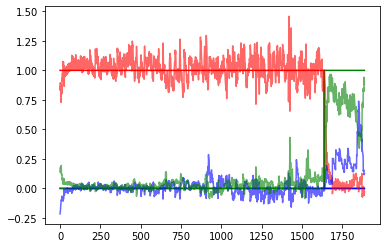

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 2954/3000 [17:27:43<17:27, 22.77s/it]

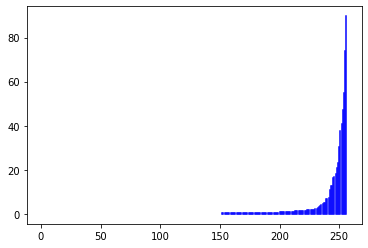

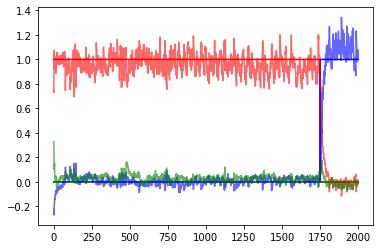

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 2959/3000 [17:29:24<13:50, 20.25s/it]

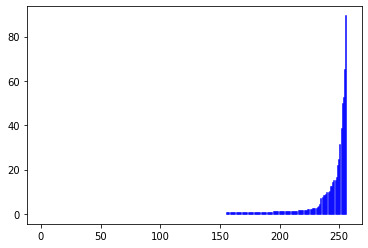

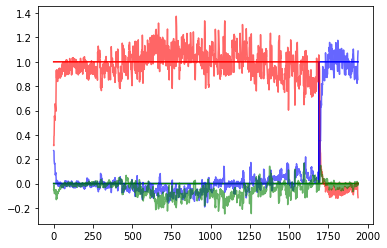

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 2964/3000 [17:31:03<11:40, 19.44s/it]

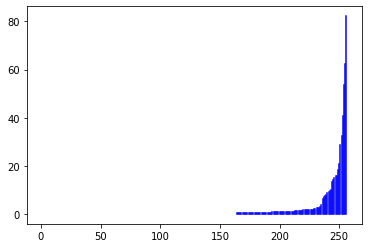

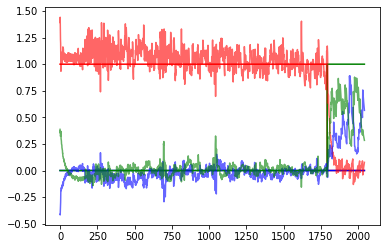

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 2969/3000 [17:32:46<10:14, 19.83s/it]

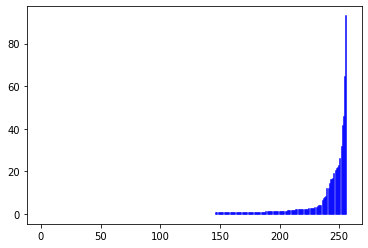

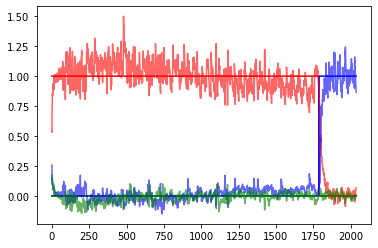

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 2974/3000 [17:34:30<08:49, 20.36s/it]

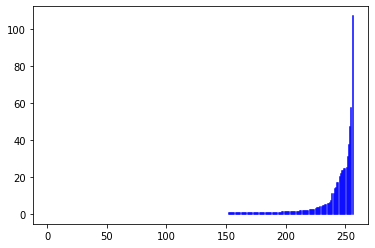

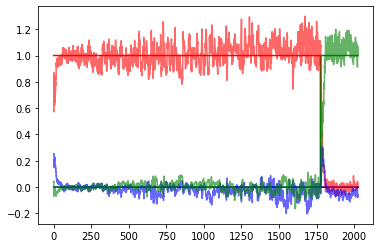

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 2979/3000 [17:36:06<06:37, 18.95s/it]

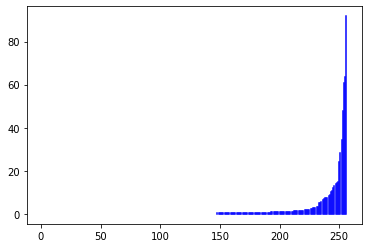

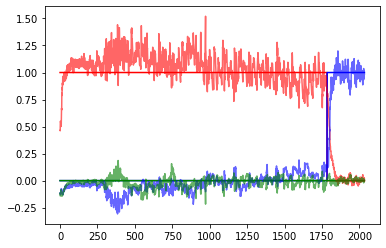

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 2984/3000 [17:37:47<05:11, 19.48s/it]

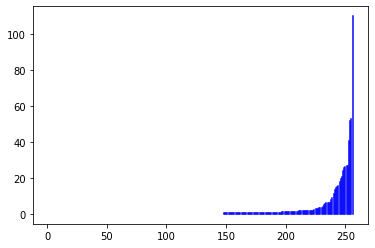

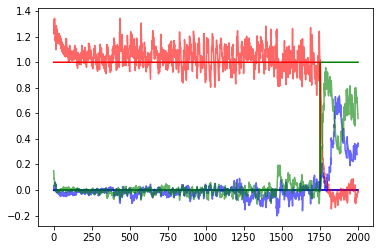

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 2989/3000 [17:39:32<03:42, 20.18s/it]

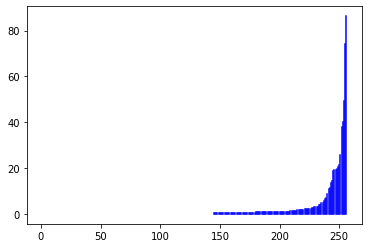

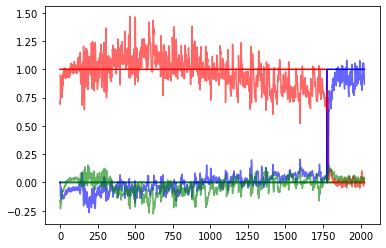

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 2994/3000 [17:41:11<01:57, 19.58s/it]

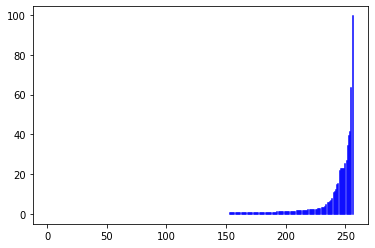

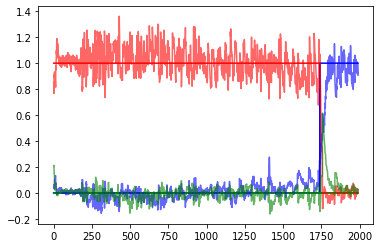

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 2999/3000 [17:42:53<00:19, 19.77s/it]

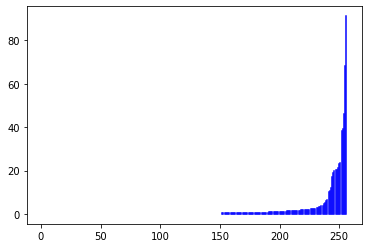

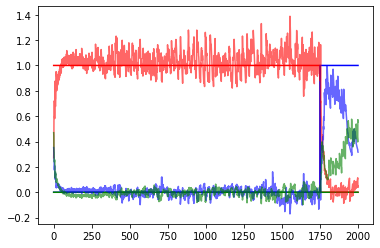

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3000/3000 [17:44:06<00:00, 21.28s/it]

Finished Training


In [13]:
from cgtasknet.instruments.instrument_accuracy_network import correct_answer
from cgtasknet.net.states import LIFAdExInitState
from norse.torch import LIFAdExState
name = f"weights/weights_{neuron_parameters.alpha}_N_{hidden_size}_without_square"
init_state = LIFAdExInitState(batch_size, hidden_size, device=device)
running_loss = 0
sigma = 0

for i in tqdm(range(number_of_epochs)):
    if i == 500:
        sigma = 0.2
    if i == 1000:
        sigma = 0.5
    inputs, target_outputs = Task.dataset(number_of_tasks)

    inputs[:, :, 1:3] += every_bath_generator(
        0, sigma, inputs.shape[0], inputs.shape[1], 2
    )
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    loss_mask = torch.zeros_like(target_outputs)
    mask_indexes_signes = torch.where(target_outputs[:, :, 0] == 1)
    mask_indexes_zeros = torch.where(target_outputs[:, :, 0] == 0)
    loss_mask[mask_indexes_signes[0], mask_indexes_signes[1], :] = .1
    loss_mask[mask_indexes_zeros[0], mask_indexes_zeros[1], :] = 1
    optimizer.zero_grad()
    init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
    # forward + backward + optimize
    outputs, _, state = model(
        inputs,
        init_state,
    )

    loss = criterion(outputs, target_outputs, loss_mask, state)
    loss.backward()
    optimizer.step()

    # print statistics
    running_loss = loss.item()
    if i % 50 == 49:
        with open("log_multy.txt", "a") as f:
            f.write("epoch: {:d} loss: {:0.5f}\n".format(i + 1, running_loss / 10))
        running_loss = 0.0
        with torch.no_grad():
            torch.save(
                model.state_dict(),
                name + f'_{i}_',
            )
    if i % 50== 49:

        result = 0
        for j in range(10):
            try:
                del inputs
            except:
                pass
            try:
                del target_outputs
            except:
                pass
            try:
                del outputs
            except:
                pass
            torch.cuda.empty_cache()
            inputs, target_outputs = Task.dataset(1, delay_between=0)
            inputs[:, :, 1:3] += every_bath_generator(
                0, 0.01, inputs.shape[0], inputs.shape[1], 2
            )
            inputs = torch.from_numpy(inputs).type(torch.float).to(device)
            target_outputs = (
                torch.from_numpy(target_outputs).type(torch.float).to(device)
            )
            outputs = model(
                inputs,
                init_state,
            )[0]
            type_tasks = list(
                np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1]
            )
            answers = can.run(
                target_outputs[50:, :, 0].cpu(),
                outputs[50:, :, 0].cpu(),
                target_outputs[50:, :, 1:].cpu(),
                outputs[50:, :, 1:].cpu(),
                type_tasks,
            )
            result += answers

        accuracy = result / batch_size / 10 * 100
        with open("accuracy_multy.txt", "a") as f:
            f.write(f"ecpoch = {i}; correct/all = {accuracy}\n")
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
        del states
    except:
        pass
    if i % 5 == 4:
        check_mean_fr()
    torch.cuda.empty_cache()
print("Finished Training")

In [14]:
len(state)

6547

In [15]:
model.save_states = True
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs[:, :, 1:3] += every_bath_generator(0, 0.01, inputs.shape[0], inputs.shape[1], 2)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
outputs, states = model(
    inputs,
    init_state,
    additional_current=additional_current_generate(
        len(inputs),
        batch_size,
        hidden_size,
    ).to(device),
)
type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
answers = can.run(
    target_outputs[:, :, 0].cpu(),
    outputs[:, :, 0].cpu(),
    target_outputs[:, :, 1:].cpu(),
    outputs[:, :, 1:].cpu(),
    type_tasks,
)
result += answers

NameError: name 'additional_current_generate' is not defined

In [ ]:
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)# * 0
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
outputs, states, _ = model(
    inputs,
    init_state,
        
    )
task_number = sorted_tasks.index('RomoTask1')

outputs = outputs.cpu().detach()
target_outputs = target_outputs.detach().cpu()
s = []
for i in range(len(states)):
    s.append(states[i].z)
s = torch.stack(s).detach().cpu()

plt.plot(target_outputs[:, task_number, 0].cpu())
plt.plot(outputs[:, task_number, 0].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 1].cpu())
plt.plot(outputs[:, task_number, 1].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 2].cpu())
plt.plot(outputs[:, task_number, 2].detach().cpu())
plt.show()
plt.close()
plt.figure(figsize=(20, 10))
plt.imshow(s[:, task_number, :].T, aspect="auto", interpolation="nearest")

In [ ]:
for_sort = torch.sort(torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).indices
s_new = torch.zeros_like(s)
for i in range(hidden_size):
    s_new[:, :, i] = s[:, :, for_sort[i]]
plt.imshow(s_new[:, task_number, :].T, aspect="auto", interpolation="nearest", origin='lower',)

In [ ]:
# spike_sequence = torch.stack(spike_sequence)
freq_sequence = torch.mean(torch.mean(spike_sequence, axis=0), axis=0)

# freq_sequence = sort_elemnts_by_another (freq_sequence, freq_sequence)
print(f"{spike_sequence.shape=}")
print(f"{freq_sequence.shape=}")
for i in range(len(freq_sequence)):
    plt.plot([i + 1] * 2, [0, freq_sequence[i]], c="b")
plt.show()
plt.close()
model.save_states = False

In [ ]:
from cgtasknet.instruments.instrument_subgroups import sort_elemnts_by_another

frequency = torch.mean(torch.mean(s, axis=0), axis=0) * 1e3
frequency = sort_elemnts_by_another(freq_sequence, frequency)
for i in range(len(frequency)):
    plt.plot([i + 1] * 2, [0, frequency[i]], c="b")

In [ ]:
result

In [ ]:
list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])

# Тестовая функция

In [ ]:
def test_network(
        test_sigma: float, number_of_trials: int = 100, plot_data: bool = True
):
    result = 0
    for j in tqdm(range(number_of_trials)):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, :3] += every_bath_generator(
            0, test_sigma, inputs.shape[0], inputs.shape[1], 3
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        answers = correct_answer(
            outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
        )
        result += torch.sum(answers).item()

    accuracy = result / batch_size / number_of_trials * 100
    if plot_data:
        plot_results(inputs, target_outputs, outputs)
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    return accuracy

# Тестирование
```  np.random.normal(0, 0.01, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.01, 1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.05, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.05, 10)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.1, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.5, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.5)
print(accuracy)

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.5, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.7, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
inputs = 0
outputs = 0

In [ ]:
lines = []
with open("accuracy_multy.txt", "r") as f:
    while line := f.readline():
        lines.append(float(line.split("=")[2]))

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
plt.plot([*range(9, 3000, 50)], lines, ".", linestyle="--", markersize=5)
plt.ylabel(r"Accuracy%")
plt.xlabel(r"Epochs")

In [ ]:
start_sigma = 0
stop_sigma = 2
step_sigma = 0.05
sigma_array = np.arange(start_sigma, stop_sigma, step_sigma)
for test_sigma in tqdm(sigma_array):
    result = 0
    for j in range(20):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, 1:3] += np.random.normal(
            0, test_sigma, size=inputs[:, :, 1:3].shape
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
        answers = can.run(
            target_outputs[50:, :, 0].cpu(),
            outputs[50:, :, 0].cpu(),
            target_outputs[50:, :, 1:].cpu(),
            outputs[50:, :, 1:].cpu(),
            type_tasks,
        )
        result += answers
    accuracy = result / batch_size / 20 * 100
    with open("accuracy_vs_noise.txt", "a") as f:
        f.write(f"noise={test_sigma}:accuracy={accuracy}\n")

In [ ]:
import matplotlib.patches as patches

plt.style.use("ggplot")


def parser(line_text: str) -> tuple:
    """
    Function parses text in form:
    ```v_name_1=v1:v_name_2:v2```
    and return (v1, v2)
    :param line_text:
    :return: (v1, v2)
    """
    line_text = line_text.split(":")
    print(line_text)
    v1 = line_text[0].split("=")[1]
    v2 = line_text[1].split("=")[1]
    return float(v1), float(v2)


x, y = [], []
# with open('accuracy_vs_noise.txt', 'r') as f:
with open(
        r"accuracy_vs_noise.txt",
        "r",
) as f:
    while line := f.readline():
        t_x, t_y = parser(line)
        x.append(t_x)
        y.append(t_y)

fig, ax = plt.subplots()
ax.plot(x, y, ".", linestyle="--")
# ax.plot([.5]*2, [50, 100])
ax.set_ylabel("Accuracy,%")
ax.set_xlabel(r"$\sigma$")
ax.add_patch(
    patches.Rectangle(
        (0, 50), 0.5, 50, edgecolor="grey", facecolor="grey", alpha=0.5, fill=True
    )
)

plt.show()
plt.close()

In [ ]:
batch_size = 1
number_of_tasks = 1
romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.6,
        positive_shift_delay_time=0.0,
        trial_time=0.1,
        positive_shift_trial_time=0.2,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.6, positive_shift_trial_time=0.0)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go=GoRtTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(trial_time=0.1, positive_shift_trial_time=0.2),
        delay=0.1,
        positive_shift_delay_time=1.4,
    )
)
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}

tasks_sequence = [
    MultyReduceTasks(
        tasks=task_dict,
        batch_size=batch_size,
        delay_between=0,
        enable_fixation_delay=True,
        task_number=i,
    )
    for i in range(len(tasks))
]

In [ ]:
tasks_and_names = dict([*zip(sorted(tasks), tasks_sequence)])
chosed_tasks = ["CtxDMTask1", "GoTask1", "GoRtTask1", "GoDlTask1", "RomoTask1"]
chosed_tasks_dict = {}
for key, item in tasks_and_names.items():
    if key in chosed_tasks:
        chosed_tasks_dict[key] = item
print("Tasks for PCA")
print(chosed_tasks_dict)

In [ ]:
import matplotlib.pyplot as plt
from cgtasknet.instruments.instrument_accuracy_network import correct_answer
from cgtasknet.net.states import LIFAdExInitState

name = f"Train_dm_and_romo_task_reduce_lif_adex_without_refrac_random_delay_long_a_alpha_{neuron_parameters.alpha}_N_{hidden_size}"
init_state = LIFAdExInitState(batch_size, hidden_size, device=device)
data, t_outputs = tasks_and_names["DMTask1"].dataset(2, delay_between=0)
data[:, :, 1:3] += every_bath_generator(0, sigma, data.shape[0], data.shape[1], 2)
data = torch.from_numpy(data).type(torch.float).to(device)
out, states = model(data, init_state.random_state())
out = out.detach().cpu().numpy()
plt.figure()
plt.plot(t_outputs[:, 0, 0])
plt.plot(t_outputs[:, 0, 1])
plt.plot(t_outputs[:, 0, 2])

plt.figure()
plt.plot(out[:, 0, 0])
plt.plot(out[:, 0, 1])
plt.plot(out[:, 0, 2])

In [ ]:

for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        final_parameters = torch.clone(param.detach().cpu())


In [ ]:
eigs_final = torch.eig(final_parameters)[0]
eigs_initial = torch.eig(initial_parameters)[0]

In [ ]:
x_final = eigs_final[:, 0]
y_final = eigs_final[:, 1]

x_initial = eigs_initial[:, 0]
y_initial = eigs_initial[:, 1]

In [ ]:
plt.scatter(x_initial, y_initial)
plt.scatter(x_final, y_final)

In [ ]:
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=0
)

In [ ]:
model.save_states = True
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
inputs, target_outputs = Task_test.dataset(1)

inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
result = model(inputs, init_state,)
#del inputs, init_state
torch.cuda.empty_cache()
states = result[-1]
spikes = []
for state in states:
    spikes.append(state.detach().cpu())
    
s = torch.stack(spikes)
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")

In [ ]:
last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
s = torch.stack(spikes)[:last_fix, ...]
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")

In [ ]:
index=10
plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
        )
plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
        )
plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )


plt.plot(inputs[:, index, 0].detach().cpu() + 1.5)

plt.plot(inputs[:, index, 1].detach().cpu() + 1.5)
plt.plot(inputs[:, index, 2].detach().cpu() + 1.5)
plt.yticks([])

In [ ]:
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)

In [ ]:
torch.mean(final_parameters, axis=1).shape

In [ ]:
torch.sort(torch.mean(final_parameters, axis=1))

In [ ]:
torch.mean(torch.zeros((10, 20)), axis=1).shape

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)